# REINFORCEMENT LEARNING: 
# OpenAI Lunar Lander

In this notebook, we will be attempting to solve OpenAI's LunarLander game by using Tensorflow agents and multiple Reinforcement Learning models.

These models include:
- Deep Q Network (DQN)
- Deep Double Q Network
- Dueling Deep Q Network
- Dueling Deep Double Q Network
- Deep Deterministic Policy Gradients Network (DDPG)
- SARSA

### Introduction To OpenAI's LunarLander-v2

<br> __About LunarLander-v2__ <br><br>
LunarLander-v2 is a reinforcement learning environment developed by OpenAI. The objective of the game is to land a lunar lander spacecraft on a designated landing pad on the surface of the moon. The lander is controlled by applying thrust to its engines in four different directions: left, right, down, and up. The environment is simulated and the lander is subject to the laws of physics, including gravity and the thrust of the engines.

The game is designed to be a challenging test of an agent's ability to learn and make decisions in a complex, dynamic environment. The lander must navigate through a rocky, uneven terrain and avoid obstacles while also controlling its descent to the landing pad. The lander has a limited amount of fuel, and the game ends when the lander crashes or successfully lands on the pad.

The game is implemented using the OpenAI Gym, a toolkit for developing and comparing reinforcement learning algorithms. The game state is represented by a number of variables including the lander's position, velocity, fuel level, and angle. The agent's actions are represented by the thrust applied to the engines in each direction. The agent receives a reward for each successful landing, and a penalty for crashing or using too much fuel. The agent's goal is to learn a policy, a mapping of states to actions, that maximizes the expected reward over time. <br><br>

<i>The LunarLander-v2 Environment is:<i>
- __Fully Observable__ :
All necessary state information is known observed at every frame.

- __Single Agent__: 
There is no competition nor cooperation

- __Deterministic__:
There is no stochasticity in the effects of actions or rewards obtained

- __Episodic__:
Reward is dependent only on current state and action

- __Discrete Action Space__:
Only 4 Actions: Thrust, Left, Right, Nothing

- __Static__:
There is no prenalty or state change during action deliberation

- __Finite Horizon__:
Episode terminates after a successful land, crash or set number of steps

- __Mixed Observation Space__:
    - X Distance From Target Site
    - Y Distance From Target Site
    - X Velocity
    - Y Velocity
    - Angle Of Ship
    - Angular Velocity Of Ship
    - Left Leg Is Grounded
    - Right Leg Is Grounded
    
### ‎
Finally, after each step a reward is granted. <br>
The total reward of an episode is the sum of the rewards for all steps within that episode.<br><br>
__Reward System__:
- Moving from top of screen to landing pad with 0 speed: + 100-140 pts
- Lander moves away from landing pad: - same reward as moving same distance towards the pad
- Crashing/Landing: +/- 100 pts
- Grounding Each Leg: + 10 pts
- Thrusting Main Engine: - 0.3 pts

<br>
A score of 200 or more is considered a solution.

## Deep Q Network (DQN)

In [1]:
# Landing pad is always at coordinates (0,0). Coordinates are the first
# two numbers in state vector. Reward for moving from the top of the screen
# to landing pad and zero speed is about 100..140 points. If lander moves
# away from landing pad it loses reward back. Episode finishes if the lander
# crashes or comes to rest, receiving additional -100 or +100 points.
# Each leg ground contact is +10. Firing main engine is -0.3 points each frame.
# Solved is 200 points. Landing outside landing pad is possible. Fuel is
# infinite, so an agent can learn to fly and then land on its first attempt.
# Four discrete actions available: do nothing, fire left orientation engine,
# fire main engine, fire right orientation engine.


import gym
import random
from keras import Sequential
from collections import deque
from keras.layers import Dense
from keras.optimizers import Adam
import matplotlib.pyplot as plt
from keras.activations import relu, linear

import numpy as np
env = gym.make('LunarLander-v2')
env.seed(0)
np.random.seed(0)


class DQN:

    """ Implementation of deep q learning algorithm """

    def __init__(self, action_space, state_space):

        self.action_space = action_space
        self.state_space = state_space
        self.epsilon = 1.0
        self.gamma = .99
        self.batch_size = 64
        self.epsilon_min = .01
        self.lr = 0.001
        self.epsilon_decay = .996
        self.memory = deque(maxlen=1000000)
        self.model = self.build_model()

    def build_model(self):

        model = Sequential()
        model.add(Dense(150, input_dim=self.state_space, activation=relu))
        model.add(Dense(120, activation=relu))
        model.add(Dense(self.action_space, activation=linear))
        model.compile(loss='mse', optimizer=Adam(lr=self.lr))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):

        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_space)
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])

    def replay(self):

        if len(self.memory) < self.batch_size:
            return

        minibatch = random.sample(self.memory, self.batch_size)
        states = np.array([i[0] for i in minibatch])
        actions = np.array([i[1] for i in minibatch])
        rewards = np.array([i[2] for i in minibatch])
        next_states = np.array([i[3] for i in minibatch])
        dones = np.array([i[4] for i in minibatch])

        states = np.squeeze(states)
        next_states = np.squeeze(next_states)

        targets = rewards + self.gamma*(np.amax(self.model.predict_on_batch(next_states), axis=1))*(1-dones)
        targets_full = self.model.predict_on_batch(states)
        ind = np.array([i for i in range(self.batch_size)])
        targets_full[[ind], [actions]] = targets

        self.model.fit(states, targets_full, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay


def train_dqn(episode):

    loss = []
    score_array = []
    agent = DQN(env.action_space.n, env.observation_space.shape[0])
    for e in range(episode):
        state = env.reset()
        state = np.reshape(state, (1, 8))
        score = 0
        max_steps = 3000
        for i in range(max_steps):
            action = agent.act(state)
            env.render()
            next_state, reward, done, _ = env.step(action)
            score += reward
            next_state = np.reshape(next_state, (1, 8))
            agent.remember(state, action, reward, next_state, done)
            state = next_state
            agent.replay()
            if done:
                print("episode: {}/{}, score: {}".format(e, episode, score))
                break
        loss.append(score)

        # Average score of last 100 episode
        is_solved = np.mean(loss[-100:])
        score_array.append(is_solved)
        if is_solved > 200:
            print('\n Task Completed! \n')
            break
        print("Average over last 100 episode: {0:.2f} \n".format(is_solved))
    return loss


if __name__ == '__main__':

    print(env.observation_space)
    print(env.action_space)
    episodes = 400
    loss = train_dqn(episodes)
    plt.plot([i+1 for i in range(0, len(loss), 2)], loss[::2])
    plt.show()

Box(-inf, inf, (8,), float32)
Discrete(4)


C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


1/1 [==============================] - 0s 13ms/step
episode: 0/400, score: -447.35700641946727
Average over last 100 episode: -447.36 

1/1 [==============================] - 0s 13ms/step
episode: 1/400, score: -217.87011544398968
Average over last 100 episode: -332.61 

1/1 [==============================] - 0s 13ms/step
episode: 2/400, score: -177.1130046387354
Average over last 100 episode: -280.78 

1/1 [==============================] - 0s 13ms/step
episode: 3/400, score: -226.81736988163541
Average over last 100 episode: -267.29 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step
episode: 4/400, score: -76.36363441353312
Average over last 100 episode: -229.10 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step
episode: 5/400, score: -15.153651373682045
Average over last 100 episode: -193.45 

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step
episode: 6/400, score: -151.18179569391867
Average over last 100 episode: -187.41 

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step
episode: 7/400, score: -57.3076618373582
Average over last 100 episode: -171.15 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step
episode: 8/400, score: -152.18975170456457
Average over last 100 episode: -169.04 

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step
episode: 9/400, score: -93.68593722636341
Average over last 100 episode: -161.50 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step
episode: 10/400, score: -52.16978925889224
Average over last 100 episode: -151.56 

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step
episode: 11/400, score: -136.55512067400895
Average over last 100 episode: -150.31 



1/1 [==============================] - 0s 13ms/step
episode: 12/400, score: -75.29058614040517
Average over last 100 episode: -144.54 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step
episode: 13/400, score: -68.04608762565098
Average over last 100 episode: -139.08 

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step
episode: 14/400, score: -67.44838335973377
Average over last 100 episode: -134.30 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step
episode: 15/400, score: -63.02182815709831
Average over last 100 episode: -129.85 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step
episode: 16/400, score: -5.4340758319150115
Average over last 100 episode: -122.53 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step
episode: 17/400, score: -129.28321965793268
Average over last 100 episode: -122.90 

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step
episode: 18/400, score: -157.34617273652046
Average over last 100 episode: -124.72 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step
episode: 19/400, score: -56.99921015222589
Average over last 100 episode: -121.33 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step
episode: 20/400, score: -1232.8093567771298
Average over last 100 episode: -174.26 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 21/400, score: -453.6055986331044
Average over last 100 episode: -186.96 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step
episode: 22/400, score: -357.05034985680464
Average over last 100 episode: -194.35 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 23/400, score: -517.4491579881892
Average over last 100 episode: -207.81 

1/1 [==============================] - 0s 14ms/step
episode: 24/400, score: -521.3671435936258
Average over last 100 episode: -220.36 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 18ms/step
episode: 25/400, score: -470.01461005097235
Average over last 100 episode: -229.96 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step
episode: 26/400, score: -783.0732200794914
Average over last 100 episode: -250.44 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step
episode: 27/400, score: -574.2366031607659
Average over last 100 episode: -262.01 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 28/400, score: -370.74471554580055
Average over last 100 episode: -265.76 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 29/400, score: -47.95570393570149
Average over last 100 episode: -258.50 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step
episode: 30/400, score: -704.5297392881344
Average over last 100 episode: -272.89 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 31/400, score: -465.1507142138735
Average over last 100 episode: -278.89 

1/1 [==============================] - 0s 15ms/step
episode: 32/400, score: -310.3139759810869
Average over last 100 episode: -279.85 

1/1 [==============================] - 0s 14ms/step
episode: 33/400, score: -138.3924735575361
Average over last 100 episode: -275.69 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step
episode: 34/400, score: -258.78485946780177
Average over last 100 episode: -275.20 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step
episode: 35/400, score: -196.60777726583245
Average over last 100 episode: -273.02 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 36/400, score: -246.6571595784315
Average over last 100 episode: -272.31 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step
episode: 37/400, score: -263.8140489097635
Average over last 100 episode: -272.08 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 38/400, score: -334.3763553620727
Average over last 100 episode: -273.68 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step
episode: 39/400, score: -187.22035231729853
Average over last 100 episode: -271.52 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 40/400, score: -171.64127484215027
Average over last 100 episode: -269.08 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step
episode: 41/400, score: -232.79145796026262
Average over last 100 episode: -268.22 

1/1 [==============================] - 0s 14ms/step
episode: 42/400, score: -293.5316226941703
Average over last 100 episode: -268.81 

1/1 [==============================] - 0s 15ms/step
episode: 43/400, score: -307.6402484653455
Average over last 100 episode: -269.69 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step
episode: 44/400, score: -267.73908686863024
Average over last 100 episode: -269.65 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step
episode: 45/400, score: -178.9587432362149
Average over last 100 episode: -267.68 

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step
episode: 46/400, score: -89.310426937773
Average over last 100 episode: -263.88 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step
episode: 47/400, score: -315.307563520146
Average over last 100 episode: -264.95 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 48/400, score: -285.82579616233534
Average over last 100 episode: -265.38 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 49/400, score: -105.21829835731396
Average over last 100 episode: -262.18 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 50/400, score: -127.90063755932609
Average over last 100 episode: -259.54 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step
episode: 51/400, score: -180.01296786944675
Average over last 100 episode: -258.01 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 52/400, score: -205.68280854515928
Average over last 100 episode: -257.03 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step
episode: 53/400, score: -246.2118204937841
Average over last 100 episode: -256.83 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 54/400, score: -145.06232718274893
Average over last 100 episode: -254.79 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 55/400, score: -254.77819050692113
Average over last 100 episode: -254.79 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 56/400, score: -94.89275688291012
Average over last 100 episode: -251.99 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 57/400, score: -79.77016039567806
Average over last 100 episode: -249.02 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 58/400, score: -25.693198233667307
Average over last 100 episode: -245.23 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 59/400, score: -14.189741043660208
Average over last 100 episode: -241.38 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step
episode: 60/400, score: -33.57942228830867
Average over last 100 episode: -237.98 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step
episode: 61/400, score: -44.05909889097945
Average over last 100 episode: -234.85 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 62/400, score: -159.2420945878954
Average over last 100 episode: -233.65 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 63/400, score: -15.959934698226121
Average over last 100 episode: -230.25 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 64/400, score: -36.411485448773426
Average over last 100 episode: -227.26 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step
episode: 65/400, score: -46.450223953262444
Average over last 100 episode: -224.52 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 66/400, score: -207.9041854007894
Average over last 100 episode: -224.28 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 67/400, score: -178.6597730109791
Average over last 100 episode: -223.61 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 68/400, score: -152.91869166876296
Average over last 100 episode: -222.58 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 69/400, score: -104.66258390469848
Average over last 100 episode: -220.90 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 70/400, score: 229.63640553603335
Average over last 100 episode: -214.55 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 15ms/step
episode: 71/400, score: -46.21693122550239
Average over last 100 episode: -212.21 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 72/400, score: 88.10802951297374
Average over last 100 episode: -208.10 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 73/400, score: -38.06905981276866
Average over last 100 episode: -205.80 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 18ms/step
episode: 74/400, score: -0.5854158641576748
Average over last 100 episode: -203.07 

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 75/400, score: 146.0509208987939
Average over last 100 episode: -198.47 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 76/400, score: -67.47023886968299
Average over last 100 episode: -196.77 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step
episode: 77/400, score: -3.930899298147814
Average over last 100 episode: -194.30 



1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step
episode: 78/400, score: -17.288850278241817
Average over last 100 episode: -192.06 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step
episode: 79/400, score: -81.97986237904327
Average over last 100 episode: -190.68 

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step
episode: 80/400, score: 146.67821909524332
Average over last 100 episode: -186.52 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 81/400, score: -84.82188218571932
Average over last 100 episode: -185.28 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step
episode: 82/400, score: 172.94053133259564
Average over last 100 episode: -180.96 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 83/400, score: 169.49295797040418
Average over last 100 episode: -176.79 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step
episode: 84/400, score: -42.92517117061847
Average over last 100 episode: -175.21 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step
episode: 85/400, score: -12.854444537947916
Average over last 100 episode: -173.33 

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 86/400, score: -5.9307169278561345
Average over last 100 episode: -171.40 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step
episode: 87/400, score: -19.781480397314777
Average over last 100 episode: -169.68 

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 18ms/step
episode: 88/400, score: -56.37160313453859
Average over last 100 episode: -168.41 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 16ms/step
episode: 89/400, score: 61.71899614892834
Average over last 100 episode: -165.85 

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 17ms/step


KeyboardInterrupt: 

## Deep Double Deep Q Network

  Using cached box2d-py-2.3.8.tar.gz (374 kB)
  Running setup.py clean for box2d-py
Failed to build box2d-py
    Running setup.py install for box2d-py: started
    Running setup.py install for box2d-py: finished with status 'error'


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\rutsm\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-aqv2hagd\\box2d-py_e59c527dc30c44358a13818fcf1be72c\\setup.py'"'"'; __file__='"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-aqv2hagd\\box2d-py_e59c527dc30c44358a13818fcf1be72c\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\rutsm\AppData\Local\Temp\pip-wheel-eww80fmq'
       cwd: C:\Users\rutsm\AppData\Local\Temp\pip-install-aqv2hagd\box2d-py_e59c527dc30c44358a13818fcf1be72c\
  Complete output (28 lines):
  Using setuptools (version 58.0.4).
  running bdist_wheel
  running build
  running build_py
  creating build


1/1 [==============================] - 0s 12ms/step
episode: 1   reward: -121.24709838924386  avg so far:-121.24709838924386 exploreRate:1.0
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -185.70704652199916  avg so far:-153.4770724556215 exploreRate:0.9593393788247946
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -338.0845788650703  avg so far:-215.01290792543776 exploreRate:0.8989511052880362
1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -126.7146448364916  avg so far:-192.93834215320123 exploreRate:0.8619679953434173
1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 1ms/step
episode: 5   reward: -88.82902546157088  avg so far:-172.11647881487517 exploreRate:0.8199190676785019
1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 998us/step
episode: 6   reward: -155.67019376490634  avg so far:-169.37543130654703 exploreRate:0.7838317429103805
1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -13.821293668213627  avg so far:-147.15341164392797 exploreRate:0.7527131823508562
1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -392.95232400514686  avg so far:-177.87827568908034 exploreRate:0.7221073967897048
1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 999us/step


4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -290.7752732373111  avg so far:-190.42238652777263 exploreRate:0.6817475970589922
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -73.27658556490816  avg so far:-178.70780643148618 exploreRate:0.570843508978054
1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -127.96259673421713  avg so far:-174.09460554991628 exploreRate:0.5309123683211118
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 12   reward: -60.05463087590542  avg so far:-164.59127432708203 exploreRate:0.5134171118982713
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 998us/step
episode: 13   reward: -200.29416080392159  avg so far:-167.33765020991584 exploreRate:0.4517173208085568
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -110.72437339456911  avg so far:-163.29384472310537 exploreRate:0.41552206010077997
1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -174.03344802313603  avg so far:-164.00981827644074 exploreRate:0.3742820179992464
1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step
episode: 16   reward: 1.7237494945441796  avg so far:-153.65147029075416 exploreRate:0.3515999212610278
1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step
episode: 17   reward: -54.40760797419934  avg so far:-147.8135960368392 exploreRate:0.33865590545700125
1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -10.334224062058112  avg so far:-140.17585314935135 exploreRate:0.3138658161288332
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 12ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -45.75837424574267  avg so far:-135.2065121544246 exploreRate:0.2749068797850005


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -48.162074181132425  avg so far:-130.85429025575996 exploreRate:0.22371678611349424
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -81.59079448012987  avg so far:-128.5084095045395 exploreRate:0.20374261812247907
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -3.6537257246079378  avg so far:-122.83319660545168 exploreRate:0.18388892150547012
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 35.48507786094871  avg so far:-115.94979336778209 exploreRate:0.17171133072501205
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 24   reward: -1.2760892458440765  avg so far:-111.17172236270135 exploreRate:0.15818958998616522
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 25   reward: -144.33116552285665  avg so far:-112.49810008910755 exploreRate:0.1480096715227886
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 216.0640525531158  avg so far:-99.86109421825282 exploreRate:0.1281551459590581
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 17.884723581281648  avg so far:-95.50013800345523 exploreRate:0.1199080233978365
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 28   reward: 29.77534375912461  avg so far:-91.02601365479167 exploreRate:0.10942091978228191
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 29   reward: -69.43136331328448  avg so far:-90.28137053956729 exploreRate:0.09660890866787714
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -44.2816354570122  avg so far:-88.74804603681545 exploreRate:0.08121724242306835
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1000us/step


4/4 [==============================] - 0s 1ms/step
episode: 31   reward: -449.74482963957433  avg so far:-100.39310357238831 exploreRate:0.07576301076719531
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 32   reward: -147.6101770655531  avg so far:-101.86863711904972 exploreRate:0.0659947819435241
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -364.9154527333649  avg so far:-109.83975274372594 exploreRate:0.04277557517886207
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 34   reward: 4.464351079689948  avg so far:-106.47786733715488 exploreRate:0.04068887697633245
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 35   reward: -172.74594680811356  avg so far:-108.37124103632512 exploreRate:0.03924977686057223
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 36   reward: -165.24368301156056  avg so far:-109.95103109119277 exploreRate:0.037616212109344876
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 37   reward: -92.05184541049044  avg so far:-109.46726931603867 exploreRate:0.028074508146583178
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -48.329909047955994  avg so far:-107.85839141424702 exploreRate:0.02608456082626947
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 39   reward: -8.666500720612163  avg so far:-105.31500960158971 exploreRate:0.023850882473037863
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 40   reward: -49.6454400297257  avg so far:-103.9232703622931 exploreRate:0.02231601510991787
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 41   reward: 18.074083870924227  avg so far:-100.94772513709268 exploreRate:0.020456134842928003
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 3ms/step
episode: 42   reward: 15.57928026379565  avg so far:-98.17327262754773 exploreRate:0.012405721632160976
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 43   reward: -9.491192311693524  avg so far:-96.11089866671391 exploreRate:0.010953145253259118
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -95.9305774057267  avg so far:-96.10680045623691 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -151.97454629568722  avg so far:-97.34830591933581 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -77.55340009470571  avg so far:-96.91798187966994 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step
episode: 47   reward: -33.25243619726383  avg so far:-95.56339580132087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 48   reward: -171.79653902276087  avg so far:-97.15158628510086 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -296.87582868590926  avg so far:-101.22759123205614 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 50   reward: -272.81627567614174  avg so far:-104.65936492093786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 1ms/step
episode: 51   reward: 132.00198928276245  avg so far:-100.01894621106139 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 52   reward: -170.18092357371148  avg so far:-101.36821500649697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step
episode: 53   reward: -288.52431178789345  avg so far:-104.89946211557992 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 54   reward: -144.37635948218573  avg so far:-105.63051577051708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 55   reward: -159.737261090561  avg so far:-106.61427477633606 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 56   reward: -149.52096743308283  avg so far:-107.3804657166351 exploreRate:0.01
1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 57   reward: -92.09269986189112  avg so far:-107.11225929813084 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 1ms/step
episode: 58   reward: -229.1808878194015  avg so far:-109.21689082435964 exploreRate:0.01
1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -78.567899613916  avg so far:-108.69741639706398 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 60   reward: -111.37636272532156  avg so far:-108.74206550253494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 61   reward: -90.22833377510904  avg so far:-108.43856170372469 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step
episode: 62   reward: -38.711697905228064  avg so far:-107.31393486826506 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 63   reward: 211.32381423075458  avg so far:-102.25619281907427 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 64   reward: -63.69656490552643  avg so far:-101.65369863292509 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 266.0552833592643  avg so far:-95.99663737150678 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 66   reward: -70.74756654227534  avg so far:-95.614075692276 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 13ms/step


4/4 [==============================] - 0s 2ms/step
episode: 67   reward: -126.74219779370148  avg so far:-96.07867452961071 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -22.782110584106164  avg so far:-95.00078388335328 exploreRate:0.01
1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 252.20397476901653  avg so far:-89.96883085940588 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 44.08495214946404  avg so far:-88.05377681642203 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 185.74183345826026  avg so far:-84.19750061537017 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 72   reward: 232.60163893427531  avg so far:-79.79751256606954 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 21.63609570401101  avg so far:-78.40801108291777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 258.3546024796574  avg so far:-73.85716495369377 exploreRate:0.01
1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 14ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 1ms/step
episode: 75   reward: 254.5364044288366  avg so far:-69.47858402859337 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -218.1185051643784  avg so far:-71.43437246459055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 228.87870850450796  avg so far:-67.53420258187498 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 78   reward: 254.61515339208572  avg so far:-63.40408263349087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -292.7199637086329  avg so far:-66.30681530532812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 212.89134249746166  avg so far:-62.816838332793246 exploreRate:0.01
1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 4.863094440406499  avg so far:-61.981283607198186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 4ms/step
episode: 82   reward: -217.6761761313248  avg so far:-63.880001808711924 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 27.232546216708755  avg so far:-62.78226026623697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 235.4253960036243  avg so far:-59.2321691201672 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 35.054789693423004  avg so far:-58.12291078118378 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -38.983893634331054  avg so far:-57.90036407017387 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 243.93801232704823  avg so far:-54.43095744491844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 88   reward: 255.2443667256127  avg so far:-50.91191967025331 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -363.9177737604082  avg so far:-54.42883937913146 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


episode: 90   reward: -90.52637905616109  avg so far:-54.82992315332068 exploreRate:0.01
1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 91   reward: -182.10713665707362  avg so far:-56.228573851164114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 92   reward: -199.84867264653542  avg so far:-57.78966188154858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -5.312158872045231  avg so far:-57.22538765563994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 273.3536477370536  avg so far:-53.7085894067815 exploreRate:0.01
1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 95   reward: -31.709353310404026  avg so far:-53.477018500503846 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 96   reward: 225.88738109483992  avg so far:-50.566972671385685 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 263.1703069886863  avg so far:-47.33256772643649 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 245.10289619355297  avg so far:-44.348532380314154 exploreRate:0.01
1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step
episode: 99   reward: 237.43594478627395  avg so far:-41.50222453014659 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 100   reward: 22.039240307230088  avg so far:-40.866809881772824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -195.5952357840187  avg so far:-42.39877449466635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 102   reward: 266.94329392874477  avg so far:-39.366009117966236 exploreRate:0.01
1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 252.95678931916382  avg so far:-36.52792369624653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 104   reward: 235.3556593817205  avg so far:-33.913658474342995 exploreRate:0.01
1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 15ms/step


4/4 [==============================] - 0s 2ms/step
episode: 105   reward: 159.69611901650265  avg so far:-32.06975583157304 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 106   reward: -42.246219804609495  avg so far:-32.165760208677156 exploreRate:0.01
1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 107   reward: 210.30532554315045  avg so far:-29.899675295108675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -230.94057849013404  avg so far:-31.76116513950706 exploreRate:0.01
1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -165.5318335512884  avg so far:-32.98841897814726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 110   reward: 281.8208972276069  avg so far:-30.12651610354949 exploreRate:0.01
1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 111   reward: 243.72920332875893  avg so far:-27.65934746001518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 112   reward: 254.60672085299717  avg so far:-25.139114707220426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 16ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 165.60341507911846  avg so far:-23.45112771796079 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 2ms/step
episode: 114   reward: 21.88189939053781  avg so far:-23.0534695854301 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 115   reward: 272.9611224199336  avg so far:-20.479429654948678 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 279.22396014170613  avg so far:-17.89577974290855 exploreRate:0.01
1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 117   reward: -7.183506189454178  avg so far:-17.80422184928928 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 220.44219263531522  avg so far:-15.785184438402801 exploreRate:0.01
1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -44.53046026269049  avg so far:-16.0267413781027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 257.1724836723943  avg so far:-13.750081169348556 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -0.9067131865278384  avg so far:-13.643937632300451 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 237.98059234310392  avg so far:-11.58144148496107 exploreRate:0.01
1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step
episode: 123   reward: 244.90724693409268  avg so far:-9.496167595375267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -540.4809899437835  avg so far:-13.778303259475333 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 125   reward: 152.9723585137047  avg so far:-12.444297965289893 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 264.8869807013634  avg so far:-10.243256071110105 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step
episode: 127   reward: 275.4994145375264  avg so far:-7.993313782853125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -227.99708361255637  avg so far:-9.712093234647682 exploreRate:0.01
1/1 [==============================] - 0s 17ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 291.23512324731416  avg so far:-7.379169075872784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 130   reward: -152.03261505932886  avg so far:-8.491887891130139 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 238.2575505519952  avg so far:-6.608304391564295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 132   reward: 297.29910900053443  avg so far:-4.305975502230214 exploreRate:0.01
1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -47.40888499608225  avg so far:-4.630057528499778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 59.847204318005794  avg so far:-4.148883932630334 exploreRate:0.01
1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 135   reward: -93.87357335877448  avg so far:-4.8135112617128835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -7.032137510170301  avg so far:-4.829824690010364 exploreRate:0.01
1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 137   reward: 236.49438161621637  avg so far:-3.0683341330306066 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 138   reward: 285.11037328674405  avg so far:-0.9800826299887614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step
episode: 139   reward: 209.0314766491096  avg so far:0.5307918971989967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 140   reward: 217.2853695873212  avg so far:2.0790388806998696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 235.2807247427509  avg so far:3.732951546388175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 142   reward: 184.79307027588183  avg so far:5.008022805046581 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -174.89633275804096  avg so far:3.749950388521493 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -28.060535027355584  avg so far:3.5290442398001245 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -55.56785710418936  avg so far:3.1214794029450244 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 235.3582865891165  avg so far:4.712142465864007 exploreRate:0.01
1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 260.86530668130126  avg so far:6.454680997941812 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -14.942790437776807  avg so far:6.31010348824101 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 255.91619659192514  avg so far:7.985312166789226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 150   reward: 27.42228934745269  avg so far:8.114892014660317 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step
episode: 151   reward: 213.48280221398875  avg so far:9.474944400086333 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 152   reward: 22.178584966963555  avg so far:9.558520982763158 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 153   reward: 259.2540740639837  avg so far:11.190518061725383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 154   reward: -214.23436716460242  avg so far:9.726720105710267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 155   reward: 243.98701265858074  avg so far:11.238076831857821 exploreRate:0.01


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 2ms/step
episode: 156   reward: 246.672726777053  avg so far:12.747273305865482 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 18ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 157   reward: 272.38565152577763  avg so far:14.401020937839444 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step
episode: 158   reward: 255.53733500792774  avg so far:15.927200140814685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 159   reward: 17.264320339188515  avg so far:15.935609701810748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 160   reward: -15.351927475967926  avg so far:15.74006259444963 exploreRate:0.01
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 161   reward: -156.55638782752112  avg so far:14.669898306114408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 162   reward: 248.56007035414623  avg so far:16.113664800238062 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step
episode: 163   reward: 273.49348315715565  avg so far:17.6926820907713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 164   reward: 188.10853913641054  avg so far:18.73180317031788 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step
episode: 165   reward: 265.0839636242805  avg so far:20.22484656700856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 166   reward: 285.9899272873536  avg so far:21.825841029179312 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 167   reward: 260.7222915900917  avg so far:23.25635869720873 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step
episode: 168   reward: 262.08727762627063  avg so far:24.677971309881713 exploreRate:0.01
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 169   reward: 264.98822292349894  avg so far:26.09992546144158 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 170   reward: 287.1205947362572  avg so far:27.63534116305814 exploreRate:0.01
1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 19ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 171   reward: 254.28359911221676  avg so far:28.960769572117545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 2ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 172   reward: 262.56510457597665  avg so far:30.318934310512077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step
episode: 173   reward: 249.85382581312226  avg so far:31.58792212266589 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 174   reward: 261.49020978748905  avg so far:32.90919963798097 exploreRate:0.01
1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 175   reward: 276.95296069282574  avg so far:34.303735415437224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 176   reward: -178.59437699874275  avg so far:33.094087049447566 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 177   reward: 278.3281698884605  avg so far:34.47959034232334 exploreRate:0.01


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step
episode: 178   reward: 272.0256845542624  avg so far:35.81411896149154 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 179   reward: 270.07441902530365  avg so far:37.12283572162457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 180   reward: 293.6083148199477  avg so far:38.547755049948584 exploreRate:0.01
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 181   reward: 282.0329723785994  avg so far:39.8929772451345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step
episode: 182   reward: -205.85598113819145  avg so far:38.542708243028315 exploreRate:0.01
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 183   reward: 268.76671269801705  avg so far:39.800762912181256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 184   reward: 267.3502083642592  avg so far:41.03744468094255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 20ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 185   reward: -179.91566750217828  avg so far:39.84310353400676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 186   reward: 258.67564855602745  avg so far:41.019622593264934 exploreRate:0.01
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 187   reward: 32.13127108661385  avg so far:40.97209130178552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 188   reward: 162.02901978684352  avg so far:41.61601113415285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 189   reward: 246.90403293049397  avg so far:42.7021911436573 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 190   reward: 270.0923446529455  avg so far:43.89898142528513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 191   reward: 279.19995122730336  avg so far:45.130923675557476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step
episode: 192   reward: 269.65355829920406  avg so far:46.300312397555636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step
episode: 193   reward: -25.273574368426807  avg so far:45.929463243327746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 194   reward: 276.73985225825527  avg so far:47.11920751660057 exploreRate:0.01
1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 195   reward: 269.8524015174885  avg so far:48.26142902429743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step
episode: 196   reward: 223.6414387617551  avg so far:49.156224992345685 exploreRate:0.01
1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 3ms/step
episode: 197   reward: 277.6924637769693  avg so far:50.316307422724485 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 198   reward: 219.0658863263446  avg so far:51.168578023247825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 199   reward: 279.2752087323098  avg so far:52.314842499172755 exploreRate:0.01


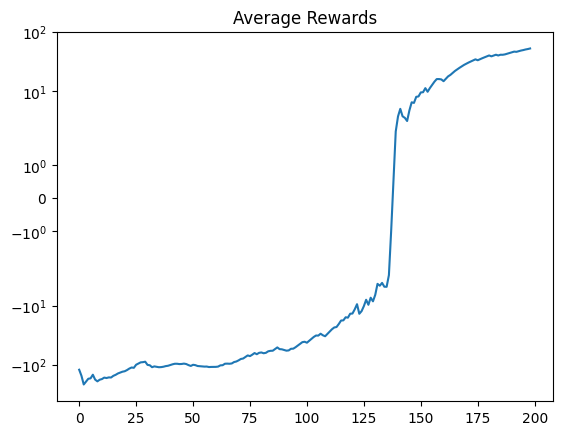

In [1]:
import numpy as np
import gym
from keras.layers import Dense, Activation
from keras.models import Sequential, load_model
import keras
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

!pip3 install box2d-py
!pip3 install gym[Box_2D]


env = gym.make('LunarLander-v2')

class replayBuffer:
    def __init__(self,maxSize,stateDim):
        self.state=np.zeros((maxSize,stateDim))
        self.action=np.zeros(maxSize,dtype= np.int8)
        self.reward=np.zeros(maxSize)
        self.done=np.zeros(maxSize,)
        self.nextState=np.zeros((maxSize,stateDim))
        self.maxSize=maxSize
        self.curser=0
        self.size=0

    def save(self,state,action,reward,nextState,done):
        self.state[self.curser]=state
        self.action[self.curser]=action
        self.reward[self.curser]=reward
        self.nextState[self.curser]=nextState
        self.done[self.curser]=done
        self.curser=(self.curser+1)%self.maxSize
        if self.size<self.maxSize:
            self.size+=1 

    def sample(self,batchSize):
        batchSize=min(self.size,batchSize-1)
        indexes=np.random.choice([i for i in range(self.size-1)],batchSize)
        return self.state[indexes],self.action[indexes],self.reward[indexes],self.nextState[indexes],self.done[indexes]

class Agent:
    def __init__(self,stateShape,actionShape,exploreRate,exploreRateDecay,minimumExploreRate,gamma,copyNetsCycle):
        self.gamma=gamma
        self.exploreRate=exploreRate
        self.exploreRateDecay=exploreRateDecay
        self.minimumExploreRate=minimumExploreRate
        self.actionShape=actionShape
        self.memory=replayBuffer(1000000,stateShape)
        self.model=self.buildModel(stateShape,actionShape)
        self.model.compile(optimizer='Adam',loss='mse')
        self.tModel=self.buildModel(stateShape,actionShape)
        self.tModel.compile(optimizer='Adam',loss='mse')
        self.learnThreshold=0
        self.copyNetsCycle=copyNetsCycle

    def buildModel(self,input,output):
        inputLayer=keras.Input(shape=(input,))
        layer=Dense(256,activation='relu')(inputLayer)
        layer=Dense(256,activation='relu')(layer)
        outputLayer=Dense(output)(layer)
        model=keras.Model(inputs=inputLayer,outputs=outputLayer)
        model.compile(optimizer='Adam',loss='mse')
        return model
    
    def getAction(self,state):
        q=self.model.predict(np.expand_dims(state,axis=0))[0]
        if np.random.random()<=self.exploreRate:
            return np.random.choice([i for i in range(env.action_space.n)])
        else:
            return np.argmax(q)

    def exploreDecay(self):
        self.exploreRate=max(self.exploreRate*self.exploreRateDecay,self.minimumExploreRate)

    def saveModel(self,modelName="DoubleDQN_LunarLanderV2.h"):
        self.model.save_weights(f"{modelName}")

    def loadModel(self,modelName="DoubleDQN_LunarLanderV2.h"):
        self.model.load_weights(f"{modelName}")
        self.tModel.set_weights(self.model.get_weights())
    
    def learn(self,batchSize=64):
        if self.memory.size>batchSize:
            states,actions,rewards,nextStates,done=self.memory.sample(batchSize)
            qState=self.model.predict(states)
            qNextState=self.model.predict(nextStates)
            qNextStateTarget=self.tModel.predict(nextStates)
            maxActions=np.argmax(qNextState,axis=1)
            batchIndex = np.arange(batchSize-1, dtype=np.int32)
            qState[batchIndex,actions]=(rewards+(self.gamma*qNextStateTarget[batchIndex,maxActions.astype(int)]*(1-done)))
            _=self.model.fit(x=states,y=qState,verbose=0)
            self.learnThreshold+=1
            self.exploreDecay()
        if(self.learnThreshold%self.copyNetsCycle)==0:
            self.tModel.set_weights(self.model.get_weights())
            self.saveModel()
            self.learnThreshold=0

agent=Agent(stateShape=env.observation_space.shape[0],actionShape=env.action_space.n\
            ,exploreRate=1.0,exploreRateDecay=0.9995,minimumExploreRate=0.01,gamma=0.99,copyNetsCycle=100)
#agent.loadModel()

averageRewards=[]
totalRewards=[]
for i in range(1,200):
    done=False
    state=env.reset()
    rewards=0
    while not done:
        action=agent.getAction(state)
        nextState,reward,done,info=env.step(action)
        agent.memory.save(state,action,reward,nextState,int(done))
        rewards+=reward
        state=nextState
        agent.learn(batchSize=128)
    totalRewards.append(rewards)
    averageRewards.append(sum(totalRewards)/len(totalRewards))
    print(f"episode: {i}   reward: {rewards}  avg so far:{averageRewards[-1]} exploreRate:{agent.exploreRate}")

# plt.title(f'Total Rewards')
# plt.yscale('symlog')
# plt.plot(totalRewards)
# plt.savefig("Total Rewards",dpi=200)
# plt.clf()
# plt.title(f'Average Rewards')
# plt.yscale('symlog')
# plt.plot(averageRewards)
# plt.savefig("Average Rewards",dpi=200)

In [ ]:
plt.plot(averageRewards)
plt.title('Episodes vs Average Score')
plt.xlabel('Episodes')
plt.ylabel('Average Score')

Text(0.5, 1.0, 'Episodes vs Score')

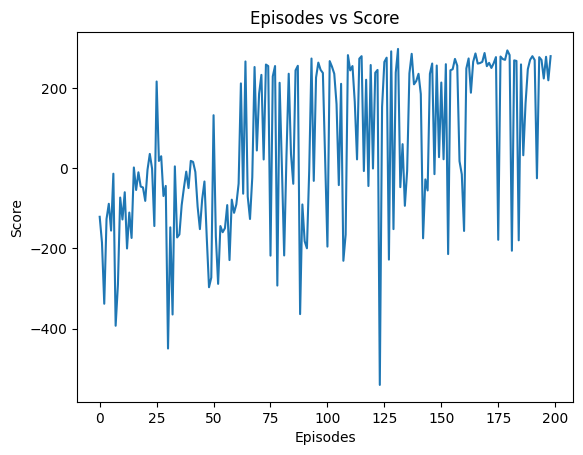

In [4]:
plt.plot(totalRewards)
plt.title('Episodes vs Score')
plt.xlabel('Episodes')
plt.ylabel('Score')

## Dueling Deep Q Network

  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\rutsm\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-o0o39c55\\box2d-py_e2fce51d38c943d1a5890fec23666bbb\\setup.py'"'"'; __file__='"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-o0o39c55\\box2d-py_e2fce51d38c943d1a5890fec23666bbb\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\rutsm\AppData\Local\Temp\pip-wheel-g576hs0u'
       cwd: C:\Users\rutsm\AppData\Local\Temp\pip-install-o0o39c55\box2d-py_e2fce51d38c943d1a5890fec23666bbb\
  Complete output (28 lines):
  Using setuptools (version 58.0.4).
  running bdist_wheel
  running build
  running build_py
  creating build



  Using cached box2d-py-2.3.8.tar.gz (374 kB)
  Running setup.py clean for box2d-py
Failed to build box2d-py
    Running setup.py install for box2d-py: started
    Running setup.py install for box2d-py: finished with status 'error'


episode: 1   reward: -2.2939061677450057  avg so far:-2.2939061677450057 exploreRate:1.0
episode: 1   reward: 0.24454073059682324  avg so far:-1.0246827185740912 exploreRate:1.0
episode: 1   reward: 2.777121339402665  avg so far:0.24258530075149412 exploreRate:1.0
episode: 1   reward: 4.02879346914029  avg so far:1.189137342848693 exploreRate:1.0
episode: 1   reward: 1.1299628921821436  avg so far:1.1773024527153833 exploreRate:1.0
episode: 1   reward: -0.03281886116865462  avg so far:0.9756155670680436 exploreRate:1.0
episode: 1   reward: -0.7298880180627312  avg so far:0.7319721977636472 exploreRate:1.0
episode: 1   reward: -2.487033991653029  avg so far:0.3295964240865627 exploreRate:1.0
episode: 1   reward: -4.270369254308072  avg so far:-0.18151087351284115 exploreRate:1.0
episode: 1   reward: -3.420077389251527  avg so far:-0.5053675250867098 exploreRate:1.0
episode: 1   reward: -5.161230241706302  avg so far:-0.9286277720521273 exploreRate:1.0
episode: 1   reward: -7.90716336710

4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -7.041763092502704  avg so far:-32.41257601025432 exploreRate:0.9995
4/4 [==============================] - 0s 5ms/step
episode: 2   reward: -9.540652007514847  avg so far:-32.23663813331017 exploreRate:0.9990002500000001
4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -11.80268299535812  avg so far:-32.08065374294412 exploreRate:0.9985007498750001
4/4 [==============================] - 0s 4ms/step
episode: 2   reward: -8.702036140843713  avg so far:-31.90354300353427 exploreRate:0.9980014995000627
4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -10.159184086244318  avg so far:-31.740051583103522 exploreRate:0.9975024987503127
4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -12.338521458308712  avg so far:-31.595264044858784 exploreRate:0.9970037475009376
4/4 [==============================] - 0s 5ms/step
episode: 2   reward: -14.19167387142518

4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -126.36531466680493  avg so far:-31.670668434097742 exploreRate:0.9680145820581669
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: 0.18098460920421644  avg so far:-31.506484655524016 exploreRate:0.9675305747671379
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: 1.3092111980655556  avg so far:-31.338199035762017 exploreRate:0.9670468094797544
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: 0.5089863047986705  avg so far:-31.17571339626936 exploreRate:0.9665632860750146
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -2.7042215162600063  avg so far:-31.031188056776926 exploreRate:0.9660800044319772
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -3.734457587545747  avg so far:-30.8933257816798 exploreRate:0.9655969644297613
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -2.7

4/4 [==============================] - 0s 3ms/step
episode: 3   reward: 3.359803770314163  avg so far:-27.400766822727153 exploreRate:0.952645784553907
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: 4.89571542971875  avg so far:-27.257862033999515 exploreRate:0.9521694616616301
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: 2.442716705884509  avg so far:-27.127022480079322 exploreRate:0.9516933769307994
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -0.0594024781255893  avg so far:-27.008304848491804 exploreRate:0.951217530242334
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: 1.4830311897491117  avg so far:-26.883888533914334 exploreRate:0.9507419214772129
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: 1.4448014154875568  avg so far:-26.76072031674302 exploreRate:0.9502665505164744
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -1.0405725

4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -81.27403103130274  avg so far:-30.697745798746855 exploreRate:0.923097878088044
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -83.92251165069823  avg so far:-30.88191453871901 exploreRate:0.9226363291490001
4/4 [==============================] - 0s 2ms/step


Exception ignored in: <function Viewer.__del__ at 0x00000208EFC82430>
Traceback (most recent call last):
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\gym\envs\classic_control\rendering.py", line 165, in __del__
    self.close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\gym\envs\classic_control\rendering.py", line 83, in close
    self.window.close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\pyglet\window\win32\__init__.py", line 299, in close
    super(Win32Window, self).close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\pyglet\window\__init__.py", line 823, in close
    app.windows.remove(self)
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\_weakrefset.py", line 109, in remove
    self.data.remove(ref(item))
KeyError: <weakref at 0x00000208E194D040; to 'Win32Window' at 0x00000208CB11AEE0>


4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -85.81783345928889  avg so far:-31.071348741893384 exploreRate:0.9221750109844257
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -87.71881706893217  avg so far:-31.2660135815052 exploreRate:0.9217139234789336
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -90.3571582678311  avg so far:-31.46838051536248 exploreRate:0.9212530665171942
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -91.7001104553473  avg so far:-31.67394955952625 exploreRate:0.9207924399839357
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -93.66067291587225  avg so far:-31.88478875461586 exploreRate:0.9203320437639437
4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -96.58556665532399  avg so far:-32.10411342546572 exploreRate:0.9198718777420618
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -97.24656336

4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -20.92806352517712  avg so far:-32.15644170335209 exploreRate:0.8931254205528514
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -21.899999909947635  avg so far:-32.12755031801855 exploreRate:0.8926788578425751
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -22.10516915321389  avg so far:-32.099397561937636 exploreRate:0.8922325184136538
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -19.881363103877234  avg so far:-32.0651733757806 exploreRate:0.891786402154447
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -18.312970517751214  avg so far:-32.02675940131684 exploreRate:0.8913405089533699
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -17.338906073208413  avg so far:-31.985846160848563 exploreRate:0.8908948386988933
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -18.03

4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -30.342478514343657  avg so far:-31.56205263342691 exploreRate:0.8793853022912325
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -30.8742296942405  avg so far:-31.56027070871399 exploreRate:0.8789456096400869
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -27.629859524296144  avg so far:-31.550114607462266 exploreRate:0.8785061368352669
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -29.516217400673362  avg so far:-31.544872604351983 exploreRate:0.8780668837668493
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -27.482582162042686  avg so far:-31.534429698330626 exploreRate:0.8776278503249659
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -27.46412705940871  avg so far:-31.523993024897493 exploreRate:0.8771890363998035
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -27

4/4 [==============================] - 0s 3ms/step
episode: 5   reward: 0.3899870371997541  avg so far:-32.7066731530108 exploreRate:0.8525359605109053
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: 0.12485684752017262  avg so far:-32.63338848783104 exploreRate:0.8521096925306499
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: -1.4556023066801245  avg so far:-32.56395021125832 exploreRate:0.8516836376843847
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: -2.0519747071663703  avg so far:-32.49614582124923 exploreRate:0.8512577958655425
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: -2.6064968202922856  avg so far:-32.42987165494999 exploreRate:0.8508321669676098
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: -4.571941378248488  avg so far:-32.36823906584224 exploreRate:0.850406750884126
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: -4.34786

episode: 5   reward: -70.69551908769522  avg so far:-32.68716697979988 exploreRate:0.8269198412196082
4/4 [==============================] - 0s 5ms/step
episode: 5   reward: -71.14631030532571  avg so far:-32.76272521816044 exploreRate:0.8265063812989984
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: -73.32205077308912  avg so far:-32.84225330748383 exploreRate:0.826093128108349
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: -73.78285042625193  avg so far:-32.92237189284345 exploreRate:0.8256800815442948
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: -76.22337511062271  avg so far:-33.00694416475317 exploreRate:0.8252672415035227
4/4 [==============================] - 0s 3ms/step
episode: 5   reward: -77.72646092857984  avg so far:-33.09411671205108 exploreRate:0.824854607882771
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: -76.74807726493302  avg so far:-33.17904659639521 exploreRate:0

4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -28.69167618385092  avg so far:-34.63846971512766 exploreRate:0.8016723718975814
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -29.482671884553927  avg so far:-34.62944029686046 exploreRate:0.8012715357116327
4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -32.01487932657864  avg so far:-34.62486938607326 exploreRate:0.8008708999437769
4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -34.56038992990702  avg so far:-34.62475685648134 exploreRate:0.8004704644938051
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -36.34625415919342  avg so far:-34.6277559807021 exploreRate:0.8000702292615582
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -37.00782312741984  avg so far:-34.63189522791378 exploreRate:0.7996701941469275
4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -38.506480

4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -19.131280862895522  avg so far:-35.881099597030435 exploreRate:0.7775845491402175
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -18.532114628571282  avg so far:-35.85364867144743 exploreRate:0.7771957568656473
4/4 [==============================] - 0s 3ms/step
episode: 7   reward: -21.675544936882023  avg so far:-35.83125040330436 exploreRate:0.7768071589872145
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -23.38217319429369  avg so far:-35.81161463483589 exploreRate:0.776418755407721
4/4 [==============================] - 0s 3ms/step
episode: 7   reward: -26.441284051654055  avg so far:-35.79685820872064 exploreRate:0.7760305460300172
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -27.49379514411843  avg so far:-35.78380307811592 exploreRate:0.7756425307570022
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: -29.18

episode: 8   reward: -13.210692470158303  avg so far:-38.51210260326605 exploreRate:0.7542204923819443
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -13.28120306792601  avg so far:-38.47569437882833 exploreRate:0.7538433821357534
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -13.970486682873696  avg so far:-38.44038428128373 exploreRate:0.7534664604446856
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -13.88018555363804  avg so far:-38.405045865848265 exploreRate:0.7530897272144633
4/4 [==============================] - 0s 4ms/step
episode: 8   reward: -13.394004666484571  avg so far:-38.36911046182619 exploreRate:0.7527131823508562
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -15.281453321663555  avg so far:-38.33598613307416 exploreRate:0.7523368257596807
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -14.954551794415101  avg so far:-38.30248837614198 explo

4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -81.69175162280305  avg so far:-38.44100244880513 exploreRate:0.7311926754228393
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -84.74516294946943  avg so far:-38.50233246271329 exploreRate:0.7308270790851279
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -87.57993471209373  avg so far:-38.56724992600612 exploreRate:0.7304616655455853
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -91.98463758245391  avg so far:-38.63781450679403 exploreRate:0.7300964347128126
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -94.51984726702709  avg so far:-38.711537505158454 exploreRate:0.7297313864954562
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -96.8312266663619  avg so far:-38.78811153567387 exploreRate:0.7293665208022085
4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -99.456586

4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 17.601848768782215  avg so far:-38.21602651274455 exploreRate:0.7092225537316325
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 16.877066325063165  avg so far:-38.148510467600175 exploreRate:0.7088679424547667
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 21.67761976795186  avg so far:-38.07528387000464 exploreRate:0.7085135084835393
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 25.164853632386855  avg so far:-37.99797318846137 exploreRate:0.7081592517292976
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 29.258672091057264  avg so far:-37.91585274245463 exploreRate:0.707805172103433
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 32.50419699016841  avg so far:-37.829974633024605 exploreRate:0.7074512695173812
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 31.91879792

4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 57.220326417737596  avg so far:-35.370900913205176 exploreRate:0.6986609846595448
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 61.29199123853114  avg so far:-35.25664217543717 exploreRate:0.6983116541672151
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 60.084754192207114  avg so far:-35.14407854336203 exploreRate:0.6979624983401315
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 58.78601828960038  avg so far:-35.03331191973825 exploreRate:0.6976135170909614
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 60.96705585489417  avg so far:-34.92023728160559 exploreRate:0.697264710332416
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: 59.808394929248706  avg so far:-34.80879183194576 exploreRate:0.6969160779772499
4/4 [==============================] - 0s 3ms/step
episode: 9   reward: 58.8475816773

4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -76.15489110290268  avg so far:-33.56436833581609 exploreRate:0.6780073452576348
4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -77.40907760878197  avg so far:-33.61276205466042 exploreRate:0.6776683415850061
4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -80.76856753300164  avg so far:-33.66475301990667 exploreRate:0.6773295074142136
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -83.08168889033281  avg so far:-33.71917695808995 exploreRate:0.6769908426605066
4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -86.44763337067651  avg so far:-33.777184060854076 exploreRate:0.6766523472391763
4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -91.83034137380315  avg so far:-33.840978739219956 exploreRate:0.6763140210655568
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -

episode: 11   reward: 9.574222750918862  avg so far:-37.386493992598524 exploreRate:0.658293410227447
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: 9.941377879772915  avg so far:-37.33744956578778 exploreRate:0.6579642635223334
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: 10.366053785189564  avg so far:-37.288067057142875 exploreRate:0.6576352813905723
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: 5.202647180819622  avg so far:-37.24412629784818 exploreRate:0.657306463749877
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: 1.8194628755189175  avg so far:-37.20377135035504 exploreRate:0.6569778105180021
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: 2.2050061098718974  avg so far:-37.16310181737235 exploreRate:0.6566493216127431
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: 2.2120992211656816  avg so far:-37.122508826610975 explor

4/4 [==============================] - 0s 3ms/step
episode: 11   reward: -134.4063306289703  avg so far:-37.9675575983758 exploreRate:0.6388331068556816
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -135.87529091266757  avg so far:-38.063077338194624 exploreRate:0.6385136903022538
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: -138.21573600710192  avg so far:-38.16069201525983 exploreRate:0.6381944334571027
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -145.74169572583602  avg so far:-38.2654446965749 exploreRate:0.6378753362403742
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: -146.82208217620177  avg so far:-38.37104453848116 exploreRate:0.637556398572254
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: -152.52212636630344  avg so far:-38.48197853442656 exploreRate:0.6372376203729679
4/4 [==============================] - 0s 3ms/step
episode: 11   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -323.4361690619801  avg so far:-47.48414176720362 exploreRate:0.6199480840524855
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -2.3095372721580985  avg so far:-47.44250618702385 exploreRate:0.6196381100104592
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -3.479101622355289  avg so far:-47.40202423070279 exploreRate:0.619328290955454
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: -7.455257480097235  avg so far:-47.365274675274456 exploreRate:0.6190186268099763
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -8.90684481532259  avg so far:-47.329926853711996 exploreRate:0.6187091174965714
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -8.327746553015233  avg so far:-47.29411217942302 exploreRate:0.6183997629378232
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -7

4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -46.43707003122499  avg so far:-45.70916942874696 exploreRate:0.6022234083716455
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -43.60267903415988  avg so far:-45.707326480020285 exploreRate:0.6019222966674597
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -44.403747351779955  avg so far:-45.706186987775325 exploreRate:0.601621335519126
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -45.7591780163022  avg so far:-45.70623326814959 exploreRate:0.6013205248513664
4/4 [==============================] - 0s 3ms/step
episode: 12   reward: -49.619330561318975  avg so far:-45.709647838213435 exploreRate:0.6010198645889407
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: -53.16532155931958  avg so far:-45.71614798967037 exploreRate:0.6007193546566463
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 

4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -3.111234339334075  avg so far:-47.572948420176154 exploreRate:0.5847129887141925
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -2.3550750672560836  avg so far:-47.53532955715376 exploreRate:0.5844206322198354
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -1.3853885231032648  avg so far:-47.49696717890434 exploreRate:0.5841284219037255
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -3.150386426932661  avg so far:-47.46013447063858 exploreRate:0.5838363576927736
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: -4.8989338812802625  avg so far:-47.42481397222418 exploreRate:0.5835444395139273
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -4.938863586123156  avg so far:-47.389585157642 exploreRate:0.5832526672941704
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -

4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -17.234005956406698  avg so far:-45.71946430573576 exploreRate:0.5677117070150417
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: -17.357772107812174  avg so far:-45.69697287655422 exploreRate:0.5674278511615342
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: -18.989735661677635  avg so far:-45.67581024801628 exploreRate:0.5671441372359535
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: -19.058078412985687  avg so far:-45.65473524260454 exploreRate:0.5668605651673355
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: -19.9581753470489  avg so far:-45.63440568572514 exploreRate:0.5665771348847519
4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -17.432575145023375  avg so far:-45.612111748538815 exploreRate:0.5662938463173096
4/4 [==============================] - 0s 3ms/step
episode: 13   reward

4/4 [==============================] - 0s 3ms/step
episode: 14   reward: 0.7642787837743652  avg so far:-44.14124784158532 exploreRate:0.5514804996834843
4/4 [==============================] - 0s 3ms/step
episode: 14   reward: 0.9786071516353343  avg so far:-44.10704021839106 exploreRate:0.5512047594336427
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: 2.3227431970866244  avg so far:-44.071866140046005 exploreRate:0.5509291570539259
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: 0.27963591558949696  avg so far:-44.03829195226732 exploreRate:0.550653692475399
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -1.137055619393775  avg so far:-44.00584018499586 exploreRate:0.5503783656291613
4/4 [==============================] - 0s 3ms/step
episode: 14   reward: -0.8782403136932124  avg so far:-43.97324184798051 exploreRate:0.5501031764463468
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: 2

episode: 14   reward: 30.898969214990746  avg so far:-42.229791948298804 exploreRate:0.5354454953177946
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -69.10103078500926  avg so far:-42.24929212162007 exploreRate:0.5351777725701358
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -1.3362235216902718  avg so far:-42.21962347143883 exploreRate:0.5349101836838507
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -3.04194159215416  avg so far:-42.19123384688863 exploreRate:0.5346427285920088
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -2.6116873813928576  avg so far:-42.162573784277846 exploreRate:0.5343754072277128
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -4.703768113649505  avg so far:-42.135469004487234 exploreRate:0.534108219524099
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -6.863219996059189  avg so far:-42.10996484757585 e

4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -28.720475770813323  avg so far:-41.66049495507912 exploreRate:0.5272080358759129
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -30.60611346743845  avg so far:-41.65264940398782 exploreRate:0.526944431857975
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -32.75856905972746  avg so far:-41.64634154558764 exploreRate:0.5266809596420461
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -34.952869614735064  avg so far:-41.64159776675641 exploreRate:0.5264176191622251
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -37.17413146364116  avg so far:-41.6384338387797 exploreRate:0.526154410352644
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -39.40971255784554  avg so far:-41.63685654134097 exploreRate:0.5258913331474677
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -42.

4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -61.389959837883964  avg so far:-42.64262137549718 exploreRate:0.5126473712290808
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -58.08676253625427  avg so far:-42.65316345137483 exploreRate:0.5123910475434663
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -53.98360228435378  avg so far:-42.660892263675635 exploreRate:0.5121348520196947
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -51.654185928108674  avg so far:-42.667022661538226 exploreRate:0.5118787845936849
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -44.062254125687815  avg so far:-42.66797309169092 exploreRate:0.511622845201388
4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -41.412026310983975  avg so far:-42.66711812451549 exploreRate:0.5113670337787873
4/4 [==============================] - 0s 2ms/step
episode: 15   reward

episode: 16   reward: 3.5538485668105135  avg so far:-42.20501899273787 exploreRate:0.49799048522941153
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 4.674577109831559  avg so far:-42.174237905342885 exploreRate:0.49774148998679685
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 5.49515850050976  avg so far:-42.14295877384298 exploreRate:0.4974926192418035
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 6.077456824898278  avg so far:-42.11133882918807 exploreRate:0.49724387293218264
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 6.3770262099276795  avg so far:-42.079564015925214 exploreRate:0.49699525099571656
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 6.428024282575524  avg so far:-42.047797422409495 exploreRate:0.49674675337021873
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 5.848830912040217  avg so far:-42.016451461457635 e

4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -56.57298867600865  avg so far:-41.766182005815814 exploreRate:0.4908199425080738
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -59.70647236558575  avg so far:-41.777741471253805 exploreRate:0.4905745325368198
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -62.61380401506675  avg so far:-41.791158124533794 exploreRate:0.49032924527055144
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -65.10725217475927  avg so far:-41.806162046059036 exploreRate:0.4900840806479162
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: -67.34190907973583  avg so far:-41.822583748331496 exploreRate:0.48983903860759226
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -69.39265320323848  avg so far:-41.84030230196576 exploreRate:0.4895941190882885
4/4 [==============================] - 0s 3ms/step
episode: 16   rewa

episode: 16   reward: 5.903486844833614  avg so far:-42.329818489351396 exploreRate:0.4770256281831953
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 13.99156777063803  avg so far:-42.29481452026501 exploreRate:0.47678711536910373
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 16.390586542504938  avg so far:-42.25836396059869 exploreRate:0.4765487218114192
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 18.6142732862231  avg so far:-42.220578338471555 exploreRate:0.47631044745051354
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 20.56266757989872  avg so far:-42.18163091544527 exploreRate:0.4760722922267883
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 38.173944509109006  avg so far:-42.13181344773011 exploreRate:0.475834256080675
4/4 [==============================] - 0s 3ms/step
episode: 16   reward: 45.12849129767126  avg so far:-42.07774882273296 explore

4/4 [==============================] - 0s 3ms/step
episode: 17   reward: 40.272949738740785  avg so far:-40.29140794450971 exploreRate:0.4631554949058566
4/4 [==============================] - 0s 4ms/step
episode: 17   reward: 40.20161706211065  avg so far:-40.243150735273126 exploreRate:0.4629239171584037
4/4 [==============================] - 0s 3ms/step
episode: 17   reward: 41.396147319333316  avg so far:-40.19423563757714 exploreRate:0.46269245519982455
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 43.07330308400771  avg so far:-40.144374835947445 exploreRate:0.46246110897222464
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 45.39282823665598  avg so far:-40.093185606101486 exploreRate:0.46222987841773855
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 45.34004612749154  avg so far:-40.042089175638814 exploreRate:0.4619987634785297
4/4 [==============================] - 0s 3ms/step
episode: 17   reward: 

4/4 [==============================] - 0s 4ms/step
episode: 18   reward: -8.592913966690812  avg so far:-38.05517193824261 exploreRate:0.4501386797263858
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -11.825563785798149  avg so far:-38.03996636829916 exploreRate:0.44991361038652267
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: -14.624930350537108  avg so far:-38.02640029876395 exploreRate:0.4496886535813294
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: -13.699667527148774  avg so far:-38.01231417671901 exploreRate:0.44946380925453877
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -11.229108802051769  avg so far:-37.996814636571635 exploreRate:0.44923907734991153
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -14.50826213943557  avg so far:-37.98322958596601 exploreRate:0.4490144578112366
4/4 [==============================] - 0s 3ms/step
episode: 18   rew

episode: 18   reward: 25.77453229226221  avg so far:-37.648878340075456 exploreRate:0.4377065506349272
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 26.97572372004861  avg so far:-37.61259276901418 exploreRate:0.43748769735960974
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 32.07421456259334  avg so far:-37.57348681652731 exploreRate:0.43726895351093
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 32.75598716589457  avg so far:-37.53404235551641 exploreRate:0.4370503190341745
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 38.529109504618205  avg so far:-37.49140605963069 exploreRate:0.4368317938746575
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: 39.0670162783605  avg so far:-37.44851618717243 exploreRate:0.43661337797772015
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: 46.118454226588824  avg so far:-37.401726170143455 exploreR

4/4 [==============================] - 0s 2ms/step
episode: 18   reward: 67.52224641295875  avg so far:-35.97691015804692 exploreRate:0.4311883315744751
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 64.58771458664395  avg so far:-35.921380271385026 exploreRate:0.4309727374086879
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: 81.12127238204313  avg so far:-35.856787195969225 exploreRate:0.4307572510399836
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: 82.97669625959422  avg so far:-35.791241976192296 exploreRate:0.4305418724144636
4/4 [==============================] - 0s 3ms/step
episode: 18   reward: -17.02330374040578  avg so far:-35.78089581398955 exploreRate:0.4303266014782564
4/4 [==============================] - 0s 3ms/step
episode: 19   reward: -0.18189014276612056  avg so far:-35.76128203676023 exploreRate:0.4301114381775173
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 0.

4/4 [==============================] - 0s 3ms/step
episode: 19   reward: 14.71227489873866  avg so far:-34.67936665996162 exploreRate:0.41906994178663465
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 12.787580366499416  avg so far:-34.65395608874831 exploreRate:0.4188604068157413
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 10.848402117063248  avg so far:-34.629610257712564 exploreRate:0.41865097661233347
4/4 [==============================] - 0s 3ms/step
episode: 19   reward: 8.899002135292111  avg so far:-34.606332924882075 exploreRate:0.4184416511240273
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 11.089750690614963  avg so far:-34.581909577145304 exploreRate:0.4182324302984653
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 13.237023622029394  avg so far:-34.55636527522267 exploreRate:0.4180233140833161
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 1.2195747840124247  avg so far:-33.36404042191836 exploreRate:0.4070884888281836
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 0.23896883596919194  avg so far:-33.34659337661313 exploreRate:0.40688494458376956
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -0.5446609332541599  avg so far:-33.3295710971926 exploreRate:0.4066815021114777
4/4 [==============================] - 0s 5ms/step
episode: 19   reward: -1.285385263506976  avg so far:-33.31295066885563 exploreRate:0.406478161360422
4/4 [==============================] - 0s 4ms/step
episode: 19   reward: -2.0477892306402286  avg so far:-33.296742705435086 exploreRate:0.40627492227974177
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 1.3497251885474837  avg so far:-33.278791167666185 exploreRate:0.4060717848186019
4/4 [==============================] - 0s 2ms/step
episode: 19   reward

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 13.365442147448238  avg so far:-32.90580990036326 exploreRate:0.40142755366374583
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 13.007499145970275  avg so far:-32.882312812826754 exploreRate:0.401226839886914
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.640570913307176  avg so far:-32.85902745030699 exploreRate:0.40102622646697056
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 16.174394861128235  avg so far:-32.83395923849133 exploreRate:0.4008257133537371
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 16.326532321643526  avg so far:-32.808838905553095 exploreRate:0.4006253004970603
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 18.96237676335546  avg so far:-32.782398039532204 exploreRate:0.4004249878468118
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 

4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 18.97238863888962  avg so far:-32.11610696436029 exploreRate:0.3956474162746913
4/4 [==============================] - 0s 5ms/step
episode: 20   reward: 16.36097492714476  avg so far:-32.091660629568814 exploreRate:0.395449592566554
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 17.758893541424005  avg so far:-32.06653434218424 exploreRate:0.3952518677702707
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 15.97830338565861  avg so far:-32.04233039370674 exploreRate:0.3950542418363856
4/4 [==============================] - 0s 4ms/step
episode: 20   reward: 18.402985002899612  avg so far:-32.01692993278196 exploreRate:0.3948567147154674
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 16.960328167053945  avg so far:-31.992281086229454 exploreRate:0.3946592863581097
4/4 [==============================] - 0s 5ms/step
episode: 20   reward: 21.32

4/4 [==============================] - 0s 5ms/step
episode: 20   reward: -11.296280799484274  avg so far:-31.579630999680607 exploreRate:0.3899505068253519
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -8.349763639889002  avg so far:-31.56808533995904 exploreRate:0.3897555315719392
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: -9.905207874132822  avg so far:-31.55732385090498 exploreRate:0.38956065380615323
4/4 [==============================] - 0s 4ms/step
episode: 20   reward: -11.481664682117492  avg so far:-31.54735579769307 exploreRate:0.38936587347925017
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -12.956651999849633  avg so far:-31.53812964196213 exploreRate:0.3891711905425106
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -9.928825048933572  avg so far:-31.527410740874316 exploreRate:0.38897660494723935
4/4 [==============================] - 0s 2ms/step
episode: 20   rew

episode: 21   reward: -13.200471834014557  avg so far:-30.91755912709292 exploreRate:0.37918068130607124
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -12.272116200726753  avg so far:-30.908542955465084 exploreRate:0.3789910909654182
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -9.989283061004073  avg so far:-30.898432148362883 exploreRate:0.3788015954199355
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -12.66072488489027  avg so far:-30.889621661762167 exploreRate:0.37861219462222556
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: -14.901686611259718  avg so far:-30.881901751066607 exploreRate:0.37842288852491446
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: -17.147390859617243  avg so far:-30.875273126118998 exploreRate:0.37823367708065203
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: -19.10735736694539  avg so far:-30.869596

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 6.740062441357935  avg so far:-30.225466735820408 exploreRate:0.36852394743920824
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: 5.241688295059135  avg so far:-30.208776309923525 exploreRate:0.3683396854654887
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: 5.967881525020756  avg so far:-30.19176000802562 exploreRate:0.36815551562275595
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 4.054705941403497  avg so far:-30.175659177772012 exploreRate:0.3679714378649446
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 4.005175766961965  avg so far:-30.159596755335574 exploreRate:0.3677874521460121
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 3.020922400018744  avg so far:-30.144011729898583 exploreRate:0.36760355841993914
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 6

episode: 22   reward: 11.830343899253734  avg so far:-29.3019770617637 exploreRate:0.358345890111091
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 11.398205148495038  avg so far:-29.283315813615946 exploreRate:0.3581667171660355
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 10.97557760809488  avg so far:-29.2648653583356 exploreRate:0.35798763380745247
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 12.612336269187704  avg so far:-29.24568203189148 exploreRate:0.35780863999054874
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 12.29889634600546  avg so far:-29.226659789044454 exploreRate:0.3576297356705535
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: 13.875674889241019  avg so far:-29.20693332008414 exploreRate:0.35745092080271823
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 13.665537514465562  avg so far:-29.187321027845098 exp

4/4 [==============================] - 0s 3ms/step
episode: 22   reward: 1.0418620217745191  avg so far:-28.0360167752721 exploreRate:0.3482747104031893
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -1.3684996515286652  avg so far:-28.02410099460912 exploreRate:0.34810057304798775
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: -3.7240479246575102  avg so far:-28.01324791150508 exploreRate:0.3479265227614638
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -6.0144190634292265  avg so far:-28.003427005769332 exploreRate:0.3477525595000831
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: 1.6516174635770442  avg so far:-27.990194054198895 exploreRate:0.3475786832203331
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: -1.7471105202446409  avg so far:-27.97848884298839 exploreRate:0.3474048938787229
4/4 [==============================] - 0s 2ms/step
episode: 22   rewar

4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 10.211190684820755  avg so far:-27.667116224579214 exploreRate:0.34343163424379963
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 11.949397299057345  avg so far:-27.649633208902408 exploreRate:0.34325991842667775
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 11.489897862491313  avg so far:-27.632368307679915 exploreRate:0.3430882884674644
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 8.417304640895505  avg so far:-27.616473390154088 exploreRate:0.3429167443232307
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 4.26729678646731  avg so far:-27.602421486153816 exploreRate:0.3427452859510691
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 0.8148438909317948  avg so far:-27.589902867044966 exploreRate:0.3425739133080936
4/4 [==============================] - 0s 3ms/step
episode: 23   reward

4/4 [==============================] - 0s 3ms/step
episode: 23   reward: -40.58945212948315  avg so far:-27.571407114116507 exploreRate:0.33394658751641176
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -41.67016271614885  avg so far:-27.577478929621254 exploreRate:0.33377961422265356
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -38.34801446596916  avg so far:-27.5821154063911 exploreRate:0.33361272441554224
4/4 [==============================] - 0s 5ms/step
episode: 23   reward: -39.44731658299182  avg so far:-27.58722091464265 exploreRate:0.3334459180533345
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -38.79188103072674  avg so far:-27.592040123294726 exploreRate:0.33327919509430787
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -39.87247540772286  avg so far:-27.597319760132397 exploreRate:0.3331125554967607
4/4 [==============================] - 0s 4ms/step
episode: 23   rewa

4/4 [==============================] - 0s 3ms/step
episode: 23   reward: -52.19978110741826  avg so far:-27.811104320306573 exploreRate:0.3291381055404394
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -52.87425189953376  avg so far:-27.821764953049758 exploreRate:0.3289735364876692
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: -51.664814985672066  avg so far:-27.831902304254104 exploreRate:0.3288090497194254
4/4 [==============================] - 0s 5ms/step
episode: 23   reward: -52.449844483873434  avg so far:-27.842364668121345 exploreRate:0.32864464519456565
4/4 [==============================] - 0s 5ms/step
episode: 23   reward: -53.27323336498286  avg so far:-27.853167925851533 exploreRate:0.3284803228719684
4/4 [==============================] - 0s 4ms/step
episode: 23   reward: -54.149638022231514  avg so far:-27.864334155191823 exploreRate:0.3283160827105324
4/4 [==============================] - 0s 4ms/step
episode: 23   r

4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -41.73214008451681  avg so far:-27.720143696830796 exploreRate:0.3200478238088536
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: -43.38435283064175  avg so far:-27.726651469632547 exploreRate:0.3198877998969492
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: -44.76800486659622  avg so far:-27.733728443634607 exploreRate:0.31972785599700076
4/4 [==============================] - 0s 5ms/step
episode: 24   reward: -45.505371144817225  avg so far:-27.741105630310066 exploreRate:0.31956799206900227
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: -43.409270556817  avg so far:-27.74760694355758 exploreRate:0.31940820807296777
4/4 [==============================] - 0s 5ms/step
episode: 24   reward: -40.81288706897028  avg so far:-27.75302597305796 exploreRate:0.3192485039689313
4/4 [==============================] - 0s 2ms/step
episode: 24   rewar

4/4 [==============================] - 0s 2ms/step
episode: 24   reward: 21.824054618873035  avg so far:-27.35268575011628 exploreRate:0.31120860149751933
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: 21.345916058770452  avg so far:-27.33291368279639 exploreRate:0.3110529971967706
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: 20.910933471216886  avg so far:-27.3133341993735 exploreRate:0.31089747069817225
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: 20.101650219152027  avg so far:-27.29409891157694 exploreRate:0.3107420219628232
4/4 [==============================] - 0s 4ms/step
episode: 24   reward: 21.56408451047155  avg so far:-27.27428618512842 exploreRate:0.3105866509518418
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: 20.08030689601273  avg so far:-27.255090971070402 exploreRate:0.31043135762636587
4/4 [==============================] - 0s 4ms/step
episode: 24   reward: 20

4/4 [==============================] - 0s 2ms/step
episode: 24   reward: 38.07316881192772  avg so far:-26.02519208052855 exploreRate:0.30261350473635873
4/4 [==============================] - 0s 6ms/step
episode: 24   reward: 37.53716037727377  avg so far:-25.99995891162907 exploreRate:0.30246219798399054
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: 34.998090589720356  avg so far:-25.97575333643012 exploreRate:0.3023109668849986
4/4 [==============================] - 0s 4ms/step
episode: 24   reward: 52.92017960459492  avg so far:-25.944457845378544 exploreRate:0.3021598114015561
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: 49.85918133507356  avg so far:-25.914400890905725 exploreRate:0.3020087314958554
4/4 [==============================] - 0s 4ms/step
episode: 24   reward: 52.830879193253054  avg so far:-25.883189919806178 exploreRate:0.3018577271301075
4/4 [==============================] - 0s 3ms/step
episode: 24   reward: -4

4/4 [==============================] - 0s 5ms/step
episode: 25   reward: 12.50467961805142  avg so far:-25.260919679398345 exploreRate:0.2942557911579837
4/4 [==============================] - 0s 5ms/step
episode: 25   reward: 11.598211075320897  avg so far:-25.246605453862532 exploreRate:0.29410866326240476
4/4 [==============================] - 0s 5ms/step
episode: 25   reward: 10.691520182630107  avg so far:-25.23265431813408 exploreRate:0.29396160893077355
4/4 [==============================] - 0s 4ms/step
episode: 25   reward: 9.788044424402152  avg so far:-25.219064601897166 exploreRate:0.2938146281263082
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 8.890878525096376  avg so far:-25.205833436991426 exploreRate:0.29366772081224507
4/4 [==============================] - 0s 3ms/step
episode: 25   reward: 8.002777786749071  avg so far:-25.192956891344377 exploreRate:0.293520886951839
4/4 [==============================] - 0s 4ms/step
episode: 25   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 4.365892724006333  avg so far:-24.545714612897378 exploreRate:0.28612890460868984
4/4 [==============================] - 0s 5ms/step
episode: 26   reward: 5.458113164542827  avg so far:-24.534310649469994 exploreRate:0.2859858401563855
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 6.218081736825189  avg so far:-24.522626609809546 exploreRate:0.2858428472363073
4/4 [==============================] - 0s 4ms/step
episode: 26   reward: 6.72010961162585  avg so far:-24.510760777594797 exploreRate:0.28569992581268916
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 6.868955687501092  avg so far:-24.49884744560349 exploreRate:0.28555707584978285
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 6.556778178378104  avg so far:-24.48706162942741 exploreRate:0.28541429731185797
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 5.

episode: 26   reward: -7.270220013898281  avg so far:-24.50808687349158 exploreRate:0.2785049052845831
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.137318281798544  avg so far:-24.50161731349467 exploreRate:0.2783656528319408
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -5.625128034779853  avg so far:-24.494589581075193 exploreRate:0.27822647000552486
4/4 [==============================] - 0s 3ms/step
episode: 26   reward: -2.73190284189986  avg so far:-24.4864903303349 exploreRate:0.2780873567705221
4/4 [==============================] - 0s 4ms/step
episode: 26   reward: -3.5473634698233303  avg so far:-24.47870047659215 exploreRate:0.27794831309213686
4/4 [==============================] - 0s 5ms/step
episode: 26   reward: -0.329114587008144  avg so far:-24.469719596752213 exploreRate:0.2778093389355908
4/4 [==============================] - 0s 5ms/step
episode: 26   reward: -1.328870199545684  avg so far:-24.461117050507898 

4/4 [==============================] - 0s 6ms/step
episode: 26   reward: 11.87541011728005  avg so far:-23.713184417710096 exploreRate:0.2706776271489703
4/4 [==============================] - 0s 5ms/step
episode: 26   reward: 10.160832254472362  avg so far:-23.700830655247593 exploreRate:0.27054228833539584
4/4 [==============================] - 0s 4ms/step
episode: 26   reward: 10.654086212803056  avg so far:-23.68830607746121 exploreRate:0.27040701719122817
4/4 [==============================] - 0s 3ms/step
episode: 26   reward: 13.767171151062602  avg so far:-23.674656122203 exploreRate:0.2702718136826326
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 11.252740966262428  avg so far:-23.661932115977695 exploreRate:0.2701366777757913
4/4 [==============================] - 0s 3ms/step
episode: 26   reward: 8.432812349811293  avg so far:-23.650244299347765 exploreRate:0.27000160943690343
4/4 [==============================] - 0s 6ms/step
episode: 26   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -61.880149999572936  avg so far:-23.582359581970874 exploreRate:0.26691360890771537
4/4 [==============================] - 0s 4ms/step
episode: 26   reward: -69.22853140642225  avg so far:-23.59883834436237 exploreRate:0.2667801521032615
4/4 [==============================] - 0s 6ms/step
episode: 26   reward: -67.08164999307895  avg so far:-23.614530445282153 exploreRate:0.2666467620272099
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.071697249656282  avg so far:-23.608562612238998 exploreRate:0.2665134386461963
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -13.616190101787694  avg so far:-23.604959160197726 exploreRate:0.26638018192687324
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 31.343491102997575  avg so far:-23.585150778704143 exploreRate:0.26624699183590983
4/4 [==============================] - 0s 5ms/step
episode: 26   r

4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -65.3018492615749  avg so far:-23.57180892938003 exploreRate:0.2596717066908624
4/4 [==============================] - 0s 3ms/step
episode: 27   reward: -61.902475792153496  avg so far:-23.585377307030573 exploreRate:0.259541870837517
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -62.6340306128628  avg so far:-23.5991949479739 exploreRate:0.25941209990209824
4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -56.34431891494303  avg so far:-23.610777941948772 exploreRate:0.2592823938521472
4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -53.86219952505485  avg so far:-23.621475050005035 exploreRate:0.25915275265522114
4/4 [==============================] - 0s 3ms/step
episode: 27   reward: -54.678948796353325  avg so far:-23.63245330159441 exploreRate:0.25902317627889354
4/4 [==============================] - 0s 5ms/step
episode: 27   reward:

4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -8.567804641476206  avg so far:-23.636658883988574 exploreRate:0.25249997867819207
4/4 [==============================] - 0s 3ms/step
episode: 27   reward: -6.268190622643041  avg so far:-23.630630259114803 exploreRate:0.252373728688853
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -5.867309368118932  avg so far:-23.624466719596757 exploreRate:0.2522475418245086
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -5.460622765368819  avg so far:-23.618166392175937 exploreRate:0.25212141805359634
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -4.401689399127118  avg so far:-23.6115032586832 exploreRate:0.25199535734456957
4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -1.8484075759586025  avg so far:-23.60395972465106 exploreRate:0.2518693596658973
4/4 [==============================] - 0s 2ms/step
episode: 27   rewar

episode: 27   reward: -18.582940126699416  avg so far:-23.478789869881574 exploreRate:0.24911329379518618
4/4 [==============================] - 0s 5ms/step
episode: 27   reward: 23.950031921440537  avg so far:-23.462480096225683 exploreRate:0.2489887371482886
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 9.676698384346563  avg so far:-23.451088147624596 exploreRate:0.24886424277971447
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 18.553428497908868  avg so far:-23.436653605822006 exploreRate:0.24873981065832462
4/4 [==============================] - 0s 5ms/step
episode: 27   reward: -81.44657150209113  avg so far:-23.456581437459338 exploreRate:0.24861544075299546
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -1.3284857468129019  avg so far:-23.448982503499636 exploreRate:0.248491133032619
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -0.4626135146095465  avg so far:-23.44109154

4/4 [==============================] - 0s 3ms/step
episode: 28   reward: -115.3633300472431  avg so far:-23.807457931236158 exploreRate:0.24223317269841077
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -120.58648813260092  avg so far:-23.840109425905982 exploreRate:0.24211205611206157
4/4 [==============================] - 0s 3ms/step
episode: 28   reward: -125.93878933359281  avg so far:-23.87454405656625 exploreRate:0.24199100008400556
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -131.59360392303338  avg so far:-23.910862013365463 exploreRate:0.24187000458396357
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -137.45964695616334  avg so far:-23.94913258463031 exploreRate:0.2417490695816716
4/4 [==============================] - 0s 6ms/step
episode: 28   reward: -143.54713275247863  avg so far:-23.989428406789283 exploreRate:0.2416281950468808
4/4 [==============================] - 0s 5ms/step
episode: 28 

4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -64.30880239225077  avg so far:-24.39792028434528 exploreRate:0.23566090027836173
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -68.26396044067106  avg so far:-24.412450274459996 exploreRate:0.23554306982822257
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: -71.9934055041122  avg so far:-24.42820555764862 exploreRate:0.23542529829330847
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -75.39748414430774  avg so far:-24.445077215572045 exploreRate:0.23530758564416182
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -78.64047443616663  avg so far:-24.463010834771445 exploreRate:0.23518993185133974
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -81.4703868499753  avg so far:-24.48186871635107 exploreRate:0.2350723368854141
4/4 [==============================] - 0s 3ms/step
episode: 29   rewar

4/4 [==============================] - 0s 2ms/step
episode: 29   reward: -31.15848639231409  avg so far:-25.808725615345534 exploreRate:0.2292669468072913
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -61.086875222742165  avg so far:-25.82020191645399 exploreRate:0.22915231333388766
4/4 [==============================] - 0s 5ms/step
episode: 29   reward: -80.47158647650974  avg so far:-25.837974724441004 exploreRate:0.22903773717722073
4/4 [==============================] - 0s 5ms/step
episode: 29   reward: -84.65220163466738  avg so far:-25.857095084294784 exploreRate:0.22892321830863213
4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -112.2974429608652  avg so far:-25.8851874950444 exploreRate:0.22880875669947784
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: -127.80019212763604  avg so far:-25.918298282774284 exploreRate:0.2286943523211281
4/4 [==============================] - 0s 2ms/step
episode: 29   re

4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -96.61609500974296  avg so far:-26.35654245961847 exploreRate:0.22304647413401948
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -99.94144971449492  avg so far:-26.38005952809238 exploreRate:0.22293495089695248
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -103.12015626867046  avg so far:-26.404577130884903 exploreRate:0.22282348342150401
4/4 [==============================] - 0s 5ms/step
episode: 30   reward: -105.92438622989675  avg so far:-26.429974706451496 exploreRate:0.2227120716797933
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -108.22591268440229  avg so far:-26.456090906316742 exploreRate:0.2226007156439534
4/4 [==============================] - 0s 6ms/step
episode: 30   reward: -110.2592600409738  avg so far:-26.482839444182893 exploreRate:0.22248941528613142
4/4 [==============================] - 0s 3ms/step
episode: 30   

4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -92.78443057142037  avg so far:-27.060756137607452 exploreRate:0.22005483775404105
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -88.70809048635405  avg so far:-27.0802895135101 exploreRate:0.21994481033516405
4/4 [==============================] - 0s 4ms/step
episode: 30   reward: -86.08090791137948  avg so far:-27.098978337836318 exploreRate:0.21983483792999647
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -83.82725548116707  avg so far:-27.116941693486517 exploreRate:0.21972492051103149
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -81.51822902577004  avg so far:-27.134162740441973 exploreRate:0.21961505805077597
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -79.15454785546899  avg so far:-27.15062488763027 exploreRate:0.2195052505217506
4/4 [==============================] - 0s 2ms/step
episode: 30   rew

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -18.276528049613624  avg so far:-26.913986526354325 exploreRate:0.21408430809884024
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -21.49266835305206  avg so far:-26.91229816815647 exploreRate:0.21397726594479083
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -24.449803297090504  avg so far:-26.911531513464357 exploreRate:0.21387027731181846
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: -27.024846960631088  avg so far:-26.911566781266153 exploreRate:0.21376334217316256
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: -29.587561629326494  avg so far:-26.912399387006058 exploreRate:0.21365646050207598
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: -31.28138603888558  avg so far:-26.913758325311463 exploreRate:0.21354963227182497
4/4 [==============================] - 0s 5ms/step
episode: 3

episode: 31   reward: -120.6164073668916  avg so far:-27.19706079391082 exploreRate:0.20837996088344932
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -127.25330019363346  avg so far:-27.227705890204764 exploreRate:0.2082757709030076
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -134.02460496377554  avg so far:-27.26040549188069 exploreRate:0.20817163301755612
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -140.94889476933028  avg so far:-27.295204539715844 exploreRate:0.20806754720104736
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: -148.04559838642373  avg so far:-27.332153864638336 exploreRate:0.20796351342744684
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -155.33445886579833  avg so far:-27.371310274855883 exploreRate:0.20785953167073312
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -162.83486356912945  avg so far:-27.4127

episode: 32   reward: -149.59931934064778  avg so far:-28.415196361013415 exploreRate:0.2027261940828539
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -154.8591421490593  avg so far:-28.453281886853187 exploreRate:0.20262483098581247
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -159.62661643278867  avg so far:-28.492780030347898 exploreRate:0.20252351857031958
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -164.90152168501484  avg so far:-28.53384226444021 exploreRate:0.20242225681103443
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -170.03012400739297  avg so far:-28.576423149707423 exploreRate:0.20232104568262893
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -176.3130990831178  avg so far:-28.620868599747556 exploreRate:0.20221988515978762
4/4 [==============================] - 0s 4ms/step
episode: 32   reward: -180.24165030186185  avg so far:-28.6664

4/4 [==============================] - 0s 3ms/step
episode: 33   reward: 2.643039145450542  avg so far:-29.836682460595487 exploreRate:0.19712721241660375
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 5.980468466971156  avg so far:-29.82607311494159 exploreRate:0.19702864881039545
4/4 [==============================] - 0s 3ms/step
episode: 33   reward: 5.073157181074642  avg so far:-29.81573872634342 exploreRate:0.19693013448599025
4/4 [==============================] - 0s 3ms/step
episode: 33   reward: 1.6120782780658458  avg so far:-29.806435050498422 exploreRate:0.19683166941874727
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -2.400633050785236  avg so far:-29.798324425461512 exploreRate:0.1967332535840379
4/4 [==============================] - 0s 3ms/step
episode: 33   reward: -6.242739414326326  avg so far:-29.791355317470053 exploreRate:0.1966348869572459
4/4 [==============================] - 0s 3ms/step
episode: 33   reward

episode: 33   reward: -6.35166785951868  avg so far:-29.743518454446303 exploreRate:0.19187469262562828
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -4.721985987769726  avg so far:-29.736223547021613 exploreRate:0.19177875527931548
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -2.9277974730281224  avg so far:-29.72840995737603 exploreRate:0.19168286590167583
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -3.3708965024597184  avg so far:-29.720730029213176 exploreRate:0.191587024468725
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -8.190159877448966  avg so far:-29.714458380465206 exploreRate:0.19149123095649065
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: -9.336770115355243  avg so far:-29.708524283707753 exploreRate:0.19139548534101242
4/4 [==============================] - 0s 3ms/step
episode: 33   reward: -12.143645963254851  avg so far:-29.70341078

4/4 [==============================] - 0s 4ms/step
episode: 34   reward: -15.789691137465788  avg so far:-30.06116169969757 exploreRate:0.18666874689820787
4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -17.12156223610055  avg so far:-30.05744875867502 exploreRate:0.18657541252475876
4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -18.50230636027485  avg so far:-30.054134030505654 exploreRate:0.18648212481849638
4/4 [==============================] - 0s 4ms/step
episode: 34   reward: -20.009421125631697  avg so far:-30.051253413096745 exploreRate:0.18638888375608714
4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -21.46739303590082  avg so far:-30.048792443951907 exploreRate:0.18629568931420912
4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -18.52040128502571  avg so far:-30.045488233244274 exploreRate:0.18620254146955204
4/4 [==============================] - 0s 3ms/step
episode: 34  

4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -299.627595612621  avg so far:-31.011543963729203 exploreRate:0.1816040489327824
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -0.2994997701136686  avg so far:-31.00286824503044 exploreRate:0.18151324690831602
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -0.22738303694134518  avg so far:-30.994177060278087 exploreRate:0.18142249028486188
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -0.36327852161613466  avg so far:-30.985529149905794 exploreRate:0.18133177903971945
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -0.23564450316342347  avg so far:-30.976850096943124 exploreRate:0.1812411131501996
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: 0.12253887442148534  avg so far:-30.968074874321406 exploreRate:0.18115049259362453
4/4 [==============================] - 0s 2ms/step
episode: 

4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -0.5390922800890445  avg so far:-30.70529894036324 exploreRate:0.17916826382724324
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -3.3354558317506  avg so far:-30.697625869685186 exploreRate:0.17907867969532962
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -6.380444188099283  avg so far:-30.690810516074876 exploreRate:0.17898914035548197
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -9.383227309028475  avg so far:-30.684840333052446 exploreRate:0.17889964578530423
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -12.573575533025851  avg so far:-30.67976714963507 exploreRate:0.1788101959624116
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -15.797640313930987  avg so far:-30.6755996540216 exploreRate:0.1787207908644304
4/4 [==============================] - 0s 3ms/step
episode: 35   rewa

4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -76.93333320992174  avg so far:-30.80992235602627 exploreRate:0.17667676639391994
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -79.56251903489601  avg so far:-30.82348357902456 exploreRate:0.176588428010723
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -84.2198853147942  avg so far:-30.838332411542854 exploreRate:0.17650013379671764
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -88.75894314621003  avg so far:-30.85443488881132 exploreRate:0.17641188372981928
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -93.66733223600716  avg so far:-30.87189261458875 exploreRate:0.17632367778795438
4/4 [==============================] - 0s 3ms/step
episode: 35   reward: -99.47091632154165  avg so far:-30.89095319355706 exploreRate:0.17623551594906042
4/4 [==============================] - 0s 2ms/step
episode: 35   reward:

4/4 [==============================] - 0s 3ms/step
episode: 36   reward: -56.41374928568025  avg so far:-31.109576770512636 exploreRate:0.1717972293396819
4/4 [==============================] - 0s 4ms/step
episode: 36   reward: -58.82405053959443  avg so far:-31.117167697318738 exploreRate:0.17171133072501205
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: -61.47139863401663  avg so far:-31.125479370631087 exploreRate:0.17162547505964956
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: -64.30784455451212  avg so far:-31.134562963618738 exploreRate:0.17153966232211976
4/4 [==============================] - 0s 3ms/step
episode: 36   reward: -67.15479018097327  avg so far:-31.144420716004436 exploreRate:0.17145389249095871
4/4 [==============================] - 0s 3ms/step
episode: 36   reward: -70.29821322986828  avg so far:-31.155133107937093 exploreRate:0.17136816554471324
4/4 [==============================] - 0s 2ms/step
episode: 36   

4/4 [==============================] - 0s 3ms/step
episode: 37   reward: 1.2422998923329986  avg so far:-32.34637192335991 exploreRate:0.1672196353277786
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: 0.18524946644956675  avg so far:-32.337591458747276 exploreRate:0.1671360255101147
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -0.9508574019469576  avg so far:-32.329122291435674 exploreRate:0.16705245749735964
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -2.15323959249758  avg so far:-32.320982047923685 exploreRate:0.16696893126861098
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -3.4096923665885255  avg so far:-32.31318504423401 exploreRate:0.16688544680297668
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -4.7087335591419  avg so far:-32.30574248519246 exploreRate:0.1668020040795752
4/4 [==============================] - 0s 3ms/step
episode: 37   rewar

4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -32.01480775710443  avg so far:-32.2063017834152 exploreRate:0.1649767828171726
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -35.58373899758653  avg so far:-32.20720677730967 exploreRate:0.16489429442576403
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -39.17090979939716  avg so far:-32.20907222146239 exploreRate:0.16481184727855117
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -43.016199037899845  avg so far:-32.211966470743704 exploreRate:0.1647294413549119
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -47.08720931830104  avg so far:-32.21594913281802 exploreRate:0.16464707663423447
4/4 [==============================] - 0s 3ms/step
episode: 37   reward: -51.14506459346246  avg so far:-32.22101581254517 exploreRate:0.16456475309591737
4/4 [==============================] - 0s 2ms/step
episode: 37   reward

episode: 38   reward: 4.456178555542079  avg so far:-33.11689192392707 exploreRate:0.16058092185928857
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 2.7675059367367068  avg so far:-33.10741374171348 exploreRate:0.16050063139835893
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 4.456671123121033  avg so far:-33.097494522050205 exploreRate:0.16042038108265977
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 3.6844395343846843  avg so far:-33.08778440218314 exploreRate:0.16034017089211844
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 3.1522832745316594  avg so far:-33.07821985542233 exploreRate:0.16026000080667238
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 2.208280994648381  avg so far:-33.06890943303445 exploreRate:0.16017987080626905
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 3.764590237654689  avg so far:-33.05919339513662 e

episode: 38   reward: -109.64426646903003  avg so far:-33.019515074369465 exploreRate:0.15622403897588666
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -110.97572736573204  avg so far:-33.03981088595274 exploreRate:0.15614592695639873
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -116.73195441961414  avg so far:-33.06159436943365 exploreRate:0.15606785399292053
4/4 [==============================] - 0s 4ms/step
episode: 38   reward: -122.46617409916456  avg so far:-33.08485863686267 exploreRate:0.15598982006592407
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -128.28554072792818  avg so far:-33.109624683192294 exploreRate:0.1559118251558911
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -134.16531647348148  avg so far:-33.13590704776714 exploreRate:0.15583386924331316
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -140.22184616288362  avg so far:-33.16375

episode: 39   reward: 3.98726338104481  avg so far:-34.26899877909632 exploreRate:0.15206139777334782
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 1.2319268266277539  avg so far:-34.259884292419635 exploreRate:0.15198536707446114
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -2.0482134185213576  avg so far:-34.25161640975179 exploreRate:0.15190937439092392
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -4.935599864551847  avg so far:-34.24409369572942 exploreRate:0.15183341970372846
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -7.085301723686994  avg so far:-34.23712632990796 exploreRate:0.1517575029938766
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -9.358094624980449  avg so far:-34.230745454887455 exploreRate:0.1516816242423797
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -12.421666367711959  avg so far:-34.2251533833266

4/4 [==============================] - 0s 2ms/step
episode: 39   reward: -178.04448679683136  avg so far:-34.598565566040726 exploreRate:0.1479356666870272
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -184.58119492618462  avg so far:-34.63653585195469 exploreRate:0.1478616988536837
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -192.17133009470462  avg so far:-34.676407984134585 exploreRate:0.14778776800425686
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: -199.26387625125568  avg so far:-34.7180546107204 exploreRate:0.14771387412025475
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -206.5828659861233  avg so far:-34.76153166899903 exploreRate:0.14764001718319464
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: -218.0222858231224  avg so far:-34.807879861754245 exploreRate:0.14756619717460304
4/4 [==============================] - 0s 3ms/step
episode: 39   r

4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -9.437280882677538  avg so far:-34.772810116637515 exploreRate:0.14595146261442066
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -7.122469073937679  avg so far:-34.7658575541425 exploreRate:0.14587848688311345
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -7.893623305209944  avg so far:-34.75910234191301 exploreRate:0.1458055476396719
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -11.044826034463071  avg so far:-34.75314248357989 exploreRate:0.14573264486585208
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -9.351112448491055  avg so far:-34.746760063973085 exploreRate:0.14565977854341916
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -11.729399388021593  avg so far:-34.740978260236346 exploreRate:0.14558694865414745
4/4 [==============================] - 0s 3ms/step
episode: 40   re

4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -41.42355943202038  avg so far:-34.68286360976749 exploreRate:0.14399387190618998
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -42.737929946333466  avg so far:-34.684875364596806 exploreRate:0.1439218749702369
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -44.242953241328806  avg so far:-34.687261900895614 exploreRate:0.1438499140327518
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -45.92358768290707  avg so far:-34.69006677502992 exploreRate:0.14377798907573544
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -47.76210844646518  avg so far:-34.69332907642035 exploreRate:0.14370610008119758
4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -49.88551663291723  avg so far:-34.697119542377564 exploreRate:0.143634247031157
4/4 [==============================] - 0s 3ms/step
episode: 40   rewa

episode: 41   reward: -29.044563914138863  avg so far:-35.30453715320525 exploreRate:0.14015710755136299
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -32.354823612729305  avg so far:-35.30381026470341 exploreRate:0.14008702899758732
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -35.85868337220474  avg so far:-35.30394696662692 exploreRate:0.14001698548308852
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -39.50926615493135  avg so far:-35.30498275953044 exploreRate:0.139946976990347
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -43.363645088486706  avg so far:-35.30696716296037 exploreRate:0.13987700350185184
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -47.354326331632635  avg so far:-35.30993303178575 exploreRate:0.13980706500010093
4/4 [==============================] - 0s 3ms/step
episode: 41   reward: -51.563737628866974  avg so far:-35.3139334759

4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -0.6524839660735442  avg so far:-35.95724788880294 exploreRate:0.13642257505209754
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -4.511751819304532  avg so far:-35.949600637813276 exploreRate:0.1363543637645715
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -8.102017373702589  avg so far:-35.942830012171626 exploreRate:0.1362861865826892
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -11.38735253225375  avg so far:-35.9368612524536 exploreRate:0.13621804348939787
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -14.345498980782798  avg so far:-35.93161426283716 exploreRate:0.13614993446765317
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -14.227638386946746  avg so far:-35.926341188037384 exploreRate:0.13608185950041934
4/4 [==============================] - 0s 3ms/step
episode: 42   re

4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -23.758508416042098  avg so far:-35.88616991561474 exploreRate:0.13459279163964621
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -21.698986349965672  avg so far:-35.88274223173804 exploreRate:0.1345254952438264
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -21.91285047696521  avg so far:-35.87936786174897 exploreRate:0.1344582324962045
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -26.17898542624166  avg so far:-35.87702534003066 exploreRate:0.1343910033799564
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -30.553520504282623  avg so far:-35.87574009019103 exploreRate:0.13432380787826645
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -35.09142028135303  avg so far:-35.875550778144486 exploreRate:0.13425664597432732
4/4 [==============================] - 0s 2ms/step
episode: 42   rewa

episode: 42   reward: -174.14715884972054  avg so far:-36.2036528485277 exploreRate:0.13285397739547844
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -181.64954709565518  avg so far:-36.238573831540215 exploreRate:0.1327875504067807
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -189.3290054288385  avg so far:-36.27532141473688 exploreRate:0.13272115663157733
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -197.20596043666444  avg so far:-36.313941678481044 exploreRate:0.13265479605326155
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -210.09810011910787  avg so far:-36.35563653415298 exploreRate:0.13258846865523494
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -223.2740450741088  avg so far:-36.40047184442881 exploreRate:0.13252217442090733
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: -235.6104014943885  avg so far:-36.448244009

4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -35.346840557873556  avg so far:-36.6567012072917 exploreRate:0.13100652217870645
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -38.668033690731654  avg so far:-36.65718089545851 exploreRate:0.1309410189176171
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -41.473240765738645  avg so far:-36.65832921683912 exploreRate:0.13087554840815832
4/4 [==============================] - 0s 4ms/step
episode: 43   reward: -44.58110608417358  avg so far:-36.660217840645394 exploreRate:0.13081011063395426
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -47.843919895199186  avg so far:-36.662883165253255 exploreRate:0.1307447055786373
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -51.327796225366804  avg so far:-36.66637730703551 exploreRate:0.130679333225848
4/4 [==============================] - 0s 2ms/step
episode: 43   rew

4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -153.6879785898275  avg so far:-37.00932368630849 exploreRate:0.12924938219572357
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -160.94218046553132  avg so far:-37.038691661848596 exploreRate:0.1291847575046257
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -167.77307133912907  avg so far:-37.06966403324809 exploreRate:0.1291201651258734
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -175.1658159575339  avg so far:-37.10237273810936 exploreRate:0.12905560504331048
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -183.4002915453631  avg so far:-37.137015863566916 exploreRate:0.12899107724078884
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: -192.05181719105892  avg so far:-37.17369076918422 exploreRate:0.12892658170216845
4/4 [==============================] - 0s 2ms/step
episode: 43   re

4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -34.89923291411586  avg so far:-37.17700587542027 exploreRate:0.12580548964719185
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -33.52764556351148  avg so far:-37.17615202415403 exploreRate:0.12574258690236825
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -32.009899276511796  avg so far:-37.17494354397914 exploreRate:0.12567971560891708
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -30.197008464715545  avg so far:-37.17331166019073 exploreRate:0.12561687575111263
4/4 [==============================] - 0s 4ms/step
episode: 44   reward: -27.8111822786039  avg so far:-37.17112271247467 exploreRate:0.1255540673132371
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -25.701835202233475  avg so far:-37.16844171960177 exploreRate:0.12549129027958048
4/4 [==============================] - 0s 3ms/step
episode: 44   rewa

4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -144.44693157062895  avg so far:-37.375092356394404 exploreRate:0.12411810910871544
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -152.2719743384604  avg so far:-37.4018063489501 exploreRate:0.1240560500541611
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -161.79349228646961  avg so far:-37.430721199237766 exploreRate:0.12399402202913402
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -174.77975726306252  avg so far:-37.462640566205884 exploreRate:0.12393202501811947
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -183.04207407426307  avg so far:-37.49646478402839 exploreRate:0.12387005900561042
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -191.5891468197498  avg so far:-37.53225867068012 exploreRate:0.12380812397610762
4/4 [==============================] - 0s 3ms/step
episode: 44   

episode: 45   reward: -8.034051191768727  avg so far:-37.74634762707493 exploreRate:0.12245336075496815
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -9.740203659972764  avg so far:-37.73987670656497 exploreRate:0.12239213407459068
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -6.271725033850731  avg so far:-37.732607556259424 exploreRate:0.12233093800755339
4/4 [==============================] - 0s 3ms/step
episode: 45   reward: -8.418570918227816  avg so far:-37.72583757089267 exploreRate:0.12226977253854962
4/4 [==============================] - 0s 3ms/step
episode: 45   reward: -10.78379616855473  avg so far:-37.71961682709163 exploreRate:0.12220863765228035
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -13.075546457596984  avg so far:-37.71392798351603 exploreRate:0.12214753333345421
4/4 [==============================] - 0s 3ms/step
episode: 45   reward: -15.646039364613056  avg so far:-37.7088350020

4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 5.105753593806258  avg so far:-38.17833092476087 exploreRate:0.11919055044607169
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 5.296476897909258  avg so far:-38.168409699789926 exploreRate:0.11913095517084865
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 4.743963983212052  avg so far:-38.158619060117786 exploreRate:0.11907138969326324
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 3.8589255389727954  avg so far:-38.14903476618551 exploreRate:0.11901185399841661
4/4 [==============================] - 0s 4ms/step
episode: 46   reward: 4.890803304313716  avg so far:-38.1392195237521 exploreRate:0.11895234807141741
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 2.68978155591845  avg so far:-38.12991058597744 exploreRate:0.11889287189738171
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 2.

4/4 [==============================] - 0s 4ms/step
episode: 46   reward: -7.463118347425744  avg so far:-37.9633416695128 exploreRate:0.11759189353724353
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -7.68118376385493  avg so far:-37.95647340961131 exploreRate:0.11753309759047491
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -9.865971071354064  avg so far:-37.950103681189944 exploreRate:0.11747433104167967
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -11.63483422865408  avg so far:-37.94413785270377 exploreRate:0.11741559387615884
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -13.44192478200818  avg so far:-37.93858431392981 exploreRate:0.11735688607922076
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -15.188384782107525  avg so far:-37.93342904551109 exploreRate:0.11729820763618116
4/4 [==============================] - 0s 3ms/step
episode: 46   rewar

4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -152.56259327452383  avg so far:-38.194331003629536 exploreRate:0.11451587656898027
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -158.0804613286385  avg so far:-38.2211992533662 exploreRate:0.11445861863069579
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -164.18213284957088  avg so far:-38.24942263082446 exploreRate:0.11440138932138044
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -171.4572479213757  avg so far:-38.27926309347915 exploreRate:0.11434418862671976
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -178.44871859719626  avg so far:-38.31065602864236 exploreRate:0.1142870165324064
4/4 [==============================] - 0s 5ms/step
episode: 46   reward: -186.01015242368902  avg so far:-38.34372801619163 exploreRate:0.1142298730241402
4/4 [==============================] - 0s 3ms/step
episode: 46   rew

4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -3.689197063796432  avg so far:-38.257786243603036 exploreRate:0.11146456315219902
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -5.798068803271239  avg so far:-38.25059852937798 exploreRate:0.11140883087062292
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -7.158494125736499  avg so far:-38.243715176620924 exploreRate:0.11135312645518762
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -9.354110433878391  avg so far:-38.23732084179517 exploreRate:0.11129744989196003
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -11.257194965605976  avg so far:-38.23135046651829 exploreRate:0.11124180116701406
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -12.705804870277547  avg so far:-38.22570322191736 exploreRate:0.11118618026643055
4/4 [==============================] - 0s 3ms/step
episode: 47   r

4/4 [==============================] - 0s 4ms/step
episode: 47   reward: -149.45742107926853  avg so far:-38.520381459077136 exploreRate:0.10854882740458453
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -152.13386289025124  avg so far:-38.545247618287284 exploreRate:0.10849455299088225
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -154.73736799994148  avg so far:-38.57067258992441 exploreRate:0.10844030571438681
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -147.4579008092163  avg so far:-38.594493904345605 exploreRate:0.10838608556152962
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -140.36869818525935  avg so far:-38.616754228991475 exploreRate:0.10833189251874886
4/4 [==============================] - 0s 3ms/step
episode: 47   reward: -168.31420796050776  avg so far:-38.645115797706 exploreRate:0.10827772657248949
4/4 [==============================] - 0s 3ms/step
episode: 47 

4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -53.95560628066124  avg so far:-38.61203799432958 exploreRate:0.10565650798688378
4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -56.520878872660774  avg so far:-38.615911851322515 exploreRate:0.10560367973289034
4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -59.32333848036643  avg so far:-38.620390101026025 exploreRate:0.10555087789302389
4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -62.28774936337058  avg so far:-38.62550736789356 exploreRate:0.10549810245407738
4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -65.44313296942823  avg so far:-38.63130451999074 exploreRate:0.10544535340285036
4/4 [==============================] - 0s 3ms/step
episode: 48   reward: -68.720491638173  avg so far:-38.63780747808847 exploreRate:0.10539263072614893
4/4 [==============================] - 0s 3ms/step
episode: 48   rewa

episode: 49   reward: -11.715226108749592  avg so far:-38.11619691204278 exploreRate:0.10289270172780556
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -14.26338680985205  avg so far:-38.11109579782075 exploreRate:0.10284125537694165
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -16.67652269056353  avg so far:-38.10651282302767 exploreRate:0.10278983474925318
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -18.78101124294068  avg so far:-38.1023816769011 exploreRate:0.10273843983187857
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -20.75793122388518  avg so far:-38.09867480567797 exploreRate:0.10268707061196264
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -22.510011999159843  avg so far:-38.09534389482188 exploreRate:0.10263572707665666
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -23.87856407860781  avg so far:-38.092306770315

episode: 49   reward: -109.74169090974281  avg so far:-38.236544059565766 exploreRate:0.1002011922461172
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -124.88417686459151  avg so far:-38.2548666717047 exploreRate:0.10015109164999415
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -137.99302922807655  avg so far:-38.275952963999906 exploreRate:0.10010101610416916
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -149.08179019652306  avg so far:-38.29937419359884 exploreRate:0.10005096559611708
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: -249.08179019652306  avg so far:-38.3439182375555 exploreRate:0.10000094011331903
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: -0.24486990394276972  avg so far:-38.33586857595956 exploreRate:0.09995093964326238
4/4 [==============================] - 0s 4ms/step
episode: 50   reward: -0.2791813380574672  avg so far:-38.327829

4/4 [==============================] - 0s 4ms/step
episode: 50   reward: -158.01228496934635  avg so far:-38.54284779557815 exploreRate:0.09753129832888481
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -161.12769612739365  avg so far:-38.56847707601549 exploreRate:0.09748253267972037
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -164.97770605141895  avg so far:-38.59490040983142 exploreRate:0.09743379141338052
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: -168.17574166813478  avg so far:-38.621981045413094 exploreRate:0.09738507451767384
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -171.12152825612426  avg so far:-38.649665865139525 exploreRate:0.097336381980415
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: -174.1123612155531  avg so far:-38.67796390051667 exploreRate:0.0972877137894248
4/4 [==============================] - 0s 2ms/step
episode: 50   r

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -26.89938751381798  avg so far:-38.48691969767746 exploreRate:0.09493254461836549
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -28.399411656729665  avg so far:-38.484834209143045 exploreRate:0.09488507834605632
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: -30.148608879909187  avg so far:-38.48311113652435 exploreRate:0.0948376358068833
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -32.15800697370188  avg so far:-38.48180402675729 exploreRate:0.09479021698897987
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: -34.222361317384305  avg so far:-38.480923976610725 exploreRate:0.09474282188048538
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -36.50796559302271  avg so far:-38.480516424785975 exploreRate:0.09469545046954515
4/4 [==============================] - 0s 3ms/step
episode: 51   

4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -11.927647241604562  avg so far:-38.91101510041382 exploreRate:0.09244926019031086
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -12.777586739374371  avg so far:-38.90567084103528 exploreRate:0.0924030355602157
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -13.329020121894912  avg so far:-38.90044151150775 exploreRate:0.0923568340424356
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -13.575083685024719  avg so far:-38.895264619065706 exploreRate:0.09231065562541438
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -13.560384993094809  avg so far:-38.89008683863939 exploreRate:0.09226450029760168
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -13.111685177389186  avg so far:-38.884819490527164 exploreRate:0.09221836804745288
4/4 [==============================] - 0s 2ms/step
episode: 52  

episode: 53   reward: -8.855528846397632  avg so far:-39.031182662107604 exploreRate:0.09003093453456562
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -10.122040230183828  avg so far:-39.02533416070523 exploreRate:0.08998591906729834
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -11.416719704857556  avg so far:-39.019749894027264 exploreRate:0.0899409261077647
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -12.66931180221512  avg so far:-39.014421190671996 exploreRate:0.08989595564471083
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -14.03084349180527  avg so far:-39.00936992142435 exploreRate:0.08985100766688847
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -15.19635995091299  avg so far:-39.004556294990046 exploreRate:0.08980608216305504
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -16.36175872272291  avg so far:-38.99998014

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -125.32018476696076  avg so far:-39.345455785641136 exploreRate:0.08763203049871174
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -225.32018476696078  avg so far:-39.3826730618031 exploreRate:0.08758821448346239
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: 0.06718192547361923  avg so far:-39.37477993355434 exploreRate:0.08754442037622066
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: 0.06198835622288357  avg so far:-39.366891002110094 exploreRate:0.08750064816603256
4/4 [==============================] - 0s 4ms/step
episode: 54   reward: 0.001873764050628779  avg so far:-39.359017249156864 exploreRate:0.08745689784194956
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -0.12050235107375329  avg so far:-39.351171115404 exploreRate:0.08741316939302858
4/4 [==============================] - 0s 3ms/step
episode: 54

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -39.43276066946619  avg so far:-39.06981754524383 exploreRate:0.08533971591248544
4/4 [==============================] - 0s 4ms/step
episode: 54   reward: -42.41948196485599  avg so far:-39.070480845128905 exploreRate:0.0852970460545292
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -45.62636394058735  avg so far:-39.071778782783916 exploreRate:0.08525439753150194
4/4 [==============================] - 0s 4ms/step
episode: 54   reward: -49.007268656353844  avg so far:-39.07374542765201 exploreRate:0.08521177033273619
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -52.42067615690449  avg so far:-39.076386815091006 exploreRate:0.08516916444756983
4/4 [==============================] - 0s 4ms/step
episode: 54   reward: -56.123496162577695  avg so far:-39.07975980863028 exploreRate:0.08512657986534605
4/4 [==============================] - 0s 3ms/step
episode: 54   r

episode: 54   reward: -71.86963711154134  avg so far:-39.236517401322054 exploreRate:0.08419508719879679
4/4 [==============================] - 0s 4ms/step
episode: 54   reward: -67.0578080113241  avg so far:-39.24199726947451 exploreRate:0.0841529896551974
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -37.547905510703785  avg so far:-39.241663655500744 exploreRate:0.0841109131603698
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -25.66749889410515  avg so far:-39.2389910497198 exploreRate:0.08406885770378962
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: -125.66749889410515  avg so far:-39.25600453551594 exploreRate:0.08402682327493773
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: 0.29362044888253647  avg so far:-39.24822070851645 exploreRate:0.08398480986330026
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: 0.3256357239351666  avg so far:-39.240433645070

4/4 [==============================] - 0s 3ms/step
episode: 55   reward: -28.427102529480678  avg so far:-39.1145200567054 exploreRate:0.08306581094882559
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: -30.413294846174622  avg so far:-39.11281527120177 exploreRate:0.08302427804335118
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: -32.17208665726339  avg so far:-39.111455676958094 exploreRate:0.0829827659043295
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: -33.72389758512527  avg so far:-39.11040053436275 exploreRate:0.08294127452137734
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: -34.98086224670304  avg so far:-39.10959193082101 exploreRate:0.08289980388411665
4/4 [==============================] - 0s 3ms/step
episode: 55   reward: -36.009464097029095  avg so far:-39.108985014643686 exploreRate:0.0828583539821746
4/4 [==============================] - 0s 3ms/step
episode: 55   rew

4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -0.49836075358260135  avg so far:-39.09692616441032 exploreRate:0.08089294140590757
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -2.1192984830672095  avg so far:-39.08975578867223 exploreRate:0.08085249493520462
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -4.864774675537088  avg so far:-39.083120468564985 exploreRate:0.08081206868773702
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -7.000465141407796  avg so far:-39.07690169451437 exploreRate:0.08077166265339315
4/4 [==============================] - 0s 4ms/step
episode: 56   reward: -9.519461368103087  avg so far:-39.0711735084046 exploreRate:0.08073127682206646
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -12.19861591382456  avg so far:-39.06596665748528 exploreRate:0.08069091118365543
4/4 [==============================] - 0s 4ms/step
episode: 56   re

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -80.43188945542717  avg so far:-39.188192426421544 exploreRate:0.07877691067545174
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -81.96650787186991  avg so far:-39.19640323552816 exploreRate:0.07873752222011401
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -81.3306394240217  avg so far:-39.204488869032 exploreRate:0.07869815345900397
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -83.60575803847641  avg so far:-39.213007915303955 exploreRate:0.07865880438227447
4/4 [==============================] - 0s 4ms/step
episode: 56   reward: -84.76125373265226  avg so far:-39.221745349759615 exploreRate:0.07861947498008334
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -87.37864216496342  avg so far:-39.230981425098165 exploreRate:0.0785801652425933
4/4 [==============================] - 0s 3ms/step
episode: 56   rewar

4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -228.02896963940677  avg so far:-39.59030641667097 exploreRate:0.07772030633864706
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -245.32783759997187  avg so far:-39.62959179593072 exploreRate:0.07768144618547773
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -262.7468946975356  avg so far:-39.67218769186459 exploreRate:0.077642605462385
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -280.4664058463594  avg so far:-39.71814955828079 exploreRate:0.07760378415965381
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -299.0725765010462  avg so far:-39.76764467792636 exploreRate:0.077564982267574
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: -317.7849667792452  avg so far:-39.82069129538511 exploreRate:0.07752619977644021
4/4 [==============================] - 0s 2ms/step
episode: 56   reward:

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.5600311741395  avg so far:-39.634139416558845 exploreRate:0.07568726669718082
4/4 [==============================] - 0s 4ms/step
episode: 57   reward: -57.98846282383018  avg so far:-39.637609042911826 exploreRate:0.07564942306383222
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -62.42558449853791  avg so far:-39.64191597457987 exploreRate:0.07561159835230032
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -60.61983556702564  avg so far:-39.6458800561355 exploreRate:0.07557379255312417
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -62.697181577996496  avg so far:-39.65023511026773 exploreRate:0.07553600565684761
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -61.20608862016636  avg so far:-39.654306861969644 exploreRate:0.07549823765401918
4/4 [==============================] - 0s 2ms/step
episode: 57   rew

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -97.76116010536784  avg so far:-39.84085690970615 exploreRate:0.07463476651281159
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -112.65027975727146  avg so far:-39.854548038485305 exploreRate:0.07459744912955518
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -127.55700701109215  avg so far:-39.871036562450826 exploreRate:0.07456015040499041
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -142.48716309910048  avg so far:-39.890325308040424 exploreRate:0.07452287032978791
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -157.44852949465422  avg so far:-39.912418561975144 exploreRate:0.07448560889462302
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -172.45119315979565  avg so far:-39.937322503087096 exploreRate:0.07444836609017572
4/4 [==============================] - 0s 3ms/step
episode: 

4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -75.47609247976621  avg so far:-39.956520582847915 exploreRate:0.07268243968729736
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -75.69750712532215  avg so far:-39.9631750208562 exploreRate:0.07264609846745372
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -75.54648009812522  avg so far:-39.96979886766879 exploreRate:0.07260977541822
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -75.52759931695965  avg so far:-39.97641673486576 exploreRate:0.0725734705305109
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -75.49168013052261  avg so far:-39.983025455259444 exploreRate:0.07253718379524565
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -76.99968709515366  avg so far:-39.989912276029656 exploreRate:0.07250091520334803
4/4 [==============================] - 0s 3ms/step
episode: 58   reward:

episode: 59   reward: -46.15259584831482  avg so far:-40.21039930487352 exploreRate:0.0707811826274127
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -45.13238634371291  avg so far:-40.2113067508615 exploreRate:0.070745792036099
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -45.39541429298727  avg so far:-40.2122623467218 exploreRate:0.07071041914008096
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -45.19886301568491  avg so far:-40.21318136638066 exploreRate:0.07067506393051091
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -46.51959456285114  avg so far:-40.214343410455925 exploreRate:0.07063972639854567
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -48.14019058648475  avg so far:-40.215803588638686 exploreRate:0.0706044065353464
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -48.45965080273889  avg so far:-40.21732207219258 ex

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -5.807800719535432  avg so far:-40.63572421976568 exploreRate:0.06889519459957302
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -8.07406969940572  avg so far:-40.629780142635276 exploreRate:0.06886074700227324
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -10.343807888305514  avg so far:-40.62425249666807 exploreRate:0.0688263166287721
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -12.55384272438601  avg so far:-40.619130159118384 exploreRate:0.06879190347045772
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -14.559369177364367  avg so far:-40.61437559590332 exploreRate:0.06875750751872249
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -16.341970999324523  avg so far:-40.60994794092401 exploreRate:0.06872312876496313
4/4 [==============================] - 0s 2ms/step
episode: 60   re

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -114.84227016510891  avg so far:-40.87022068947309 exploreRate:0.06709300584960641
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -116.84873326598373  avg so far:-40.88395753861005 exploreRate:0.06705945934668162
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -119.54904973327967  avg so far:-40.8981775480451 exploreRate:0.06702592961700828
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -113.13743572972939  avg so far:-40.911233622178784 exploreRate:0.06699241665219978
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -57.18708538301675  avg so far:-40.91417468682657 exploreRate:0.06695892044387368
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -73.06462117252605  avg so far:-40.919983258910705 exploreRate:0.06692544098365175
4/4 [==============================] - 0s 2ms/step
episode: 60   

4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -67.07305568812887  avg so far:-40.882522132938675 exploreRate:0.06530529051218098
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -68.92655840952287  avg so far:-40.88754344650655 exploreRate:0.06527263786692489
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -70.50353914878957  avg so far:-40.89284527173073 exploreRate:0.06524000154799142
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -71.62324174705654  avg so far:-40.89834561117503 exploreRate:0.06520738154721743
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -72.5299594622586  avg so far:-40.90400624357501 exploreRate:0.06517477785644382
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: -73.57019168452561  avg so far:-40.90985097169113 exploreRate:0.0651421904675156
4/4 [==============================] - 0s 3ms/step
episode: 61   reward

4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 0.8937123842151848  avg so far:-41.68788851021931 exploreRate:0.06359700794532858
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -0.8259973745427871  avg so far:-41.68064092399447 exploreRate:0.06356520944135592
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: -2.609727986210281  avg so far:-41.673712228669444 exploreRate:0.06353342683663525
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: -4.444584827028471  avg so far:-41.66711131955568 exploreRate:0.06350166012321694
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -6.318767920014913  avg so far:-41.66084499383337 exploreRate:0.06346990929315534
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: -7.89442309334651  avg so far:-41.654860161876535 exploreRate:0.06343817433850876
4/4 [==============================] - 0s 3ms/step
episode: 62   rew

4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -62.061498228072445  avg so far:-41.61276752099975 exploreRate:0.06193341133432034
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -64.01330246753615  avg so far:-41.61670365435884 exploreRate:0.061902444628653186
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -65.69217943116728  avg so far:-41.6209333584658 exploreRate:0.061871493406338865
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -67.27673645991625  avg so far:-41.625439910916434 exploreRate:0.0618405576596357
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: -68.93579528873572  avg so far:-41.63023625011169 exploreRate:0.06180963738080588
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: -70.22487368186613  avg so far:-41.6352572575624 exploreRate:0.06177873256211548
4/4 [==============================] - 0s 3ms/step
episode: 62   rewa

4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -32.89149047672756  avg so far:-41.612503590701586 exploreRate:0.06028317509971747
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -32.738502113565694  avg so far:-41.61095894292488 exploreRate:0.06025303351216762
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -33.38833899128621  avg so far:-41.609527926574096 exploreRate:0.06022290699541154
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -36.890457820551426  avg so far:-41.60870679031065 exploreRate:0.060192795541913834
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -38.56002777157858  avg so far:-41.60817640078059 exploreRate:0.06016269914414288
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -39.76760562884461  avg so far:-41.60785624583679 exploreRate:0.06013261779457081
4/4 [==============================] - 0s 2ms/step
episode: 63   

episode: 64   reward: -99.63337938279763  avg so far:-41.689728668089536 exploreRate:0.05870626308708129
4/4 [==============================] - 0s 4ms/step
episode: 64   reward: -106.11022457165876  avg so far:-41.70083948145683 exploreRate:0.05867690995553775
4/4 [==============================] - 0s 4ms/step
episode: 64   reward: -113.70130622438636  avg so far:-41.71325549572531 exploreRate:0.058647571500559985
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -116.92349059470091  avg so far:-41.72622277763893 exploreRate:0.05861824771480971
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -120.15282724159458  avg so far:-41.73974227504696 exploreRate:0.05858893859095231
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -122.19994773344219  avg so far:-41.753609942309694 exploreRate:0.05855964412165684
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -124.39455889501248  avg so far:-41.7678

4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -153.91620991092327  avg so far:-42.14272901349141 exploreRate:0.05788989918045495
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -154.0763369360378  avg so far:-42.16194178519113 exploreRate:0.05786095423086473
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -154.29060744897885  avg so far:-42.181184734507035 exploreRate:0.0578320237537493
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -154.48546449029115  avg so far:-42.200454514835755 exploreRate:0.05780310774187243
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -156.50397584054042  avg so far:-42.22006397123063 exploreRate:0.0577742061880015
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: -148.90707247135057  avg so far:-42.23836362963545 exploreRate:0.0577453190849075
4/4 [==============================] - 0s 3ms/step
episode: 64   r

4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -80.22460054068834  avg so far:-42.26143200311155 exploreRate:0.05637559146064833
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -82.65600648954187  avg so far:-42.268302997240895 exploreRate:0.05634740366491801
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -80.09441277670058  avg so far:-42.27473600910815 exploreRate:0.056319229963085554
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -78.48458386422654  avg so far:-42.28089309937428 exploreRate:0.056291070348104016
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -78.44928848583447  avg so far:-42.28704209552975 exploreRate:0.056262924812929965
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -75.76187800577036  avg so far:-42.29273219172391 exploreRate:0.056234793350523504
4/4 [==============================] - 0s 3ms/step
episode: 65   

episode: 65   reward: -215.25536006215725  avg so far:-42.80967732111899 exploreRate:0.054928359803001245
4/4 [==============================] - 0s 4ms/step
episode: 65   reward: -226.15377092318528  avg so far:-42.84059016778937 exploreRate:0.05490089562309975
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -237.1369324010592  avg so far:-42.8733441027579 exploreRate:0.0548734451752882
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -248.2059386289402  avg so far:-42.90795266411407 exploreRate:0.05484600845270056
4/4 [==============================] - 0s 4ms/step
episode: 65   reward: -348.2059386289402  avg so far:-42.95940160007039 exploreRate:0.05481858544847421
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -1.6374813916560527  avg so far:-42.952439187229885 exploreRate:0.05479117615574998
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -3.3469306002193377  avg so far:-42.945767100

4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -121.71990860467314  avg so far:-43.11264004695871 exploreRate:0.05349152124457301
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: -121.9479874491022  avg so far:-43.12581440314222 exploreRate:0.053464775483950726
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -121.89613749744636  avg so far:-43.13897569355063 exploreRate:0.053438043096208754
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -121.44880854681595  avg so far:-43.15205785740851 exploreRate:0.053411324074660656
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: -120.9622384756979  avg so far:-43.16505437997712 exploreRate:0.053384618412623326
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: -119.98210114017475  avg so far:-43.17788287810007 exploreRate:0.05335792610341702
4/4 [==============================] - 0s 3ms/step
episode: 66

4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -17.34934354347165  avg so far:-43.12271168750012 exploreRate:0.05206622196426507
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -17.230130941165374  avg so far:-43.11842341642587 exploreRate:0.052040188853282945
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -16.916363064831774  avg so far:-43.11408460861802 exploreRate:0.052014168758856304
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -16.34419533160447  avg so far:-43.10965250774434 exploreRate:0.051988161674476875
4/4 [==============================] - 0s 4ms/step
episode: 67   reward: -15.488750242392529  avg so far:-43.105080267673934 exploreRate:0.05196216759363964
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -14.572653289028253  avg so far:-43.10035791961391 exploreRate:0.05193618650984282
4/4 [==============================] - 0s 3ms/step
episode: 67

4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -94.57203341516093  avg so far:-43.2166770448986 exploreRate:0.050704252381007064
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -93.86096288252135  avg so far:-43.224991654295685 exploreRate:0.05067890025481656
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: -92.63530396161404  avg so far:-43.23310234246169 exploreRate:0.050653560804689156
4/4 [==============================] - 0s 4ms/step
episode: 67   reward: -91.1934733297693  avg so far:-43.240973731102315 exploreRate:0.05062823402428682
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -89.33455526302656  avg so far:-43.248537495712085 exploreRate:0.050602919907274675
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: -87.48013548640212  avg so far:-43.25579452573517 exploreRate:0.05057761844732104
4/4 [==============================] - 0s 3ms/step
episode: 67   r

4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 5.953293236447054  avg so far:-43.31219721348326 exploreRate:0.050024175788756224
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 6.112156772346141  avg so far:-43.30411869861143 exploreRate:0.04999916370086185
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 6.165605011363796  avg so far:-43.29603408940896 exploreRate:0.04997416411901142
4/4 [==============================] - 0s 4ms/step
episode: 68   reward: 6.104221861029062  avg so far:-43.28796215216215 exploreRate:0.04994917703695192
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 5.920362010095831  avg so far:-43.27992288992359 exploreRate:0.049924202448433444
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 5.608681118608731  avg so far:-43.271937165649085 exploreRate:0.04989924034720923
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 

episode: 68   reward: -87.51779075897997  avg so far:-43.14617921837565 exploreRate:0.048739992883114765
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -90.74673996967263  avg so far:-43.1538940580436 exploreRate:0.04871562288667321
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -93.58913598155164  avg so far:-43.162067002772744 exploreRate:0.048691265075229875
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -96.25857920771139  avg so far:-43.170669807731414 exploreRate:0.04866691944269226
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -98.51094363548634  avg so far:-43.17963469900434 exploreRate:0.048642585982970915
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -100.7563381055256  avg so far:-43.18896037172972 exploreRate:0.04861826468997943
4/4 [==============================] - 0s 4ms/step
episode: 68   reward: -102.41847048383795  avg so far:-43.19855219

4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -7.253111340209664  avg so far:-43.497842742786965 exploreRate:0.04744129964795896
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -9.300576488580921  avg so far:-43.49234832340165 exploreRate:0.04741757899813498
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -10.887183735327387  avg so far:-43.48711054595778 exploreRate:0.04739387020863591
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -12.43509021964694  avg so far:-43.482123070800974 exploreRate:0.047370173273531595
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -13.582223757726027  avg so far:-43.47732141682425 exploreRate:0.04734648818689483
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -14.518724864567828  avg so far:-43.47267167428215 exploreRate:0.04732281494280139
4/4 [==============================] - 0s 3ms/step
episode: 69  

episode: 69   reward: -118.17571418066214  avg so far:-43.61407800969797 exploreRate:0.046223422390238786
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -119.92992781907219  avg so far:-43.62623796027307 exploreRate:0.04620031067904367
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -121.60139186091467  avg so far:-43.63866032030185 exploreRate:0.04617721052370415
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: -123.19323489438472  avg so far:-43.65133228184598 exploreRate:0.0461541219184423
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -124.66664444967861  avg so far:-43.66423486381252 exploreRate:0.04613104485748308
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -125.86008013127514  avg so far:-43.67732337420542 exploreRate:0.04610797933505434
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: -127.0839951361165  avg so far:-43.6906025

episode: 70   reward: -20.7548082483423  avg so far:-43.62002575451302 exploreRate:0.04501429115400657
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: -19.14003593479025  avg so far:-43.61615784649916 exploreRate:0.04499178400842957
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: -17.675115410061643  avg so far:-43.61205973552974 exploreRate:0.04496928811642536
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: -15.599345101716207  avg so far:-43.60763504517533 exploreRate:0.044946803472367146
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: -15.863651203482377  avg so far:-43.603253493715805 exploreRate:0.044924330070630965
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: -15.103938331428001  avg so far:-43.5987533649992 exploreRate:0.04490186790559565
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: -16.007345243355267  avg so far:-43.5943972

4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 18.22675205466209  avg so far:-43.325297585073514 exploreRate:0.04381487047400696
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 20.517837572428906  avg so far:-43.31529552723903 exploreRate:0.04379296303876996
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 21.950948613590132  avg so far:-43.3050721180691 exploreRate:0.043771066557250576
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 22.478169132288006  avg so far:-43.29476933948642 exploreRate:0.043749181023971954
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 22.415232895146605  avg so far:-43.28447964292603 exploreRate:0.04372730643345997
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 22.03779866575741  avg so far:-43.27425226257396 exploreRate:0.04370544278024324
4/4 [==============================] - 0s 3ms/step
episode: 71   rewar

4/4 [==============================] - 0s 3ms/step
episode: 71   reward: -63.98697253672078  avg so far:-43.09057628471715 exploreRate:0.04266874312639677
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: -68.70808736919014  avg so far:-43.094556631374154 exploreRate:0.042647408754833575
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -73.56208408516754  avg so far:-43.099289818799015 exploreRate:0.04262608505045616
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: -77.19097735162049  avg so far:-43.104585203628595 exploreRate:0.04260477200793093
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -81.17350427986288  avg so far:-43.11049744451635 exploreRate:0.04258346962192697
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: -87.19762554775906  avg so far:-43.11734327186157 exploreRate:0.042562177887116005
4/4 [==============================] - 0s 3ms/step
episode: 71   

episode: 72   reward: -30.413146118004125  avg so far:-43.576610532948266 exploreRate:0.04157338333957062
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -33.44984531303719  avg so far:-43.575049687507466 exploreRate:0.041552596647900834
4/4 [==============================] - 0s 4ms/step
episode: 72   reward: -36.47525314733973  avg so far:-43.573955559515454 exploreRate:0.041531820349576885
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -38.03609906670184  avg so far:-43.5731022688386 exploreRate:0.0415110544394021
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -39.51261415832171  avg so far:-43.572476712204725 exploreRate:0.0414902989121824
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -41.48370273329719  avg so far:-43.57215496636694 exploreRate:0.04146955376272631
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -44.67223877115654  avg so far:-43.572324392

4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -154.25279035478576  avg so far:-44.062520435585384 exploreRate:0.040465646786651606
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -155.8716896060914  avg so far:-44.079611412224104 exploreRate:0.040445413963258285
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -157.96286467595598  avg so far:-44.097016769592855 exploreRate:0.04042519125627666
4/4 [==============================] - 0s 4ms/step
episode: 72   reward: -160.2597532911523  avg so far:-44.114767799012405 exploreRate:0.04040497866064852
4/4 [==============================] - 0s 4ms/step
episode: 72   reward: -162.59808150972583  avg so far:-44.132870673528934 exploreRate:0.0403847761713182
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -165.16670659718258  avg so far:-44.15136041320564 exploreRate:0.040364583783232544
4/4 [==============================] - 0s 3ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 1.7054688050366258  avg so far:-44.35289543157061 exploreRate:0.039922896664569135
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 2.984071060954743  avg so far:-44.34568931701855 exploreRate:0.039902935216236855
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 2.714155318096357  avg so far:-44.33852647917454 exploreRate:0.03988298374862874
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 1.511544239310224  avg so far:-44.33154883943653 exploreRate:0.039863042256754425
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 0.20236157113329467  avg so far:-44.32477252927058 exploreRate:0.03984311073562605
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: -1.2931016132085482  avg so far:-44.318225797045415 exploreRate:0.039823189180258234
4/4 [==============================] - 0s 3ms/step
episode: 73   r

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 4.66610392268552  avg so far:-44.195070260571406 exploreRate:0.03938742624066062
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 4.309213092294337  avg so far:-44.187716670008506 exploreRate:0.03936773252754029
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 4.989341833053536  avg so far:-44.180262212148406 exploreRate:0.03934804866127652
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 5.0976602740063335  avg so far:-44.17279359703986 exploreRate:0.039328374636945884
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 4.262554018746401  avg so far:-44.16545379591609 exploreRate:0.039308710449627415
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 1.0989461728107863  avg so far:-44.15859555349659 exploreRate:0.03928905609440261
4/4 [==============================] - 0s 2ms/step
episode: 73   rewar

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: -50.357439529424575  avg so far:-43.89230350024913 exploreRate:0.038357113794725596
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: -53.46043109234228  avg so far:-43.89374253282427 exploreRate:0.03833793523782823
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: -56.34911849177988  avg so far:-43.895615521690274 exploreRate:0.038318766270209324
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: -59.06596054635822  avg so far:-43.89789643358693 exploreRate:0.03829960688707422
4/4 [==============================] - 0s 4ms/step
episode: 73   reward: -159.0659605463582  avg so far:-43.91520973246137 exploreRate:0.03828045708363068
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 0.11023169610214836  avg so far:-43.908592350614306 exploreRate:0.03826131685508887
4/4 [==============================] - 0s 3ms/step
episode: 74  

4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -16.284557089904023  avg so far:-43.77511609129273 exploreRate:0.03784264461288898
4/4 [==============================] - 0s 4ms/step
episode: 74   reward: -14.972762524883422  avg so far:-43.77080177829597 exploreRate:0.037823723290582534
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -13.195019555834836  avg so far:-43.766222508830275 exploreRate:0.03780481142893725
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -12.816589190680169  avg so far:-43.76158794259515 exploreRate:0.037785909023222784
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -11.668708783671999  avg so far:-43.75678290005002 exploreRate:0.037767016068711176
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -9.833582780646068  avg so far:-43.75170457667886 exploreRate:0.03774813256067682
4/4 [==============================] - 0s 4ms/step
episode: 7

episode: 74   reward: -59.25358878434767  avg so far:-43.46468813544422 exploreRate:0.03687117678658528
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -77.53229396160789  avg so far:-43.469751691601495 exploreRate:0.03685274119819199
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -89.4005529954264  avg so far:-43.47657749057666 exploreRate:0.0368343148275929
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -101.32630398144131  avg so far:-43.48517328946088 exploreRate:0.0368158976701791
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -201.3263039814413  avg so far:-43.50862316773929 exploreRate:0.036797489721344015
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: 0.6564835825673481  avg so far:-43.502062694365804 exploreRate:0.036779090976483346
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: 1.6500011834730253  avg so far:-43.49535661032

4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -15.674250399420574  avg so far:-43.34899469507248 exploreRate:0.036358449586103146
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -19.32391346733698  avg so far:-43.34543858476642 exploreRate:0.036340270361310094
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -21.80476535021616  avg so far:-43.34225067989228 exploreRate:0.03632210022612944
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -25.550978195521385  avg so far:-43.33961805596739 exploreRate:0.036303939176016375
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -29.428451334275014  avg so far:-43.337559886604815 exploreRate:0.03628578720642837
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -31.29299257246156  avg so far:-43.335778145877875 exploreRate:0.036267644312825156
4/4 [==============================] - 0s 3ms/step
episode: 7

4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -121.87928406145448  avg so far:-43.71217995677474 exploreRate:0.03538966666831608
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -120.41467123786023  avg so far:-43.72344317135346 exploreRate:0.035371971834981926
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -118.48494428711865  avg so far:-43.73441975351698 exploreRate:0.035354285849064436
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -118.55992932355437  avg so far:-43.745404120746876 exploreRate:0.03533660870613991
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -119.28643467643428  avg so far:-43.75649189860622 exploreRate:0.03531894040178684
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -120.30812432412799  avg so far:-43.76772636183274 exploreRate:0.03530128093158595
4/4 [==============================] - 0s 3ms/step
episode: 7

episode: 76   reward: 22.89069571509121  avg so far:-43.692447691218725 exploreRate:0.03448116984142753
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 24.296461800543305  avg so far:-43.68253966010655 exploreRate:0.03446392925650682
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 26.405045013419144  avg so far:-43.672327277085486 exploreRate:0.03444669729187857
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 27.44962949253035  avg so far:-43.66196568664702 exploreRate:0.03442947394323263
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 25.928779914647137  avg so far:-43.6518286515995 exploreRate:0.034412259206261016
4/4 [==============================] - 0s 4ms/step
episode: 76   reward: 26.578208030312023  avg so far:-43.64159998327997 exploreRate:0.03439505307665789
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 27.268706025634323  avg so far:-43.6312737409603

episode: 77   reward: -39.19758947961374  avg so far:-43.310023843525485 exploreRate:0.033579197262134
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -42.714725526486305  avg so far:-43.30993775555484 exploreRate:0.033562407663502936
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -46.242712038006815  avg so far:-43.31036181198666 exploreRate:0.033545626459671185
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -50.417520528036164  avg so far:-43.31138930348818 exploreRate:0.03352885364644135
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -54.25408630627918  avg so far:-43.312971075243425 exploreRate:0.03351208921961813
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -59.30627355839735  avg so far:-43.31528258015499 exploreRate:0.03349533317500832
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -65.05344500585046  avg so far:-43.31842393

episode: 77   reward: -127.37253977905375  avg so far:-43.84216660475058 exploreRate:0.032700818851412426
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -128.1716740051454  avg so far:-43.85426900248313 exploreRate:0.03268446844198672
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -129.95214417236969  avg so far:-43.86662341131796 exploreRate:0.03266812620776573
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -130.90254841685265  avg so far:-43.87911063154831 exploreRate:0.032651792144661844
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -133.91554679316454  avg so far:-43.892026488120045 exploreRate:0.03263546624858951
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -134.0619095896922  avg so far:-43.90495963256949 exploreRate:0.03261914851546522
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -134.71716494581688  avg so far:-43.91798

4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -93.86642950091812  avg so far:-44.01836833246153 exploreRate:0.03182949471461518
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -96.26593685715812  avg so far:-44.02580888622465 exploreRate:0.03181357996725787
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -98.67569845029658  avg so far:-44.03359044532534 exploreRate:0.03179767317727424
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -101.09636955851141  avg so far:-44.041714417294756 exploreRate:0.03178177434068561
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -103.52880060870211  avg so far:-44.05018232991987 exploreRate:0.03176588345351527
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -105.97400533478748  avg so far:-44.05899585440106 exploreRate:0.031750000511788515
4/4 [==============================] - 0s 3ms/step
episode: 78   

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -10.381704429397946  avg so far:-44.4389206489275 exploreRate:0.03099688574057573
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -12.347564914273068  avg so far:-44.43438476825829 exploreRate:0.030981387297705446
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -14.274031567551663  avg so far:-44.43012242326102 exploreRate:0.030965896604056596
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -16.39022121480399  avg so far:-44.426160306374136 exploreRate:0.030950413655754568
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -18.162194817088125  avg so far:-44.42244965852315 exploreRate:0.030934938448926693
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -19.380685193313287  avg so far:-44.41891218649811 exploreRate:0.03091947097970223
4/4 [==============================] - 0s 4ms/step
episode: 7

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 9.355960175639478  avg so far:-44.02095552126248 exploreRate:0.030186056493480308
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 3.6150597528007262  avg so far:-44.01427257860338 exploreRate:0.03017096346523357
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 1.89924224429111  avg so far:-44.00783219217851 exploreRate:0.030155877983500955
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 0.16829798760536452  avg so far:-44.00163638149411 exploreRate:0.030140800044509208
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -0.7261337462642297  avg so far:-43.99556773717561 exploreRate:0.030125729644486954
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -1.076093621216732  avg so far:-43.98954986363159 exploreRate:0.030110666779664712
4/4 [==============================] - 0s 3ms/step
episode: 79   r

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 56.31658195651541  avg so far:-43.59106895598022 exploreRate:0.029396437250301024
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 49.156625015605954  avg so far:-43.57815324870107 exploreRate:0.029381739031675874
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 43.9746194083355  avg so far:-43.565962664928165 exploreRate:0.02936704816216004
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 37.28829499468705  avg so far:-43.55470632946114 exploreRate:0.02935236463807896
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 33.16145349229332  avg so far:-43.54402757670199 exploreRate:0.029337688455759924
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 25.936194907415764  avg so far:-43.53435739959912 exploreRate:0.029323019611532046
4/4 [==============================] - 0s 3ms/step
episode: 79   rewar

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -163.95547794249484  avg so far:-43.67916546417819 exploreRate:0.028627473191058513
4/4 [==============================] - 0s 4ms/step
episode: 79   reward: -169.91763173117454  avg so far:-43.696616178342836 exploreRate:0.028613159454462987
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -175.8584374624241  avg so far:-43.71488318888659 exploreRate:0.028598852874735757
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -181.7791772885796  avg so far:-43.7339633843122 exploreRate:0.02858455344829839
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -187.68166076527604  avg so far:-43.75385390488439 exploreRate:0.028570261171574244
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -193.56820933815044  avg so far:-43.77455221317857 exploreRate:0.02855597604098846
4/4 [==============================] - 0s 3ms/step
episode: 79

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 12.803985386365282  avg so far:-43.94876047279766 exploreRate:0.027878624008981983
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 14.834273873181072  avg so far:-43.940693636740846 exploreRate:0.027864684696977494
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 16.122441388438354  avg so far:-43.932452262560666 exploreRate:0.027850752354629006
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 14.26808070261533  avg so far:-43.92446755506098 exploreRate:0.027836826978451693
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 16.280373565623044  avg so far:-43.916209003466925 exploreRate:0.02782290856496247
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 17.50336289678268  avg so far:-43.907784977695385 exploreRate:0.02780899711067999
4/4 [==============================] - 0s 3ms/step
episode: 80  

episode: 80   reward: -32.20911889727186  avg so far:-43.68990853563767 exploreRate:0.02716294500336832
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: -32.781726969816084  avg so far:-43.68842220486157 exploreRate:0.027149363530866638
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: -34.120805212038086  avg so far:-43.68711871480805 exploreRate:0.027135788849101207
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -35.570717995959946  avg so far:-43.68601308877361 exploreRate:0.027122220954676656
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: -37.13458410424676  avg so far:-43.685120766656404 exploreRate:0.02710865984419932
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -38.815163309155345  avg so far:-43.68445755578108 exploreRate:0.02709510551427722
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -40.614853331292785  avg so far:-43.6840

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -58.3161374256525  avg so far:-43.60970325259588 exploreRate:0.026452405550137222
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -60.131018025206956  avg so far:-43.61193827894499 exploreRate:0.026439179347362157
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -62.81014025340107  avg so far:-43.61453508700321 exploreRate:0.026425959757688477
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: -64.42115849352517  avg so far:-43.61734907448042 exploreRate:0.026412746777809634
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -66.16012427993036  avg so far:-43.62039745517081 exploreRate:0.02639954040442073
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -67.5538972955272  avg so far:-43.62363346109839 exploreRate:0.02638634063421852
4/4 [==============================] - 0s 3ms/step
episode: 81   re

4/4 [==============================] - 0s 4ms/step
episode: 81   reward: -125.05256054543653  avg so far:-43.99301993794457 exploreRate:0.025760452679271725
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -126.93321663866591  avg so far:-44.004160327024586 exploreRate:0.02574757245293209
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: -126.14980873176346  avg so far:-44.015192511876144 exploreRate:0.025734698666705625
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: -128.55774986399584  avg so far:-44.026545077654596 exploreRate:0.025721831317372275
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: -128.02230046268824  avg so far:-44.03782270324335 exploreRate:0.02570897040171359
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: -127.22383437439399  avg so far:-44.04899010983097 exploreRate:0.025696115916512736
4/4 [==============================] - 0s 4ms/step
episod

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: -30.83523513009259  avg so far:-44.19572901721119 exploreRate:0.02508660019532915
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: -33.16317399880891  avg so far:-44.19425761750215 exploreRate:0.025074056895231487
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -33.24317026057185  avg so far:-44.19279727780927 exploreRate:0.02506151986678387
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -33.284524878521985  avg so far:-44.191342841489366 exploreRate:0.02504898910685048
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -33.45646751026053  avg so far:-44.18991171559532 exploreRate:0.025036464612297058
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -33.13547007697995  avg so far:-44.188438182985536 exploreRate:0.025023946379990912
4/4 [==============================] - 0s 3ms/step
episode: 82  

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -21.995250326432007  avg so far:-43.95783783672718 exploreRate:0.02443037462096651
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -24.024878191874457  avg so far:-43.955198059261306 exploreRate:0.024418159433656026
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -25.80921862082966  avg so far:-43.952795254780575 exploreRate:0.0244059503539392
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -28.97687479404365  avg so far:-43.950812477015354 exploreRate:0.02439374737876223
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -30.551315453953222  avg so far:-43.949038648974174 exploreRate:0.02438155050507285
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: -32.880915801245905  avg so far:-43.947573642640926 exploreRate:0.024369359729820315
4/4 [==============================] - 0s 4ms/step
episode: 

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: -0.5246210843871495  avg so far:-44.13088775043441 exploreRate:0.023791314864255304
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: -1.1076603369892837  avg so far:-44.125229777339534 exploreRate:0.023779419206823176
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: -1.6966698296285472  avg so far:-44.11965074250091 exploreRate:0.023767529497219764
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -2.296812570771408  avg so far:-44.11415207852882 exploreRate:0.023755645732471155
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: -4.250250603587886  avg so far:-44.10891165504059 exploreRate:0.02374376790960492
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -6.085352328537281  avg so far:-44.1039138160124 exploreRate:0.02373189602565012
4/4 [==============================] - 0s 3ms/step
episode: 83 

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -83.54164569347536  avg so far:-44.20704707340138 exploreRate:0.023168971894698773
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: -84.71516826407151  avg so far:-44.21233741180945 exploreRate:0.023157387408751427
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -84.9471599658065  avg so far:-44.2176566626 exploreRate:0.023145808715047053
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -87.76692590038621  avg so far:-44.223342688091286 exploreRate:0.023134235810689532
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -87.31827531316898  avg so far:-44.22896865840788 exploreRate:0.02312266869278419
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: -86.88016741314371  avg so far:-44.23453597321727 exploreRate:0.0231111073584378
4/4 [==============================] - 0s 3ms/step
episode: 83   reward

episode: 84   reward: -20.033388921677744  avg so far:-44.35845202455628 exploreRate:0.022574195525486777
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -22.702055440983447  avg so far:-44.355642789041475 exploreRate:0.022562908427724036
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -24.458392664571182  avg so far:-44.35306208215114 exploreRate:0.022551626973510177
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: -26.247812302908432  avg so far:-44.35071410526368 exploreRate:0.02254035116002342
4/4 [==============================] - 0s 4ms/step
episode: 84   reward: -28.069063764457173  avg so far:-44.34860289541658 exploreRate:0.022529080984443412
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -29.920600750442834  avg so far:-44.346732287074175 exploreRate:0.02251781644395119
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -31.800659879985535  avg so far:-44.

4/4 [==============================] - 0s 4ms/step
episode: 84   reward: -30.295917970171885  avg so far:-44.301418167871795 exploreRate:0.02198369046265864
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -31.61111349182139  avg so far:-44.299783240704045 exploreRate:0.021972698617427313
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -32.341193821992896  avg so far:-44.29824278090516 exploreRate:0.0219617122681186
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -34.10018444803395  avg so far:-44.296929275195104 exploreRate:0.021950731411984545
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -34.739996648660615  avg so far:-44.29569850473451 exploreRate:0.021939756046278555
4/4 [==============================] - 0s 4ms/step
episode: 84   reward: -34.06284472114087  avg so far:-44.29438085680976 exploreRate:0.02192878616825542
4/4 [==============================] - 0s 3ms/step
episode: 84

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -15.530198540264541  avg so far:-44.310503534842084 exploreRate:0.021408632073393337
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -16.347241239496107  avg so far:-44.3069253822771 exploreRate:0.02139792775735664
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -16.331274002656592  avg so far:-44.30334610241789 exploreRate:0.02138722879347796
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: -15.853212552818894  avg so far:-44.29970658168749 exploreRate:0.021376535179081224
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -15.406501959479531  avg so far:-44.296010853288635 exploreRate:0.021365846911491685
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -14.88864754190931  avg so far:-44.29224983994788 exploreRate:0.02135516398803594
4/4 [==============================] - 0s 3ms/step
episode: 8

episode: 85   reward: -12.16412748253622  avg so far:-44.056488543328086 exploreRate:0.020859045820180167
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -13.837613339506749  avg so far:-44.05264732365047 exploreRate:0.020848616297270077
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: -15.768357866868833  avg so far:-44.049052472423114 exploreRate:0.020838191989121443
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: -18.394521910264565  avg so far:-44.04579227029297 exploreRate:0.020827772893126883
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: -21.26452019071389  avg so far:-44.04289757244296 exploreRate:0.02081735900668032
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -23.28020891729893  avg so far:-44.04025970067887 exploreRate:0.02080695032717698
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: -24.099697794779594  avg so far:-44.037

4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -24.397567318241137  avg so far:-43.99099619825022 exploreRate:0.020313406346619572
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -20.956519844186086  avg so far:-43.988087804771176 exploreRate:0.020303249643446264
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -17.5344261057959  avg so far:-43.984748117648465 exploreRate:0.020293098018624542
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -16.1826500136898  avg so far:-43.9812386379585 exploreRate:0.02028295146961523
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -13.595942259376692  avg so far:-43.97740356331775 exploreRate:0.02027280999388042
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -12.324981163774265  avg so far:-43.973409062762535 exploreRate:0.020262673588883482
4/4 [==============================] - 0s 3ms/step
episode: 86

4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -21.1782948200703  avg so far:-43.72408739833239 exploreRate:0.01978203993414118
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -23.387336507944422  avg so far:-43.72153669585022 exploreRate:0.019772148914174108
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -25.1217213414978  avg so far:-43.71920413811829 exploreRate:0.01976226283971702
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -26.883490156656915  avg so far:-43.717093076804005 exploreRate:0.019752381708297163
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -28.669778911647068  avg so far:-43.715206502811384 exploreRate:0.019742505517443016
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -30.477886395573943  avg so far:-43.71354706691979 exploreRate:0.019732634264684294
4/4 [==============================] - 0s 3ms/step
episode: 86

episode: 86   reward: -183.06809855558896  avg so far:-43.89895274812388 exploreRate:0.019274210327324324
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -190.8635111363012  avg so far:-43.91726608873301 exploreRate:0.01926457322216066
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -198.72529668499408  avg so far:-43.93655440552796 exploreRate:0.019254940935549584
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -206.6528197880205  avg so far:-43.95682552367702 exploreRate:0.01924531346508181
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -214.64531996008174  avg so far:-43.97808716972042 exploreRate:0.01923569080834927
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -222.701868826487  avg so far:-44.00034695072138 exploreRate:0.019226072962945095
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -230.82145287558598  avg so far:-44.0236123

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 11.115716166544884  avg so far:-43.8052545834103 exploreRate:0.018770027630428242
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 12.23943689334285  avg so far:-43.79831664190538 exploreRate:0.01876064261661303
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 9.935680367309768  avg so far:-43.791665571598514 exploreRate:0.018751262295304723
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 9.600070699836264  avg so far:-43.78505768344611 exploreRate:0.018741886664157072
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 8.865489460442584  avg so far:-43.77854233297663 exploreRate:0.018732515720824995
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 10.378836358612878  avg so far:-43.77184134575916 exploreRate:0.018723149462964585
4/4 [==============================] - 0s 3ms/step
episode: 87   rewa

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -53.10640695003228  avg so far:-43.58891052811854 exploreRate:0.01827903355125151
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -54.282773751182376  avg so far:-43.590225724677765 exploreRate:0.018269894034475886
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: -55.13040647372735  avg so far:-43.59164483200057 exploreRate:0.01826075908745865
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -55.69516564019254  avg so far:-43.59313303079661 exploreRate:0.01825162870791492
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -58.108948073024905  avg so far:-43.59491761587679 exploreRate:0.018242502893560962
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -58.89759039335853  avg so far:-43.596798706568556 exploreRate:0.01823338164211418
4/4 [==============================] - 0s 3ms/step
episode: 87  

4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -26.554701817723707  avg so far:-43.63752624467964 exploreRate:0.017800883096523987
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -24.89111578335377  avg so far:-43.6352356275656 exploreRate:0.017791982654975724
4/4 [==============================] - 0s 4ms/step
episode: 88   reward: -25.014377709754843  avg so far:-43.63296062965261 exploreRate:0.017783086663648237
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -24.9572561430625  avg so far:-43.63067920960783 exploreRate:0.017774195120316413
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -23.67418667879593  avg so far:-43.62824162654555 exploreRate:0.017765308022756256
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -21.430165288331196  avg so far:-43.625530576675224 exploreRate:0.017756425368744878
4/4 [==============================] - 0s 3ms/step
episode: 88

4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -53.24589427796807  avg so far:-43.54341179601647 exploreRate:0.017335240297450982
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -54.64684741669091  avg so far:-43.54475979111429 exploreRate:0.017326572677302258
4/4 [==============================] - 0s 4ms/step
episode: 88   reward: -56.07540385513516  avg so far:-43.546280869539146 exploreRate:0.017317909390963608
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -55.38665589421415  avg so far:-43.54771798266267 exploreRate:0.017309250436268128
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -57.39795526031984  avg so far:-43.549398836701215 exploreRate:0.017300595811049993
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -57.755504141020985  avg so far:-43.55112266940409 exploreRate:0.017291945513144467
4/4 [==============================] - 0s 3ms/step
episode: 8

episode: 89   reward: 10.242982933359098  avg so far:-43.58585522627742 exploreRate:0.016890223085189834
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 10.54480646107943  avg so far:-43.57932480503392 exploreRate:0.01688177797364724
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 12.485233320985026  avg so far:-43.57256189090533 exploreRate:0.016873337084660416
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 11.4601603187248  avg so far:-43.565924244998975 exploreRate:0.016864900416118087
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 12.997005229879  avg so far:-43.55910285938936 exploreRate:0.01685646796591003
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 14.14970989578892  avg so far:-43.552144121567686 exploreRate:0.016848039731927077
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 14.06386009169114  avg so far:-43.54519741259575 

episode: 89   reward: 38.59614206046515  avg so far:-43.147096636745374 exploreRate:0.016448401704098285
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 40.169785017481765  avg so far:-43.137108998091065 exploreRate:0.016440177503246237
4/4 [==============================] - 0s 2ms/step
episode: 89   reward: 37.87909715442505  avg so far:-43.12739831774197 exploreRate:0.016431957414494613
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 37.05396343838719  avg so far:-43.11778885444426 exploreRate:0.016423741435787367
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 35.67984944378704  avg so far:-43.10834635734441 exploreRate:0.016415529565069475
4/4 [==============================] - 0s 2ms/step
episode: 89   reward: 34.27408649269537  avg so far:-43.099074558536586 exploreRate:0.016407321800286943
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 32.838875923542695  avg so far:-43.089976924

4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 28.380721944188732  avg so far:-42.81073044575309 exploreRate:0.016018137667856785
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 34.476164971357896  avg so far:-42.80152414492913 exploreRate:0.016010128599022858
4/4 [==============================] - 0s 2ms/step
episode: 89   reward: 41.09477140252229  avg so far:-42.79153173240561 exploreRate:0.016002123534723346
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 48.346413091099215  avg so far:-42.78067810077247 exploreRate:0.015994122472955986
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 40.02688095089279  avg so far:-42.77081771031621 exploreRate:0.01598612541171951
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 34.257752924769136  avg so far:-42.76164655057873 exploreRate:0.01597813234901365
4/4 [==============================] - 0s 3ms/step
episode: 89   rew

episode: 90   reward: -1.512198729281945  avg so far:-42.463553204053795 exploreRate:0.015599128654699765
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -2.05483087087023  avg so far:-42.458769974610945 exploreRate:0.015591329090372415
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -1.601323787440118  avg so far:-42.4539342015979 exploreRate:0.01558353342582723
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -0.8857709509357732  avg so far:-42.449014892337466 exploreRate:0.015575741659114318
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -0.19365314126916355  avg so far:-42.444014849531754 exploreRate:0.015567953788284761
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 2.2279631827651087  avg so far:-42.43872947588856 exploreRate:0.01556016981139062
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 3.8373368132018983  avg so far:-42.4332

episode: 90   reward: 46.01964738347849  avg so far:-42.06189104622478 exploreRate:0.01519108025111844
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 48.9930758285979  avg so far:-42.05117995730879 exploreRate:0.015183484710992881
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 48.998159252490616  avg so far:-42.04047079014697 exploreRate:0.015175892968637385
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: 50.06564011557699  avg so far:-42.02963860022509 exploreRate:0.015168305022153068
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 51.43467348449412  avg so far:-42.01864797086424 exploreRate:0.015160720869641991
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 48.868677423382984  avg so far:-42.00796163042987 exploreRate:0.01515314050920717
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 46.10698847587553  avg so far:-41.99760247805433 

episode: 90   reward: -26.054491661411944  avg so far:-41.78610378131248 exploreRate:0.014793705744993243
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -26.45327698827826  avg so far:-41.78431130682183 exploreRate:0.014786308892120747
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -27.026800092322432  avg so far:-41.782586290899616 exploreRate:0.014778915737674687
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -27.57156966809127  avg so far:-41.780925349265345 exploreRate:0.01477152627980585
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -28.70952550104444  avg so far:-41.779397781210164 exploreRate:0.014764140516665948
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -30.018381000149972  avg so far:-41.77802350956012 exploreRate:0.014756758446407616
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -31.31561636563974  avg so far:-41.77

4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -15.169698195449913  avg so far:-41.591903755957404 exploreRate:0.014406725924137817
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -16.145680912987643  avg so far:-41.58894729925438 exploreRate:0.01439952256117575
4/4 [==============================] - 0s 2ms/step
episode: 91   reward: -16.791089998278096  avg so far:-41.58606650728168 exploreRate:0.014392322799895163
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -17.179438221605068  avg so far:-41.5832314941227 exploreRate:0.014385126638495217
4/4 [==============================] - 0s 2ms/step
episode: 91   reward: -17.382554955819472  avg so far:-41.580420730297114 exploreRate:0.01437793407517597
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -17.31632398390076  avg so far:-41.577602927864596 exploreRate:0.014370745108138383
4/4 [==============================] - 0s 2ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 19.508251661825724  avg so far:-41.31969409271142 exploreRate:0.014029868880112666
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 19.70367300460816  avg so far:-41.31264751452466 exploreRate:0.01402285394567261
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 21.242139216938746  avg so far:-41.305424932059424 exploreRate:0.014015842518699775
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 22.16490742815235  avg so far:-41.298097486624165 exploreRate:0.014008834597440425
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 23.288999819349613  avg so far:-41.290641974987786 exploreRate:0.014001830180141705
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 21.38172634239146  avg so far:-41.2834083221349 exploreRate:0.013994829265051635
4/4 [==============================] - 0s 3ms/step
episode: 91   r

episode: 91   reward: -25.369202266764  avg so far:-41.07854385430828 exploreRate:0.013669704669505501
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -27.903658127623554  avg so far:-41.077031585515044 exploreRate:0.013662869817170749
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -28.369355663872835  avg so far:-41.075573112437844 exploreRate:0.013656038382262163
4/4 [==============================] - 0s 2ms/step
episode: 91   reward: -28.854536818035495  avg so far:-41.074170652454555 exploreRate:0.013649210363071033
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -29.357672118658268  avg so far:-41.07282624642658 exploreRate:0.0136423857578895
4/4 [==============================] - 0s 4ms/step
episode: 91   reward: -29.877425488450893  avg so far:-41.07154178098854 exploreRate:0.013635564565010555
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -30.412752683990174  avg so far:-41.07

episode: 92   reward: -6.094865334517958  avg so far:-41.029740282293254 exploreRate:0.013312126929665567
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -6.353730288665342  avg so far:-41.02578409176346 exploreRate:0.013305470866200736
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -3.237792576801409  avg so far:-41.02147334666707 exploreRate:0.013298818130767637
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -2.6100522760826523  avg so far:-41.01709198233828 exploreRate:0.013292168721702254
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -3.9257280574423383  avg so far:-41.01286167167166 exploreRate:0.013285522637341403
4/4 [==============================] - 0s 4ms/step
episode: 92   reward: 0.20228725892995758  avg so far:-41.008161574861234 exploreRate:0.013278879876022732
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 0.6083098854611697  avg so far:-41.00

episode: 92   reward: 26.011458959846355  avg so far:-40.72527280609503 exploreRate:0.012963902854964739
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 26.06656626342287  avg so far:-40.717698317654396 exploreRate:0.012957420903537258
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 27.46306194861239  avg so far:-40.709967196181864 exploreRate:0.01295094219308549
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 27.474203276171245  avg so far:-40.70223656460903 exploreRate:0.012944466721988948
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 28.37588073856823  avg so far:-40.69440546639986 exploreRate:0.012937994488627954
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 31.075205395715244  avg so far:-40.68627016705027 exploreRate:0.01293152549138364
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 31.50655911601846  avg so far:-40.67808782212

4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -43.82747073236383  avg so far:-40.4438851595095 exploreRate:0.012624787768394947
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -45.450054012439786  avg so far:-40.44444948921899 exploreRate:0.01261847537451075
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -46.63144637621742  avg so far:-40.44514685135684 exploreRate:0.012612166136823495
4/4 [==============================] - 0s 4ms/step
episode: 92   reward: -47.604241407149125  avg so far:-40.44595369172151 exploreRate:0.012605860053755084
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -49.954690459885846  avg so far:-40.44702521941682 exploreRate:0.012599557123728207
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -51.20992766468863  avg so far:-40.4482379408191 exploreRate:0.012593257345166343
4/4 [==============================] - 0s 3ms/step
episode: 92  

4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -178.78067229243197  avg so far:-40.89859110121715 exploreRate:0.012294543393309638
4/4 [==============================] - 0s 4ms/step
episode: 92   reward: -182.69406544417046  avg so far:-40.9144803296285 exploreRate:0.012288396121612984
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -182.67124612831088  avg so far:-40.93036344064237 exploreRate:0.012282251923552178
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -188.84183340787973  avg so far:-40.94693429768552 exploreRate:0.012276110797590403
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -189.0571432109258  avg so far:-40.96352556114617 exploreRate:0.012269972742191609
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -189.37120890945494  avg so far:-40.98014828553554 exploreRate:0.012263837755820513
4/4 [==============================] - 0s 2ms/step
episode: 

episode: 93   reward: -14.643425945268895  avg so far:-41.5542743768888 exploreRate:0.011978927149575266
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -13.91933121914534  avg so far:-41.551195617624344 exploreRate:0.011972937686000478
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -13.028940664411582  avg so far:-41.54801835852295 exploreRate:0.011966951217157478
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -11.868260431039944  avg so far:-41.544712526719934 exploreRate:0.0119609677415489
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -10.710842618956718  avg so far:-41.541278528512144 exploreRate:0.011954987257678126
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -9.601039828558127  avg so far:-41.537721709057806 exploreRate:0.011949009764049287
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -8.343494764679033  avg so far:-41.53

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 11.523990305557223  avg so far:-41.28165542376664 exploreRate:0.011665577461384278
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 8.530882210233306  avg so far:-41.27613847420035 exploreRate:0.011659744672653587
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 9.70954327955947  avg so far:-41.270492219299605 exploreRate:0.011653914800317262
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 9.017318111675108  avg so far:-41.264923864706425 exploreRate:0.011648087842917104
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 8.175092767991439  avg so far:-41.25944999218288 exploreRate:0.011642263798995646
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 9.09601448208871  avg so far:-41.253875380816304 exploreRate:0.011636442667096148
4/4 [==============================] - 0s 3ms/step
episode: 93   rew

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -51.15378157041178  avg so far:-41.16675574551935 exploreRate:0.011360424502822191
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -50.14140511276983  avg so far:-41.167743925366 exploreRate:0.011354744290570781
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -50.41893184449442  avg so far:-41.1687624421467 exploreRate:0.011349066918425497
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -50.48399974008811  avg so far:-41.16978789759562 exploreRate:0.011343392384966285
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -50.302144969406  avg so far:-41.17079311026175 exploreRate:0.011337720688773803
4/4 [==============================] - 0s 5ms/step
episode: 93   reward: -49.52058645498583  avg so far:-41.17171208377537 exploreRate:0.011332051828429416
4/4 [==============================] - 0s 2ms/step
episode: 93   rewa

episode: 93   reward: -105.2893721167381  avg so far:-41.23141389176617 exploreRate:0.011068788254601713
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -109.39154084414554  avg so far:-41.23887613469943 exploreRate:0.011063253860474413
4/4 [==============================] - 0s 4ms/step
episode: 93   reward: -113.62190803669864  avg so far:-41.246799838246446 exploreRate:0.011057722233544176
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -117.98144979176675  avg so far:-41.25519898994889 exploreRate:0.011052193372427405
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -122.47079459686506  avg so far:-41.26408764000984 exploreRate:0.011046667275741192
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -127.09008626586768  avg so far:-41.273479848220155 exploreRate:0.011041143942103322
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -121.83919914240863  avg so far:-41

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 3.7461827003533656  avg so far:-41.34111953601275 exploreRate:0.01077924635281676
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 5.832330117276418  avg so far:-41.33598473143527 exploreRate:0.010773856729640352
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 3.9126010155782946  avg so far:-41.33105998331304 exploreRate:0.010768469801275531
4/4 [==============================] - 0s 6ms/step
episode: 94   reward: 1.661163330648058  avg so far:-41.326381321509366 exploreRate:0.010763085566374894
4/4 [==============================] - 0s 6ms/step
episode: 94   reward: 3.6289758733310613  avg so far:-41.32148955250013 exploreRate:0.010757704023591707
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 2.996526595993303  avg so far:-41.316667659762835 exploreRate:0.010752325171579912
4/4 [==============================] - 0s 3ms/step
episode: 94   r

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 16.390142065448984  avg so far:-41.2016302026266 exploreRate:0.0106346684765556
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 20.17895682307812  avg so far:-41.194968537006275 exploreRate:0.010629351142317323
4/4 [==============================] - 0s 5ms/step
episode: 94   reward: 22.545370840868152  avg so far:-41.188051516997824 exploreRate:0.010624036466746166
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 19.594829433034796  avg so far:-41.181456152311405 exploreRate:0.010618724448512794
4/4 [==============================] - 0s 6ms/step
episode: 94   reward: 21.70365790943247  avg so far:-41.17463342104725 exploreRate:0.010613415086288538
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 23.436895614733544  avg so far:-41.167624142566474 exploreRate:0.010608108378745394
4/4 [==============================] - 0s 6ms/step
episode: 94   

4/4 [==============================] - 0s 6ms/step
episode: 94   reward: -35.56120065849176  avg so far:-41.007931881517976 exploreRate:0.010356482457930277
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -34.639218513395534  avg so far:-41.0072446350123 exploreRate:0.010351304216701312
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -36.068190376960814  avg so far:-41.00671172022399 exploreRate:0.010346128564592962
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: -35.12938726664379  avg so far:-41.006077636239354 exploreRate:0.010340955500310667
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: -35.03756994348733  avg so far:-41.00543378427681 exploreRate:0.010335785022560513
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: -34.16709300071632  avg so far:-41.00469617875599 exploreRate:0.010330617130049232
4/4 [==============================] - 0s 3ms/step
episode: 9

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -56.99473754890054  avg so far:-40.98153523091673 exploreRate:0.010085573343246926
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -59.62632543901433  avg so far:-40.983535744887554 exploreRate:0.010080530556575304
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: -62.786328899832746  avg so far:-40.9858748493994 exploreRate:0.010075490291297017
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -65.96472086219404  avg so far:-40.988554408079175 exploreRate:0.01007045254615137
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: -69.41466484006514  avg so far:-40.991603438480546 exploreRate:0.010065417319878294
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: -72.88897728713397  avg so far:-40.99502443524681 exploreRate:0.010060384611218356
4/4 [==============================] - 0s 5ms/step
episode: 94

4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 30.26224052093434  avg so far:-40.81357449863333 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 95   reward: 30.87904417587124  avg so far:-40.80592728597472 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 95   reward: 33.787553619979455  avg so far:-40.797971496628946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 95   reward: 36.95144069728543  avg so far:-40.78967999484864 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 95   reward: 35.010876658911975  avg so far:-40.781597188636894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 95   reward: 34.81930920864317  avg so far:-40.77353653116837 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 95   reward: 32.87927619221144  avg so far:-40.76568441893773 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 50.495152220591045  avg so far:-40.56031978515453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 48.009031020259265  avg so far:-40.550900519940726 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 49.55369789909859  avg so far:-40.54131900160608 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: 48.91502773082333  avg so far:-40.53180742832246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 51.128724509626046  avg so far:-40.522062528052636 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 52.24353628296418  avg so far:-40.51220119087702 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 49.911368879469215  avg so far:-40.5025898420175 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 9.573362253938495  avg so far:-40.125561822589404 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: 8.81325504800619  avg so far:-40.120387492194965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 7.711626579464569  avg so far:-40.11533071937843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 5.646785152551432  avg so far:-40.11049328641099 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 5.42939981100959  avg so far:-40.105679853042695 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 95   reward: 3.695069381249481  avg so far:-40.10105073137346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 4.919850748651129  avg so far:-40.09629315962243 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 4ms/step
episode: 95   reward: -63.48358407980067  avg so far:-40.00876618100635 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: -66.83413366830834  avg so far:-40.011585748747294 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: -70.82997435216168  avg so far:-40.01482467555795 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: -74.903121322842  avg so far:-40.018490953053465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -79.14404562784927  avg so far:-40.022602075747045 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -83.81459872599626  avg so far:-40.02720304198473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -86.58453150517357  avg so far:-40.03209403142303 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 2.0150398173867075  avg so far:-40.205746902073265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 4.143368404478764  avg so far:-40.20109912222559 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 96   reward: 6.2776267187594215  avg so far:-40.19622866997358 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 8.375596741943326  avg so far:-40.191139417520525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 96   reward: 9.385000544971406  avg so far:-40.18594547933692 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 9.801014548690805  avg so far:-40.1807090494157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 10.195967696568406  avg so far:-40.17543234712744 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 25.1681717332955  avg so far:-39.98445455385922 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 96   reward: 23.137740899862784  avg so far:-39.977877269764846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 23.594308098191053  avg so far:-39.971253787230154 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 27.56846222413752  avg so far:-39.96421766721647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 25.841960352341843  avg so far:-39.9573628570061 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 24.331947583534898  avg so far:-39.95066675134622 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 96   reward: 27.05422605712165  avg so far:-39.943688528808366 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 6ms/step
episode: 96   reward: 16.07542418160905  avg so far:-39.631502049418266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 16.788590358576084  avg so far:-39.62565722476189 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 96   reward: 15.238592107906154  avg so far:-39.6199741659953 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 96   reward: 14.575835907742608  avg so far:-39.61436092828699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 14.097987017507041  avg so far:-39.60879834047156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 11.750029326852257  avg so far:-39.60348003999861 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 9.978298212311739  avg so far:-39.59834628784989 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 96   reward: -45.20201378574994  avg so far:-39.471226508977516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -46.206833299386304  avg so far:-39.47192025774571 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -47.2385328045991  avg so far:-39.47272011485661 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 96   reward: -48.464756756282355  avg so far:-39.47364607888105 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -50.962618379631934  avg so far:-39.47482904555123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -51.92836927478352  avg so far:-39.47611119733021 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -52.92193991557089  avg so far:-39.477495367467974 exploreRate:0.01
4/4 [===========

episode: 97   reward: 31.544481130454507  avg so far:-39.4450663143606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 30.279911450562743  avg so far:-39.43792528837075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 32.21466526113718  avg so far:-39.43058759348601 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 33.55372592650446  avg so far:-39.42311428675654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 34.55634506463863  avg so far:-39.41553985659872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 37.57932433717102  avg so far:-39.407657499494526 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 39.66343452501618  avg so far:-39.399563416986126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 42

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 33.34068766326748  avg so far:-39.00433312319581 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 34.89805846180543  avg so far:-38.99680742140508 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 32.84002911357003  avg so far:-38.98949280613831 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 31.516664604324493  avg so far:-38.98231441503563 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 30.71676249558182  avg so far:-38.97521891702987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 28.803851830582342  avg so far:-38.968319581652466 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 28.806784531787407  avg so far:-38.96142135222616 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -30.21622163201894  avg so far:-38.75614172866237 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: -30.11327871662422  avg so far:-38.75526659064981 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -31.08152063550277  avg so far:-38.75448965980491 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -33.78306580790584  avg so far:-38.75398637737406 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: -34.38481091172001  avg so far:-38.75354410837258 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: -36.19493573001398  avg so far:-38.75328513991323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -36.729918313141056  avg so far:-38.753080366426055 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -52.68771660858357  avg so far:-38.811289176298565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -50.27547458788881  avg so far:-38.81244344385914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -49.293011432785335  avg so far:-38.8134985700032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -47.271851260224295  avg so far:-38.814350024874365 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: -48.872956068918654  avg so far:-38.81536246634835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -47.82617765143296  avg so far:-38.81626935193461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -49.24587483703846  avg so far:-38.81731892479212 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 20.829583107323774  avg so far:-38.73276069058379 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 22.90112326018125  avg so far:-38.72658927935411 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 20.584690123865627  avg so far:-38.72065102550918 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 20.628743866630597  avg so far:-38.71470955039734 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 18.710492617561865  avg so far:-38.70896128191205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 18.535366108152267  avg so far:-38.703231692542616 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 16.936062750100383  avg so far:-38.69766330839103 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 20.7150694119586  avg so far:-38.40027015896754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 21.02813262869036  avg so far:-38.39435276348932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 22.98811382277478  avg so far:-38.388241406800134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 23.691938166264816  avg so far:-38.38206119977444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 22.06855334119039  avg so far:-38.376043818275235 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: 20.005958098229097  avg so far:-38.37023292926195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 20.144330403064963  avg so far:-38.3644094257456 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -66.54361039455844  avg so far:-38.27911023233038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -68.71933008565956  avg so far:-38.282124413918 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: -70.25183894707061  avg so far:-38.28528973218861 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: -71.73003738365033  avg so far:-38.28860076551714 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -72.95100016222895  avg so far:-38.29203200679577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -75.25764252780085  avg so far:-38.29569088143904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -78.67101609773236  avg so far:-38.299686855827034 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 98   reward: -79.68893322372764  avg so far:-38.41608078951472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: -77.29327964390818  avg so far:-38.41991975454429 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 98   reward: -177.2932796439082  avg so far:-38.43363157917791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 1.9545309675434623  avg so far:-38.42964420011318 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 4.009962790161268  avg so far:-38.425454702878206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: 6.057414318536502  avg so far:-38.42106393503481 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: 8.050449064236517  avg so far:-38.41647732696145 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 9.160030463869127  avg so far:-38.20972304736509 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: 11.73125005614131  avg so far:-38.20481821795009 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: 12.800152581489854  avg so far:-38.199809382557824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 13.150550094504464  avg so far:-38.19476712416456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 10.626530788630587  avg so far:-38.18997367321583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 12.399142377990879  avg so far:-38.18500713914444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 12.999566278927281  avg so far:-38.17998263993779 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -17.560796181386713  avg so far:-38.00157693818759 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -18.477128526670807  avg so far:-37.999669881300356 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -20.141883841918016  avg so far:-37.99792578656069 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -22.452710436861597  avg so far:-37.9964076991242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -22.262230839847852  avg so far:-37.99487130845344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -25.163710299598375  avg so far:-37.993618510073354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -26.20038149207639  avg so far:-37.99246716407921 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -42.91095408055502  avg so far:-37.98834153002144 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -43.48000956919169  avg so far:-37.98887501244218 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -45.928294249225125  avg so far:-37.989646204208746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -47.72256541970942  avg so far:-37.99059151493286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -49.31615915526287  avg so far:-37.991691404963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -52.15451992947619  avg so far:-37.993066703906926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -52.655655264667296  avg so far:-37.99449039441676 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -109.07524040110404  avg so far:-38.19426055453286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -110.02125008306051  avg so far:-38.20120036028441 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -113.43341902865595  avg so far:-38.20846847144936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -114.50238214949019  avg so far:-38.215838439926756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -115.9124296604833  avg so far:-38.22334318166544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -117.95668278677061  avg so far:-38.231043909848275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -121.78851804631748  avg so far:-38.23911319754856 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -230.45949623795275  avg so far:-38.54233865267896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -233.96101452998684  avg so far:-38.56116874285792 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 99   reward: -237.23608477735326  avg so far:-38.58031075230339 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -240.2398036325034  avg so far:-38.59973844911266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -243.0415007311659  avg so far:-38.61943229000293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -245.38414966000695  avg so far:-38.6393479822944 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 99   reward: -249.36293611716036  avg so far:-38.659643040383095 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -300.3257497453556  avg so far:-39.164115344628705 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: -303.09682970998114  avg so far:-39.189478857444904 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: -306.0149597959125  avg so far:-39.21511789664338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -307.7218116558835  avg so far:-39.24091600326898 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -310.72967603836105  avg so far:-39.266998120670756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: -314.21332205004927  avg so far:-39.293409871288375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 99   reward: -317.9402817042456  avg so far:-39.3201745309592 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 2ms/step
episode: 100   reward: 27.574516156440634  avg so far:-39.23077976067384 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 100   reward: 28.727213221109004  avg so far:-39.224283441681216 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: 29.82919294879114  avg so far:-39.21768303292663 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 100   reward: 30.506902983753054  avg so far:-39.21101911378139 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 100   reward: 31.710216552332014  avg so far:-39.20424147275825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: 31.40845639010531  avg so far:-39.19749396221235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: 32.87195589999634  avg so far:-39.19060790738126 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 6ms/step
episode: 100   reward: -91.3609108814866  avg so far:-39.05289962574185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -91.81502756049395  avg so far:-39.05791646780087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 100   reward: -92.39335912296124  avg so far:-39.06298734084282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -93.22114867117284  avg so far:-39.068135944448706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -94.10842554763744  avg so far:-39.07336791114103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -95.24013143447559  avg so far:-39.078706449637686 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 100   reward: -96.5388893315554  avg so far:-39.08416740600358 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -210.81627451432522  avg so far:-39.5733938610158 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -213.46852099180276  avg so far:-39.5898425109525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -216.0664744384916  avg so far:-39.60653376527271 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -218.61008070515842  avg so far:-39.6234624154467 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -221.09939952871198  avg so far:-39.6406232605638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -222.74011365696362  avg so far:-39.65793599604001 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -224.04044815508288  avg so far:-39.67536839768121 exploreRate:0.01
4/4 [======

episode: 101   reward: 2.8693550271123303  avg so far:-40.405869601432116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: 2.327958489964722  avg so far:-40.401848351023595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: 2.797058095307741  avg so far:-40.397783719254086 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: 3.1968992169996877  avg so far:-40.393682234360284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: 3.0516255962772076  avg so far:-40.389595187527675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: 3.1432361477899775  avg so far:-40.38550029228402 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: 4.468254880863893  avg so far:-40.381281541797456 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 1

episode: 101   reward: -0.04506693720577565  avg so far:-40.16035459084488 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: 0.3415833559896374  avg so far:-40.15656333951597 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -1.198312320075622  avg so far:-40.15291692890014 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -3.1108631357028242  avg so far:-40.149450194806256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -2.4105238948686125  avg so far:-40.145918571532825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -4.324963911592005  avg so far:-40.142566746450015 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -6.389930689748496  avg so far:-40.13940875280699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -120.02530148112699  avg so far:-40.25244071318303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -122.84214693705911  avg so far:-40.26013134603747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -125.6471202426831  avg so far:-40.26808171744312 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -131.9229875971462  avg so far:-40.27661489925856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -135.2150358455868  avg so far:-40.2854529574364 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -132.96393919069942  avg so far:-40.29407982946779 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -135.42686323318895  avg so far:-40.302934332763 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -159.35741732004163  avg so far:-40.81442962459615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -159.22985714089424  avg so far:-40.82539909449113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -160.19479213110043  avg so far:-40.83645591118589 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -158.41970384802357  avg so far:-40.847346274058616 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -158.4583904359987  avg so far:-40.858238202578896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -161.46721899929722  avg so far:-40.869406734924176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -164.32921312329677  avg so far:-40.880838198478656 exploreRate:0.01
4/4

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -88.12548553783668  avg so far:-41.332570981317964 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -85.53675815385013  avg so far:-41.33664509995138 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -85.12141353454129  avg so far:-41.34068019058216 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -85.40706610412086  avg so far:-41.3447408601282 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -84.22783258150233  avg so far:-41.3486921262962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -82.18259460916035  avg so far:-41.35245423266094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -82.19767768047961  avg so far:-41.356217035373774 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -111.38971910044876  avg so far:-41.62362574281716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -110.09258509488188  avg so far:-41.62990441859452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -108.81725247949146  avg so far:-41.63606500433273 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -108.50948924747301  avg so far:-41.64219624337583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -110.04020844264588  avg so far:-41.64846668820525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.98421457559603  avg so far:-41.65473085062961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.21020843799073  avg so far:-41.66092292006933 exploreRate:0.01
4/4 [=

episode: 101   reward: -128.74542949002978  avg so far:-42.01755915990481 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -126.14893379815679  avg so far:-42.02523538021852 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -123.82981074357727  avg so far:-42.03269862037575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -125.29321101507998  avg so far:-42.040293996438024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -126.43819853411534  avg so far:-42.04799242793831 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -127.5194126686815  avg so far:-42.055788070061695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -128.10671380454326  avg so far:-42.06363585170642 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episo

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -70.2926217253221  avg so far:-42.26462471170599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -71.97026525184025  avg so far:-42.267321302168966 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -76.22981298649995  avg so far:-42.270404037186154 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -74.5124380462473  avg so far:-42.27333034268706 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -72.4880515224637  avg so far:-42.27607239924208 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -70.26350855805228  avg so far:-42.27861209399334 exploreRate:0.01
4/4 [==============================] - 0s 9ms/step
episode: 101   reward: -73.56008723514161  avg so far:-42.281450445789105 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.59361832816842  avg so far:-42.5474814944916 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -110.2238983323866  avg so far:-42.553594439739356 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -108.52709264910641  avg so far:-42.55955302881173 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 101   reward: -106.94359284427496  avg so far:-42.565367536155314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -105.19144986555943  avg so far:-42.57102277205286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -104.72085931098817  avg so far:-42.57663449544238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -104.30825635979755  avg so far:-42.58220795353775 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.89059391341321  avg so far:-42.84943734553674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -111.02667611431275  avg so far:-42.855564535144794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.80312286070934  avg so far:-42.861580670867795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -106.95536212778455  avg so far:-42.86733983893833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.53372742768835  avg so far:-42.873329631174514 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -111.84512264805511  avg so far:-42.87952600104397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -114.03430468269553  avg so far:-42.88591791432834 exploreRate:0.01
4/4

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -63.50197394208652  avg so far:-43.0798525622368 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -63.375253081647855  avg so far:-43.08166756854332 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -62.706025082427104  avg so far:-43.083422406915304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -60.26599791356719  avg so far:-43.084958760233135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -60.02680727128141  avg so far:-43.086473453886335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -58.72668761384807  avg so far:-43.08787164932349 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -56.81927559715032  avg so far:-43.08909909224365 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -52.42621705559958  avg so far:-43.10722888960053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -52.31854088968825  avg so far:-43.108048547190855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -53.156573410057845  avg so far:-43.10894262360894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -54.32556019945645  avg so far:-43.1099405433221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -52.94530915683424  avg so far:-43.11081549827392 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -53.344515317148904  avg so far:-43.111725807811276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -52.012952699888146  avg so far:-43.112517520600754 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -66.31553953350043  avg so far:-43.142945424689984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -65.77395110293686  avg so far:-43.14495421269621 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -65.9682393414165  avg so far:-43.14697988813144 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -65.46883296749698  avg so far:-43.14896088325741 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -65.97016141372399  avg so far:-43.15098601419453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -66.5082007465761  avg so far:-43.15305852659314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -67.34805896721991  avg so far:-43.155205186201044 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -75.07598760096553  avg so far:-43.21234348466284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -75.80449587945067  avg so far:-43.215229278216476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -74.08169643471182  avg so far:-43.217962033166145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -74.71722467302082  avg so far:-43.22075056562364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -78.24069161265422  avg so far:-43.22385049844182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -78.03219992276689  avg so far:-43.226931428644015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -81.13202883503247  avg so far:-43.230286158921594 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -95.42372241688233  avg so far:-43.31310534743638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -94.90784540536907  avg so far:-43.31766238153441 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -99.03756537261576  avg so far:-43.322583330310444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -98.55099892045463  avg so far:-43.32746044224882 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -100.26268710121533  avg so far:-43.332487835331285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -104.29160617445591  avg so far:-43.337870063685436 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -103.27632911733541  avg so far:-43.343161708344546 exploreRate:0.01
4/4 [=

episode: 101   reward: -133.47927903830558  avg so far:-43.47883919066839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -139.22786081968752  avg so far:-43.487275971144996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -139.17092517963147  avg so far:-43.4957062486083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -143.38317106496973  avg so far:-43.50450613098133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -143.41146324418978  avg so far:-43.51330695525135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -143.44789907938497  avg so far:-43.52210943848257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -143.52232388701003  avg so far:-43.53091692610355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -285.0944211102939  avg so far:-44.30303394027097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -292.896488172774  avg so far:-44.32483082358816 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -301.6612334236907  avg so far:-44.34739231776667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -302.09375381101466  avg so far:-44.369987773319686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -302.53202853612464  avg so far:-44.392617685728766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -302.97589071786945  avg so far:-44.41528253567461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -303.4251355501129  avg so far:-44.4379827857197 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -242.20250666212206  avg so far:-45.434066991265844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -246.83770548757832  avg so far:-45.45164147979083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -250.95688006957033  avg so far:-45.46957230943831 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -253.6855403240204  avg so far:-45.48773807178472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 101   reward: -256.6151578355372  avg so far:-45.506156236293464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -262.68837912158284  avg so far:-45.52510095217669 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -265.08651649154586  avg so far:-45.54425153355823 exploreRate:0.01
4/4 [=

episode: 102   reward: 41.88181108364166  avg so far:-45.38315948006459 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 40.52150409332206  avg so far:-45.37569924006691 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 41.12713910361287  avg so far:-45.36818770495544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 42.25128075438639  avg so far:-45.360579867110566 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 41.055462877554284  avg so far:-45.35307717195996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 39.557863918005815  avg so far:-45.34570579066906 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: 40.13626920781885  avg so far:-45.33828548033932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   re

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 15.081001321369248  avg so far:-45.02012812571835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: 13.174760764991165  avg so far:-45.015098751516405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 13.978770778757028  avg so far:-45.010000767630274 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: 14.283455599969372  avg so far:-45.0048773375458 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 15.381945748448825  avg so far:-44.99965988263946 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 16.167577168137974  avg so far:-44.994375456112394 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: 16.507545164961318  avg so far:-44.98906257423428 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -8.613528046942026  avg so far:-44.79338233112553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -9.773557905078793  avg so far:-44.79037013222427 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -13.391934292684262  avg so far:-44.78766965610493 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -16.44039625564147  avg so far:-44.78523181009526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -19.438695223262172  avg so far:-44.78305221283094 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: -23.308923940507416  avg so far:-44.7812057701592 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 102   reward: -25.0189486228576  avg so far:-44.7795066680057 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -108.11928284500263  avg so far:-44.88073769893043 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: -108.68438477611224  avg so far:-44.886199404723726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -116.03904737056537  avg so far:-44.892289693858864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -122.17080223851963  avg so far:-44.89890373978018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -130.90556953413216  avg so far:-44.906264173309864 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 102   reward: -131.37734621916377  avg so far:-44.91366371823934 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: -131.9407835070412  avg so far:-44.92111020748285 exploreRate:0.01
4/4 

episode: 102   reward: -159.4293665110893  avg so far:-45.10512961293374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -160.14823403920133  avg so far:-45.114954799066304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -160.08137087620455  avg so far:-45.12477259719415 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -161.55195092915244  avg so far:-45.13471429118543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -163.4144512316149  avg so far:-45.14481331244059 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -163.39209395359006  avg so far:-45.15490870052572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -166.37709909597083  avg so far:-45.16525718869334 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 6.210325777731129  avg so far:-45.537103643674826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 7.239750588955049  avg so far:-45.532617723213065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 7.561831292858048  avg so far:-45.5281051914252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 6.7838719660535425  avg so far:-45.52365954026879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 7.317155164242096  avg so far:-45.51916932827826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 6.477920488164754  avg so far:-45.51475118826497 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: 6.7516287992665225  avg so far:-45.51031054425583 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 5ms/step
episode: 103   reward: 89.82250836098484  avg so far:-45.15130312898314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 92.8466694700871  avg so far:-45.13962916124783 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 95.92576678233938  avg so far:-45.12769671361261 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 101.49779363702424  avg so far:-45.115294997436465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 106.37832763044203  avg so far:-45.102482613925986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 110.81557588425352  avg so far:-45.08929715443353 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 103   reward: 112.93110823786519  avg so far:-45.07593503660905 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 78.46236921102131  avg so far:-44.464348045417836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 80.18982000175778  avg so far:-44.45385173621885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 78.09358926081083  avg so far:-44.443533689490124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 72.8667569022091  avg so far:-44.43365742323388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 74.58179974118524  avg so far:-44.423638443760495 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 76.3450630767786  avg so far:-44.413472728144285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 78.15554512096746  avg so far:-44.403156339132494 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 6ms/step
episode: 103   reward: 17.0129578506457  avg so far:-43.96929000344006 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: 17.867230018862298  avg so far:-43.96410759311302 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 18.620885356332533  avg so far:-43.95886289413125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 19.244619800819518  avg so far:-43.95356680877052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 19.617126786147704  avg so far:-43.94824039958787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 14.48211079469673  avg so far:-43.94334509536582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 7.820681233325122  avg so far:-43.93900866022059 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -82.7535609753559  avg so far:-43.90899543776859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -83.36598532632115  avg so far:-43.912287086211784 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -82.32806542486773  avg so far:-43.91549160559273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -86.05462351616826  avg so far:-43.919006421833494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -88.29246426300426  avg so far:-43.92270729404711 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -89.53814099738337  avg so far:-43.926511433293484 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -92.16072202483869  avg so far:-43.930533632308794 exploreRate:0.01
4/4 [=====

episode: 103   reward: -131.215462998084  avg so far:-44.22853107845456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -132.30669557229032  avg so far:-44.2358453256306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -130.9758304172088  avg so far:-44.24304784868063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -132.05203190108668  avg so far:-44.25033853151461 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 103   reward: -131.71313509364697  avg so far:-44.25759986788341 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -132.62737891105903  avg so far:-44.26493589470087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -134.26479174943327  avg so far:-44.27240662233885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 4ms/step
episode: 104   reward: 5.712779059018269  avg so far:-44.47570247166397 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: 2.893696303624107  avg so far:-44.4717869981332 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: 5.135425460178219  avg so far:-44.467686889656605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: 2.4373811817195246  avg so far:-44.46381043774988 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -0.013223185521103353  avg so far:-44.46013713907603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -2.1048381373941285  avg so far:-44.456637279631174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -3.65466500373026  avg so far:-44.45326605164837 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 21.594042754583757  avg so far:-44.234606924981584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 18.194593967423813  avg so far:-44.22946998752644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 20.630261444295982  avg so far:-44.22413349489588 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 21.423027920397118  avg so far:-44.21873265890943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 19.252927099369785  avg so far:-44.213511232473245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 19.139591444915364  avg so far:-44.20829998770255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 18.230724174568874  avg so far:-44.20316435485486 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 10.801734148234752  avg so far:-43.961046768384094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 9.974077636670753  avg so far:-43.95662911547189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 10.656816086452762  avg so far:-43.952156269837005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 10.282874420085216  avg so far:-43.94771478014002 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: 9.30592004403882  avg so far:-43.943354017380095 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 11.091344046277094  avg so far:-43.938847778285385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: 11.053736976329777  avg so far:-43.93434535608507 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -33.986800126719075  avg so far:-43.808459960153776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -35.937467571307266  avg so far:-43.807818163644576 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 104   reward: -37.59519458186297  avg so far:-43.80731163094325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -33.97510324596951  avg so far:-43.80651004865196 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 104   reward: -35.394766224151994  avg so far:-43.8058243273 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 104   reward: -33.778909078322144  avg so far:-43.80500700457022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -35.24127817894929  avg so far:-43.80430900727414 exploreRate:0.01
4/4 [======

episode: 104   reward: -30.117374417755393  avg so far:-43.769024960822655 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 104   reward: -29.951971771413337  avg so far:-43.7679033557257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -28.113123740822157  avg so far:-43.76663267556215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -27.720579303200026  avg so far:-43.76533034187395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -27.33717387661095  avg so far:-43.76399710405011 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -25.441868280536102  avg so far:-43.762510280320214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -25.961195529157756  avg so far:-43.761065837383576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episo

4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -26.684813493428788  avg so far:-43.74528932888844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -26.294724668937363  avg so far:-43.74387918224925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -27.208191845946033  avg so far:-43.74254307305918 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -26.875194700476204  avg so far:-43.74118027525901 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -26.11774156439363  avg so far:-43.73975650415618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -27.392335375835565  avg so far:-43.73843592728178 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -28.586961859453403  avg so far:-43.737212060232686 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -50.83845455659001  avg so far:-43.7419502958132 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -53.00992188353672  avg so far:-43.742695908973914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -52.72239553320098  avg so far:-43.74341827238992 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -51.66854430400859  avg so far:-43.74405575035256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -54.16978411853714  avg so far:-43.744894303265625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -53.02455489029117  avg so far:-43.74564061664725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -54.640636630668766  avg so far:-43.74651677233796 exploreRate:0.01
4/4 [======

episode: 104   reward: -101.94696448556466  avg so far:-43.916634968137686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -101.14338939504536  avg so far:-43.921218608860706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -100.12443570625221  avg so far:-43.92571990768318 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -98.9850290761916  avg so far:-43.93012923812032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -96.75210776950651  avg so far:-43.934359057028985 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -96.26616589809198  avg so far:-43.93854928898038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -94.68695469510423  avg so far:-43.94261241191122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -94.56988341715449  avg so far:-44.117257838756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -95.06154800760507  avg so far:-44.12132005789075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -95.85987890230007  avg so far:-44.12544528184581 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -94.71450593085459  avg so far:-44.12947853231612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -95.90572707063484  avg so far:-44.13360610314985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -94.98826679963577  avg so far:-44.137659882400264 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 104   reward: -96.30107982042833  avg so far:-44.1418176553907 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -67.83217344785812  avg so far:-44.29538405908688 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -69.46734758999258  avg so far:-44.29738246838593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -70.76112237268588  avg so far:-44.299483265393505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -70.95564467108139  avg so far:-44.30159916961685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -71.3482146753603  avg so far:-44.30374589677819 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -72.34606293444924  avg so far:-44.30597147749547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -71.53253975600346  avg so far:-44.308132144766205 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -92.87439446366571  avg so far:-44.44938299545416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -94.16968282442721  avg so far:-44.45331283262053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -95.16024160871419  avg so far:-44.45732033509236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -95.82819053716312  avg so far:-44.46137998976299 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -96.23712640567959  avg so far:-44.4654713170183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -91.6982601943843  avg so far:-44.46920336417991 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -86.92873345124517  avg so far:-44.472557992455734 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -21.28795713856723  avg so far:-44.43844067550236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -22.89069723309867  avg so far:-44.43674493744914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -26.10841895172596  avg so far:-44.43530267068917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -28.138413322138426  avg so far:-44.434020359779694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -30.026606745207083  avg so far:-44.43288681032143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -31.88070698828411  avg so far:-44.43189930502506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -34.51347445109682  avg so far:-44.4311190639258 exploreRate:0.01
4/4 [======

episode: 105   reward: -1.3658622129896651  avg so far:-44.400993667833376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -0.9335205157694828  avg so far:-44.397587659907344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -0.441991478888889  avg so far:-44.39414367368302 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 0.5768090891105326  avg so far:-44.390620408815984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 1.5359473691172603  avg so far:-44.38702255783456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 1.6332951099103148  avg so far:-44.38341764496696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 2.3554398352503845  avg so far:-44.37975673343879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 44.46300202001535  avg so far:-44.117047452446066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 43.155182353190355  avg so far:-44.11023888404181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 42.74477674001541  avg so far:-44.10346339331524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 105   reward: 42.932165471728496  avg so far:-44.09667434270174 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 105   reward: 43.88476711864935  avg so far:-44.08981205103484 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 105   reward: 43.30738595250422  avg so far:-44.08299586026869 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 44.14072845660354  avg so far:-44.07611574451443 exploreRate:0.01
4/4 [============

episode: 105   reward: 40.84173075990432  avg so far:-43.76213266779982 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 39.467081239296505  avg so far:-43.755667258500736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 38.1230879672535  avg so far:-43.74930724955046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 36.81145158522426  avg so far:-43.743050103233195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 36.09079591245245  avg so far:-43.73684989773338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 35.599186846432616  avg so far:-43.73068883252066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 35.34696252438266  avg so far:-43.72454830981862 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   re

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 101.78906822095003  avg so far:-43.24081118664257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 104.14450377407175  avg so far:-43.22941159541658 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 107.0877916605521  avg so far:-43.21778613499462 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 109.18726560750142  avg so far:-43.20600011289714 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 108.61226274640441  avg so far:-43.19426037713629 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 109.37163064128829  avg so far:-43.18246374131951 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 109.61946365097366  avg so far:-43.17064976827232 exploreRate:0.01
4/4 [=========

episode: 106   reward: 6.375785147135138  avg so far:-42.70497564744014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 106   reward: 8.688040305718864  avg so far:-42.70101746691387 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 9.971853247029978  avg so far:-42.69696102712072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 10.887650285059163  avg so far:-42.69283469019541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 11.540140396464592  avg so far:-42.6886587469378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 11.947868234910274  avg so far:-42.68445205406885 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 106   reward: 12.412658278407081  avg so far:-42.680210225573006 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 106   r

4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -39.2194405837825  avg so far:-42.609418521930806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -40.101337476099616  avg so far:-42.609226184427285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -40.92994619944088  avg so far:-42.609097415162275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -41.704485384596666  avg so far:-42.6090280537123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -42.42436794556272  avg so far:-42.609013895918224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -43.08905059999344  avg so far:-42.609050697260145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -44.12908454653328  avg so far:-42.60916721959432 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 5ms/step
episode: 106   reward: -14.114568371920544  avg so far:-42.59678358692323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -10.674537662230641  avg so far:-42.59434080716162 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 106   reward: -8.221211724043695  avg so far:-42.591710680213644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -5.1628601189504755  avg so far:-42.58884695790597 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 106   reward: -1.2202957909992893  avg so far:-42.58568204694531 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 2.8249306984549163  avg so far:-42.582208162861356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 7.5659062232669  avg so far:-42.57837215625337 exploreRate:0.01
4/4 [=====

episode: 106   reward: 68.52402074199054  avg so far:-42.23762031211345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 68.38212333573865  avg so far:-42.229190856680404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 67.42919111321734  avg so far:-42.22083529572568 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: 65.83791964522598  avg so far:-42.212602247730175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 64.20036519629713  avg so far:-42.20449521074678 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 65.10998855099494  avg so far:-42.19632011485573 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 64.74994270215171  avg so far:-42.188173690204835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   re

4/4 [==============================] - 0s 4ms/step
episode: 106   reward: 1.0988483141312937  avg so far:-41.882927759693686 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 106   reward: -1.5636753607338894  avg so far:-41.87986840371835 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 106   reward: -4.0201070563369035  avg so far:-41.87699588768289 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -6.171584910666629  avg so far:-41.87428703319712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -8.173258999431727  avg so far:-41.87173043874759 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -9.849216797497279  avg so far:-41.86930136238855 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -11.372668155511818  avg so far:-41.86698820756399 exploreRate:0.01
4/4 [====

episode: 107   reward: 9.66312700010127  avg so far:-41.67931170741876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 9.32778051638664  avg so far:-41.675457461368914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 7.350239025420804  avg so far:-41.67175321531777 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 6.019487916508606  avg so far:-41.668150069266716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 5.843541808529747  avg so far:-41.664560759613636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 2.641502569146107  avg so far:-41.66121387463639 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 0.8675031492218668  avg so far:-41.658001493261374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   re

4/4 [==============================] - 0s 2ms/step
episode: 107   reward: -29.336518975976066  avg so far:-41.60078621670737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -30.334090060036676  avg so far:-41.599938459284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -30.9875138350307  avg so far:-41.59913999230452 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: -29.291687059352206  avg so far:-41.59821406295356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -27.984622214652685  avg so far:-41.597189945609976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -28.875850462561342  avg so far:-41.596233022224766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -26.579418931452906  avg so far:-41.595103513831326 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 38.26248717584462  avg so far:-41.485281819889494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 107   reward: 39.89558470920492  avg so far:-41.47918359085022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 41.58137047200619  avg so far:-41.47295996174316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 42.98515596636009  avg so far:-41.46663208911799 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 107   reward: 45.132778194804494  avg so far:-41.46014426994778 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 107   reward: 46.08324689210662  avg so far:-41.453586221317764 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 107   reward: 48.31517336372118  avg so far:-41.44686196966345 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 2ms/step
episode: 107   reward: 47.562429073851696  avg so far:-41.29838078711117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 46.434376394948835  avg so far:-41.29182034762997 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 45.219263788427675  avg so far:-41.28535174555609 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 45.752258245562466  avg so far:-41.27884426069694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 44.53747651919095  avg so far:-41.27242856685873 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 45.34046386895674  avg so far:-41.265953804771875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 44.72108648862329  avg so far:-41.259526308861176 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 19.123278645335546  avg so far:-41.03746115395021 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 20.628905097803862  avg so far:-41.03286912429411 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 31.47622072910314  avg so far:-41.02747008558574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 39.714324556575065  avg so far:-41.02145848595488 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 59.033234113249435  avg so far:-41.014009506458216 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 66.47882630243423  avg so far:-41.006007359818675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 69.99314887869103  avg so far:-40.99774480538675 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -3.6473066884681957  avg so far:-40.92590144197482 exploreRate:0.01
4/4 [==============================] - 0s 10ms/step
episode: 108   reward: -4.1456001761546775  avg so far:-40.92316826955409 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 108   reward: -4.6255391427753025  avg so far:-40.92047116529441 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 108   reward: -6.1688215066583565  avg so far:-40.917889127278315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -9.325463241227835  avg so far:-40.91554199311145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -9.208565916287325  avg so far:-40.91318652352695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -10.80575450342977  avg so far:-40.91095004811319 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -51.8319973451255  avg so far:-40.876991370877434 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -53.45171053719193  avg so far:-40.87792200432669 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -54.13563963753941  avg so far:-40.87890311271367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -55.06289051224363  avg so far:-40.87995268999646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -55.93059707840226  avg so far:-40.88106631518243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -56.73873667779887  avg so far:-40.88223956691095 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 108   reward: -57.48736239810526  avg so far:-40.88346802905722 exploreRate:0.01
4/4 [========

episode: 108   reward: 46.86867537176485  avg so far:-40.76075081718524 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 48.078418109819395  avg so far:-40.75420263638425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 51.47477547285146  avg so far:-40.747405099672186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 54.026437440369975  avg so far:-40.740420514032856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 55.59073286827672  avg so far:-40.73332168180129 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 57.59068418646301  avg so far:-40.72607652625872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 61.12359999949118  avg so far:-40.718572129226175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 40.27945049690899  avg so far:-40.341682552745986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 37.86929494490158  avg so far:-40.33594145478682 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 108   reward: 36.51177129349716  avg so far:-40.33030084169608 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 33.986744225958944  avg so far:-40.32484637967276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 31.62077587536072  avg so far:-40.31956635455497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 29.997179930592097  avg so far:-40.31440624988886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 27.452325155783882  avg so far:-40.30943363971821 exploreRate:0.01
4/4 [===========

episode: 109   reward: 8.783070529247961  avg so far:-40.058996301896904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 10.707170154873076  avg so far:-40.055284782196885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 11.351109647386199  avg so far:-40.051526730114894 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 109   reward: 10.701713519297263  avg so far:-40.047816697932916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 9.781625303694135  avg so far:-40.04417446110801 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 109   reward: 8.425770672807852  avg so far:-40.04063185438867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 6.7606778533124965  avg so far:-40.03721145610557 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 109

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -35.36800897552321  avg so far:-39.92887737730755 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 109   reward: -35.291007413531545  avg so far:-39.92853968472245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -34.575646893651296  avg so far:-39.92814995827243 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -34.06297130634279  avg so far:-39.927722965068305 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 109   reward: -34.929220325158255  avg so far:-39.92735909357963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -34.05009720405907  avg so far:-39.92693128298933 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -35.17744179007512  avg so far:-39.92658558901649 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -43.16341598369689  avg so far:-39.927911400832095 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -44.582209237775515  avg so far:-39.92824960006454 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 109   reward: -46.08367202037522  avg so far:-39.92869684430055 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -45.139172576383416  avg so far:-39.92907540254904 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 109   reward: -46.24298987962601  avg so far:-39.929534095936404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -46.0651156719173  avg so far:-39.929979801411925 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -47.20331567082491  avg so far:-39.93050811810179 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -63.89034377387219  avg so far:-39.9542009640218 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -64.06095263832867  avg so far:-39.955949096848066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -66.09792280153002  avg so far:-39.95784467901794 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -68.22356734698769  avg so far:-39.95989410786568 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -70.63945232770749  avg so far:-39.962118392518754 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 109   reward: -71.08462251202994  avg so far:-39.96437462741215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -69.70757143402496  avg so far:-39.96653071271889 exploreRate:0.01
4/4 [=======

episode: 109   reward: -45.17209718779331  avg so far:-40.06124760762331 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -42.86497930923069  avg so far:-40.06145011623303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -33.21335589578369  avg so far:-40.060955526155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -28.698384040782642  avg so far:-40.060134946138724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -29.89428578839751  avg so far:-40.05940084380209 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 109   reward: -31.43678743702621  avg so far:-40.05877822748273 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 109   reward: -33.52196347579088  avg so far:-40.05830625529849 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109 

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 26.645963801151087  avg so far:-39.84605215831269 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 23.739865675032135  avg so far:-39.841477960928806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 20.59275027906622  avg so far:-39.837130800215235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 18.052674936457073  avg so far:-39.83296696465912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 15.24102202311214  avg so far:-39.82900594703917 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 10.171093208425361  avg so far:-39.825410111069694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 110   reward: 5.111464344311327  avg so far:-39.822178637284615 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 6ms/step
episode: 110   reward: -19.09178801255956  avg so far:-39.72117239453757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -20.41968928730326  avg so far:-39.71978946961765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -20.90000805538802  avg so far:-39.7184411545715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -20.524928961986856  avg so far:-39.717066162652834 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -19.274421554367617  avg so far:-39.7156017898299 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -18.889505120173837  avg so far:-39.71411005595198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -18.45664845437055  avg so far:-39.712587533276036 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -28.917453950088273  avg so far:-39.68702639363055 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -29.718495063447595  avg so far:-39.686313591962325 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -30.14681393998092  avg so far:-39.685631517055135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -31.52149614321285  avg so far:-39.68504782252637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -30.356367064394743  avg so far:-39.68438091655281 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 110   reward: -29.82348559651849  avg so far:-39.68367601303434 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -29.823559090059604  avg so far:-39.68297121554163 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -46.24790033921846  avg so far:-39.679807825599696 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -45.711029362379676  avg so far:-39.68023822747915 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 110   reward: -45.50257708353965  avg so far:-39.68065369336013 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 110   reward: -44.93184961098689  avg so far:-39.6810283773357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -44.36466571257739  avg so far:-39.68136254095836 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 110   reward: -45.812511537519185  avg so far:-39.68179994903403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -44.91436559318389  avg so far:-39.6821732237982 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -46.351943084944836  avg so far:-39.68994589959443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -45.72755825924499  avg so far:-39.69037589833809 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -45.86255664345299  avg so far:-39.69081544973711 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -46.71849668113951  avg so far:-39.69131588990171 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -47.80492180548558  avg so far:-39.69189361746619 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 110   reward: -47.23357224906432  avg so far:-39.6924305828369 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -49.364744040588505  avg so far:-39.6931191997711 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -73.48347594388707  avg so far:-39.71911980246063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -74.71480318564868  avg so far:-39.72160723464368 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -78.0469116718698  avg so far:-39.72433113687802 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 110   reward: -79.54729116580485  avg so far:-39.72716128114843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -81.19130096314187  avg so far:-39.73010785162043 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -82.91487973046534  avg so far:-39.73317647749116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -84.3938685439481  avg so far:-39.73634975389208 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -1.5739444427303706  avg so far:-39.720382615737044 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -3.462926858680836  avg so far:-39.71781061774052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -5.42837041631619  avg so far:-39.71537839755315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -7.456137635944705  avg so far:-39.713090345864266 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 111   reward: -10.051844424941425  avg so far:-39.71098671140179 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -11.38149768004435  avg so far:-39.708977670267736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -14.107130452622854  avg so far:-39.70716219393689 exploreRate:0.01
4/4 [===

episode: 111   reward: -16.10503638357828  avg so far:-39.670048256498745 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: -13.889110852689758  avg so far:-39.66822292816373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -12.989267829137042  avg so far:-39.66633415258149 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: -11.715906168099774  avg so far:-39.664355501301266 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: -10.219288698784482  avg so far:-39.662271189925704 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -9.330955789068458  avg so far:-39.66012429614025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -6.757234218388056  avg so far:-39.65779554746181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 6ms/step
episode: 111   reward: 62.29468832558783  avg so far:-39.432174847753174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 63.51512589279787  avg so far:-39.424914812440015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 62.92995852032989  avg so far:-39.41769706521959 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: 61.558748645771715  avg so far:-39.41057702250975 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 59.55950273551983  avg so far:-39.403598944546125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 111   reward: 59.429531231499126  avg so far:-39.39663101376665 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: 57.85316092872526  avg so far:-39.389775194807015 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 46.37697233145134  avg so far:-39.2534410568081 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 45.022700582417286  avg so far:-39.247509459001286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 46.85804583323349  avg so far:-39.24144952830298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 46.13256642858647  avg so far:-39.23544150466069 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: 46.65263016853622  avg so far:-39.22939773070579 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 111   reward: 48.12977848349993  avg so far:-39.22325087057251 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 46.53680770646238  avg so far:-39.21721695383592 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -48.43996987168101  avg so far:-39.115333051384425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -47.63132834643151  avg so far:-39.11593012039481 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -47.0077829429084  avg so far:-39.1164833910638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -43.25832544097346  avg so far:-39.11677374101472 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -42.91567265767109  avg so far:-39.11704003141965 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -43.45209808135646  avg so far:-39.1173438835294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 111   reward: -44.106668380308584  avg so far:-39.11769356985523 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 6ms/step
episode: 111   reward: -124.79570468944267  avg so far:-39.336118292066075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -124.28141292244293  avg so far:-39.34205105464677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -123.78118878950373  avg so far:-39.347948054279065 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: -123.29352912638448  avg so far:-39.353810175862314 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -122.81697629443225  avg so far:-39.359638202265394 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -126.20274792448461  avg so far:-39.36570181836107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -126.84951838021102  avg so far:-39.37180974383491 exploreRate:0.01
4/

4/4 [==============================] - 0s 6ms/step
episode: 111   reward: -122.57962391000726  avg so far:-39.6776040192201 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -122.97117755721742  avg so far:-39.68339875788283 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -123.14949610853516  avg so far:-39.689205095089825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -123.91837390567284  avg so far:-39.69506410794532 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -124.57102616565761  avg so far:-39.70096770132765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -125.38375404634911  avg so far:-39.70692699930686 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 111   reward: -125.24104771051803  avg so far:-39.712875543761356 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 16.81866152504076  avg so far:-39.763109099344184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 14.617430713605211  avg so far:-39.759333197399116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 12.16718123818097  avg so far:-39.755727940547374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 9.453863103081913  avg so far:-39.75231155683149 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 112   reward: 6.5415461730814854  avg so far:-39.74909782148058 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 112   reward: 9.288929505032723  avg so far:-39.74569382124967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 6.482243629764453  avg so far:-39.742485107606925 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 1.1978810995192353  avg so far:-39.67101156414248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -1.3607462922367684  avg so far:-39.668356660104244 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -0.6302770093577006  avg so far:-39.66565150594647 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 1.0651462169774337  avg so far:-39.66282925000669 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 1.065729105892365  avg so far:-39.66000734476482 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 2.0345089547320927  avg so far:-39.65711871262546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 3.6937717218589796  avg so far:-39.65411553351673 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 39.87446281771471  avg so far:-39.50602055274789 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 41.88442817820857  avg so far:-39.50040199353686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 44.37584188626874  avg so far:-39.49461223417469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 47.04434775639641  avg so far:-39.48863908674298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 47.09572459458915  avg so far:-39.48266321789894 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 48.95363749554321  avg so far:-39.47655995352948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 49.0920351343761  avg so far:-39.47044798091974 exploreRate:0.01
4/4 [================

episode: 112   reward: 36.43058311205988  avg so far:-39.1353545331262 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 34.890703571087  avg so far:-39.13026368255855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 32.55287933982194  avg so far:-39.1253342957464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 27.655415371637357  avg so far:-39.12074234431496 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 24.772398732929837  avg so far:-39.11634925155662 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 21.745620712877983  avg so far:-39.11216486035934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 23.888802419745165  avg so far:-39.10783370627711 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   rewar

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -41.36743456616887  avg so far:-39.10982875880551 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -39.5141776240084  avg so far:-39.10985645962522 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -39.864031434945815  avg so far:-39.10990812252256 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -39.70694468232233  avg so far:-39.10994901823869 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -39.92139580234044  avg so far:-39.110004596785544 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -40.46221162587668  avg so far:-39.11009720736215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -41.268696753997034  avg so far:-39.11024503639562 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 2ms/step
episode: 112   reward: -73.77538618011602  avg so far:-39.14057180178517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -74.64631861132794  avg so far:-39.14299954515676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -75.17582387981197  avg so far:-39.14546315956498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -75.50071939459791  avg so far:-39.14794864915513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -75.90487828290229  avg so far:-39.150461428047244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -72.51750369688602  avg so far:-39.15274231137958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -70.30840299317286  avg so far:-39.15487188490533 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -47.18850856720708  avg so far:-39.21543111365612 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 112   reward: -48.17403106851924  avg so far:-39.21604137250864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -50.707034643055735  avg so far:-39.216824084399555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -51.71004205803902  avg so far:-39.21767500511701 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 112   reward: -53.57038114896238  avg so far:-39.21865251013259 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -55.62679635684455  avg so far:-39.219769926629915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -58.005012992511695  avg so far:-39.221049139640876 exploreRate:0.01
4/4 [===

episode: 112   reward: -415.0259563308343  avg so far:-39.723314175555075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -515.0259563308343  avg so far:-39.75557088693311 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -0.5665178674438494  avg so far:-39.752911477797696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -1.2709676547792412  avg so far:-39.75030023101592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -2.030638437234188  avg so far:-39.74774088362864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -2.8447741113793654  avg so far:-39.745237120363 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -3.71202852069797  avg so far:-39.742792533619465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 4ms/step
episode: 113   reward: 21.772571678825685  avg so far:-39.587492824900984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 23.506387550840312  avg so far:-39.58322713087247 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 113   reward: 24.31271121210049  avg so far:-39.5789075028071 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 25.70983014603455  avg so far:-39.57449401415376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 25.439422420761503  avg so far:-39.570099400362025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 26.27157123899205  avg so far:-39.56564913536443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 24.303908781338713  avg so far:-39.56133245802483 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 4.95037946807982  avg so far:-39.36041661228825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 113   reward: 3.168591402702295  avg so far:-39.3575519343942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 1.724363804950903  avg so far:-39.35478491642833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 0.4968634611160989  avg so far:-39.352100942264975 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -0.4655228503702695  avg so far:-39.349482141127396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 113   reward: -1.2910629138488101  avg so far:-39.346919284613776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -1.7598776637086981  avg so far:-39.344388341133815 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 77.47956455843769  avg so far:-39.03589383607843 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: 80.32380871654524  avg so far:-39.0278841929062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 78.44338985087013  avg so far:-39.020001801841055 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 77.21128632248355  avg so far:-39.012203137849895 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: 79.79445712400353  avg so far:-39.004232211297605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 77.84231306629215  avg so far:-38.996393317880354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: 79.72046230259389  avg so far:-38.988429485075606 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 7.262820686754455  avg so far:-38.90649386895976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 9.470030380643706  avg so far:-38.903259711702795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 13.87055414133371  avg so far:-38.89973181452698 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 17.148456261397918  avg so far:-38.89598527789089 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 19.439203758710182  avg so far:-38.89208612749742 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 22.528952216730517  avg so far:-38.88798099193104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 23.43778405382771  avg so far:-38.88381566645849 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 47.14343307948105  avg so far:-38.77687743383899 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 46.01747370921775  avg so far:-38.771219196074206 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 47.197733324823695  avg so far:-38.76548296116923 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 49.70872327511504  avg so far:-38.759579958351225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 51.54987119671605  avg so far:-38.75355490990536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 52.43544926839065  avg so far:-38.74747158741181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 50.94555622398625  avg so far:-38.741488462349345 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 57.617095032129804  avg so far:-38.444559318390375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 114   reward: 58.03803227178056  avg so far:-38.43814467896546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 60.48657417290418  avg so far:-38.4315681120959 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 60.15041804070507  avg so far:-38.42501476594469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 62.423430179009195  avg so far:-38.41831120007491 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 61.918216201719595  avg so far:-38.411642105531755 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 114   reward: 61.297433385025364  avg so far:-38.40501515647615 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 44.48706344813527  avg so far:-38.27754784852045 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 43.99851505342321  avg so far:-38.27208789345363 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 43.268520779887474  avg so far:-38.26667710322978 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 43.559453892842676  avg so far:-38.26124772687811 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 43.322322912429534  avg so far:-38.25583480419769 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 43.85255912699899  avg so far:-38.25038742186297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 45.97153171788454  avg so far:-38.24480019092627 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 37.85076958140234  avg so far:-38.12681424011349 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 39.02132738895856  avg so far:-38.12170407639692 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 40.04824329264907  avg so far:-38.116526572928315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 38.323995717582115  avg so far:-38.11146395141096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 37.74120783249294  avg so far:-38.106440595663685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 33.338367916866666  avg so far:-38.10170946471126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 33.511337667070485  avg so far:-38.09696750688238 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 5.147028105741361  avg so far:-37.931854610990335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 3.7530478175195183  avg so far:-37.92910367702158 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 2.091004730545478  avg so far:-37.9264627829733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 3.887004848699303  avg so far:-37.923703728692104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 3.0498487458684282  avg so far:-37.92100027445123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 1.9845083985434941  avg so far:-37.91836746395621 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 0.7221032014701168  avg so far:-37.91581828394134 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -13.561685103975485  avg so far:-37.782392379314324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -15.533999364500595  avg so far:-37.78092943921603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -17.454196881029013  avg so far:-37.77959294552426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -19.32234673465299  avg so far:-37.77837945136181 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -21.138695155093238  avg so far:-37.777285526945505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -22.903467270027697  avg so far:-37.77630775819341 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -24.399519589115236  avg so far:-37.77542845837293 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -5.799581629888533  avg so far:-37.62912911537674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -5.915330156806303  avg so far:-37.62705142938627 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -6.214552458176823  avg so far:-37.62499361746546 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 114   reward: -11.508601690545433  avg so far:-37.62328286206608 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -11.767340549453834  avg so far:-37.62158927836839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -12.189278157865786  avg so far:-37.61992355193922 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -12.777938284476804  avg so far:-37.6182965963254 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -3.1547751507176236  avg so far:-37.595631962112655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -3.6599588725109107  avg so far:-37.593416695248656 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 115   reward: -4.22396669149242  avg so far:-37.59123853271578 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -4.851275529937338  avg so far:-37.58910159889926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -5.545805700725735  avg so far:-37.587010272969344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -6.3107083186019945  avg so far:-37.58496913859916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -7.148328530070669  avg so far:-37.58298293130286 exploreRate:0.01
4/4 [===

episode: 115   reward: -22.424685412424346  avg so far:-37.50567557858937 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -23.539393156100143  avg so far:-37.504767143411634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 115   reward: -24.62371340894923  avg so far:-37.50392935129882 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -27.081545550386014  avg so far:-37.50325151676442 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -28.59065973774303  avg so far:-37.502671911394124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -29.87324022142091  avg so far:-37.50217578499993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -29.669869651458498  avg so far:-37.50166649921193 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode

4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -68.37289296207541  avg so far:-37.55148267569066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -69.61582916137161  avg so far:-37.553560727958036 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -70.22697708657401  avg so far:-37.55567811609611 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -70.44938056824986  avg so far:-37.557809641656775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -70.65267478258218  avg so far:-37.559954063683655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -170.65267478258218  avg so far:-37.56857740959003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -0.36678135197433903  avg so far:-37.56616718632746 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 2ms/step
episode: 116   reward: 2.786554608313055  avg so far:-37.46011445834937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 3.992125747215182  avg so far:-37.457437529695476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 5.857262309294948  avg so far:-37.45464050658822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 7.126984943634319  avg so far:-37.45176185833806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 9.517449677391756  avg so far:-37.44872923879159 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 116   reward: 10.978489026227265  avg so far:-37.44560268328349 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 11.082169171939855  avg so far:-37.4424698381024 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 3.0308598766030794  avg so far:-37.274915933363935 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 0.4704313494984613  avg so far:-37.27248717412819 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -1.8066131551391242  avg so far:-37.270205236538494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -2.5279833646754266  avg so far:-37.267970003837476 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -2.6315374313219673  avg so far:-37.265741720733224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -2.4151063852193566  avg so far:-37.26349980144499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -0.005699100487290387  avg so far:-37.261103184906915 exploreRate:0.01
4

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 30.112518836459035  avg so far:-37.10186683660445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 33.72150299325216  avg so far:-37.097325712609205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 35.61073168218118  avg so far:-37.0926640432244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 39.34424439987626  avg so far:-37.08776361314086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 36.7335301708662  avg so far:-37.08303117556255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 38.77593284271673  avg so far:-37.07816842145881 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 41.12711912731362  avg so far:-37.07315558333634 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 8.279377916581385  avg so far:-36.84147971035028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 10.45466777173849  avg so far:-36.83845797846413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 5.953897470609081  avg so far:-36.83572416670606 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 3.7700805768391774  avg so far:-36.83313020958688 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 6.403555406060507  avg so far:-36.830368364450145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 3.794087101227105  avg so far:-36.82777354741733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 6.345493677861043  avg so far:-36.82501610555585 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -35.59582840991307  avg so far:-36.760519280517414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -35.70918643969431  avg so far:-36.76045234648541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -35.679284300174984  avg so far:-36.76038351735081 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -34.15056482330486  avg so far:-36.76021738209751 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -34.43341096229297  avg so far:-36.76006927220447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -33.209485463385064  avg so far:-36.7598432787089 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -32.10032887125804  avg so far:-36.75954672102003 exploreRate:0.01
4/4 [======

episode: 116   reward: 32.27711302425109  avg so far:-36.62874210274517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 32.38509973231493  avg so far:-36.62436360751392 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 30.78310410646041  avg so far:-36.62008729794633 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 30.819020166307943  avg so far:-36.61580925256037 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 28.94186117606124  avg so far:-36.61165082119794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 27.29703667204099  avg so far:-36.60759724467294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 27.846530740490717  avg so far:-36.60350933143737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   rew

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -38.51831757125047  avg so far:-36.53099731201056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -40.43626943567522  avg so far:-36.531244199867665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -41.47404958435798  avg so far:-36.53155665990841 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -40.09608460104631  avg so far:-36.531781977730226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -38.652988366367346  avg so far:-36.53191605309768 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -41.29116844680794  avg so far:-36.53221685276863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -43.26284904058017  avg so far:-36.53264222293786 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -24.475969368720932  avg so far:-36.555935647791884 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -24.682431447185472  avg so far:-36.55518761627922 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -21.49388883846292  avg so far:-36.554238813282 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 116   reward: -19.522830822993143  avg so far:-36.55316596868418 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -19.472405679172013  avg so far:-36.55209008305245 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 116   reward: -20.743374497844314  avg so far:-36.55109438389107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -16.308634055595792  avg so far:-36.549819509201036 exploreRate:0.01
4/4 [==

episode: 116   reward: -6.118956368242421  avg so far:-36.44043009630696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -6.947648241877063  avg so far:-36.438578465100626 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -9.141072354162052  avg so far:-36.43686476643085 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -7.107781505610493  avg so far:-36.435023643815605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -5.129611519626312  avg so far:-36.43305858122542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -7.929427873784113  avg so far:-36.43126950071403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -6.6588662352913195  avg so far:-36.42940090074759 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -111.2561183190901  avg so far:-36.47325787758827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -116.10944099784709  avg so far:-36.478240121276976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -122.60245962066129  avg so far:-36.483627936072054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -128.87644396462005  avg so far:-36.489407544230986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -132.4930652526903  avg so far:-36.49541265198781 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -137.03699387522218  avg so far:-36.5017012172382 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -141.5223021962854  avg so far:-36.50826952050789 exploreRate:0.01
4/4 [==

episode: 116   reward: -279.87388974800047  avg so far:-36.73672809061663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -290.5877143913918  avg so far:-36.752582877094724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -297.031943609148  avg so far:-36.76883814568903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -303.2921124130958  avg so far:-36.78548232693348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -311.22726658259364  avg so far:-36.80261994303537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -318.1817065863228  avg so far:-36.82018966433685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -329.70585151859876  avg so far:-36.83847673113594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -20.611933089881273  avg so far:-36.99692076507195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -20.831487811024715  avg so far:-36.99591463866665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -21.500989309489274  avg so far:-36.99495030425482 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -18.804293894878477  avg so far:-36.99381827012642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -19.95148209090403  avg so far:-36.99275776383026 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -21.035222440455307  avg so far:-36.99176482404286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -21.72514147241001  avg so far:-36.990814934585934 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -4.38086970799829  avg so far:-36.90392413405186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -7.187939992775063  avg so far:-36.90208093940224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -8.960942017299312  avg so far:-36.90034794064753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -9.036654117667167  avg so far:-36.89861985246699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -10.631119122118294  avg so far:-36.89699086017364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -11.890259979991717  avg so far:-36.8954401513258 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -16.942927339054467  avg so far:-36.89420293964277 exploreRate:0.01
4/4 [=======

episode: 118   reward: 11.026418977101144  avg so far:-36.80185356604311 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 11.672002748209405  avg so far:-36.798857098446256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 13.313799791986291  avg so far:-36.795759517973366 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 14.89984440551385  avg so far:-36.79256428934839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 14.672797954816849  avg so far:-36.789383488220814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 118   reward: 12.876405092957732  avg so far:-36.786314098901165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 14.960470419033289  avg so far:-36.78311629983319 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 20.78834875483162  avg so far:-36.626292174328114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 19.797373074950034  avg so far:-36.622816312488084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 20.04994119956531  avg so far:-36.61932532089561 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 21.905836849308198  avg so far:-36.61572044487651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 24.085988501361875  avg so far:-36.61198173405203 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 25.930571310544156  avg so far:-36.60812988007379 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 27.341848192245322  avg so far:-36.60419158853097 exploreRate:0.01
4/4 [========

episode: 118   reward: 37.445513140545295  avg so far:-36.42140637693469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 38.638490943662596  avg so far:-36.41679808264929 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 41.8197522795406  avg so far:-36.411995052975136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 43.461110333299594  avg so far:-36.40709185436333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 45.23239702649382  avg so far:-36.40208052977424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 47.12279327855237  avg so far:-36.39695378819504 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 49.29238020942653  avg so far:-36.391694515255885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   r

4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 43.989476092586216  avg so far:-36.08289402950782 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 45.04110937048797  avg so far:-36.077930495281194 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 43.92406524275263  avg so far:-36.07303591004179 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 44.42919860318736  avg so far:-36.06811102110791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 44.888018866561936  avg so far:-36.06315866716604 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 45.28941293325073  avg so far:-36.05818236599156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 42.635206640068816  avg so far:-36.05336902028197 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 55.67315614890287  avg so far:-35.830578322268074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 54.08482647917557  avg so far:-35.82509567563384 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 57.06473046631192  avg so far:-35.81943200719033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 55.669868973943245  avg so far:-35.81385407151291 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 54.45400650606931  avg so far:-35.808350940343146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 52.41307841099482  avg so far:-35.80297289661288 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 53.60389923586276  avg so far:-35.79752291964656 exploreRate:0.01
4/4 [============

episode: 118   reward: 21.363216445672293  avg so far:-35.554530491496905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 19.805823741585368  avg so far:-35.55116614301723 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 17.647794645139065  avg so far:-35.547933342774876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 15.615847883684399  avg so far:-35.544824405469996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 13.307362072035588  avg so far:-35.54185611123755 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 9.273479806343726  avg so far:-35.539133264411035 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 8.096224191393445  avg so far:-35.53648227064094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 11

4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -175.3177545537258  avg so far:-35.69311078203233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -177.8162755521307  avg so far:-35.701718568645504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -180.36654095052702  avg so far:-35.71047976186146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -182.21681957584013  avg so far:-35.71935194376747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -183.7889132067186  avg so far:-35.728318248797315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -185.36921901568405  avg so far:-35.73737915710897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: -186.59657298928718  avg so far:-35.746513281220864 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 3.156259943543871  avg so far:-35.81787087195648 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 119   reward: 5.137925288787609  avg so far:-35.81539455560357 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 119   reward: 5.1576093269228025  avg so far:-35.812917348597374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 5.405632277241144  avg so far:-35.81042544667936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 8.349203686041081  avg so far:-35.807755900727685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 10.495088125872357  avg so far:-35.80495696196043 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 10.366633956441088  avg so far:-35.802166125952304 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -8.901065459860147  avg so far:-35.755174133485504 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -8.876507354757788  avg so far:-35.75355171139468 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -5.468384178938051  avg so far:-35.75172377998881 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -0.436432124224412  avg so far:-35.749592372441235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -0.5198957953289784  avg so far:-35.74746625918975 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -0.33156804681820473  avg so far:-35.74532903764534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -0.022708446937484306  avg so far:-35.74317343659594 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -90.2940878872784  avg so far:-35.64047838997393 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -99.42013106192283  avg so far:-35.64431545246171 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -107.29669148899622  avg so far:-35.64862588836597 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -116.56375111446704  avg so far:-35.65349325634155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -123.0248866384595  avg so far:-35.658748678499876 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -133.32162711094773  avg so far:-35.6646227840233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -138.7249367852278  avg so far:-35.67082115498626 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 120   reward: 4.0171750153612376  avg so far:-35.649311215671446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 1.5209899142410914  avg so far:-35.64708251312139 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 4.389640721664637  avg so far:-35.644682086043346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 7.918952047592058  avg so far:-35.64207035737826 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 5.539913332481377  avg so far:-35.63960156152131 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 7.1372379961460535  avg so far:-35.63703731025901 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: 9.958900227796217  avg so far:-35.634304232423005 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 3.8035392882701955  avg so far:-35.525562315320144 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 2.6828835986379103  avg so far:-35.52327889657193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 0.32202913593618776  avg so far:-35.52113683203073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -0.8925495513457256  avg so far:-35.51906760064258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -3.371335260780598  avg so far:-35.51714672753432 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -4.358659894309994  avg so far:-35.51528507450013 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -6.526232731180441  avg so far:-35.51355314402198 exploreRate:0.01
4/4 [=====

episode: 120   reward: 39.70391999352349  avg so far:-35.393137383788535 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 42.810726749230675  avg so far:-35.38847906450494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 45.955785446046626  avg so far:-35.383633971616106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 46.2675387573585  avg so far:-35.378770888070605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 46.253871250146936  avg so far:-35.373909197752084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 47.22457101948826  avg so far:-35.36899027920651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 46.22529955269902  avg so far:-35.36413145172887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120  

episode: 120   reward: 26.91616306255605  avg so far:-35.27272387687287 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: 25.220270436417017  avg so far:-35.26912652944701 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 24.065269160379522  avg so far:-35.26559829042162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 23.555883585672877  avg so far:-35.262100759093514 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 23.41820309017483  avg so far:-35.25861182967742 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 22.37064318324494  avg so far:-35.25518559572897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: 23.060916736793448  avg so far:-35.251718732740294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120  

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -29.3441224450316  avg so far:-35.12755511858003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -31.44692766957955  avg so far:-35.127336968541556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -33.3623893828764  avg so far:-35.12723236665774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -33.99958039475749  avg so far:-35.127165538877016 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -34.70803351793107  avg so far:-35.127140701423926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -36.363949809744  avg so far:-35.12721398947253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -37.55657869118963  avg so far:-35.127357934765044 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -30.658357504098397  avg so far:-35.01537194809326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -31.694220321969816  avg so far:-35.015175755298706 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -32.78920356630879  avg so far:-35.015044266599496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -33.96086564795541  avg so far:-35.0149819996994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -35.23150416447762  avg so far:-35.01499478820361 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -36.62883609829168  avg so far:-35.01509010129775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -38.1861560624211  avg so far:-35.015277372659064 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 0.5649014793804974  avg so far:-35.0764127735672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -0.6285471848908606  avg so far:-35.07438440015916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -1.4142706179840412  avg so far:-35.07240252817481 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 0.9526327045603444  avg so far:-35.07028153699243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 1.212060534904706  avg so far:-35.06814552250569 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 2.964638357861455  avg so far:-35.06590658779795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 1.7049805764976416  avg so far:-35.06374206653798 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 5.175161397894966  avg so far:-34.98494675935827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 5.748494253335873  avg so far:-34.982556158911486 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: 6.800122979764389  avg so far:-34.98010412375076 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: 6.044605101813951  avg so far:-34.97769671167251 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: 7.243697643011776  avg so far:-34.97521922109894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 8.996118330105306  avg so far:-34.97263919777258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 10.373108539137872  avg so far:-34.96997868687509 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 8.625369137859792  avg so far:-34.83195390185322 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 8.833693989115783  avg so far:-34.82939945889716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 8.544765203792803  avg so far:-34.82686221615584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 8.09515950096208  avg so far:-34.824351569120445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 7.481507820908103  avg so far:-34.821877108139574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 5.293318353003252  avg so far:-34.819530915867894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: 2.983031028392821  avg so far:-34.81732011044394 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -26.292594117961503  avg so far:-34.76582643000763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -28.780413742261405  avg so far:-34.76547742635237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -31.24291715560469  avg so far:-34.765272041227846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -33.676990625624256  avg so far:-34.765208591984866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -36.080383001335605  avg so far:-34.76528526512714 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -38.45154213105525  avg so far:-34.76550015709787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -40.789461114326  avg so far:-34.765851306089836 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 2.4946021841244432  avg so far:-34.772822636717514 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 3.572892787476219  avg so far:-34.77059388255162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 4.978456466661171  avg so far:-34.76828369713088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 5.8017934537040645  avg so far:-34.765925931271006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 4.573857234501831  avg so far:-34.76363979789317 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: 2.967179627825759  avg so far:-34.761447292841986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 1.1744037346992002  avg so far:-34.7593592131774 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 54.0137496383291  avg so far:-34.625200796962915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 52.60987890545394  avg so far:-34.62014691365937 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: 57.14780340643439  avg so far:-34.61483073069563 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 60.84159848001988  avg so far:-34.60930119184313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 64.00417125280758  avg so far:-34.60358910469967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 68.0431231460488  avg so far:-34.597643740538025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 67.63961834793682  avg so far:-34.591722434961255 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 72.84680872393825  avg so far:-34.26295022854097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 72.74883735546481  avg so far:-34.25677029162806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 74.87275040485765  avg so far:-34.25046841943909 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 75.65621675284842  avg so far:-34.2441220350314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 74.877490738069  avg so far:-34.237821347187236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 86.70320196397061  avg so far:-34.230838609120774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 91.26767141764095  avg so far:-34.22359315504614 exploreRate:0.01
4/4 [================

episode: 123   reward: 2.541536165221248  avg so far:-34.1390624662447 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 5.308196121357241  avg so far:-34.136791597636815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 4.2899607453620385  avg so far:-34.13457960406423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 2.1435162470890554  avg so far:-34.13249141573457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -0.3254448757618569  avg so far:-34.130545574446444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -1.5137488139637252  avg so far:-34.12866834873361 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 2.1342529290318613  avg so far:-34.12658139424018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -4.767349773940244  avg so far:-34.02448195654282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -7.340820523486094  avg so far:-34.022950788732345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -7.939675820935146  avg so far:-34.02145415831189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -10.476367591032938  avg so far:-34.02010324394117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -12.18605802572078  avg so far:-34.01885057353278 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -12.921055452180479  avg so far:-34.01764021296131 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -13.717322610723908  avg so far:-34.01647566973034 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -27.783817460460973  avg so far:-34.00276996688424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -29.09405428882358  avg so far:-34.00248874570532 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -30.494869370338797  avg so far:-34.002287805090326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -31.98489161497512  avg so far:-34.00217224135142 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -33.56168977381558  avg so far:-34.002147010370344 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -31.73106687111598  avg so far:-34.00201692960173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -30.40366721707842  avg so far:-34.001810838552906 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -46.564896425412755  avg so far:-34.009164544764346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -49.234824828216304  avg so far:-34.01003542849617 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -51.918435069495516  avg so far:-34.011059702097235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -54.60954667465249  avg so far:-34.012237768266665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -57.303098538126434  avg so far:-34.01356974017389 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -59.99508615286537  avg so far:-34.01505550196338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -62.68226294834132  avg so far:-34.016694752160454 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -80.84289238180918  avg so far:-34.07377425708963 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -81.08446882567807  avg so far:-34.076458895006866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -79.26857765009284  avg so far:-34.079039532213066 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -79.37121442119557  avg so far:-34.081625735313 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -75.29740749164316  avg so far:-34.08397904019802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -73.69237779947368  avg so far:-34.08624043892821 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -71.42112222701334  avg so far:-34.08837191196931 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -69.99746031204025  avg so far:-34.12221348391217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -66.09468580830848  avg so far:-34.1240364197879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -58.80411603046663  avg so far:-34.125443493882 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -158.80411603046662  avg so far:-34.13255133679498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 0.7353326951466965  avg so far:-34.130563656711075 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 1.5495004191832344  avg so far:-34.128529793399444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 2.7606575138029292  avg so far:-34.12642712654427 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -12.513324065091616  avg so far:-34.06462617075667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -11.973478965524954  avg so far:-34.063370563890395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -11.131114574384608  avg so far:-34.06206722453322 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -10.81096809463983  avg so far:-34.0607458390405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -10.845356654485695  avg so far:-34.05942655795938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -11.22000028352792  avg so far:-34.05812871580263 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -11.89654760740589  avg so far:-34.05686946350941 exploreRate:0.01
4/4 [====

episode: 124   reward: -29.39603730854083  avg so far:-33.98954747095778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -30.184007065710908  avg so far:-33.989331847386744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -30.091365993384834  avg so far:-33.989110999463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -28.81264032980544  avg so far:-33.988817731621545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -30.675671357998493  avg so far:-33.98863003921424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -32.018259256078494  avg so far:-33.98851842244751 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -31.718029850897807  avg so far:-33.98838981201522 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -47.63552904468166  avg so far:-34.01394736704666 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -44.38947937947833  avg so far:-34.01453338975281 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -43.286659399617534  avg so far:-34.01505706116419 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -43.73800152767427  avg so far:-34.01560616290173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -42.54119162756386  avg so far:-34.016087616790635 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -42.55665680689199  avg so far:-34.01656988960051 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -41.22385155954866  avg so far:-34.01697685073377 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -35.9428352195086  avg so far:-34.01649280321655 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -36.55890025937959  avg so far:-34.01663617475302 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -37.226927527222536  avg so far:-34.016817199414824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -37.94865112163249  avg so far:-34.017038898536455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -38.7252186100343  avg so far:-34.01730435747373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -39.03768370353827  avg so far:-34.017587403047735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -41.10225723516243  avg so far:-34.017986809397506 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -49.69197344184696  avg so far:-34.034906324395955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -47.68408455401731  avg so far:-34.03567481593526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -45.94380728250156  avg so far:-34.03634524339087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -46.60712218732534  avg so far:-34.03705293786499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -44.96361977599826  avg so far:-34.0376680339491 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -45.54993789962116  avg so far:-34.03831606490129 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -46.24570797847391  avg so far:-34.0390031859141 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -39.17271495532501  avg so far:-34.04978455744081 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -37.38235572539653  avg so far:-34.04997189631135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -37.66441914513593  avg so far:-34.05017506928767 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -36.43006958033029  avg so far:-34.05030883886279 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -36.27664090987785  avg so far:-34.050433969936925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -35.5656870610648  avg so far:-34.05051913000499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -36.674232029868215  avg so far:-34.050666579308114 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -52.48719909640023  avg so far:-34.077010090133925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -49.92096876558551  avg so far:-34.07789935087791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -48.10384001800038  avg so far:-34.07868652904982 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -48.20955507979049  avg so far:-34.0794795515848 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -46.337510526417816  avg so far:-34.08016743211088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -45.08766554991813  avg so far:-34.08078510216968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -45.020708999355975  avg so far:-34.081398945952486 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -26.941945823615747  avg so far:-34.09328454356924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -29.6529069034681  avg so far:-34.09303608913548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -32.27742749484292  avg so far:-34.09293450526068 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -34.18910932433655  avg so far:-34.09293988597116 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -36.28783152314639  avg so far:-34.093062677111696 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -38.99979163004269  avg so far:-34.09333716407483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -41.30799921724124  avg so far:-34.093740736377406 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -8.720229042940687  avg so far:-34.02628860157741 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -10.41674358766068  avg so far:-34.024971692551645 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -11.728787822719958  avg so far:-34.023728110429396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -14.298201719784782  avg so far:-34.022627969526404 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -15.29615477904676  avg so far:-34.02158360651316 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -17.651161521316784  avg so far:-34.020670689823156 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -20.22159121652286  avg so far:-34.01990121012242 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -62.80793767033061  avg so far:-34.028163914743956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -65.5970268202918  avg so far:-34.02992203809579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -67.75428907873783  avg so far:-34.03180010052497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -68.88344075927556  avg so far:-34.03374083115526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -72.06592187348267  avg so far:-34.035858553803635 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -74.62159632819082  avg so far:-34.03811833875767 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -78.03807995967298  avg so far:-34.04056808886183 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -6.07749793250741  avg so far:-34.16734882394416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -8.110428001999495  avg so far:-34.16590210134009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -9.923274221897064  avg so far:-34.164556185957046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -10.370317302655994  avg so far:-34.163235237814966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -10.909379509246438  avg so far:-34.16194436095649 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -12.886857462475994  avg so far:-34.16076339582197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -12.656282974632926  avg so far:-34.159569763471765 exploreRate:0.01
4/4 [==

episode: 125   reward: -27.974507505873255  avg so far:-34.13099175728952 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.474130953095347  avg so far:-34.130623282762556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.237537126561882  avg so far:-34.130241753667725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.251345534714837  avg so far:-34.12986103105211 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -28.904974853233536  avg so far:-34.12957186805594 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -29.50835971258921  avg so far:-34.12931612858967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -32.67248019649398  avg so far:-34.12923551125072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episod

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -33.66735289114254  avg so far:-34.145681493202396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -34.497551098820225  avg so far:-34.145700909911675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -34.66121526202076  avg so far:-34.14572935522162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -30.832347429871238  avg so far:-34.145546537856504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -31.537366547636328  avg so far:-34.14540263827084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.063464184747666  avg so far:-34.14501193218822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.850165225942426  avg so far:-34.14466466861971 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 6.607537150591544  avg so far:-34.11070035620669 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 5.3923828624497805  avg so far:-34.10852387779244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 4.666730317531758  avg so far:-34.1063876178511 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 4.067692351156861  avg so far:-34.104284594494494 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: 3.9355043485227066  avg so far:-34.10218908471964 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: 2.1488839235651565  avg so far:-34.10019222050193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 1.3289881220111421  avg so far:-34.09824073714514 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -27.91814178167931  avg so far:-34.04018729388401 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -30.590580537907954  avg so far:-34.039997817515996 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -32.973549903870094  avg so far:-34.03993924400506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -35.19970492315775  avg so far:-34.040002939396054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -37.188156085725325  avg so far:-34.04017582934862 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -34.49417451264817  avg so far:-34.04020076063271 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -29.20298210976964  avg so far:-34.03993513992814 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 1.735313128646922  avg so far:-33.98830280925753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 0.3752422668195703  avg so far:-33.98642100951622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 3.6244699880648437  avg so far:-33.98436149297928 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: 4.108002675285216  avg so far:-33.98227572590004 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: 4.828207787700443  avg so far:-33.98015075417897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 5.053388043321523  avg so far:-33.97801368662915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 3.727203664192279  avg so far:-33.97594945705777 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 5.414452038243553  avg so far:-33.8725187230716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 9.752054180555415  avg so far:-33.87013707908494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 8.413934781632504  avg so far:-33.8678287445582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 6.894379420308083  avg so far:-33.865603611736276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 7.410131326259343  avg so far:-33.863350569436165 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 11.425054446120903  avg so far:-33.86087862985778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 9.763462800251611  avg so far:-33.85849764844581 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 21.710634509109084  avg so far:-33.80365082971214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 20.033343887640584  avg so far:-33.800716133897616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 18.3988719619024  avg so far:-33.797870849470726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 16.810007267728153  avg so far:-33.795112475997286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 15.268972823418679  avg so far:-33.79243839242963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 20.27577372826678  avg so far:-33.78949173527552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 21.32107109381986  avg so far:-33.78648843484887 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 2ms/step
episode: 126   reward: 50.11975523652261  avg so far:-33.7082420313731 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 53.24700187306175  avg so far:-33.703509258069644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 56.19479870403299  avg so far:-33.69861656687763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 59.83455442445944  avg so far:-33.69352632627946 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 62.008300715989904  avg so far:-33.68831834701073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 65.72808557079156  avg so far:-33.68290851929577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 67.64529996000344  avg so far:-33.67739495914345 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 34.48857543939964  avg so far:-33.420868346590396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 35.11656327549768  avg so far:-33.41714934764189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 32.68741839856321  avg so far:-33.41356255612012 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 33.32229187426387  avg so far:-33.40994170785197 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 33.80639590556359  avg so far:-33.40629498814638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 30.259718191446932  avg so far:-33.402841073255715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 30.521822332923726  avg so far:-33.39937331458119 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 7.013330431065872  avg so far:-33.34188952779196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 7.67818271489117  avg so far:-33.339667060855696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 5.939576723464159  avg so far:-33.33753902727761 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 3.7628711600639804  avg so far:-33.33552914536703 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 3.8815011341776087  avg so far:-33.33351305488602 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: 4.675910332145845  avg so far:-33.33145415106787 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 4.294425020179172  avg so far:-33.329416133563186 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -73.40462766744916  avg so far:-33.32550779613533 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -73.98816182935754  avg so far:-33.32770435264101 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -74.60947013651254  avg so far:-33.329934232497536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -76.31453477358247  avg so far:-33.33225596743008 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -77.00872086366337  avg so far:-33.33461494474016 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -79.8831122953441  avg so far:-33.33712890549575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -80.5857942419194  avg so far:-33.339680542658165 exploreRate:0.01
4/4 [========

episode: 127   reward: -7.800212020457757  avg so far:-33.46068762114181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -3.653591178368753  avg so far:-33.45908224081958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -3.8070737288319085  avg so far:-33.45748529938744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -1.0873585301898903  avg so far:-33.45574206459994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -2.747027431735476  avg so far:-33.45408839122175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -4.751000524697517  avg so far:-33.45254280466925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -5.476360166607733  avg so far:-33.45103644118454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 12

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 3.4464019670117914  avg so far:-33.34594079890771 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 1.3567808430896315  avg so far:-33.34407736543072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 1.2597234355735958  avg so far:-33.34221934348049 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 0.3703509831032812  avg so far:-33.34040927259047 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 0.41427273472729037  avg so far:-33.3385970379718 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -1.7672692676065827  avg so far:-33.33690211513021 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -1.7656086687795953  avg so far:-33.335207285119125 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -16.117440403920398  avg so far:-33.309572306580726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -15.849778053349997  avg so far:-33.308636174777966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -14.172236913463353  avg so far:-33.307610204412256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -14.300218495236669  avg so far:-33.306591205232 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -13.853289030106732  avg so far:-33.30554835639663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -13.291370608718347  avg so far:-33.304475497766354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -11.743081408654426  avg so far:-33.30331976266295 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 2ms/step
episode: 127   reward: -62.8711324212764  avg so far:-33.3354928437779 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -58.42091327638978  avg so far:-33.33683387983224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -56.52599400518443  avg so far:-33.338073477850386 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -53.10086608787465  avg so far:-33.33912985975171 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -50.18473446297469  avg so far:-33.340030260874336 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -52.533276339984525  avg so far:-33.341056089098764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -47.95627739448342  avg so far:-33.341837192262965 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -47.83871721431933  avg so far:-33.40970211656464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -45.82704563224556  avg so far:-33.41036398658839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -43.76962346999001  avg so far:-33.41091612705761 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -43.552973595420255  avg so far:-33.41145666201835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -43.714564050298364  avg so far:-33.41200575109255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -42.04340585554148  avg so far:-33.412465724452765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -40.00466837886195  avg so far:-33.41281700883167 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 20.518746029067774  avg so far:-33.374150184484996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 24.143317726142357  avg so far:-33.37109350871784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 28.54371110023737  avg so far:-33.367803318229534 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 32.61593730666396  avg so far:-33.36429708832227 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 36.35869089344116  avg so far:-33.360592359949166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 41.87182083438815  avg so far:-33.35659510086653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 47.51330999082169  avg so far:-33.352298538062804 exploreRate:0.01
4/4 [=========

episode: 127   reward: 13.952061024704918  avg so far:-33.137965958106385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 10.611924038697563  avg so far:-33.13564771467713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 10.064505024081027  avg so far:-33.13335872232092 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 5.678777965173377  avg so far:-33.13130234123119 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 4.467005266180603  avg so far:-33.129310377914244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 0.6354798037559215  avg so far:-33.127521609627436 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -1.0931592029730217  avg so far:-33.125824604679266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -49.513911572466306  avg so far:-33.10509005527648 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -49.31082844592206  avg so far:-33.105946233340234 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -51.42884392924871  avg so far:-33.10691421356612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -53.036620124515615  avg so far:-33.10796702423231 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -54.822354786606674  avg so far:-33.109114052268986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -55.54096386758322  avg so far:-33.11029891651023 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -57.004690639970825  avg so far:-33.1115609664613 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -2.843029970154995  avg so far:-33.19376258991624 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 0.4389648190913569  avg so far:-33.191990861137384 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 2.6476586328627585  avg so far:-33.1901029739959 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 5.670071011674393  avg so far:-33.18805608571644 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 9.97663378076943  avg so far:-33.18578258472273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 14.425066680469818  avg so far:-33.18327503485887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 13.062011058607249  avg so far:-33.180839534221974 exploreRate:0.01
4/4 [==========

episode: 128   reward: 59.27079128851889  avg so far:-33.01129205349976 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 62.64926896836231  avg so far:-33.00626733656406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 64.46002449622003  avg so far:-33.001148039761034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 69.89898779429772  avg so far:-32.99574362086219 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 70.96965667317403  avg so far:-32.990283539968644 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 75.03756206680623  avg so far:-32.98461040449933 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 128   reward: 73.55218804320508  avg so far:-32.97901586590521 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   rew

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 138.494945221947  avg so far:-32.81566869298847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 138.26053771815324  avg so far:-32.80669585094445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 137.00343702846868  avg so far:-32.797789880792905 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 136.11759190624423  avg so far:-32.78893130192847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 134.2668405354125  avg so far:-32.78017070767406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 133.02394256157086  avg so far:-32.77147620776482 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 132.55731810064964  avg so far:-32.76280708740886 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 6ms/step
episode: 128   reward: 60.657055063961835  avg so far:-32.41825432789615 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 128   reward: 60.10220741049544  avg so far:-32.413415897724704 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 57.241517031912736  avg so far:-32.40872756781153 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 53.712978597506336  avg so far:-32.40422423659603 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 51.76844540696814  avg so far:-32.39982305125519 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 50.64411605301589  avg so far:-32.39548111153417 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 49.24870317810259  avg so far:-32.39121258096013 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 18.01838223678507  avg so far:-32.31646965185452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 17.24448935676427  avg so far:-32.3138816122196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 15.770331210897059  avg so far:-32.311370818379956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 12.522392153368997  avg so far:-32.30902987419805 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: 10.911068328075611  avg so far:-32.30677330351971 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 9.864409062321453  avg so far:-32.304571612887685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 7.6959978536183025  avg so far:-32.30248335554148 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -1.6069830695650502  avg so far:-32.26150627784044 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -9.349470233769043  avg so far:-32.26031157369798 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 128   reward: -109.34947023376904  avg so far:-32.26433103032555 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 1.1725168600003826  avg so far:-32.262587711874545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -0.8093901536890531  avg so far:-32.26094790177298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -2.6311504662661935  avg so far:-32.25940323503148 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -4.393949908099119  avg so far:-32.257950623170615 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 8.350759886248943  avg so far:-32.21622043204051 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 129   reward: 10.903902313813763  avg so far:-32.21397529391983 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 8.78244177391189  avg so far:-32.21184084204979 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: 11.141456013572824  avg so far:-32.209583798273464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 14.232952978401514  avg so far:-32.207166049469436 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 17.948164537958203  avg so far:-32.20455515251017 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 16.1166669651443  avg so far:-32.20203986324268 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 25.181240178148453  avg so far:-32.13073776177756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 22.328832317195626  avg so far:-32.12790633981235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 19.50623616722459  avg so far:-32.12522195496665 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 16.122318015719443  avg so far:-32.12271376511581 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 13.958697161318664  avg so far:-32.120318307875785 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 11.21392805983249  avg so far:-32.118065774017396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 9.346588604856652  avg so far:-32.11591053443224 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 4.249869656632001  avg so far:-32.07405215074069 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 3.924986919664434  avg so far:-32.07218323582685 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 2.6879536487893185  avg so far:-32.0703787330555 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 2.8784961115829923  avg so far:-32.06856452651248 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 3.4941680998338747  avg so far:-32.066718550253654 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 2.3262803269758807  avg so far:-32.06493338473527 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 2.75623208140542  avg so far:-32.06312608907605 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 41.62054455654112  avg so far:-31.997485680400075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 39.28713331044081  avg so far:-31.993790262100912 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 40.35420152009456  avg so far:-31.990039912622805 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 40.96810168694634  avg so far:-31.986258130454054 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 39.10452423326771  avg so far:-31.9825733337732 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 38.87698322110877  avg so far:-31.97890071241138 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 39.2951419549307  avg so far:-31.9752067998606 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 24.256600903549916  avg so far:-31.90683650823075 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 24.021325486326365  avg so far:-31.903941376126255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 23.3621899384397  avg so far:-31.90108066225315 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 21.8146888256378  avg so far:-31.898300342921477 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 21.9622656534149  avg so far:-31.89551267323583 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 21.717451511655874  avg so far:-31.892737962326773 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 21.137632931218697  avg so far:-31.889993545264538 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 22.557132894744708  avg so far:-31.782654179221012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: 25.726209259403014  avg so far:-31.779685673391324 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 29.15155547411624  avg so far:-31.776540672815937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 29.978035071774315  avg so far:-31.77335333987428 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 30.228835790067162  avg so far:-31.77015339204553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 32.19112637459988  avg so far:-31.766852505439413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 30.54348072499231  avg so far:-31.76363698612728 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 9.747901836539686  avg so far:-31.64224514179957 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 11.47613255516886  avg so far:-31.640025862490447 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 12.13797571311532  avg so far:-31.637772748667718 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 12.178431251980747  avg so far:-31.635517784744057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 10.95864343202543  avg so far:-31.63332582502726 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: 12.145226672108535  avg so far:-31.63107303068274 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 12.076649515420808  avg so far:-31.628823996899364 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -3.9327895591185413  avg so far:-31.587027374345165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -1.6800623715258003  avg so far:-31.585490294373802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 0.48964904137118825  avg so far:-31.58384186497018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 2.4599306330580877  avg so far:-31.582092352019973 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 4.233305263599386  avg so far:-31.580251889655347 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 6.043482689333654  avg so far:-31.57831860079152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 2.5920221073027756  avg so far:-31.57656285417205 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -12.514339447852151  avg so far:-31.54328366607259 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -13.442916912676123  avg so far:-31.54235472756844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -14.98646436664843  avg so far:-31.541505097559156 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -16.73373817701032  avg so far:-31.5407452183104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -18.12000182107543  avg so far:-31.54005655126415 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -19.456467026044134  avg so far:-31.539436530251002 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -20.74328158876828  avg so far:-31.53888259721142 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 2ms/step
episode: 129   reward: 18.653617284364408  avg so far:-31.423598146764114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 17.579600086668382  avg so far:-31.421090434864343 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 16.042246242720637  avg so far:-31.418661648830284 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 15.258630494206226  avg so far:-31.416273208358344 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 129   reward: 12.553176760697404  avg so far:-31.414023441167952 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 11.262750920865546  avg so far:-31.41183992751423 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 9.267053335984357  avg so far:-31.40975873989203 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 2.8213077750603466  avg so far:-31.370344142715606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 0.8697428538339513  avg so far:-31.36869663456514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: 2.5982815034  avg so far:-31.366960968845262 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: 2.5247516505760204  avg so far:-31.365229237578625 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 0.32668176428712625  avg so far:-31.363609990133195 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: -3.0750026087415345  avg so far:-31.362164702881298 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -3.1670153857180505  avg so far:-31.36072426406873 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 2ms/step
episode: 129   reward: -25.27536470099586  avg so far:-31.32623978439091 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -26.60451199254481  avg so far:-31.325999174536047 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -30.75780774162382  avg so far:-31.325970222106346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -27.690638624996225  avg so far:-31.32578499171823 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -30.476507822758084  avg so far:-31.325741720858243 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -27.179241927726014  avg so far:-31.325530466538233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -25.24833528932165  avg so far:-31.325220863645715 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -57.04141403266236  avg so far:-31.351342832285834 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -54.590747957568425  avg so far:-31.352523756373706 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -54.814316642742824  avg so far:-31.353715920646387 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -52.6781604096242  avg so far:-31.354799424761474 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -50.9030224774952  avg so far:-31.35579262784311 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -49.17851351976266  avg so far:-31.35669811587298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -46.59036574266747  avg so far:-31.357472027050935 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -27.923801407146087  avg so far:-31.34126714814676 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: -29.028876173405283  avg so far:-31.341149970130402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -28.820020087700886  avg so far:-31.34102222095977 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -29.37341953682679  avg so far:-31.34092252483674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -30.85262998477598  avg so far:-31.340897784879292 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -31.97794506188404  avg so far:-31.340930060047853 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -32.647183629912085  avg so far:-31.340996236326784 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -37.52543843011254  avg so far:-31.362284804871727 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -34.89491469008194  avg so far:-31.36246331067694 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -33.15719784692667  avg so far:-31.36255399505551 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -31.593791277067417  avg so far:-31.36256567842667 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -30.287307814038066  avg so far:-31.362511353268054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -28.739219039994705  avg so far:-31.362378823596778 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: -30.11437197696995  avg so far:-31.362315777027106 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -54.476119620948936  avg so far:-31.374919803213587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -53.462553734520526  avg so far:-31.376032810718318 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -53.549456240744064  avg so far:-31.37715008490102 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -54.04619305506999  avg so far:-31.378292274802277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -54.21629650269392  avg so far:-31.379442919916542 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -57.29104456536584  avg so far:-31.38074835604156 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -60.27599789140575  avg so far:-31.38220403611891 exploreRate:0.01
4/4 [=

episode: 129   reward: -102.6710563299864  avg so far:-31.518885767183836 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -101.9091176652774  avg so far:-31.522422964766655 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -101.15567347366998  avg so far:-31.52592194725542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -100.36073422564901  avg so far:-31.52938063544145 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -101.48319777794184  avg so far:-31.532895372774643 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -101.4225631778441  avg so far:-31.536406710586395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -100.49644967678393  avg so far:-31.539871168911752 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
epis

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -111.32291091336788  avg so far:-31.70747587355719 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -112.66251873404437  avg so far:-31.71153255038924 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -114.17549427855806  avg so far:-31.715664632452086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -115.84338643397359  avg so far:-31.71987987054215 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -117.64613629989313  avg so far:-31.72418500889725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -119.5634977440908  avg so far:-31.72858577606835 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -121.57611674062866  avg so far:-31.73308692986648 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -106.32359176125591  avg so far:-31.926960063043403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -105.35240232864771  avg so far:-31.93062913371428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -106.15673149773805  avg so far:-31.93433802805116 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 129   reward: -104.54747351097471  avg so far:-31.937966145143342 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -104.25182592676663  avg so far:-31.941579128394984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -105.94303895817076  avg so far:-31.94527624369423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -107.31485596934746  avg so far:-31.94904152219379 exploreRate:0.01
4/4

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -118.79986098540891  avg so far:-32.038706358199384 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -120.36492243151558  avg so far:-32.04311385401143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -121.1557004402244  avg so far:-32.04756036798709 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -123.00138377781269  avg so far:-32.05209852901941 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 129   reward: -124.57009652593669  avg so far:-32.05671450457182 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -126.20178579104524  avg so far:-32.0614114249114 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -127.66943406087421  avg so far:-32.0661810942871 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -107.30742241165287  avg so far:-32.16272565326036 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 129   reward: -103.70161391475804  avg so far:-32.1662904772718 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -101.15918431683541  avg so far:-32.16972826160782 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -99.02868512155186  avg so far:-32.17305954994165 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -97.52532088468085  avg so far:-32.17631560401642 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -95.49455519282564  avg so far:-32.17947015959578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -94.67567654120366  avg so far:-32.18258360583608 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -80.65923278918393  avg so far:-32.30701339889453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -80.01351567728318  avg so far:-32.30938414392651 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 129   reward: -80.13498422211914  avg so far:-32.311760689348795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -81.26058441913648  avg so far:-32.31419292903723 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -82.19243788397388  avg so far:-32.3166712280015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -83.93751663213817  avg so far:-32.31923598407067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -84.06213248992032  avg so far:-32.32180667646464 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -142.83088684661175  avg so far:-32.52131628877151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -145.34654589781096  avg so far:-32.526907508832416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 0.3932914313864455  avg so far:-32.52527618083736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 0.7106624455870496  avg so far:-32.52362928828365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 0.8075929919002396  avg so far:-32.5219777561124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 0.536130568448816  avg so far:-32.5203398376501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 0.8781193346141594  avg so far:-32.51868513792893 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -1.7567966149723804  avg so far:-32.48524870497635 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -2.2578663544389985  avg so far:-32.48375281828607 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -4.526177941220025  avg so far:-32.482369327842825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -5.056936561530265  avg so far:-32.481012237795504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -6.73386408687853  avg so far:-32.47973825718437 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -6.5948816062979665  avg so far:-32.47845752606514 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 130   reward: -8.979394336125816  avg so far:-32.47729489677611 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -49.404836876011565  avg so far:-32.47544249917326 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 130   reward: -49.8529285935386  avg so far:-32.476301282770706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -50.35562152411925  avg so far:-32.47718482300798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -53.467460633186185  avg so far:-32.47822204570947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -58.2710097544117  avg so far:-32.479496518864366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -61.348916793277844  avg so far:-32.480922944096555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -64.71632688054616  avg so far:-32.48251560239381 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -201.27330509779944  avg so far:-32.774592274655014 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -205.73748110545694  avg so far:-32.783116813286405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -206.48401001454278  avg so far:-32.7916773028237 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -207.7890870134185  avg so far:-32.8003012634836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -208.75993322405674  avg so far:-32.80897221563264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -211.86223822675845  avg so far:-32.81779518133734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -211.9997317420876  avg so far:-32.82662405231841 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -32.94216968148202  avg so far:-33.08737216361759 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -28.034556779930096  avg so far:-33.0871238192067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -29.370318311064477  avg so far:-33.08694114827201 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -24.82700773327923  avg so far:-33.08653521484293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -20.4020711336125  avg so far:-33.08591186902342 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -16.79977289830996  avg so far:-33.0851115673541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -12.264632075295847  avg so far:-33.08408849824241 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 7.488076147849265  avg so far:-33.05081432809348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 10.011668852301874  avg so far:-33.048700728251504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 12.383118441398242  avg so far:-33.04647094571557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 12.724484628448963  avg so far:-33.04422462869681 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 11.255259793706829  avg so far:-33.04205063427062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 9.898257669904712  avg so far:-33.039943444737595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 12.416571239993914  avg so far:-33.03771288805254 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 35.55767796807888  avg so far:-32.970204115754775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 35.92495095020655  avg so far:-32.96682723333806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 35.0411739464367  avg so far:-32.963493997971696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 33.79540741877119  avg so far:-32.96022214434414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 34.32849753233761  avg so far:-32.956924485942935 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 31.947686648475848  avg so far:-32.95374382284706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 30.581305299215053  avg so far:-32.95063042797657 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 4.557338098557597  avg so far:-32.897216513544194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 1.636502206607589  avg so far:-32.895526169994504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -0.6895113558285448  avg so far:-32.89394983918279 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -1.2092755029309934  avg so far:-32.89239910140204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 0.3556862130894136  avg so far:-32.89077192549471 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 0.8556216964640702  avg so far:-32.889120442984094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 1.2323752768365215  avg so far:-32.887450685425016 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -14.859580089516934  avg so far:-32.85833017729548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -14.649206360596802  avg so far:-32.857440103787965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -14.866342769505364  avg so far:-32.856560730537346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -14.715816529011777  avg so far:-32.85567408614822 exploreRate:0.01
4/4 [==============================] - 0s 10ms/step
episode: 131   reward: -16.941203269071938  avg so far:-32.854896290790364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -17.797669448585275  avg so far:-32.854160427881446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -16.272909785279033  avg so far:-32.8533501238868 exploreRate:0.01
4/

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -52.68336665667708  avg so far:-32.84731364912969 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -54.795584588891714  avg so far:-32.84838361797578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -56.99727943972455  avg so far:-32.8495608089586 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -59.27435005676482  avg so far:-32.85084888057683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -56.07613095036737  avg so far:-32.851980937608886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -54.98901243978564  avg so far:-32.85305989805642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -55.08300206452077  avg so far:-32.85414333416942 exploreRate:0.01
4/4 [=======

episode: 131   reward: -49.2711032142018  avg so far:-32.909386573747064 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 131   reward: -48.46498107551017  avg so far:-32.91014287452992 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -50.216707616065904  avg so far:-32.910984265202366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -47.927136777882865  avg so far:-32.911714267755244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -47.07644255632832  avg so far:-32.9124028452813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 131   reward: -48.12698232805592  avg so far:-32.913142422351235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -47.87406574538045  avg so far:-32.91386963390634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -44.27686725893125  avg so far:-32.92815446682597 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -42.87618069806926  avg so far:-32.92863681875728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -44.7441819525738  avg so far:-32.92920969367286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -45.61846827940407  avg so far:-32.92982490062455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -46.24213257745565  avg so far:-32.93047028326269 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -44.626252991115365  avg so far:-32.93103726904454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -43.676768191177544  avg so far:-32.931558173156326 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -37.07086428112221  avg so far:-32.93496319312446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -38.72586304592849  avg so far:-32.93524323083677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -43.570746406120705  avg so far:-32.93575752015859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.89578347954124  avg so far:-32.93623912288376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.68992542500153  avg so far:-32.93671072554802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -45.58775513052905  avg so far:-32.937322389446145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -48.81887692709243  avg so far:-32.93809020778581 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -23.2584982617607  avg so far:-32.97970386459986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -23.160837493772174  avg so far:-32.979230323901966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -22.422106503735677  avg so far:-32.97872120334737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -23.962929831238515  avg so far:-32.97828643499263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -23.852841573684977  avg so far:-32.97784640003935 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -24.88424888714908  avg so far:-32.97745614026246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -24.15481415988647  avg so far:-32.977030747688666 exploreRate:0.01
4/4 [===

episode: 131   reward: -42.86076948583809  avg so far:-32.97908860222398 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.38847837849998  avg so far:-32.97954180469851 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.779587561856545  avg so far:-32.98001380035218 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.399881451007985  avg so far:-32.98046746379134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -43.47247303171622  avg so far:-32.9809727373559 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -44.62712411876946  avg so far:-32.98153356521785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -46.78950530618222  avg so far:-32.98219846490201 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131

4/4 [==============================] - 0s 6ms/step
episode: 131   reward: -63.49964845308115  avg so far:-33.041047380847935 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 131   reward: -63.520523522850326  avg so far:-33.04251147327478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -63.03070743573491  avg so far:-33.04395189769297 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -62.958254137332204  avg so far:-33.04538870375635 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 131   reward: -65.08310393563725  avg so far:-33.046927425010466 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -64.51070299438682  avg so far:-33.04843850826709 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 131   reward: -65.95619354232696  avg so far:-33.05001886436535 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -77.03662838024535  avg so far:-33.09120001609015 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 131   reward: -78.4176881494156  avg so far:-33.0933743655161 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -78.07167541043346  avg so far:-33.09553190861798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -78.83959558586281  avg so far:-33.097726078978546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -79.90284422243032  avg so far:-33.09997103644142 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -78.32488246687342  avg so far:-33.10214009694168 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -80.41403670993888  avg so far:-33.10440914382735 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -74.9509045673715  avg so far:-33.20333549256595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -74.88089263599828  avg so far:-33.20532953864716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -72.9281871100916  avg so far:-33.20722997198232 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -72.64846439949271  avg so far:-33.20911684154303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -70.77525500972509  avg so far:-33.210913920483335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -71.3715996487705  avg so far:-33.21273935390732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -70.64452196511013  avg so far:-33.21452983427712 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -53.64379354680196  avg so far:-33.268015732375794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -53.937075712150246  avg so far:-33.26900199281287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -52.89748389456321  avg so far:-33.26993855555271 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -51.37836367198304  avg so far:-33.27080254835373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -52.27724340649084  avg so far:-33.271709344196196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -51.32716611404645  avg so far:-33.27257072756387 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -51.590993030384894  avg so far:-33.2734446147074 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -46.828613886851926  avg so far:-33.3127586142237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -44.92301805778138  avg so far:-33.31331116797601 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -42.44599211749633  avg so far:-33.313745788494245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -43.13437198224224  avg so far:-33.314213125802404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -43.3204068661765  avg so far:-33.314689271114815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -46.293113476220725  avg so far:-33.31530682080101 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -48.34542124535541  avg so far:-33.316021961612 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -50.532132776506785  avg so far:-33.34906645504661 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -52.10084198082299  avg so far:-33.34995651464058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -54.52498820285254  avg so far:-33.35096154723293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -57.97676792885498  avg so far:-33.35213030880775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -55.002808949728134  avg so far:-33.35315781954008 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -53.4056574004524  avg so far:-33.354109437781396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -50.499446638990506  avg so far:-33.35492305412464 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -53.48061908410426  avg so far:-33.410274674826816 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -56.275783189213584  avg so far:-33.411357168246994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -52.98265813219807  avg so far:-33.41228366422143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -54.904069651042704  avg so far:-33.41330102687169 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -56.279127406838995  avg so far:-33.41438338161845 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -56.57499013822127  avg so far:-33.415479637914025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -56.54986005311926  avg so far:-33.41657460101584 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -74.59806249007227  avg so far:-33.49463056729706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -74.13825832884197  avg so far:-33.49654962049889 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -76.2885330616873  avg so far:-33.49857001631764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -75.24484242248516  avg so far:-33.500540946510085 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -75.38758907259785  avg so far:-33.5025184296621 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -76.3561943497894  avg so far:-33.50454145170432 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -78.51242147040178  avg so far:-33.50666606839704 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -92.07140674498676  avg so far:-33.630738872660785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -91.34201131994101  avg so far:-33.633456743643514 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -93.86600171680234  avg so far:-33.636293218565726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -92.97840156475868  avg so far:-33.639087629393856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -92.39499785908895  avg so far:-33.64185430595975 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -94.32274068307652  avg so far:-33.644711490552325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -94.52541009288335  avg so far:-33.647577948417684 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -132.4196830840453  avg so far:-33.825537865503264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -132.89603630436656  avg so far:-33.83019146588087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -133.50703199442418  avg so far:-33.834873327812694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -134.05915499457873  avg so far:-33.839580682172134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -134.41159873069256  avg so far:-33.84430414723171 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -134.60755667669096  avg so far:-33.84903637155564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -134.46966132017005  avg so far:-33.8537616756295 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -103.1530265276383  avg so far:-33.9442497083253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -105.83118483433711  avg so far:-33.94762199031273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -108.41349646614225  avg so far:-33.95111508884335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -110.73091449239651  avg so far:-33.95471656167996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -107.78881613708826  avg so far:-33.95817969955873 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -106.83595494435713  avg so far:-33.96159782137501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -105.30296957382403  avg so far:-33.96494372568757 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 2ms/step
episode: 132   reward: 23.84754741240959  avg so far:-33.86886910724073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 23.147157221239755  avg so far:-33.86620144119813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 24.896949693801858  avg so far:-33.86345215930728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 24.84340580373744  avg so far:-33.86070563963649 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 23.163836887314798  avg so far:-33.85803794958564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 24.934737756072202  avg so far:-33.855287667707664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 24.572225046031015  avg so far:-33.852554600408865 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 27.00883314501363  avg so far:-33.73901176099442 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 26.591745491536514  avg so far:-33.736196250575695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 27.545650746087627  avg so far:-33.733336488244426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 25.442072332703937  avg so far:-33.73057515325512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 23.987800973809232  avg so far:-33.72788193426734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 23.78243630933133  avg so far:-33.725198548757646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 21.05853045319021  avg so far:-33.722642502987014 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 41.79444802109836  avg so far:-33.57022991931593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 41.32437198788003  avg so far:-33.56674385517949 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 42.40767888506235  avg so far:-33.563207694009364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 42.38163892457402  avg so far:-33.55967307394892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 42.79611498193138  avg so far:-33.556119493269634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 43.91658982096803  avg so far:-33.552514099128054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 45.853182141013505  avg so far:-33.548818920374266 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 51.26642535461575  avg so far:-33.34834943228998 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 53.077052997718724  avg so far:-33.3443369246327 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 54.62134403574616  avg so far:-33.340253095433056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 55.7974610585004  avg so far:-33.336115046403116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 56.51221183790459  avg so far:-33.33194420215076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 56.718898737122814  avg so far:-33.327764150953655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 56.44210213247722  avg so far:-33.32359733577154 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 57.092852562098145  avg so far:-33.11474650063841 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 54.80128196881883  avg so far:-33.11067537174425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 51.41869671409533  avg so far:-33.10676125005107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 53.473690055114034  avg so far:-33.102752339030786 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 49.071729250079926  avg so far:-33.098947612593655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 51.42432182495968  avg so far:-33.095034317096754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 47.6486128660741  avg so far:-33.09129618528272 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 53.006851916705585  avg so far:-33.00438931522639 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 55.185640397509516  avg so far:-33.00031078635839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 56.55002720949186  avg so far:-32.996169538763326 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 51.86290537149273  avg so far:-32.99224541969233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 47.14154604683509  avg so far:-32.988539982188094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 48.834607726959945  avg so far:-32.984756602722186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 50.98205084901001  avg so far:-32.98087428316182 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 37.82385744060639  avg so far:-32.896703878777785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 39.64002864961574  avg so far:-32.893353607080016 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 41.26290924495184  avg so far:-32.889928691928894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 40.23531706233257  avg so far:-32.88655155038942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 37.14567823067259  avg so far:-32.883317402897916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 32.38538548659601  avg so far:-32.88030337828976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 34.142907570354794  avg so far:-32.877208475678536 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 32.90372737709644  avg so far:-32.749881378731246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 31.15052897742479  avg so far:-32.74693747334305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 33.55430067376053  avg so far:-32.74388310202748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 35.866094538333066  avg so far:-32.740722517098405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 37.564604600741596  avg so far:-32.73748398344333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 37.4039721757706  avg so far:-32.73425314713936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 40.58326408352985  avg so far:-32.73087617154033 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 5ms/step
episode: 132   reward: 34.107951510732924  avg so far:-32.53770320767629 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 31.983051848641487  avg so far:-32.53473837195088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 30.044610098384545  avg so far:-32.53186287921228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 28.333547803638687  avg so far:-32.52906626964221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 26.828315218311253  avg so far:-32.52633907545484 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 30.71816877366358  avg so far:-32.52343341948456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 31.661875604543738  avg so far:-32.520484675559175 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 17.992549098962506  avg so far:-32.3647927402548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 14.27298290521114  avg so far:-32.362655059746686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 16.285318006407923  avg so far:-32.36042534240018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 13.899258214732484  avg so far:-32.35830518640966 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 15.891253613355303  avg so far:-32.35609393256915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 14.226964596346644  avg so far:-32.353959151462476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 10.812023293388371  avg so far:-32.35198105676699 exploreRate:0.01
4/4 [========

episode: 132   reward: 1.1628752018657897  avg so far:-32.248071493478726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -1.0468211070519382  avg so far:-32.24664495496435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -3.2030252759002575  avg so far:-32.24531712523459 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -5.002423686807828  avg so far:-32.244071678885575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -6.603204630762701  avg so far:-32.24289952496338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -8.202423642769457  avg so far:-32.24180058201758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -9.74384581574277  avg so far:-32.24077219810908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 2ms/step
episode: 132   reward: -23.459180887379514  avg so far:-32.185081671550286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -24.86117182938325  avg so far:-32.18474767347284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -26.277378154382145  avg so far:-32.18447828729385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -25.19701659654946  avg so far:-32.18415966158975 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -26.54760099478098  avg so far:-32.18390264829046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -25.408758460828086  avg so far:-32.183593732359974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -25.804567040077593  avg so far:-32.18330289085665 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -5.720568898282123  avg so far:-32.222481445394415 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 133   reward: -6.861588008566853  avg so far:-32.221327786046885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -7.986623169902229  avg so far:-32.220225406834 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -9.090565056959433  avg so far:-32.21917334131888 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -8.72348662332921  avg so far:-32.21810467549891 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -8.673216795331546  avg so far:-32.21703382054461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -5.885358223647295  avg so far:-32.21583627299154 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 31.790514375457278  avg so far:-32.11970248786538 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 32.85730747022001  avg so far:-32.11675421389842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 32.18676872558383  avg so far:-32.11383663118791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 33.55682737189045  avg so far:-32.1108571536686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 35.78346646378189  avg so far:-32.10777692847953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 33.98324080852045  avg so far:-32.10477865157816 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 35.666728849792065  avg so far:-32.101704277258555 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 32.075887365517644  avg so far:-32.03594511551033 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 133   reward: 34.28348270333795  avg so far:-32.03293974877181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 37.60097111163759  avg so far:-32.029784324136116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 38.845238372403585  avg so far:-32.02657280468818 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 39.72194664764514  avg so far:-32.02332185228889 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 36.75951135703927  avg so far:-32.02020541745542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: 36.00853884814471  avg so far:-32.01712328877358 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -45.02121195902533  avg so far:-31.934133804833476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -49.90637585121606  avg so far:-31.93494618299405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -51.51776432750329  avg so far:-31.935831322125512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -57.345467287961476  avg so far:-31.93697978024826 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -58.89770157282803  avg so far:-31.938198288871266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -63.54585820200287  avg so far:-31.93962675454276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -67.37884081089909  avg so far:-31.941228309769457 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -157.72799101488442  avg so far:-32.01440927958337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -173.98378434171767  avg so far:-32.02081844282937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -192.2027293222328  avg so far:-32.0280494788929 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -209.9205090198275  avg so far:-32.03607965356636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -227.59725305031805  avg so far:-32.044907006342235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -327.59725305031805  avg so far:-32.05824721604857 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 2.0702657374553737  avg so far:-32.05670684265294 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -3.6898998802541696  avg so far:-32.01552573176357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -5.541026247026801  avg so far:-32.014332057590494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -7.22067873630136  avg so far:-32.013214219298284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -8.505434407806924  avg so far:-32.01215440324799 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -9.513531246631208  avg so far:-32.011140129370226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -10.752750706282544  avg so far:-32.01018181041323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -7.006146835336259  avg so far:-32.00905469019257 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -1.2187002372146154  avg so far:-31.982345260716897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -2.9517195475097484  avg so far:-31.981037987077357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -4.422745826062305  avg so far:-31.979797069743018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -1.0844628109269756  avg so far:-31.978405951986307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 3.0265681234692474  avg so far:-31.976829861303035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 1.687714126508583  avg so far:-31.975314191410284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 0.20589366242808493  avg so far:-31.97386537059929 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 66.69363609089567  avg so far:-31.83048591709402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 68.3566714901988  avg so far:-31.825985550666594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 65.68858968250643  avg so far:-31.82160543229831 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 67.88729849843487  avg so far:-31.817126951165957 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 68.25139159444059  avg so far:-31.812632519612148 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 70.14419719022202  avg so far:-31.808053482977375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 70.81690248815681  avg so far:-31.803444646763648 exploreRate:0.01
4/4 [===========

episode: 134   reward: 87.43458133590381  avg so far:-31.555431696860037 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 86.66578666277476  avg so far:-31.550134335280987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 86.95844312430528  avg so far:-31.544824335394818 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 86.47202760303006  avg so far:-31.53953660512292 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: 82.56984316102297  avg so far:-31.53442417771404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 80.68206937229532  avg so far:-31.529396782277008 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: 82.15365796158724  avg so far:-31.524303911801965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 79.07003312085148  avg so far:-31.415779749182338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 78.04881973146657  avg so far:-31.410880908301575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 76.57532393880048  avg so far:-31.406048445899035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 74.82389239559338  avg so far:-31.401294790337147 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 72.91572935041472  avg so far:-31.396626944259612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 70.92667063715359  avg so far:-31.3920485158028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 68.90325276762859  avg so far:-31.38756103028676 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 88.51554603157803  avg so far:-31.288097584713903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 89.38023331340456  avg so far:-31.282704104586152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 90.167910799589  avg so far:-31.277275901542254 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: 88.53247530986036  avg so far:-31.271921275789786 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 90.23572932429684  avg so far:-31.26649100895925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 90.89405473067104  avg so far:-31.261031807737478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 91.80237450247121  avg so far:-31.25553250456873 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 48.78960834913755  avg so far:-31.03345052637147 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 48.84327088898105  avg so far:-31.029889211938574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 48.61865291816622  avg so far:-31.026338229231037 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 48.122105353221315  avg so far:-31.022809699803794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 45.73952936585977  avg so far:-31.019387698240592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 45.16604143024496  avg so far:-31.01599156624182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 45.36228557042641  avg so far:-31.012586989388083 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 32.20113970406787  avg so far:-30.946203427908912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 30.36202387113755  avg so far:-30.943473400420867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 27.110654733197357  avg so far:-30.940888391598463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 24.96054493763761  avg so far:-30.938399347859683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 23.632904560216378  avg so far:-30.935969637089066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 19.29162952390871  avg so far:-30.933733423244583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: 17.622013550856888  avg so far:-30.931571739201573 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 6ms/step
episode: 134   reward: -19.513475333097198  avg so far:-30.90400046038861 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -20.47558139281889  avg so far:-30.90353666590039 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -21.506119027431332  avg so far:-30.903118742853227 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 134   reward: -22.60413149777505  avg so far:-30.90274968574267 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 134   reward: -24.151194132204022  avg so far:-30.902449456484685 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 134   reward: -25.317051187291536  avg so far:-30.90220109514051 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -27.121615501088314  avg so far:-30.902032994402667 exploreRate:0.01
4/4 [

episode: 134   reward: -77.60394837314999  avg so far:-30.922900109632128 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -79.74737779188965  avg so far:-30.925068929713966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -81.94769009529918  avg so far:-30.927335292311824 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -86.69833610355322  avg so far:-30.929812462108895 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -88.9049627346967  avg so far:-30.932387418816536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -91.17006045044768  avg so far:-30.93506274627397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -95.1610961286838  avg so far:-30.93791508154876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 6.525727508986925  avg so far:-31.138935125951466 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 4.970435179355512  avg so far:-31.13733510068094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 3.4237479248970075  avg so far:-31.13580374869257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 1.634851864363861  avg so far:-31.134351792307413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 5.679811307169933  avg so far:-31.13272075411241 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 8.603841116923082  avg so far:-31.130960318091187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 7.2689602473591215  avg so far:-31.12925917422172 exploreRate:0.01
4/4 [==========

episode: 135   reward: 45.59503953522441  avg so far:-31.0182130495007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 46.3859720930076  avg so far:-31.014791567595452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 48.65094676050723  avg so far:-31.011270274352515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 51.24103282800984  avg so far:-31.007634813441914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 53.75624549811267  avg so far:-31.003888509176402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 57.08210257170443  avg so far:-30.999995549832214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 59.79397816214871  avg so far:-30.995983088558045 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   r

4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 91.74252565409961  avg so far:-30.740129050805795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 89.63078639592592  avg so far:-30.73482145719731 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 90.15853873628645  avg so far:-30.72949106212705 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 89.95136894331911  avg so far:-30.724170271156396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 91.17810861749349  avg so far:-30.718795865068365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 92.13711481903294  avg so far:-30.71337965421953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 92.59240749777061  avg so far:-30.70794384981325 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 10.770821663311029  avg so far:-30.51264108939357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 9.750707714611554  avg so far:-30.510870104181166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 5.595302203936002  avg so far:-30.50928204241533 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: 4.5247184696458485  avg so far:-30.50774120587084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -0.013386650105461584  avg so far:-30.50640008727836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -3.0663020366451166  avg so far:-30.50519334564282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -4.196020667130573  avg so far:-30.504036389940158 exploreRate:0.01
4/4 [====

episode: 135   reward: -95.66663742122408  avg so far:-30.516736432533275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -103.56671088796674  avg so far:-30.51994572760644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -108.59671390987131  avg so far:-30.523375713468685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -117.07819889811144  avg so far:-30.527177981224117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -127.2431133731051  avg so far:-30.53142642995646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -132.90835322392758  avg so far:-30.53592335198027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -142.18456918085428  avg so far:-30.540827320260185 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
epis

4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -21.89445479921482  avg so far:-30.576924362303505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -23.074912375192064  avg so far:-30.576595586250075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -18.833724178755784  avg so far:-30.576080976871598 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -20.790289305619876  avg so far:-30.575652151644984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -18.09723429379045  avg so far:-30.575105356243476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -16.30725913259305  avg so far:-30.574480176757735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -14.396662297475963  avg so far:-30.573771338398213 exploreRate:0.01
4/

episode: 136   reward: 89.08709532763851  avg so far:-30.429966247345053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 91.47771787474527  avg so far:-30.42463648368825 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: 93.35986204587974  avg so far:-30.4192249029184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 97.84385049618646  avg so far:-30.413617773939205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 98.94320170925327  avg so far:-30.407963078210788 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 102.9154719705212  avg so far:-30.402135240861103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 105.71404785374375  avg so far:-30.396185586909944 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   

4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 89.18131459075143  avg so far:-30.124204026356153 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 88.31153231511163  avg so far:-30.119038701381605 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 136   reward: 87.88018773567504  avg so far:-30.113892638301053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 89.26572714983241  avg so far:-30.108686601940313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 86.59403164868498  avg so far:-30.103597524744664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 86.70231463561747  avg so far:-30.098504169659837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 84.2491211570757  avg so far:-30.093518226286385 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 2ms/step
episode: 136   reward: 42.07745357086296  avg so far:-30.00340485277638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 40.393228531850795  avg so far:-30.000338396646022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 36.42321822986253  avg so far:-29.997445132571343 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 33.560866878669785  avg so far:-29.9946767928348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 31.282125413371883  avg so far:-29.99200794256449 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 27.623029694513782  avg so far:-29.98949868610192 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 136   reward: 24.957636820500017  avg so far:-29.987105726625106 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 7.394007446164866  avg so far:-29.94350890840639 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -2.4008595122861562  avg so far:-29.942312078380052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 10.413764747407683  avg so far:-29.940558533719155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 10.005453542450669  avg so far:-29.938822882531838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -0.5712847608306326  avg so far:-29.937546920673924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 0.2185641080519367  avg so far:-29.936236753796024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -0.07338587373725364  avg so far:-29.934939384307793 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 4.281965046737317  avg so far:-29.912950399061366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 8.721911300306802  avg so far:-29.91127361152179 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: 2.673679340898288  avg so far:-29.909859456806384 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 8.240265445182526  avg so far:-29.90820385098674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 10.523457181066341  avg so far:-29.906449309195732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 12.739700061147904  avg so far:-29.9045987494487 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: 15.38053773483972  avg so far:-29.90263376044912 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -12.26361834515368  avg so far:-29.850545617889594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -12.692445553271432  avg so far:-29.849802714353718 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -11.852064917943403  avg so far:-29.84902349030746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -13.351314790951072  avg so far:-29.84830924194399 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -12.367888319018572  avg so far:-29.847552481005298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -8.71291478242594  avg so far:-29.84663756162441 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -7.183603722928825  avg so far:-29.845656520377766 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 104.29206110098947  avg so far:-29.68032103899603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 102.4722679543502  avg so far:-29.67461299696971 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 100.66780513270271  avg so far:-29.66898338447329 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 98.89155232425945  avg so far:-29.663430972980294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 97.14987880452973  avg so far:-29.65795425910521 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 95.44612671446357  avg so far:-29.652551595390687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 93.7821308141461  avg so far:-29.647221255432594 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 127.0877972533026  avg so far:-29.51562438045482 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 125.96762001462558  avg so far:-29.508916734018445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 126.07966750140915  avg so far:-29.502204832709815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 125.23489624336325  avg so far:-29.495529951289917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 123.81927757668221  avg so far:-29.48891670850305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 119.68622865717988  avg so far:-29.482482307823027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 118.52794754191869  avg so far:-29.476098420402295 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 72.27038944285329  avg so far:-29.216080424553265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 72.59019929260948  avg so far:-29.211698833000987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 70.59577535352497  avg so far:-29.20740345194631 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 71.25589752342181  avg so far:-29.203080032357924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 68.46355266843743  avg so far:-29.198877147742174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 68.62887560123087  avg so far:-29.194667510806465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 69.1530086568991  avg so far:-29.190435683088403 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -66.28354963282479  avg so far:-29.109256977604215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -69.1612727042744  avg so far:-29.110976612472903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -68.84082467367159  avg so far:-29.112682341824662 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -67.70634109590166  avg so far:-29.1143392198032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -66.15346816755593  avg so far:-29.115929291450307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -66.66157495878998  avg so far:-29.11754103842036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -75.79128569274309  avg so far:-29.119544547377014 exploreRate:0.01
4/4 [=====

episode: 138   reward: -8.10622574680312  avg so far:-29.110344293632966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -9.979000596045267  avg so far:-29.109523839747663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -7.232237757350407  avg so far:-29.10858566546564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -7.195063898885371  avg so far:-29.107645977568275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -4.283261039673413  avg so far:-29.10658151271094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -3.9602963267332534  avg so far:-29.105503291066743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -6.436989018205603  avg so far:-29.104531352882425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode:

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 37.37508843342975  avg so far:-29.010552600417974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 41.63392675753386  avg so far:-29.0075302474036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 39.43374444668487  avg so far:-29.004602278432728 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 37.37823912794403  avg so far:-29.001762492267158 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 35.44107700675636  avg so far:-28.999005815212833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 33.52749801188244  avg so far:-28.996331227830378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 31.69507402908775  avg so far:-28.99373524830786 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 70.5991908912032  avg so far:-28.816113949308182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 71.59565976866114  avg so far:-28.811828159316377 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 138   reward: 72.92929718428918  avg so far:-28.807485815084892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 72.20061210489521  avg so far:-28.803174940691143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 70.08420874648942  avg so far:-28.79895475531699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 67.64654405569999  avg so far:-28.794838957134473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 66.6123444467641  avg so far:-28.790767642659613 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 10ms/step
episode: 138   reward: 92.63693704543904  avg so far:-28.565204674285205 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 138   reward: 91.59532009401003  avg so far:-28.560088194627195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 93.22798957834345  avg so far:-28.554902633962417 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 92.47135477045273  avg so far:-28.549749729913177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 93.16818719290406  avg so far:-28.544567597040103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 93.10914579890637  avg so far:-28.539388418982462 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 138   reward: 91.84150251810685  avg so far:-28.53426364712477 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 83.0171706393034  avg so far:-28.433245796879405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 82.28243613496517  avg so far:-28.428537096078493 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 77.82656336599618  avg so far:-28.424018294493816 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 80.25638420534833  avg so far:-28.41939654656697 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 81.45558226538077  avg so far:-28.414724196728052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 80.7668067008623  avg so far:-28.41008153265961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 80.37889666096713  avg so far:-28.405455757585468 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 72.21224035201934  avg so far:-28.304680005880257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 69.54465326224751  avg so far:-28.30052345631702 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 66.90698627075777  avg so far:-28.29647930077683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 64.28482138531169  avg so far:-28.29254686647848 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 61.97770328546319  avg so far:-28.288712757994283 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 59.90834508373466  avg so far:-28.284966864690322 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 57.968953964220304  avg so far:-28.281303655617492 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 76.03105992108962  avg so far:-28.19253856693868 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 79.18425581646788  avg so far:-28.187982718392565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 78.38977127089808  avg so far:-28.183460963874563 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 79.02508988254012  avg so far:-28.178912639626695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 79.87018332191197  avg so far:-28.174328849708086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 80.6055398452448  avg so far:-28.169714253827415 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 80.62172803661869  avg so far:-28.165099362748663 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 57.77467179816792  avg so far:-27.967550846261506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 58.29451684430126  avg so far:-27.963899387249885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 56.60378103999184  avg so far:-27.960319802893178 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 54.22968681292502  avg so far:-27.956841008064774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 54.633938478641944  avg so far:-27.95334539797942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 54.786398891448606  avg so far:-27.949843631249713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 54.481564889998005  avg so far:-27.946355061757934 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 38.94384330388224  avg so far:-27.794752136320792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 40.03573113994805  avg so far:-27.7918876733446 exploreRate:0.01
4/4 [==============================] - 0s 8ms/step
episode: 138   reward: 38.00463527405844  avg so far:-27.789109221296656 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 138   reward: 35.71116351081533  avg so far:-27.786427848408717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 33.247956345772785  avg so far:-27.783850709355633 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 29.87062152424709  avg so far:-27.781416387778467 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 138   reward: 29.76712077780721  avg so far:-27.778986641645233 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 12.65614088176097  avg so far:-27.731916098260264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 9.775848801368674  avg so far:-27.730334026179126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 9.12746318233763  avg so far:-27.72877943521331 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 9.830402507465811  avg so far:-27.72719532800358 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 8.802532587989903  avg so far:-27.72565470433035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 9.585202292843219  avg so far:-27.724081203276146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 7.595999763828625  avg so far:-27.722591721516476 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 6.9549217142406485  avg so far:-27.689972386120484 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 6.990862544916192  avg so far:-27.688511279155076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 6.904259028346114  avg so far:-27.68705394375854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 8.471961787393564  avg so far:-27.68553068924126 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 138   reward: 9.705281220363169  avg so far:-27.68395560975562 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 6.882904268821709  avg so far:-27.682499549946076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 4.360158007021157  avg so far:-27.6811498739612 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 0.7890548715290262  avg so far:-27.618953606695204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 0.14724551881069736  avg so far:-27.617786518337187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 1.338927710986318  avg so far:-27.616569440570316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 2.098526451668555  avg so far:-27.615320539805715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 3.8657800574097454  avg so far:-27.613997470939733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 2.7225978541977964  avg so far:-27.612722556238108 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 2.529115864570312  avg so far:-27.61145587955208 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -15.087101026759601  avg so far:-27.54894313057696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -16.43901653104972  avg so far:-27.548477246960594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -17.722397796481633  avg so far:-27.54806521746334 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -16.887018688748093  avg so far:-27.54761819467292 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -16.8619994756048  avg so far:-27.547170160345075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -16.558188690806332  avg so far:-27.54670942572307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -13.12947109210673  avg so far:-27.54610498004415 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 1.8884743299632067  avg so far:-27.521585059480703 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 1.9319195521743553  avg so far:-27.520351404837285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 2.784864008583713  avg so far:-27.519082129606367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 0.35224657686640626  avg so far:-27.51791484189407 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -1.417989079994885  avg so far:-27.516821788633244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -5.8336724669529385  avg so far:-27.51591374603005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -9.789061530838872  avg so far:-27.515171415535278 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -31.229154741668737  avg so far:-27.498985844783878 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -34.24975133905082  avg so far:-27.49926794948485 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -36.82904957369638  avg so far:-27.499657811238404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -35.661933774635585  avg so far:-27.499998872410195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -34.39409625285025  avg so far:-27.500286930630246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -32.702406013911116  avg so far:-27.500504283311926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -36.48132746003593  avg so far:-27.500879500490818 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -42.4491703369971  avg so far:-27.50866929771374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -41.64087244390859  avg so far:-27.509259171791136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -43.52215083193673  avg so far:-27.50992751736733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -44.73290073892862  avg so far:-27.510646339288098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -48.09234488205445  avg so far:-27.51150530588143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -46.91594752902651  avg so far:-27.512315106491695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -48.837097387728804  avg so far:-27.513205011022897 exploreRate:0.01
4/4 [====

episode: 138   reward: -57.81006174175553  avg so far:-27.537934389556657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -59.53428666945912  avg so far:-27.539268404661094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -60.7863801350896  avg so far:-27.540654509544378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -62.029760752109084  avg so far:-27.542092334459646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -61.66602742669187  avg so far:-27.543514876359442 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -61.54218988597913  avg so far:-27.54493213739615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -62.062950420442505  avg so far:-27.546370987678895 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -112.81075786180193  avg so far:-27.663440461927237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -114.56551818143046  avg so far:-27.667055206643326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -117.54141238991927  avg so far:-27.670793429635726 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -119.27467878511094  avg so far:-27.67460343193808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -120.48100677787218  avg so far:-27.6784632890062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -122.22090556359527  avg so far:-27.682395185129078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -124.03790065314408  avg so far:-27.686402317519832 exploreRate:0.01
4/

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -0.27474540026324124  avg so far:-27.929820820986667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -0.9608246155855216  avg so far:-27.92870158973644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -1.8158602954405  avg so far:-27.927617934455938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -2.8163769646032213  avg so far:-27.926575887772817 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: -3.93810633935746  avg so far:-27.925580474288918 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -5.157776671576783  avg so far:-27.924635752139427 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -6.453902996860875  avg so far:-27.923744887330695 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 22.887016078171897  avg so far:-27.862477946708314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 20.540615759441053  avg so far:-27.860473760806855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 18.392518609610917  avg so far:-27.858558681626228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 16.42013754123154  avg so far:-27.856725422974183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 14.72428968740802  avg so far:-27.854962525933928 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 13.294667832925274  avg so far:-27.85325896019769 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 11.932234960258816  avg so far:-27.85161193693554 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 58.85054679061975  avg so far:-27.79769308713252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 61.27863854926333  avg so far:-27.794009050090605 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 139   reward: 58.95265691337506  avg so far:-27.790421512209566 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 139   reward: 56.44827958439448  avg so far:-27.78693783903242 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 53.864740758375014  avg so far:-27.78356129124492 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 51.410671147560315  avg so far:-27.780286501829263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 52.96093309711143  avg so far:-27.77694788044327 exploreRate:0.01
4/4 [==========

episode: 139   reward: 78.72514133582723  avg so far:-27.595468593464577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 76.27825245826463  avg so far:-27.591182312988725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 73.85574068306258  avg so far:-27.586996345462584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 71.46677424967262  avg so far:-27.58290929435699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 68.99203817549107  avg so far:-27.578924686217793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 71.47455068402009  avg so far:-27.574837984535712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 72.90324147026647  avg so far:-27.57069267823369 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 56.7670051415149  avg so far:-27.360046345075922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 53.252934476696296  avg so far:-27.356727572707797 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 54.59324368290045  avg so far:-27.35335389639741 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: 55.78736630024463  avg so far:-27.349931340815463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 52.03623130669719  avg so far:-27.346663479182585 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 54.12533130381179  avg so far:-27.343309894149943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 50.97888661225123  avg so far:-27.340086095158117 exploreRate:0.01
4/4 [=========

episode: 139   reward: 31.909150371779656  avg so far:-27.198298636285287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 31.794181837614182  avg so far:-27.19587544957451 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 27.563905683184945  avg so far:-27.19362621844279 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: 25.135342261227805  avg so far:-27.19147692002904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 26.72905098198798  avg so far:-27.189262342737184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 22.81975249881661  avg so far:-27.18720850008075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: 20.996621028579845  avg so far:-27.185229698046715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -11.553690272381349  avg so far:-27.11876383672766 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: -11.705708704802383  avg so far:-27.118132180027857 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 139   reward: -14.234833972773156  avg so far:-27.117604219278437 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -12.760605310243955  avg so far:-27.11701589001937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -16.157616835402163  avg so far:-27.116566807940423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -18.182266891156885  avg so far:-27.116200723125147 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -20.904298126435098  avg so far:-27.115946199540918 exploreRate:0.01
4

4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -73.05104874545599  avg so far:-27.150211243728805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -72.64606782354183  avg so far:-27.152071558440117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -72.30061926545163  avg so far:-27.153917596290505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -73.69779802114525  avg so far:-27.15582060881912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -75.62972138676624  avg so far:-27.15780245193527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -78.8160908407556  avg so far:-27.15991440158322 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 139   reward: -78.40230434204196  avg so far:-27.16200926237961 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 6.394161256376041  avg so far:-27.3342038305773 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 7.349232786371548  avg so far:-27.332788815416073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 8.240077811883825  avg so far:-27.331337572489044 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 9.044699161657807  avg so far:-27.329853623697215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 9.738108905205426  avg so far:-27.328341509699953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 10.292941042863337  avg so far:-27.32680688671188 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 10.680965703026548  avg so far:-27.325256561512433 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 8.71036347915129  avg so far:-27.271220047316064 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 11.205994504825345  avg so far:-27.26965383188267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 16.31194684503558  avg so far:-27.267879914564332 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 18.923072645433916  avg so far:-27.26599986439705 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 20.863249880708302  avg so far:-27.26404100197356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 24.168107961115883  avg so far:-27.261947796611015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.62348363047585  avg so far:-27.25991762277791 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 47.42046099010406  avg so far:-27.20996901813631 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 48.55485103563201  avg so far:-27.206888521285173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 52.06235889832148  avg so far:-27.203665670113452 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 140   reward: 55.061810702451595  avg so far:-27.20032113718779 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 52.80664362311725  avg so far:-27.197068557109716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 50.9624031867787  avg so far:-27.19389121365088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 49.770347976293905  avg so far:-27.190762586041537 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 61.82886890500079  avg so far:-27.007607810199072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 59.84194266952049  avg so far:-27.004084501863183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 57.875105135754325  avg so far:-27.00064126671501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 57.77788602396785  avg so far:-26.997202254574386 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 60.24254361840073  avg so far:-26.993663547485067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 62.570732394868045  avg so far:-26.990030692940476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 65.07603594655538  avg so far:-26.98629651866996 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 81.41898392429732  avg so far:-26.897812429424846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 83.36572133573019  avg so far:-26.893344339070474 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 84.29176895212926  avg so far:-26.88883908710357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 82.0471958325417  avg so far:-26.884425147277003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 79.5398560652565  avg so far:-26.880113155007137 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 79.99465243556399  avg so far:-26.87578308590453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 81.94511821391698  avg so far:-26.871374347043783 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 80.17131746285668  avg so far:-26.64790148824781 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 79.33773002469601  avg so far:-26.643616470397365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 80.39438957085297  avg so far:-26.639289079815548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 81.34500164259897  avg so far:-26.634923608812866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 82.98341430335668  avg so far:-26.63049225748036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 81.01995616621154  avg so far:-26.626140634534945 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 78.6820191520316  avg so far:-26.621883867495594 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 53.74971891382869  avg so far:-26.441166170171794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 56.421323926706066  avg so far:-26.437823458077848 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 58.352216038199714  avg so far:-26.434403125706076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 59.74118342022342  avg so far:-26.430927042186013 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 60.398060208156295  avg so far:-26.427424743571528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 62.28258078303213  avg so far:-26.423846717292875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 60.8234571709646  avg so far:-26.420327829501947 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 42.988465354301795  avg so far:-26.257145025993225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 43.690734168013265  avg so far:-26.254329655528583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 43.98854845713251  avg so far:-26.251502525281754 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 140   reward: 41.279261364999655  avg so far:-26.248784661399185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 41.405848720321856  avg so far:-26.246061921807197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 41.81083612066095  avg so far:-26.243323103422455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 42.221010010889074  avg so far:-26.24056799947419 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 32.20691319072831  avg so far:-26.18525649971118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 32.627912409150504  avg so far:-26.182891961098676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 30.764133986073666  avg so far:-26.180602541385433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 31.000144881131636  avg so far:-26.17830381787096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 30.925568516520954  avg so far:-26.17600827709534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 33.32448572369269  avg so far:-26.173616489741526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 32.34330308184077  avg so far:-26.171264334440796 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 23.856285672513422  avg so far:-26.122507606219106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 20.660939477462033  avg so far:-26.120628828375498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.535130531309658  avg so far:-26.11867493875379 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 24.166541284572286  avg so far:-26.11665569544081 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 25.462850282247583  avg so far:-26.11458456204948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 26.333450965383474  avg so far:-26.11247863811744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 26.720449827493535  avg so far:-26.11035734491638 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.48032712090688  avg so far:-26.06747443351255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.891741157050504  avg so far:-26.06551048728163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 23.00181891985603  avg so far:-26.06354228313373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 20.96873057776673  avg so far:-26.061655785485787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.437586398916956  avg so far:-26.059710524689045 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 140   reward: 24.005322654017892  avg so far:-26.057702541968204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 22.413928261714375  avg so far:-26.055758544582957 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 18.748235016807186  avg so far:-26.01445052895664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 17.203222813267487  avg so far:-26.012718843524006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 17.057324210313862  avg so far:-26.01099314262434 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 17.39690089068136  avg so far:-26.009253974627494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 16.82880746712909  avg so far:-26.007537706140244 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 16.865447869285056  avg so far:-26.00582010726298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 14.813844875752162  avg so far:-26.004184835049895 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 30.77081316510503  avg so far:-25.91177265860684 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 31.48333599658683  avg so far:-25.909477955718017 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 140   reward: 29.477488468236327  avg so far:-25.907263628511206 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 26.580998873299073  avg so far:-25.905165273090166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 29.07819493436083  avg so far:-25.902967257491227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 31.583549542892207  avg so far:-25.900669267532784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 29.501277137732846  avg so far:-25.898454695585496 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 14.276475482772394  avg so far:-25.795017664377696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 15.866239479994189  avg so far:-25.793355734541077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 13.88654170786679  avg so far:-25.79177290724671 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 15.515071785406683  avg so far:-25.79012524690795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 12.266223025872026  avg so far:-25.788607303935084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 13.674426464752617  avg so far:-25.78703331567054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 12.203980876672347  avg so far:-25.785518099533963 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 11.72059372712657  avg so far:-25.750726349222777 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 9.891367184721332  avg so far:-25.749306119164842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 7.768870076193593  avg so far:-25.747970574032145 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 140   reward: 5.552287560990379  avg so far:-25.74672345242345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 3.3184035419461395  avg so far:-25.745565433100197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 1.1007934069984486  avg so far:-25.74449585705079 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -1.0839563473698632  avg so far:-25.74351340457839 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 6.8643653447340345  avg so far:-25.717571863023238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 5.257958132871005  avg so far:-25.716338957037095 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 4.046917716955998  avg so far:-25.715154349806287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 7.431279312948227  avg so far:-25.713835141270796 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 6.027857666863291  avg so far:-25.712571890870507 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 4.629540244579651  avg so far:-25.71136438879571 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 3.2510346444858627  avg so far:-25.71021183998624 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 1.8787373226630466  avg so far:-25.63882558204848 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 1.170011151075572  avg so far:-25.63776085204597 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 3.4935532519501056  avg so far:-25.6366039293254 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 5.743543096404958  avg so far:-25.635357745813003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 4.609366644071698  avg so far:-25.634156700447665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 0.9556627783260687  avg so far:-25.63310083659194 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 3.337982286728778  avg so far:-25.63195046003844 exploreRate:0.01
4/4 [===========

episode: 140   reward: -9.922884117838564  avg so far:-25.5838489115634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -13.090770395407308  avg so far:-25.58335382245679 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -15.697588277148292  avg so far:-25.582962074267954 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -17.073974829428305  avg so far:-25.582624897724727 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -17.041388015534263  avg so far:-25.58228645667063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -17.744843269402477  avg so far:-25.581975915297015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -19.902815205348986  avg so far:-25.58175090001472 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episo

4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -46.545222144246026  avg so far:-25.593393296282198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -45.003096895390456  avg so far:-25.594160781596518 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -47.85814012538225  avg so far:-25.595041093934654 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -50.08597628387119  avg so far:-25.59600942127887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -54.68251148973353  avg so far:-25.597159403569165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -54.25400400744499  avg so far:-25.598292353857925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -52.75784185055913  avg so far:-25.59936606603411 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -72.84989482896293  avg so far:-25.630942006766944 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -71.32126283226867  avg so far:-25.63274666435544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -69.76854587626434  avg so far:-25.634489853233827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -68.20767661517974  avg so far:-25.636171258714157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -71.03585051610786  avg so far:-25.63796422420752 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -69.50058591300376  avg so far:-25.639696418413692 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -67.99042121207525  avg so far:-25.641368839722134 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -67.17137523009526  avg so far:-25.73249804214196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -65.9808286009847  avg so far:-25.734084308273626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -63.84368222340751  avg so far:-25.735586223537883 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -60.912500433018465  avg so far:-25.73697250587126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -61.30198185768137  avg so far:-25.73837402736211 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -61.77451658869728  avg so far:-25.73979405898765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -57.47735799133072  avg so far:-25.741044652569975 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -46.62995324995225  avg so far:-25.793170107443046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -46.10299576946741  avg so far:-25.7939687949912 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -47.536703092711946  avg so far:-25.794823798306094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -48.595084360553756  avg so far:-25.79572035214048 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 140   reward: -47.48977234455009  avg so far:-25.796573374002403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -47.059181643704775  avg so far:-25.797409398390784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -46.59464353045064  avg so far:-25.798227092584856 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -42.989870956028334  avg so far:-25.815012443212176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -46.721961164682796  avg so far:-25.815833708432802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -49.51667311105999  avg so far:-25.81676468649088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -51.76047579725626  avg so far:-25.817783725381283 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -49.3070865446812  avg so far:-25.818706321721397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -53.26962425070566  avg so far:-25.8197844772506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -50.8856035456527  avg so far:-25.820768917556485 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -51.3238661897241  avg so far:-25.840839850681117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -52.98897091703297  avg so far:-25.841905109895023 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 140   reward: -55.66884309510138  avg so far:-25.843075436269707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -59.06448666638187  avg so far:-25.844378901221646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -59.34474312273176  avg so far:-25.845693259516587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 140   reward: -61.144785050761  avg so far:-25.847078135023327 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -58.92434123688503  avg so far:-25.848375791480837 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 5ms/step
episode: 141   reward: 2.876601541924636  avg so far:-25.864899556831503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 3.6469581837347294  avg so far:-25.863742818786562 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 4.433560650977713  avg so far:-25.86255534118721 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 8.249857756599553  avg so far:-25.861218385941367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 12.300196441318516  avg so far:-25.859722798277655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 13.55945418502288  avg so far:-25.858177978080008 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 14.047018659887602  avg so far:-25.856614172270856 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 19.502549745037573  avg so far:-25.818256064817664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 17.044534940924382  avg so far:-25.81657786932783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 14.644256054111327  avg so far:-25.81499377904816 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 12.427284399114106  avg so far:-25.81349660650859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 10.472492056479119  avg so far:-25.81207607766961 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: 8.67088289684869  avg so far:-25.810726186928775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 11.890444026905534  avg so far:-25.809250371920015 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 34.69284830155551  avg so far:-25.717180416887746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 39.312413369985  avg so far:-25.71463980140928 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 37.75682563466547  avg so far:-25.71216015670732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 36.24987228435072  avg so far:-25.7097395757072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 38.297608833163785  avg so far:-25.7072391909887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 36.88308814732512  avg so far:-25.704794256327048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 35.51760797695089  avg so far:-25.70240284965414 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 47.71854752899379  avg so far:-25.637084990288503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 45.82595069485135  avg so far:-25.63429608006039 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 48.63006504868516  avg so far:-25.63139795865049 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 50.65247071636646  avg so far:-25.628421143358402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 50.97500163168278  avg so far:-25.62543197479497 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: 54.124719230208235  avg so far:-25.622320138084927 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 56.94593054208328  avg so far:-25.619098465343885 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 85.4634618256323  avg so far:-25.528762490488976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 83.04064741553984  avg so far:-25.524530094967922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 86.44919660967545  avg so far:-25.52016515805198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 87.80610934089952  avg so far:-25.515747668596187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 86.81311764187923  avg so far:-25.511369229098605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 85.85393781537142  avg so far:-25.507028517099677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 83.80430073923867  avg so far:-25.50276802954243 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 74.36446322748473  avg so far:-25.419127348171312 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 76.18859062366224  avg so far:-25.415170661334404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 78.29782800816125  avg so far:-25.4111321504248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 80.39983319709938  avg so far:-25.407012106606267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 82.12864751404902  avg so far:-25.40282507005989 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 84.55494438649666  avg so far:-25.398543892305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 83.2247799287625  avg so far:-25.394314835508386 exploreRate:0.01
4/4 [===============

episode: 141   reward: 74.18470625803494  avg so far:-25.20633914381579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 74.20838703113  avg so far:-25.20247612744995 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 74.80226053584569  avg so far:-25.19859033569275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 74.28972513068672  avg so far:-25.194724760238486 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 72.84441653286534  avg so far:-25.190915639821473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 71.60900498468534  avg so far:-25.18715481303626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 70.26966930435962  avg so far:-25.183446311710796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   rewar

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 61.97305562430539  avg so far:-25.105058394064017 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 63.346530449756486  avg so far:-25.101625114211366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 63.785246723473456  avg so far:-25.098175072609223 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 64.17229154279799  avg so far:-25.094710276699445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 62.1749994929404  avg so far:-25.091323266307082 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: 61.1409726059361  avg so far:-25.08797664870037 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: 59.723754789967245  avg so far:-25.084685289982634 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 44.863075287129234  avg so far:-24.938062823817177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 45.82840867220686  avg so far:-24.93532195579378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 47.29550328433025  avg so far:-24.932524479990523 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 141   reward: 48.57796032729834  avg so far:-24.92967755365896 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 141   reward: 47.58346886963888  avg so far:-24.92686936117103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 50.66956901202447  avg so far:-24.923941876433656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 54.37257587831601  avg so far:-24.920871224414036 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 54.88949697491351  avg so far:-24.8511017043483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 52.95858488752434  avg so far:-24.848091309076434 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: 53.373178581935306  avg so far:-24.84506510705341 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 52.2559971033869  avg so far:-24.842082358699106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 53.42702542414592  avg so far:-24.83905454021621 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 52.577314739944384  avg so far:-24.836059825532825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 52.1550395082546  avg so far:-24.83308167686604 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 47.813349455069115  avg so far:-24.76782045282546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 47.67234977139616  avg so far:-24.765020832720175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 48.5864794171465  avg so far:-24.762186101685632 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 48.66159996108016  avg so far:-24.759348686758756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 49.1740531852753  avg so far:-24.756491688463985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 48.24395390265471  avg so far:-24.753670851275878 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 48.54627706770796  avg so far:-24.75083855035165 exploreRate:0.01
4/4 [===========

episode: 141   reward: 19.80221366480739  avg so far:-24.642764587216615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 18.7146437807632  avg so far:-24.641092492794403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 19.145903487041167  avg so far:-24.63940389628907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 17.3877043913195  avg so far:-24.637783230382563 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 17.16945354275446  avg so far:-24.63617110541541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 16.569058174957608  avg so far:-24.634582255670658 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: 15.160685225563014  avg so far:-24.633047832401672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141  

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -80.4291219551851  avg so far:-24.659957285838097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -76.11924582855946  avg so far:-24.66193755554266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -73.63685968008558  avg so far:-24.663822148690176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -75.24860751491694  avg so far:-24.66576861572751 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -70.22343102148815  avg so far:-24.667521575149024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -67.15820154615874  avg so far:-24.66915646087319 exploreRate:0.01
4/4 [==============================] - 0s 8ms/step
episode: 141   reward: -68.50356810564783  avg so far:-24.670842983578922 exploreRate:0.01
4/4 [=====

episode: 141   reward: -21.053290947536826  avg so far:-24.712864952750554 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -20.76258159521945  avg so far:-24.712713257986238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -19.285545798321447  avg so far:-24.712504857423315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -17.23431039800866  avg so far:-24.71221770945805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -18.441406695639646  avg so far:-24.71197693188879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -20.621427337152177  avg so far:-24.71181987488765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -23.279810721572808  avg so far:-24.71176489488483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episo

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -23.203386729758954  avg so far:-24.713039251380813 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 141   reward: -22.89710502421594  avg so far:-24.712969592620325 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 141   reward: -22.775856643724133  avg so far:-24.712895288326155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -23.838310155934803  avg so far:-24.712861742043604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -23.780482595992705  avg so far:-24.71282598033963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -24.83641708577647  avg so far:-24.712830720534672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -24.08582005842679  avg so far:-24.712806673182442 exploreRate:0.01
4/4

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -16.26679415603008  avg so far:-24.68812722776049 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -18.575780922871097  avg so far:-24.687893253395735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -19.114794805568973  avg so far:-24.687679929053232 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -18.78186922453287  avg so far:-24.687453877966018 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 141   reward: -19.015560321503887  avg so far:-24.68723678861185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -18.619865378493536  avg so far:-24.687004571396212 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -17.79010273073312  avg so far:-24.686740615567796 exploreRate:0.01
4/4 

episode: 141   reward: -74.82074799997174  avg so far:-24.719567309228257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -75.1978320509692  avg so far:-24.72149550605555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -75.63121144153645  avg so far:-24.723440109414433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -76.12768592791703  avg so far:-24.72540352738237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -76.69397642202952  avg so far:-24.727388424368645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -77.33651814366965  avg so far:-24.72939771015405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -78.06131310806529  avg so far:-24.731434523299402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -97.77869597741817  avg so far:-24.867590065422892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -98.59384669164234  avg so far:-24.870400290565875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -100.89670175488452  avg so far:-24.873298076107282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -101.72669662479403  avg so far:-24.876227275274438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -103.67116832054907  avg so far:-24.879230360153063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -103.45105491549644  avg so far:-24.88222482734142 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -106.03472225824947  avg so far:-24.88531752922522 exploreRate:0.01
4/4

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -80.56661990311255  avg so far:-25.01219029415895 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -82.34680921196771  avg so far:-25.014371146913525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -84.75415730100896  avg so far:-25.01664339924908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -82.92665565138189  avg so far:-25.018845970839383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -81.45587023052836  avg so far:-25.0209924366006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -79.46890724879322  avg so far:-25.023063171932318 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -78.57634339764549  avg so far:-25.02509980552143 exploreRate:0.01
4/4 [======

episode: 142   reward: 7.2740110780618625  avg so far:-25.046196139122618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 6.230288519802274  avg so far:-25.045008950484966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 8.204241308196087  avg so far:-25.043746927777207 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 9.350412787302995  avg so far:-25.042441497947813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 11.539313801438986  avg so far:-25.04105309065696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 13.818108758509258  avg so far:-25.039578303687847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 15.420846047460955  avg so far:-25.03804280371247 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 14

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 63.24222691221806  avg so far:-24.897686768385537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 67.26775554342217  avg so far:-24.894195785380656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 64.8576688709008  avg so far:-24.890796351070517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.9230716001528  avg so far:-24.887318948201475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 64.77587500304561  avg so far:-24.88392312961523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 63.302171709587526  avg so far:-24.880583379763337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 65.725753800337  avg so far:-24.877152101372815 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 2ms/step
episode: 142   reward: 74.68991417198048  avg so far:-24.68853332036461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 74.53209386319935  avg so far:-24.68478306042646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 74.08616994872536  avg so far:-24.681049938005675 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 74.48210701706878  avg so far:-24.677302133592995 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 73.81341214265363  avg so far:-24.673579884376206 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 74.04620827457889  avg so far:-24.66984911879067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 75.34255843443026  avg so far:-24.66606964605417 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 43.905788930000966  avg so far:-24.504894090225516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 42.915570358799954  avg so far:-24.50235107331057 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 142   reward: 43.70257770295174  avg so far:-24.49977856439886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 42.839698030722815  avg so far:-24.497238793840094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 43.43024568500954  avg so far:-24.494676942643455 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 43.70181738087152  avg so far:-24.492105042872616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 43.68153915290303  avg so far:-24.489534101808555 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 51.39055779294288  avg so far:-24.375757574556253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 55.17476033488625  avg so far:-24.372763351509374 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 53.583298411273155  avg so far:-24.369829253057695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 55.62705061538123  avg so far:-24.366818455923013 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 53.990205931234335  avg so far:-24.36386948808638 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 57.31084147033777  avg so far:-24.36079577474307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 59.313552489203026  avg so far:-24.357646926353205 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 78.69966540310642  avg so far:-24.184842193272093 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 78.28846396234646  avg so far:-24.180993141468928 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 76.83489838119827  avg so far:-24.177198974870272 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 78.93373517984986  avg so far:-24.17332626372831 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 78.06782925006122  avg so far:-24.1694863645503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 79.35996994608254  avg so far:-24.165598226333053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 76.16022303241762  avg so far:-24.161830544897768 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.9952420697843  avg so far:-23.982103991156695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.07545455271375  avg so far:-23.97872839392502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.81197634195604  avg so far:-23.9753254439724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 68.7105285945972  avg so far:-23.971851591641585 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.28899978711844  avg so far:-23.96846875484604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 67.53975892152877  avg so far:-23.9650392968512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 66.68903936749648  avg so far:-23.961641977159086 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 61.42990745358371  avg so far:-23.888131479004333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 64.31340281957571  avg so far:-23.884828916593783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 62.80347669723861  avg so far:-23.88158313609304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 65.61839097358525  avg so far:-23.878232206664396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 64.65065166540943  avg so far:-23.874917759495844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 65.23368554348646  avg so far:-23.871581733016004 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 64.19184532907838  avg so far:-23.86828495901697 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 61.02901936771669  avg so far:-23.798215650727315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 61.65297197762657  avg so far:-23.795019421528576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 59.23460642940369  avg so far:-23.79191388495426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 60.87767440974019  avg so far:-23.788747127715425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 61.27012471038752  avg so far:-23.78556592972612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 60.865354878110146  avg so far:-23.78240010748864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 60.16573965500553  avg so far:-23.779260685657583 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 52.41297973256827  avg so far:-23.713305256036406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 52.48891904909545  avg so far:-23.710457958487357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 52.22205506487851  avg so far:-23.707620844714256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 52.88008740139281  avg so far:-23.704759357389538 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 49.955541911829236  avg so far:-23.702007347329413 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 49.72959665049648  avg so far:-23.699263984083707 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: 48.530207779134095  avg so far:-23.69656563262812 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 46.13544612663977  avg so far:-23.639615260888256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 45.48364749207084  avg so far:-23.637035168217103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 41.61779621069295  avg so far:-23.634599559401824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 44.16474786692134  avg so far:-23.632069072057135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 46.129141635172864  avg so far:-23.6294654589084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 43.69321083351769  avg so far:-23.62695294999657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 44.44849018559329  avg so far:-23.624412442341118 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 22.31237366905217  avg so far:-23.52106983337511 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 24.240077485731664  avg so far:-23.51929075465504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 27.513072609257435  avg so far:-23.51738989558833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 28.541708656465513  avg so far:-23.515450864801977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 26.362192055530482  avg so far:-23.51359315528131 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 26.22665010941554  avg so far:-23.511740632254693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 28.18401006086784  avg so far:-23.509815350116483 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 30.636910705639583  avg so far:-23.425488529933595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 29.02869139273992  avg so far:-23.423538705388108 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 30.175771894837297  avg so far:-23.4215463881521 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 29.443508404181287  avg so far:-23.41958143666562 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 29.99012365027715  avg so far:-23.41759631475196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 30.848240774471925  avg so far:-23.415579447246973 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: 27.911515403936537  avg so far:-23.413671873201142 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -4.669938795749014  avg so far:-23.36782867428983 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -4.421981384517034  avg so far:-23.367125856940355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -6.4415197473181225  avg so far:-23.366498005982958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -8.241704425574028  avg so far:-23.365936976509296 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -7.640879325527183  avg so far:-23.365353702857554 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 142   reward: -6.8618344092314825  avg so far:-23.36474157722076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -6.040745728969605  avg so far:-23.36409904343809 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -10.381971798129563  avg so far:-23.345469121122264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -12.45262903249748  avg so far:-23.34506587675516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -11.14321547642066  avg so far:-23.34461419057761 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -13.582293917863709  avg so far:-23.344252823919355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -11.946826063451525  avg so far:-23.343830947003436 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -14.783860527735602  avg so far:-23.3435141105516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -13.468810901946984  avg so far:-23.34314862446053 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -2.7294669395752926  avg so far:-23.33298108027359 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 0.8747990149317042  avg so far:-23.332086748217467 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 0.47241636796014125  avg so far:-23.331207347311775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 1.169434783072989  avg so far:-23.33030226263758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 0.4480973625789624  avg so far:-23.32942389096217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 1.2316143880818906  avg so far:-23.32851664220777 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: 2.3570193875400003  avg so far:-23.327567891200133 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -18.087865912129846  avg so far:-23.312353669061302 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -20.608044118230048  avg so far:-23.312253864309646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -20.670348096040126  avg so far:-23.31215636621878 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -21.49981993641437  avg so far:-23.31208948539991 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -22.545808847475275  avg so far:-23.312061208318177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -23.678716904353188  avg so far:-23.312074738048658 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -27.159240603261434  avg so far:-23.31221669465045 exploreRate:0.01
4/4

4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -9.891956208584453  avg so far:-23.312933995683093 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -8.462913136974873  avg so far:-23.31238705373404 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -11.167903294597787  avg so far:-23.311939776046973 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -12.840701787694073  avg so far:-23.311554137701734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -13.49084672515183  avg so far:-23.31119247063933 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -12.760357435459404  avg so far:-23.31080392948539 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -10.731385592496  avg so far:-23.310340701530723 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -46.08683202392492  avg so far:-23.301395721340544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -43.80800714912173  avg so far:-23.302149474609227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -47.60768552684423  avg so far:-23.303042830585714 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 142   reward: -51.04096131494723  avg so far:-23.304062307154528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -52.4315528621237  avg so far:-23.3051328165652 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -50.5650084683061  avg so far:-23.306134649554977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -48.71764752750922  avg so far:-23.307068518684297 exploreRate:0.01
4/4 [=====

episode: 142   reward: -62.94346582359862  avg so far:-23.35660892958928 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -62.19934868177919  avg so far:-23.358033776064175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -60.285225774461686  avg so far:-23.359388305885847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -60.4787840534028  avg so far:-23.360749836009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -61.97366695232373  avg so far:-23.362166096173183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -60.886524185699564  avg so far:-23.363542379250003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -63.01966778860953  avg so far:-23.3649967959378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 14

4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -76.5302851889316  avg so far:-23.455231683793613 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -75.113508220493  avg so far:-23.457122750767905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -75.26613854930238  avg so far:-23.459019266464463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -74.2468116344132  avg so far:-23.460878331304606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -74.5160237206521  avg so far:-23.462747114078738 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -73.6183113575503  avg so far:-23.464582902089553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 142   reward: -73.4771884207653  avg so far:-23.466413390542765 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -11.62326830357658  avg so far:-23.449443531140993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -10.356551403648385  avg so far:-23.448965199556618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -8.451581828652017  avg so far:-23.448417309907295 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -7.530709704827511  avg so far:-23.44783581989469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -5.893192043286318  avg so far:-23.447194554368604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -4.024056775513444  avg so far:-23.44648505927148 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -1.8084540926674073  avg so far:-23.445694686660655 exploreRate:0.01
4/4 [=

episode: 143   reward: 67.22720518884681  avg so far:-23.32476471504645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 68.91088044843555  avg so far:-23.32140176448082 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 69.96787481938166  avg so far:-23.318000522079483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 70.54786198533812  avg so far:-23.3145783826465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 70.65664408782139  avg so far:-23.311152526923912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 69.54255950426254  avg so far:-23.307767535052264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 68.34414018530582  avg so far:-23.30442647688223 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   rew

4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 89.52884362886084  avg so far:-23.127753465648134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 88.46756628109317  avg so far:-23.12369294388025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 86.45539770707677  avg so far:-23.119705929957572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 83.9513618393835  avg so far:-23.115810311701452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 81.18968177860823  avg so far:-23.112015452788174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 78.9344107889388  avg so far:-23.108302918635967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 76.20429266544978  avg so far:-23.104689974966583 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 25.779942862710257  avg so far:-22.97778057507083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 25.972877723262272  avg so far:-22.976003007408025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 26.082556961245373  avg so far:-22.974221586152037 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: 24.768052554761848  avg so far:-22.972488024999496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 25.0097499543846  avg so far:-22.970745813824184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 25.150251232294462  avg so far:-22.968998627815683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 24.044474869775975  avg so far:-22.967291715950687 exploreRate:0.01
4/4 [====

episode: 143   reward: 15.752330415848082  avg so far:-22.904218365372294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 15.477174423100838  avg so far:-22.902827382413268 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 16.217073295032236  avg so far:-22.901409686512803 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 16.059339137915174  avg so far:-22.899997809403747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 15.824259678101953  avg so far:-22.898594553225767 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 15.533893040003761  avg so far:-22.897201920418098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 18.663185590202414  avg so far:-22.89569600015175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode

4/4 [==============================] - 0s 4ms/step
episode: 143   reward: 34.432069218666705  avg so far:-22.853036117455805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.84018769596472  avg so far:-22.850983651167578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.22645065454129  avg so far:-22.848953551819 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.480394836248514  avg so far:-22.846914406568928 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.78852440047911  avg so far:-22.844864254937903 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: 34.2847289888411  avg so far:-22.842796290221916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 32.73012388050942  avg so far:-22.8407847464361 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 37.82849564798266  avg so far:-22.733394094340248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 36.67864648248485  avg so far:-22.731247472937028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 36.27099266710488  avg so far:-22.729115735089643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.96714989453635  avg so far:-22.727067385596175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 32.99744882887208  avg so far:-22.725054216657792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 33.29424697891886  avg so far:-22.723030471085174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: 32.76616601062217  avg so far:-22.721025948417676 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -24.24638484764563  avg so far:-22.688108990343963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -26.013366665047613  avg so far:-22.688228897226793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -27.850211232200593  avg so far:-22.688415028634683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -29.75659843295705  avg so far:-22.6886698848907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -31.732163315150103  avg so far:-22.68899595279877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -33.77634139103739  avg so far:-22.689395698452007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -35.88847096884206  avg so far:-22.68987156373197 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 12.51448272501517  avg so far:-22.673291982307347 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 14.104453159167502  avg so far:-22.671968470534587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 17.17749234435211  avg so far:-22.67053446928176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 19.328104942223067  avg so far:-22.669023183228806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 23.367483663179584  avg so far:-22.66736665748859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 25.048119570666355  avg so far:-22.665649779026147 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 23.15073777098055  avg so far:-22.664001292444993 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 108.96977238756884  avg so far:-22.513311750492367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 111.10230227957572  avg so far:-22.508512856191103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 113.70488966069118  avg so far:-22.503620836275974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 111.50935902984939  avg so far:-22.498808016025798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 112.57332118618598  avg so far:-22.49395733265288 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 110.17944083452919  avg so far:-22.489192963127717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 110.56729795229339  avg so far:-22.484415008125012 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 75.33768246106291  avg so far:-22.281404801524346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 76.05557771225803  avg so far:-22.27788005216008 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 77.36407038260833  avg so far:-22.274308656087147 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 77.83594901403077  avg so far:-22.270720603412688 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 77.83597878494814  avg so far:-22.267132806860886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 77.60018384999279  avg so far:-22.26355371799385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 78.80249679722183  avg so far:-22.259931798178943 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 65.9713766932024  avg so far:-22.086410909345457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 63.32719242936609  avg so far:-22.083355513053608 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 63.395936350705014  avg so far:-22.080297876343643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 65.35596357734133  avg so far:-22.077170349733006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 62.82642981991876  avg so far:-22.074133523058364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 64.6878750060582  avg so far:-22.071030335944048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.22686965357913  avg so far:-22.06787232807604 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 93.0885294658988  avg so far:-21.87788611763325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 96.1124697226082  avg so far:-21.873673680794965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 99.3941463865338  avg so far:-21.869344388014724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 98.12931253725779  avg so far:-21.865060557623277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 95.75022172912334  avg so far:-21.860861961175672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 99.1005318146917  avg so far:-21.856544070343375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 97.61473859487985  avg so far:-21.852279523398337 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 83.7057894016058  avg so far:-21.653760810065577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 82.42207214448041  avg so far:-21.650052556913916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 81.90472502098099  avg so far:-21.646363000581644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 81.93925968170646  avg so far:-21.64267247675799 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 80.41133231394019  avg so far:-21.6390366505871 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 82.93019456146553  avg so far:-21.635311348442034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 82.6808991105637  avg so far:-21.63159519260651 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.53527463343704  avg so far:-21.55934770083485 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 67.45642782040353  avg so far:-21.556179203094363 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.67599363629694  avg so far:-21.55303870931115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.25401190014995  avg so far:-21.54991345836406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.85103033435095  avg so far:-21.546767181402362 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.63693296070596  avg so far:-21.543628748056854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 66.11974921957282  avg so far:-21.540508943865685 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 73.39362847061804  avg so far:-21.399090321180573 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 76.29446341645463  avg so far:-21.395619857459877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 73.86839608200715  avg so far:-21.392235820802583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 76.19738883426304  avg so far:-21.388769295345952 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 79.17321003707747  avg so far:-21.385197314408487 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 81.74188918322521  avg so far:-21.38153435047805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 80.79969147572136  avg so far:-21.377905111414787 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 65.31590988254182  avg so far:-21.215934258225552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 65.20274588946015  avg so far:-21.212870309275093 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 64.12831855803749  avg so far:-21.209844669735023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 62.38901604796753  avg so far:-21.206880906813844 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 64.61616606575657  avg so far:-21.20383839947647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 64.71105338797491  avg so far:-21.20079274412579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 63.92612537270375  avg so far:-21.19777512916241 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 48.92876628270278  avg so far:-21.057153631023123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 47.88204329459769  avg so far:-21.054714255313645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 43.46291196449002  avg so far:-21.05243141523793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 39.886439145329945  avg so far:-21.05027527928065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 41.75802673524527  avg so far:-21.048053077822452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 38.66765983036461  avg so far:-21.045940369069285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 40.70720660712908  avg so far:-21.0437556543245 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 22.247501781254538  avg so far:-20.942962205426333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 23.06417061261568  avg so far:-20.941408061733085 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 24.767482624956013  avg so far:-20.93979387623721 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 25.104293392514872  avg so far:-20.938167910869996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 24.287057600708103  avg so far:-20.936570918549943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 22.052270938981398  avg so far:-20.93505295097023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 18.587913267286638  avg so far:-20.933657415282283 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 3.982435163177829  avg so far:-20.872526624351664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 5.164949290461284  avg so far:-20.871608907027728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 5.454497403836372  avg so far:-20.87068104933517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 7.502338018850411  avg so far:-20.869681083906674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 8.498191056362334  avg so far:-20.868646092818032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 10.119609313493616  avg so far:-20.86755403419785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 11.29677004206464  avg so far:-20.866420569628787 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 29.79142876089966  avg so far:-20.80302719882705 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 28.530193040965646  avg so far:-20.80129176349304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 25.931549123665807  avg so far:-20.799647861674863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 23.146930648722705  avg so far:-20.798102025433334 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 20.37236000648544  avg so far:-20.796653890996758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 17.424380278562356  avg so far:-20.79530954735181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 15.27932407969306  avg so far:-20.79404074341163 exploreRate:0.01
4/4 [========

episode: 144   reward: 7.573373130254891  avg so far:-20.727581254769344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 7.526272572019858  avg so far:-20.726589264957298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 9.320919742102879  avg so far:-20.725534337140456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 6.474825527299821  avg so far:-20.724579402445034 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 4.728358718127773  avg so far:-20.723685846604397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 7.35574141726625  avg so far:-20.722700119325598 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 5.560579581020597  avg so far:-20.721777478131354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144  

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 17.490388294991057  avg so far:-20.652436660268357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 18.77774769195619  avg so far:-20.651054987258608 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 17.288392126379996  avg so far:-20.649725597752543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 15.844035935978749  avg so far:-20.648446909541832 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 14.249263270434218  avg so far:-20.647224187486547 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 15.310358006895294  avg so far:-20.64596437450237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 16.376962070739776  avg so far:-20.644667281469218 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 0.7494775168510661  avg so far:-20.621841034927222 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 2.4864217043724626  avg so far:-20.621032092032195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 2.2443802413487566  avg so far:-20.620231678536435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 2.83712979936082  avg so far:-20.619410572351963 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 4.761706682929426  avg so far:-20.618522157732784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 5.193478548870859  avg so far:-20.61761869253479 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: 2.086966124450263  avg so far:-20.61682402014611 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -11.46240131283102  avg so far:-20.589620019316783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -11.855462666549062  avg so far:-20.589314853272526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -11.93534461839419  avg so far:-20.589012499480518 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -16.658040041264126  avg so far:-20.58887516333622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -14.244252042215276  avg so far:-20.58865350937028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -16.93303323415614  avg so far:-20.588525802111757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -19.63860286947666  avg so far:-20.588492618190404 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -20.912980059048365  avg so far:-20.588458379626463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -22.43482318580118  avg so far:-20.5885227644926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -22.343339352116875  avg so far:-20.588583954833197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -23.62169310178432  avg so far:-20.588689715464565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -24.531956717502016  avg so far:-20.588827207340508 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -22.43632597926507  avg so far:-20.588891622764375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -20.901065065382237  avg so far:-20.588902506713982 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -46.8697490559617  avg so far:-20.603719743717942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -44.1134042752037  avg so far:-20.604537984165226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -41.32413939053492  avg so far:-20.605259092347676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -38.514794983063915  avg so far:-20.60588237959939 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -35.707395369100674  avg so far:-20.606407923813396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -32.942393428989554  avg so far:-20.606837210614106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -30.299502546439477  avg so far:-20.60717449931285 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -11.342760887832664  avg so far:-20.58943641404474 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -9.704467308552253  avg so far:-20.589058293048964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -7.893908327581189  avg so far:-20.5886173054859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -4.104942700599642  avg so far:-20.58804473698387 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -1.0957959605513077  avg so far:-20.58736768770369 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -0.9808109429807497  avg so far:-20.586686691672124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 0.02694570424181153  avg so far:-20.585970741672266 exploreRate:0.01
4/4 [==

episode: 145   reward: 56.59445596351461  avg so far:-20.536228623550212 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 55.14322119682722  avg so far:-20.53360469144355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 55.686120690117  avg so far:-20.530962118709038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 60.02684708060389  avg so far:-20.528169239455146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 58.42368081254117  avg so far:-20.525432132502395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 62.24581745550213  avg so far:-20.522562713879783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 63.47023647146016  avg so far:-20.51965104891686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   re

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 81.21818037300032  avg so far:-20.439782485867724 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: 81.83046700296434  avg so far:-20.436240168334947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 81.18723447938595  avg so far:-20.4327203749487 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 78.39768015223837  avg so far:-20.429297440008543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 78.13986126820323  avg so far:-20.425883671264753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 76.91142471276852  avg so far:-20.422512682229808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 76.92565658316468  avg so far:-20.419141433813635 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 76.88558690959593  avg so far:-20.255121134632436 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 73.08090198427116  avg so far:-20.251894528931228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 68.43567977176784  avg so far:-20.248828725062978 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 68.77642489497134  avg so far:-20.245751354479133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 70.44269749772171  avg so far:-20.242616599938792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 69.61067831548732  avg so far:-20.239510820846625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 70.56512580903038  avg so far:-20.2363722671127 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 78.21461894418722  avg so far:-20.07815471369353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 81.89735005351638  avg so far:-20.0746361330308 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 83.27617049258058  avg so far:-20.071070221750887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 80.56035521761969  avg so far:-20.06759825703106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 80.9211486162962  avg so far:-20.06411408429091 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 83.75940333936398  avg so far:-20.060532233831253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 81.42302232562777  avg so far:-20.057031231500574 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 78.45318798414846  avg so far:-19.983021312863702 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 78.308289234246  avg so far:-19.979633125668006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 76.91751634887055  avg so far:-19.976293111553545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 79.7138116423982  avg so far:-19.972856943597048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 79.57741069669913  avg so far:-19.969425713884842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 80.33073566039447  avg so far:-19.96596875650653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 79.39429083543389  avg so far:-19.962544311922972 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 75.475355643865  avg so far:-19.88584709479912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 74.10930992387186  avg so far:-19.88261012403603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 72.17893080721865  avg so far:-19.87943985161166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 68.5919513773081  avg so far:-19.876393316101023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 66.85523187665576  avg so far:-19.873406792730865 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 65.7225993147641  avg so far:-19.870459474842722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 63.83583700212283  avg so far:-19.867577324359747 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 47.3361846649281  avg so far:-19.754600549351387 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 49.471799392363735  avg so far:-19.75222106287898 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 49.23062119283432  avg so far:-19.749850029598726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 46.5889018785345  avg so far:-19.74756995563728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 47.93787056944481  avg so far:-19.74524367571822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 50.00191700042939  avg so far:-19.742846618953738 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 50.12918096289133  avg so far:-19.74044535331411 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 40.85763916065223  avg so far:-19.625359164138942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 43.05608452481039  avg so far:-19.623208783553366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 39.36635496158881  avg so far:-19.62118512785027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 36.67906298487112  avg so far:-19.61925379622828 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 34.85816967682125  avg so far:-19.617385059144265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 33.40607044187715  avg so far:-19.61556625986114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 31.908568431408295  avg so far:-19.613798950583124 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 17.90054609360244  avg so far:-19.541359072503496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 18.53060754909013  avg so far:-19.540055461251256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 19.910481002727998  avg so far:-19.538704693037054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 18.593098150649958  avg so far:-19.537399122357293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 19.039382180074448  avg so far:-19.53607836156222 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 17.010083193715765  avg so far:-19.53482716632941 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 16.626748179648008  avg so far:-19.53358918018268 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 25.604959797537322  avg so far:-19.50146976362581 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: 25.313075534639182  avg so far:-19.499936751437588 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 24.22618435973014  avg so far:-19.498441023137964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 22.261833991064975  avg so far:-19.497012588897697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 23.411291994920145  avg so far:-19.495544935847217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 20.81112070301526  avg so far:-19.49416631746507 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 18.68670893991361  avg so far:-19.49286045265703 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 13.195732520674257  avg so far:-19.436490222346844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 13.706483136595365  avg so far:-19.435358599383207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 11.88675782805124  avg so far:-19.434289183683546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 9.16041598991901  avg so far:-19.433312921984207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 11.673463103465716  avg so far:-19.432250931064626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 14.446327842565449  avg so far:-19.43109434978736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 12.833086760551977  avg so far:-19.429992920056353 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 145   reward: 1.8389363628118185  avg so far:-19.389735874502687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 1.7192177100314274  avg so far:-19.38901651267115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -0.12747296465936242  avg so far:-19.388360130202315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -0.7387742422850931  avg so far:-19.387724623288666 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -0.9111431101945369  avg so far:-19.38709503315976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 0.8990412076839833  avg so far:-19.38640380594697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: 0.2777427564000463  avg so far:-19.38573379516083 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -9.134476100627715  avg so far:-19.356836095574764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -10.083192041125121  avg so far:-19.356520654775604 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -9.857410103475994  avg so far:-19.35619755577726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -8.530175277899074  avg so far:-19.355829336251464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -9.870183085447481  avg so far:-19.3555067171694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -11.890706658013048  avg so far:-19.35525283831149 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -13.502797797077115  avg so far:-19.35505380229458 exploreRate:0.01
4/4 [===

episode: 145   reward: -36.13229214506926  avg so far:-19.36723054949252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -34.365766008278186  avg so far:-19.367739768459682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -34.87537553772667  avg so far:-19.368266254141886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -32.183150677568406  avg so far:-19.368701305894447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -35.19141880661161  avg so far:-19.369238452158516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -33.77638550156547  avg so far:-19.36972752633359 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -35.46777910777112  avg so far:-19.370273982478793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -37.76273963848496  avg so far:-19.402234540403942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -36.91070440432482  avg so far:-19.402827846736166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -39.22046412740971  avg so far:-19.403499380614402 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -40.86481670150383  avg so far:-19.404226587083667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -39.89982367717211  avg so far:-19.40492104705351 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -38.95042068503835  avg so far:-19.405583292077498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -39.93462586746142  avg so far:-19.406278838158315 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -79.69786776112367  avg so far:-19.454799845687234 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -76.71841428631473  avg so far:-19.456736717476193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -74.27408812450396  avg so far:-19.458590784695534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -71.84716371001714  avg so far:-19.4603626443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -69.45633191551914  avg so far:-19.462053525295378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -72.02259156576869  avg so far:-19.463831080777148 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -68.7351451035345  avg so far:-19.46549734097406 exploreRate:0.01
4/4 [========

episode: 145   reward: -65.23716693030909  avg so far:-19.53917155591734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -64.2081659385222  avg so far:-19.54067962460007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -65.70519670273477  avg so far:-19.54223813096644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -64.16114861962987  avg so far:-19.543744407061524 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -64.5862810431721  avg so far:-19.545264932890646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -62.229164959058295  avg so far:-19.546705788279052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -62.20742730214697  avg so far:-19.54814581263395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 14

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -72.79505200936937  avg so far:-19.620576809305582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -74.32551882544679  avg so far:-19.62242021616689 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -77.18950118955973  avg so far:-19.624360003914077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -74.37749494195835  avg so far:-19.626204910408383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -76.39318024541383  avg so far:-19.62811760879226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -79.22333982122817  avg so far:-19.63012553406896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -81.29828869690175  avg so far:-19.63220323236628 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -73.98365760452056  avg so far:-19.723180042949444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -76.00368552099816  avg so far:-19.72507303361501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -75.48267694057283  avg so far:-19.72694837344775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -73.58836649981521  avg so far:-19.728759876428494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -77.3676692624129  avg so far:-19.730698361307287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -81.07538716359714  avg so far:-19.732761407845114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -79.32893859339552  avg so far:-19.73476558383333 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 27.894658905037435  avg so far:-19.721760103739815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 25.829136847393105  avg so far:-19.72023088304115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 30.061829273836892  avg so far:-19.718559671138475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 33.172741378386945  avg so far:-19.71678413986688 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 35.35575797035146  avg so far:-19.71493544761746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 35.942958560772524  avg so far:-19.71306716880814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 37.443237884840855  avg so far:-19.711148656957523 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 77.27087274855455  avg so far:-19.652278995274024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 77.82085474428303  avg so far:-19.649009730349 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 76.2960623840629  avg so far:-19.645791824791097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 75.39003272785757  avg so far:-19.642604521422125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 77.56991835583342  avg so far:-19.63934432547078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 81.35445730590867  avg so far:-19.635957431154026 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 85.52580385024461  avg so far:-19.632430879803206 exploreRate:0.01
4/4 [=============

episode: 146   reward: 90.17316623294694  avg so far:-19.453307336609775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 87.8092356057723  avg so far:-19.449716357602668 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 85.98087766044824  avg so far:-19.446186827489242 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 83.83350169238038  avg so far:-19.442729419598248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 82.05326977876999  avg so far:-19.439331836523284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 79.9445195013666  avg so far:-19.436005069055323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 78.0687490569347  avg so far:-19.432741311595038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   r

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 104.02444740520416  avg so far:-19.24661980118264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 100.71216324807715  avg so far:-19.242611287413702 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 98.16938040581333  avg so far:-19.23868800770998 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 100.17931212132582  avg so far:-19.234697831282254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 100.05276708292668  avg so far:-19.23071214967197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 102.13162581234363  avg so far:-19.226657277037084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 101.39163525881354  avg so far:-19.222627398565404 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 86.55193814555014  avg so far:-19.13793885770243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 82.9562276144039  avg so far:-19.134530492660293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 79.75603056018677  avg so far:-19.13122918866921 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 80.04693554709955  avg so far:-19.12791839401252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 76.99199257818067  avg so far:-19.124709797992487 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 74.55813660859259  avg so far:-19.12158265845024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 71.90579639894587  avg so far:-19.118544260003784 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 45.107674583500255  avg so far:-19.01194751974827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 46.87670920735228  avg so far:-19.00975188987966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 48.43650363781127  avg so far:-19.00750443051519 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 49.804054800271544  avg so far:-19.00521155259607 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 51.00111382975102  avg so far:-19.00287894146111 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 52.05165948759252  avg so far:-19.000511482745587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 52.980081717491416  avg so far:-18.998113248814747 exploreRate:0.01
4/4 [==========

episode: 146   reward: 72.19914931393886  avg so far:-18.867385396928753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 70.2550162746384  avg so far:-18.864420974307958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 70.76718410037073  avg so far:-18.86143971353714 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 72.35518259937423  avg so far:-18.858405833995036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 72.1419165868108  avg so far:-18.85537924928686 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: 71.56988538046465  avg so far:-18.852371890479166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 70.03183015460101  avg so far:-18.849415882562536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   re

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 69.25463246361751  avg so far:-18.701147422138796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 67.59658972082117  avg so far:-18.698282291423556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 66.09921012217336  avg so far:-18.695467063097354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 64.75925980934383  avg so far:-18.692696505801276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 63.57461520540089  avg so far:-18.689965459367947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 62.543911911591266  avg so far:-18.687268809607925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 61.64118667412835  avg so far:-18.684602304861574 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -15.034322616325483  avg so far:-18.606572032134576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -16.292187629901605  avg so far:-18.606495333397135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -17.661672745060855  avg so far:-18.60646402299853 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: 1.0362222632338671  avg so far:-18.605813107192244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -0.44442382145517745  avg so far:-18.60521129828225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -11.985642341907983  avg so far:-18.604991954733546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -23.575075962862822  avg so far:-18.60515663611221 exploreRate:0.01
4/

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 7.354824844265841  avg so far:-18.610352139916106 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 7.461165592811432  avg so far:-18.609489729882277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 7.447707014035337  avg so far:-18.608627822077835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 6.844976082208326  avg so far:-18.607785907484367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 5.7086252186947  avg so far:-18.606981633781707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 3.999169123999602  avg so far:-18.606233952261686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 1.9568270126347147  avg so far:-18.60555386690103 exploreRate:0.01
4/4 [==========

episode: 147   reward: -27.582803481586954  avg so far:-18.603056832912788 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -29.467495270440228  avg so far:-18.603415892944433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -31.311143514725675  avg so far:-18.603835858165414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -33.11177142384565  avg so far:-18.60431530084769 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -34.86774575508926  avg so far:-18.604852739480066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -36.577643823028865  avg so far:-18.60544664573489 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -38.24026761808062  avg so far:-18.60609545189992 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episo

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 66.47703801942403  avg so far:-18.558582346035276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 67.29706332106377  avg so far:-18.55575013498866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 68.32489003046688  avg so far:-18.55288420590519 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 69.06203373794902  avg so far:-18.549994150556735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 69.57519123166847  avg so far:-18.54708735946981 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 69.1645996152743  avg so far:-18.544194302969554 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 71.17541663404525  avg so far:-18.541235115300534 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 64.63071747580186  avg so far:-18.47797548075839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 63.972515154434575  avg so far:-18.475258109107372 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 61.83668881622974  avg so far:-18.472611305992146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 61.29089066843031  avg so far:-18.469982664350493 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 58.21540124555362  avg so far:-18.467455546739355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 57.948083830292816  avg so far:-18.464937404665374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 56.170621837032456  avg so far:-18.46247799980685 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 52.14885545472406  avg so far:-18.35046949141051 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 50.20451795574526  avg so far:-18.348214170574664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 53.043398315606055  avg so far:-18.34586560775849 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 55.889349898868076  avg so far:-18.343423579550105 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 52.03380836649369  avg so far:-18.341108539025562 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 55.25020420078481  avg so far:-18.338687851786993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 55.69960584717178  avg so far:-18.33625254181729 exploreRate:0.01
4/4 [=========

episode: 147   reward: 37.02956871932156  avg so far:-18.235373004731272 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 35.47722176399442  avg so far:-18.233609160163795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 33.86880019001343  avg so far:-18.231898247959737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 32.3188740165114  avg so far:-18.230238342125872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 30.827725284012573  avg so far:-18.228627507661052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 35.02663247104556  avg so far:-18.226878910997712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 33.53805006026202  avg so far:-18.225179304044588 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147 

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 75.04065236523844  avg so far:-18.10800646777331 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 74.70880558846066  avg so far:-18.10496409160784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 74.31551302164674  avg so far:-18.10193480591794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 73.81787235594703  avg so far:-18.09892202954423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 73.24170830572565  avg so far:-18.09592833447244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 72.62547651240368  avg so far:-18.0929550320063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 71.43235642620502  avg so far:-18.09002102645266 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 73.32980077319698  avg so far:-18.032973696396578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 73.77028917907725  avg so far:-18.02996730188271 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 74.18531431157876  avg so far:-18.026947513376523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 74.70102920946582  avg so far:-18.02391103499802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 75.3971363148379  avg so far:-18.02085196144126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 76.43013622388261  avg so far:-18.017759263727264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 76.01019757148538  avg so far:-18.014680518537677 exploreRate:0.01
4/4 [============

episode: 147   reward: 68.60448094193953  avg so far:-17.876720350052437 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 55.23337974805101  avg so far:-17.874330428176783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 57.58544986900456  avg so far:-17.871863777408702 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 58.937116617666405  avg so far:-17.869353105673497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 59.78058938958539  avg so far:-17.866815028191137 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 58.76216859621388  avg so far:-17.86431040378766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 56.43954344923185  avg so far:-17.861881855812335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147 

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 42.79220677182154  avg so far:-17.769034051031344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 44.067309523424555  avg so far:-17.767016354565964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 47.12385357789877  avg so far:-17.76489905914922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 40.18302384434929  avg so far:-17.76300836376263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 37.98211383418544  avg so far:-17.76118959957999 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 34.68763997232806  avg so far:-17.759478437478528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 32.036043120174966  avg so far:-17.757853893515403 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 13.903967811926288  avg so far:-17.73063439337432 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 13.157570073745173  avg so far:-17.729627442943443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 13.800487913392386  avg so far:-17.728599599829728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 15.060059706277551  avg so far:-17.72753076456858 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 15.493138531585506  avg so far:-17.72644788206985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 31.25390086755087  avg so far:-17.724851338872558 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: 32.46264238885193  avg so far:-17.723215501397732 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.117317210291995  avg so far:-17.633806688885585 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.839063627863416  avg so far:-17.632912680739903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.595063657368486  avg so far:-17.632026670641366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 13.30455957833756  avg so far:-17.631020013533178 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 13.762738170198329  avg so far:-17.629998513576005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 11.194957905076079  avg so far:-17.629060628614116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 8.7617595515745  avg so far:-17.628201971702445 exploreRate:0.01
4/4 [========

episode: 148   reward: 64.23010886966894  avg so far:-17.535023220961904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 63.68014358028701  avg so far:-17.53238508008806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 63.03000772251606  avg so far:-17.529768228506086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 64.21871089230604  avg so far:-17.52711293636587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 62.680150634174055  avg so far:-17.524507789439454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 63.150695965233226  avg so far:-17.521887528834867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 66.91109434903095  avg so far:-17.51914530792295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148  

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 96.38799307481831  avg so far:-17.36823616737022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 98.6034377306679  avg so far:-17.36447585888807 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 100.60392794908603  avg so far:-17.360650931717068 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 101.1203877975783  avg so far:-17.356809507772276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 100.76592523919626  avg so far:-17.352979825022082 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 98.80802217072942  avg so far:-17.34921386613099 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 99.45962646455794  avg so far:-17.345427026983916 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 71.50793234997575  avg so far:-17.26912893289112 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 73.8710475694322  avg so far:-17.266176450578694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.52253079601688  avg so far:-17.263138267642297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 79.22435155435673  avg so far:-17.260012761833543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 81.97386686070826  avg so far:-17.25679839672527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.76715571813574  avg so far:-17.25349376309346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 87.5981069701935  avg so far:-17.250097649835272 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 96.97742141843256  avg so far:-17.065392099982557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 96.30969113544883  avg so far:-17.06172585100974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 95.79966285939686  avg so far:-17.05807633156882 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 93.35184489684094  avg so far:-17.05450619895457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 91.5514693910372  avg so far:-17.050994510928252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 93.86799018287832  avg so far:-17.047408149550414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 95.35833840801337  avg so far:-17.04377383397094 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 90.16360149197213  avg so far:-16.965365051908513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 91.63568221062874  avg so far:-16.961856359505354 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: 89.83362074072305  avg so far:-16.958406113096277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 89.03386641189132  avg so far:-16.954981926479846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 89.8923008956614  avg so far:-16.95153022940919 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 88.82150763246825  avg so far:-16.948113346160003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 89.54188952785603  avg so far:-16.94467341325714 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.70071088986263  avg so far:-16.788617112071577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 82.53853794768158  avg so far:-16.785413733638975 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 82.07349853944253  avg so far:-16.782225559223562 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 81.46679499771204  avg so far:-16.77905715583884 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 79.52130426174553  avg so far:-16.77595169432908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 78.53909895537937  avg so far:-16.772878105904013 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 77.52927240884289  avg so far:-16.769837278143317 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 96.06941184666768  avg so far:-16.60625465926783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 94.73683756558523  avg so far:-16.602670231098468 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: 94.43633861630336  avg so far:-16.599095707249404 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: 93.09162736379093  avg so far:-16.595564700551478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 94.53634756853394  avg so far:-16.591987416309248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 95.45679039752757  avg so far:-16.58838073469165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 97.05433332800727  avg so far:-16.584722864405098 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 86.8347428032457  avg so far:-16.50654551914184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 86.18914291452812  avg so far:-16.503242451101777 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 86.96877282442738  avg so far:-16.499914520596324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 85.28302983094835  avg so far:-16.496641020311642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 85.59878926073985  avg so far:-16.493357575586582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.21586844660054  avg so far:-16.490118816106854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 86.20038421132735  avg so far:-16.486816445929744 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 75.56420722854394  avg so far:-16.41566561824301 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 77.7307195828306  avg so far:-16.412640251579525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 79.71282736548983  avg so far:-16.409551386938872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 78.43874445975278  avg so far:-16.40650366045686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 74.95327201061306  avg so far:-16.403568123676735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 77.09241701539483  avg so far:-16.400564043570736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 79.0525419128688  avg so far:-16.397497178580487 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 70.09559065571155  avg so far:-16.331239282290248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 68.82727326364169  avg so far:-16.328505198348104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 69.88631614840342  avg so far:-16.325737289610892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 71.79044092411752  avg so far:-16.322908429030658 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 71.61944738836273  avg so far:-16.320085239437805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 74.09612477310692  avg so far:-16.317182725553415 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 75.46588967821734  avg so far:-16.31423642764626 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 82.64982395202662  avg so far:-16.155775230822414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.40556674267039  avg so far:-16.152552317484375 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: 81.80847755938603  avg so far:-16.14941284275833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 82.59269972837029  avg so far:-16.146248437150998 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.23764084948638  avg so far:-16.143031520333608 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 84.22227048397069  avg so far:-16.13981530223439 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 83.79697541821436  avg so far:-16.13661291845125 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.22620947610567  avg so far:-16.07152632720924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 75.11483677867696  avg so far:-16.06860649489717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.58195455281323  avg so far:-16.06563987323768 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.70815844829542  avg so far:-16.062669400699207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 74.80638057357231  avg so far:-16.059760008390615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.38863676000625  avg so far:-16.05680014424358 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 76.45471934393012  avg so far:-16.053838353960625 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 63.96617045359231  avg so far:-15.918562856736813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 62.44260099763062  avg so far:-15.916058184875459 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 61.23840177386678  avg so far:-15.913592161927948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 60.94905402418234  avg so far:-15.911135544496789 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 58.53535671651238  avg so far:-15.908756226133756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 59.32999372830602  avg so far:-15.906351663974776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 58.20872109981658  avg so far:-15.903983089216418 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 32.11567745074112  avg so far:-15.79944144726017 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 34.068698709301714  avg so far:-15.797850300195412 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.2325740120754  avg so far:-15.796190213911439 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 38.91742543649653  avg so far:-15.794444573237273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 34.4946401080523  avg so far:-15.792840148636671 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.903576592312454  avg so far:-15.791158974071639 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 39.32368068642961  avg so far:-15.78940070061855 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.66877260950397  avg so far:-15.706499767016409 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 38.187124079005955  avg so far:-15.704783245570221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 38.237292425556234  avg so far:-15.703065235643757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.75965283793932  avg so far:-15.701394395232484 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.60985779276241  avg so far:-15.699728431787005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 36.44647766862861  avg so far:-15.698067777473433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 37.3758382501312  avg so far:-15.696377633341607 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 23.328736654488733  avg so far:-15.622837352800193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 20.23199501410545  avg so far:-15.621697367032455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 15.740903949499359  avg so far:-15.620700241120252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 16.89828174296976  avg so far:-15.619666382724368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 17.76337190304913  avg so far:-15.61860508759527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 16.07205829950466  avg so far:-15.617597627543544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 16.692065738488864  avg so far:-15.616570521863855 exploreRate:0.01
4/4 [======

episode: 148   reward: 8.731662908342624  avg so far:-15.570650787370898 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.979966905013494  avg so far:-15.569839836861728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.516130851593353  avg so far:-15.569043659043762 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 10.487329558765346  avg so far:-15.568216708863885 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: 9.197637908675237  avg so far:-15.567430740770659 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 10.424123127575537  avg so far:-15.566605900116018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 11.10036314781625  avg so far:-15.565759652050268 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 14

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 10.037104328911656  avg so far:-15.518875801594097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 12.656377592351252  avg so far:-15.51798313443971 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 8.87370678522499  avg so far:-15.517210365148124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 11.481660889106848  avg so far:-15.516355023115674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 13.244619496372083  avg so far:-15.515443885356074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 12.28212184460794  avg so far:-15.514563295951636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.428175112284249  avg so far:-15.513773168657913 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 8.339033959708338  avg so far:-15.497641104251445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 9.356914114342661  avg so far:-15.496854343616498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 8.799673670034188  avg so far:-15.496085271445896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 8.027433489288358  avg so far:-15.495340691356613 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 6.801528354079808  avg so far:-15.494634960235343 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 4.9334469639776035  avg so far:-15.493988399642712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: 6.102750767757363  avg so far:-15.493304872007332 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -8.276976004892026  avg so far:-15.465284870987105 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -11.817811737138122  avg so far:-15.46516961240359 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -14.533666367963843  avg so far:-15.465140178231492 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -12.020424538391307  avg so far:-15.465031333576544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -9.459605028124432  avg so far:-15.464841582674287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -6.866509459354692  avg so far:-15.464569913412888 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -9.377057216258137  avg so far:-15.464377581015896 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -32.333660511039035  avg so far:-15.465347206585841 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -35.09810419226965  avg so far:-15.465967044843898 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -32.77450394445902  avg so far:-15.46651348641926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -30.39098021039748  avg so far:-15.466984646500205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -27.947565898925127  avg so far:-15.467378641551896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -31.380615121050777  avg so far:-15.467880985023058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -33.03411040520956  avg so far:-15.468435492091468 exploreRate:0.01
4/4 

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 1.357581659960772  avg so far:-15.460882776117751 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -0.1810843683647363  avg so far:-15.460401204104523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -1.7333975512464406  avg so far:-15.459968585016817 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -3.2859775526908948  avg so far:-15.459584922635162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -4.9086291171254  avg so far:-15.459252420561372 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -6.43124330424655  avg so far:-15.458967921487337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -7.348670501763194  avg so far:-15.458712350257121 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 26.114338446081618  avg so far:-15.418912703934202 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 31.343866596839742  avg so far:-15.417441436022651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 34.68991855940093  avg so far:-15.415864989271181 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 38.52156581918472  avg so far:-15.414168096588604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 39.0606205501908  avg so far:-15.412454352333192 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 40.31102534020584  avg so far:-15.4107013801521 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 38.65842045315369  avg so far:-15.409000504948938 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.75676533548786  avg so far:-15.292254799363109 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.71344247076124  avg so far:-15.289585022438796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 71.03423502752223  avg so far:-15.286873932333274 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 71.95583515755897  avg so far:-15.28413406960198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.15222982195056  avg so far:-15.281356807287136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 70.60456973357795  avg so far:-15.27865972380074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.47799618432553  avg so far:-15.275998186482223 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.32739118601951  avg so far:-15.216182089589871 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.97714350072322  avg so far:-15.213383252964094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 77.66483882258039  avg so far:-15.21046887780091 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 78.95410376188043  avg so far:-15.207514231655955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 80.7543996648986  avg so far:-15.204503283963804 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 82.77429831954646  avg so far:-15.20142914987735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 82.31451150879622  avg so far:-15.198369634279237 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 90.02209968212391  avg so far:-15.127647275911793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 90.714683611554  avg so far:-15.124328918409677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 91.10860177143336  avg so far:-15.120998419281552 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: 91.85703990145062  avg so far:-15.117644665493831 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 91.12521479220906  avg so far:-15.114314063924574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 92.81845030559772  avg so far:-15.110930591687286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 92.4201137481536  avg so far:-15.107559818221254 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 149   reward: 91.60977685818148  avg so far:-15.034514459209994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 90.72589680873176  avg so far:-15.031201578265629 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 87.88414411385001  avg so far:-15.027977918259609 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 90.28470486722682  avg so far:-15.024679268795678 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 88.21010319007344  avg so far:-15.021445805505707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 90.6629047945556  avg so far:-15.018135721861254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 89.5784627304672  avg so far:-15.014859809729579 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 83.41658632576971  avg so far:-14.945118895731449 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 83.81902834034098  avg so far:-14.942027879606133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 85.0002428249712  avg so far:-14.9389000897052 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 85.00016033643206  avg so far:-14.935772498154028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 84.63567959440485  avg so far:-14.932656508415565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 83.27661195189705  avg so far:-14.929583243036284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 81.54285979128267  avg so far:-14.926564422651571 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 75.82406071680757  avg so far:-14.861660190432634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 72.97186569712578  avg so far:-14.858913676177238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.72881291196218  avg so far:-14.856143665027238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 74.50071817784583  avg so far:-14.853349691484532 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 72.31715345299804  avg so far:-14.850624165325494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.46485358706454  avg so far:-14.847862926026083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.86760120706009  avg so far:-14.845089267619546 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 68.3930877932158  avg so far:-14.785123968680297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 71.35524517805423  avg so far:-14.782432754947896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 71.84720192899111  avg so far:-14.779726340043217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.20563296415379  avg so far:-14.776977656528558 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 73.16409085050948  avg so far:-14.774230442492538 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 75.63330647731426  avg so far:-14.771406266029967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 77.59256861299602  avg so far:-14.76852106392835 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 71.80255567343164  avg so far:-14.706866807563982 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.14010360768927  avg so far:-14.704249534171073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 66.21114056087336  avg so far:-14.701723848554597 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: 66.84540518082257  avg so far:-14.699178523346113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.55854973612071  avg so far:-14.696548674466328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 67.76768543995907  avg so far:-14.69397488438785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.93871017204417  avg so far:-14.6913334972571 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 66.90359862456378  avg so far:-14.57110566799541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 68.59831815743195  avg so far:-14.568513993574998 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: 70.29824000778525  avg so far:-14.565869510401578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 69.41552649692474  avg so far:-14.563252696890615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 68.0410199363933  avg so far:-14.560678873975638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 68.26706416919022  avg so far:-14.558098168474995 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 66.83363514476714  avg so far:-14.555562284460999 exploreRate:0.01
4/4 [==========

episode: 149   reward: 56.035148224664844  avg so far:-14.442358062215858 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 56.65125401109579  avg so far:-14.440146477195224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 56.40960928087826  avg so far:-14.437942546633801 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 55.436442567556696  avg so far:-14.435769024638212 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 149   reward: 54.26567092319993  avg so far:-14.43363205490516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 54.25132598232835  avg so far:-14.43149566429747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 53.71638696108854  avg so far:-14.429376044919367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149 

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 47.07073848887685  avg so far:-14.341846613485343 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 50.360328486955716  avg so far:-14.339837353964182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 48.57522515237451  avg so far:-14.33788365205733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 46.91071177016398  avg so far:-14.335981758024843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 44.81363221802901  avg so far:-14.334145098686973 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 41.08599482456163  avg so far:-14.332424296975391 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 42.751812704074126  avg so far:-14.330651879892116 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 43.04509093763351  avg so far:-14.291065863831651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 41.0492128059399  avg so far:-14.289348821365943 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: 42.04337189327927  avg so far:-14.287601040635757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 42.13012918852362  avg so far:-14.285850676704595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 42.73907908343829  avg so far:-14.284081529254463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 40.840154551271546  avg so far:-14.28237140218117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 39.64408758351388  avg so far:-14.280698485817412 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 29.477035628906304  avg so far:-14.247996962920537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 24.888667571277963  avg so far:-14.246783723893499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 20.514928844168796  avg so far:-14.245706142053761 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 15.63251121116837  avg so far:-14.244779972885961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 10.714801941175796  avg so far:-14.2440062962512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 12.606382272197099  avg so far:-14.24317403574136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: 14.557494115373576  avg so far:-14.242281351609348 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -24.588305203543403  avg so far:-14.236467263031694 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -25.802389292850116  avg so far:-14.236825496384535 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -29.99807276173527  avg so far:-14.237313657169537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -27.338900801321582  avg so far:-14.237719429813993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -24.939926747724567  avg so far:-14.238050880379754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -21.881058987361936  avg so far:-14.23828757929914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -19.191098185021797  avg so far:-14.238440959826399 exploreRate:0.01
4

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -41.28036359225398  avg so far:-14.248346140945078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -39.867615395554424  avg so far:-14.249138301646807 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -44.996821401946164  avg so far:-14.250089006089954 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -43.76617484929956  avg so far:-14.251001601886362 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -42.75799440826404  avg so far:-14.25188297069685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -40.898626545630435  avg so far:-14.25270679952897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -39.21292928552623  avg so far:-14.253478462871762 exploreRate:0.01
4/4 [

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -16.554592820987544  avg so far:-14.275771873112895 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -16.593785267319642  avg so far:-14.275843423361195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -16.083443188602132  avg so far:-14.275899216921452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -16.861501402866086  avg so far:-14.275979021921172 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -15.509524019171643  avg so far:-14.27601709429763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -17.163631579147758  avg so far:-14.276106215450831 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -16.83014255552375  avg so far:-14.276185038867288 exploreRate:0.01
4

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -42.78614801894448  avg so far:-14.30732190154305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -44.550073464983974  avg so far:-14.308253824122966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -46.29489188939555  avg so far:-14.309239453743196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -46.014759766567245  avg so far:-14.31021639095626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -46.30970054686794  avg so far:-14.311202355650634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -48.097172557891234  avg so far:-14.31224333328812 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -47.70841507564676  avg so far:-14.313272269164584 exploreRate:0.01
4/4 [=

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -63.04139715032082  avg so far:-14.3905682314533 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -64.65187299567735  avg so far:-14.392114400117409 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -62.32775873007597  avg so far:-14.39358898004635 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -63.60702515936258  avg so far:-14.395102820403766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -62.643910924265654  avg so far:-14.396586942461713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -64.17768733294064  avg so far:-14.398118150372591 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -65.1621777555608  avg so far:-14.399679544922455 exploreRate:0.01
4/4 [====

episode: 149   reward: -58.188634896663075  avg so far:-14.482441477534612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -59.15737090184517  avg so far:-14.483813473401707 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -61.220564695659405  avg so far:-14.485248745066547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -63.04761232682738  avg so far:-14.486740034944381 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -66.97801106006978  avg so far:-14.48835192719143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -68.6161290926846  avg so far:-14.490014021927212 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -71.58705370483106  avg so far:-14.491767239591809 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episod

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -95.63091263028176  avg so far:-14.601822483368517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -98.24825924087527  avg so far:-14.604386909046289 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -101.92681393716278  avg so far:-14.60706395086327 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -99.87533005169746  avg so far:-14.60967793817476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -97.55575767758319  avg so far:-14.612220658500298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -95.19326873101068  avg so far:-14.614690802822306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -93.62652632056584  avg so far:-14.617112770008578 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -103.0321515888795  avg so far:-14.671652769159184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -104.26997223555517  avg so far:-14.674397311200059 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -106.09123990712857  avg so far:-14.677197471784368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -105.63351132760819  avg so far:-14.679983440721388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -109.05830423257255  avg so far:-14.682874136325903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -107.11839388255925  avg so far:-14.685705239534057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -110.3968661742174  avg so far:-14.68863657887848 exploreRate:0.01
4/

4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -83.55870606786684  avg so far:-14.823282839058285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -81.55754859514602  avg so far:-14.825323579884438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -83.11529707319798  avg so far:-14.827411830556976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -81.04880204019445  avg so far:-14.829436763749944 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -82.6588972972723  avg so far:-14.831510805473695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -82.46299987926201  avg so far:-14.833578730533281 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -80.93576615303733  avg so far:-14.835599833310217 exploreRate:0.01
4/4 [==

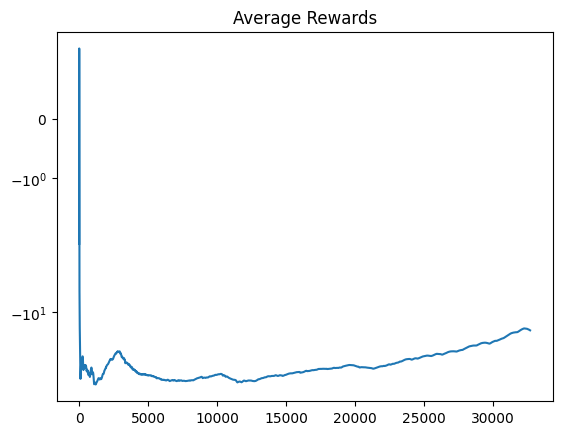

In [2]:
# WRITTEN BY MOHAMMAD ASADOLAHI
# Mohammad.E.Asadolahi@gmail.com
# https://github.com/mohammadAsadolahi

import numpy as np
import gym
from keras.layers import Dense, Activation
from keras.models import Sequential, load_model
import keras
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

!pip3 install box2d-py
!pip3 install gym[Box_2D]

env = gym.make('LunarLander-v2')

class replayBuffer:
    def __init__(self,maxSize,stateDim):
        self.state=np.zeros((maxSize,stateDim))
        self.action=np.zeros(maxSize,dtype= np.int8)
        self.reward=np.zeros(maxSize)
        self.done=np.zeros(maxSize,)
        self.nextState=np.zeros((maxSize,stateDim))
        self.maxSize=maxSize
        self.curser=0
        self.size=0

    def save(self,state,action,reward,nextState,done):
        self.state[self.curser]=state
        self.action[self.curser]=action
        self.reward[self.curser]=reward
        self.nextState[self.curser]=nextState
        self.done[self.curser]=done
        self.curser=(self.curser+1)%self.maxSize
        if self.size<self.maxSize:
            self.size+=1 
    
    def sample(self,batchSize):
        batchSize=min(self.size,batchSize-1)
        indexes=np.random.choice([i for i in range(self.size-1)],batchSize)
        return self.state[indexes],self.action[indexes],self.reward[indexes],self.nextState[indexes],self.done[indexes]

class DuelingNueralNetwork(keras.Model):
    def __init__(self,input,output):
        super(DuelingNueralNetwork, self).__init__()
        # self.inputLayer=keras.Input(shape=(input,))
        self.layer1=Dense(input,activation='relu')
        self.layer2=Dense(256,activation='relu')
        self.Vdense=Dense(64,activation='relu')
        self.Adense=Dense(64,activation='relu')
        self.V=Dense(1,activation='linear')
        self.A=Dense(output,activation='linear')
        
    def call(self,inputs):
        output=self.layer1(inputs)
        output=self.layer2(output)
        outputV=self.Vdense(output)
        outputA=self.Adense(output)
        outputV=self.V(outputV)
        outputA=self.A(outputA)
        return outputV+(outputA-(tf.math.reduce_mean(outputA,axis=1,keepdims=True)))

class Agent:
    def __init__(self,stateShape,actionShape,exploreRate,exploreRateDecay,minimumExploreRate,gamma,copyNetsCycle):
        self.gamma=gamma
        self.exploreRate=exploreRate
        self.exploreRateDecay=exploreRateDecay
        self.minimumExploreRate=minimumExploreRate
        self.actionShape=actionShape
        self.memory=replayBuffer(1000000,stateShape)
        self.model=DuelingNueralNetwork(stateShape,actionShape)
        self.model.compile(optimizer='Adam',loss='mse')
        self.tModel=DuelingNueralNetwork(stateShape,actionShape)
        self.tModel.compile(optimizer='Adam',loss='mse')
        self.learnThreshold=0
        self.copyNetsCycle=copyNetsCycle

    def getAction(self,state):
        if np.random.random()<=self.exploreRate:
            return np.random.choice([i for i in range(env.action_space.n)])
        else:
            return np.argmax(self.model.predict(np.expand_dims(state,axis=0))[0])

    def exploreDecay(self):
        self.exploreRate=max(self.exploreRate*self.exploreRateDecay,self.minimumExploreRate)

    def saveModel(self,modelName="DuelingDQN_LunarLanderV2.h"):
        self.model.save_weights(f"{modelName}")

    def loadModel(self,modelName="DuelingDQN_LunarLanderV2.h"):
        self.model.load_weights(f"{modelName}")
        self.tModel.set_weights(self.model.get_weights())
    
    def learn(self,batchSize=128):
        if self.memory.size>batchSize:
            states,actions,rewards,nextStates,done=self.memory.sample(batchSize)
            qState=self.model.predict(states)
            qNextState=self.model.predict(nextStates)
            qNextStateTarget=self.tModel.predict(nextStates)
            maxActions=np.argmax(qNextState,axis=1)
            batchIndex = np.arange(batchSize-1, dtype=np.int32)
            qState[batchIndex,actions]=(rewards+(self.gamma*qNextStateTarget[batchIndex,maxActions.astype(int)]*(1-done)))
            _=self.model.fit(x=states,y=qState,verbose=0)
            self.learnThreshold+=1
            self.exploreDecay()
        if(self.learnThreshold%self.copyNetsCycle)==0:
            self.tModel.set_weights(self.model.get_weights())
            # self.saveModel()
            self.learnThreshold=0

agent=Agent(stateShape=env.observation_space.shape[0],actionShape=env.action_space.n\
            ,exploreRate=1.0,exploreRateDecay=0.9995,minimumExploreRate=0.01,gamma=0.99,copyNetsCycle=100)
# agent.loadModel()

averageRewards=[]
totalRewards=[]
for i in range(1,150):
    done=False
    state=env.reset()
    rewards=0
    while not done:
        action=agent.getAction(state)
        nextState,reward,done,info=env.step(action)
        agent.memory.save(state,action,reward,nextState,int(done))
        rewards+=reward
        state=nextState
        agent.learn(batchSize=128)
        totalRewards.append(rewards)
        averageRewards.append(sum(totalRewards)/len(totalRewards))
        print(f"episode: {i}   reward: {rewards}  avg so far:{averageRewards[-1]} exploreRate:{agent.exploreRate}")

# plt.title(f'Total Rewards')
# plt.yscale('symlog')
# plt.plot(totalRewards)
# plt.savefig("Total Rewards",dpi=200)
# plt.clf()
# plt.title(f'Average Rewards')
# plt.yscale('symlog')
# plt.plot(averageRewards)
# plt.savefig("Average Rewards",dpi=200)

In [ ]:
plt.plot(averageRewards)
plt.title('Episodes vs Average Rewards')
plt.xlabel('Episodes')
plt.ylabel('Average Rewards')

In [20]:
split = totalRewards[:32700]
split = np.array(split)
split = np.split(split, 150)
splitArr = []
for i in range(len(split)):
    test = split[i]
    test = test.mean()
    splitArr.append(test)

Text(0, 0.5, 'Score')

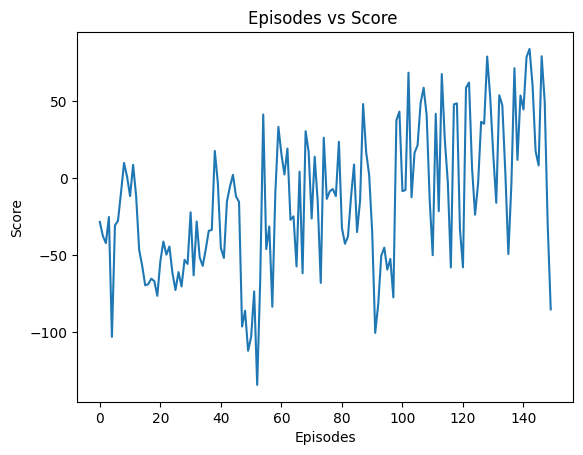

In [23]:
plt.plot(splitArr)
plt.title('Episodes vs Score ')
plt.xlabel('Episodes')
plt.ylabel('Score')

## Dueling Deep Q Network With Prioritized Experience Replay (DDQN-PER)

In [ ]:
"""
The DQN improvement: Prioritized Experience Replay (based on https://arxiv.org/abs/1511.05952)

View more on 莫烦Python: https://morvanzhou.github.io/tutorials/

Using:
Tensorflow: 1.0
"""

import numpy as np
import tensorflow as tf

np.random.seed(1)
tf.set_random_seed(1)


class SumTree(object):
    """
    This SumTree code is modified version and the original code is from:
    https://github.com/jaara/AI-blog/blob/master/SumTree.py

    Story the data with it priority in tree and data frameworks.
    """
    data_pointer = 0

    def __init__(self, capacity):
        self.capacity = capacity  # for all priority values
        self.tree = np.zeros(2 * capacity - 1)
        # [--------------Parent nodes-------------][-------leaves to recode priority-------]
        #             size: capacity - 1                       size: capacity
        self.data = np.zeros(capacity, dtype=object)  # for all transitions
        # [--------------data frame-------------]
        #             size: capacity

    def add_new_priority(self, p, data):
        leaf_idx = self.data_pointer + self.capacity - 1

        self.data[self.data_pointer] = data  # update data_frame
        self.update(leaf_idx, p)  # update tree_frame
        self.data_pointer += 1
        if self.data_pointer >= self.capacity:  # replace when exceed the capacity
            self.data_pointer = 0

    def update(self, tree_idx, p):
        change = p - self.tree[tree_idx]

        self.tree[tree_idx] = p
        self._propagate_change(tree_idx, change)

    def _propagate_change(self, tree_idx, change):
        """change the sum of priority value in all parent nodes"""
        parent_idx = (tree_idx - 1) // 2
        self.tree[parent_idx] += change
        if parent_idx != 0:
            self._propagate_change(parent_idx, change)

    def get_leaf(self, lower_bound):
        leaf_idx = self._retrieve(lower_bound)  # search the max leaf priority based on the lower_bound
        data_idx = leaf_idx - self.capacity + 1
        return [leaf_idx, self.tree[leaf_idx], self.data[data_idx]]

    def _retrieve(self, lower_bound, parent_idx=0):
        """
        Tree structure and array storage:

        Tree index:
             0         -> storing priority sum
            / \
          1     2
         / \   / \
        3   4 5   6    -> storing priority for transitions

        Array type for storing:
        [0,1,2,3,4,5,6]
        """
        left_child_idx = 2 * parent_idx + 1
        right_child_idx = left_child_idx + 1

        if left_child_idx >= len(self.tree):  # end search when no more child
            return parent_idx

        if self.tree[left_child_idx] == self.tree[right_child_idx]:
            return self._retrieve(lower_bound, np.random.choice([left_child_idx, right_child_idx]))
        if lower_bound <= self.tree[left_child_idx]:  # downward search, always search for a higher priority node
            return self._retrieve(lower_bound, left_child_idx)
        else:
            return self._retrieve(lower_bound - self.tree[left_child_idx], right_child_idx)

    @property
    def root_priority(self):
        return self.tree[0]  # the root


class Memory(object):  # stored as ( s, a, r, s_ ) in SumTree
    """
    This SumTree code is modified version and the original code is from:
    https://github.com/jaara/AI-blog/blob/master/Seaquest-DDQN-PER.py
    """
    epsilon = 0.001  # small amount to avoid zero priority
    alpha = 0.6  # [0~1] convert the importance of TD error to priority
    beta = 0.4  # importance-sampling, from initial value increasing to 1
    beta_increment_per_sampling = 1e-4  # annealing the bias
    abs_err_upper = 1   # for stability refer to paper

    def __init__(self, capacity):
        self.tree = SumTree(capacity)

    def store(self, error, transition):
        p = self._get_priority(error)
        self.tree.add_new_priority(p, transition)

    def sample(self, n):
        batch_idx, batch_memory, ISWeights = [], [], []
        segment = self.tree.root_priority / n
        self.beta = np.min([1, self.beta + self.beta_increment_per_sampling])  # max = 1

        min_prob = np.min(self.tree.tree[-self.tree.capacity:]) / self.tree.root_priority
        maxiwi = np.power(self.tree.capacity * min_prob, -self.beta)  # for later normalizing ISWeights
        for i in range(n):
            a = segment * i
            b = segment * (i + 1)
            lower_bound = np.random.uniform(a, b)
            idx, p, data = self.tree.get_leaf(lower_bound)
            prob = p / self.tree.root_priority
            ISWeights.append(self.tree.capacity * prob)
            batch_idx.append(idx)
            batch_memory.append(data)

        ISWeights = np.vstack(ISWeights)
        ISWeights = np.power(ISWeights, -self.beta) / maxiwi  # normalize
        return batch_idx, np.vstack(batch_memory), ISWeights

    def update(self, idx, error):
        p = self._get_priority(error)
        self.tree.update(idx, p)

    def _get_priority(self, error):
        error += self.epsilon   # avoid 0
        clipped_error = np.clip(error, 0, self.abs_err_upper)
        return np.power(clipped_error, self.alpha)


class DuelingDQNPrioritizedReplay:
    def __init__(
            self,
            n_actions,
            n_features,
            learning_rate=0.005,
            reward_decay=0.9,
            e_greedy=0.9,
            replace_target_iter=500,
            memory_size=10000,
            batch_size=32,
            e_greedy_increment=None,
            hidden=[100, 50],
            output_graph=False,
            sess=None,
    ):
        self.n_actions = n_actions
        self.n_features = n_features
        self.lr = learning_rate
        self.gamma = reward_decay
        self.epsilon_max = e_greedy
        self.replace_target_iter = replace_target_iter
        self.memory_size = memory_size
        self.batch_size = batch_size
        self.hidden = hidden
        self.epsilon_increment = e_greedy_increment
        self.epsilon = 0.5 if e_greedy_increment is not None else self.epsilon_max

        self.learn_step_counter = 0
        self._build_net()
        self.memory = Memory(capacity=memory_size)

        if sess is None:
            self.sess = tf.Session()
            self.sess.run(tf.global_variables_initializer())
        else:
            self.sess = sess

        if output_graph:
            tf.summary.FileWriter("logs/", self.sess.graph)

        self.cost_his = []

    def _build_net(self):
        def build_layers(s, c_names, w_initializer, b_initializer):
            for i, h in enumerate(self.hidden):
                if i == 0:
                    in_units, out_units, inputs = self.n_features, self.hidden[i], s
                else:
                    in_units, out_units, inputs = self.hidden[i-1], self.hidden[i], l
                with tf.variable_scope('l%i' % i):
                    w = tf.get_variable('w', [in_units, out_units], initializer=w_initializer, collections=c_names)
                    b = tf.get_variable('b', [1, out_units], initializer=b_initializer, collections=c_names)
                    l = tf.nn.relu(tf.matmul(inputs, w) + b)

            with tf.variable_scope('Value'):
                w = tf.get_variable('w', [self.hidden[-1], 1], initializer=w_initializer, collections=c_names)
                b = tf.get_variable('b', [1, 1], initializer=b_initializer, collections=c_names)
                self.V = tf.matmul(l, w) + b

            with tf.variable_scope('Advantage'):
                w = tf.get_variable('w', [self.hidden[-1], self.n_actions], initializer=w_initializer, collections=c_names)
                b = tf.get_variable('b', [1, self.n_actions], initializer=b_initializer, collections=c_names)
                self.A = tf.matmul(l, w) + b

            with tf.variable_scope('Q'):
                out = self.V + (self.A - tf.reduce_mean(self.A, axis=1, keep_dims=True))  # Q = V(s) + A(s,a)

            # with tf.variable_scope('out'):
            #     w = tf.get_variable('w', [self.hidden[-1], self.n_actions], initializer=w_initializer, collections=c_names)
            #     b = tf.get_variable('b', [1, self.n_actions], initializer=b_initializer, collections=c_names)
            #     out = tf.matmul(l, w) + b
            return out

        # ------------------ build evaluate_net ------------------
        self.s = tf.placeholder(tf.float32, [None, self.n_features], name='s')  # input
        self.q_target = tf.placeholder(tf.float32, [None, self.n_actions], name='Q_target')  # for calculating loss
        self.ISWeights = tf.placeholder(tf.float32, [None, 1], name='IS_weights')
        with tf.variable_scope('eval_net'):
            c_names, w_initializer, b_initializer = \
                ['eval_net_params', tf.GraphKeys.GLOBAL_VARIABLES], \
                tf.random_normal_initializer(0., 0.01), tf.constant_initializer(0.01)  # config of layers

            self.q_eval = build_layers(self.s, c_names, w_initializer, b_initializer)

        with tf.variable_scope('loss'):
            self.abs_errors = tf.abs(tf.reduce_sum(self.q_target - self.q_eval, axis=1))  # for updating Sumtree
            self.loss = tf.reduce_mean(self.ISWeights * tf.squared_difference(self.q_target, self.q_eval))

        with tf.variable_scope('train'):
            self._train_op = tf.train.AdamOptimizer(self.lr).minimize(self.loss)

        # ------------------ build target_net ------------------
        self.s_ = tf.placeholder(tf.float32, [None, self.n_features], name='s_')  # input
        with tf.variable_scope('target_net'):
            c_names = ['target_net_params', tf.GraphKeys.GLOBAL_VARIABLES]
            self.q_next = build_layers(self.s_, c_names, w_initializer, b_initializer)

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        max_p = np.max(self.memory.tree.tree[-self.memory.tree.capacity:])
        self.memory.store(max_p, transition)

    def choose_action(self, observation):
        observation = observation[np.newaxis, :]
        if np.random.uniform() < self.epsilon:
            actions_value = self.sess.run(self.q_eval, feed_dict={self.s: observation})
            action = np.argmax(actions_value)
        else:
            action = np.random.randint(0, self.n_actions)
        return action

    def _replace_target_params(self):
        t_params = tf.get_collection('target_net_params')
        e_params = tf.get_collection('eval_net_params')
        self.sess.run([tf.assign(t, e) for t, e in zip(t_params, e_params)])

    def learn(self):
        if self.learn_step_counter % self.replace_target_iter == 0:
            self._replace_target_params()

        tree_idx, batch_memory, ISWeights = self.memory.sample(self.batch_size)

        # double DQN
        q_next, q_eval4next = self.sess.run(
            [self.q_next, self.q_eval],
            feed_dict={self.s_: batch_memory[:, -self.n_features:],  # next observation
                       self.s: batch_memory[:, -self.n_features:]})  # next observation
        q_eval = self.sess.run(self.q_eval, {self.s: batch_memory[:, :self.n_features]})

        q_target = q_eval.copy()

        batch_index = np.arange(self.batch_size, dtype=np.int32)
        eval_act_index = batch_memory[:, self.n_features].astype(int)
        reward = batch_memory[:, self.n_features + 1]
        max_act4next = np.argmax(q_eval4next,
                                 axis=1)  # the action that brings the highest value is evaluated by q_eval
        selected_q_next = q_next[batch_index, max_act4next]  # Double DQN, select q_next depending on above actions

        q_target[batch_index, eval_act_index] = reward + self.gamma * selected_q_next

        # q_next, q_eval = self.sess.run(
        #     [self.q_next, self.q_eval],
        #     feed_dict={self.s_: batch_memory[:, -self.n_features:],
        #                self.s: batch_memory[:, :self.n_features]})
        #
        # q_target = q_eval.copy()
        # batch_index = np.arange(self.batch_size, dtype=np.int32)
        # eval_act_index = batch_memory[:, self.n_features].astype(int)
        # reward = batch_memory[:, self.n_features + 1]
        #
        # q_target[batch_index, eval_act_index] = reward + self.gamma * np.max(q_next, axis=1)

        _, abs_errors, self.cost = self.sess.run([self._train_op, self.abs_errors, self.loss],
                                                 feed_dict={self.s: batch_memory[:, :self.n_features],
                                                            self.q_target: q_target,
                                                            self.ISWeights: ISWeights})
        for i in range(len(tree_idx)):  # update priority
            idx = tree_idx[i]
            self.memory.update(idx, abs_errors[i])

        self.cost_his.append(self.cost)

        self.epsilon = self.epsilon + self.epsilon_increment if self.epsilon < self.epsilon_max else self.epsilon_max
        self.learn_step_counter += 1

## Deep Deterministic Policy Gradient (DDPG)

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import gym
from tensorflow.keras.models import load_model
!pip3 install box2d-py

env= gym.make("LunarLanderContinuous-v2")
state_low = env.observation_space.low
state_high = env.observation_space.high
action_low = env.action_space.low 
action_high = env.action_space.high
print(state_low)
print(state_high)
print(action_low)
print(action_high)

class RBuffer():
    def __init__(self, maxsize, statedim, naction):
    self.cnt = 0
    self.maxsize = maxsize
    self.state_memory = np.zeros((maxsize, *statedim), dtype=np.float32)
    self.action_memory = np.zeros((maxsize, naction), dtype=np.float32)
    self.reward_memory = np.zeros((maxsize,), dtype=np.float32)
    self.next_state_memory = np.zeros((maxsize, *statedim), dtype=np.float32)
    self.done_memory = np.zeros((maxsize,), dtype= np.bool)

    def storexp(self, state, next_state, action, done, reward):
    index = self.cnt % self.maxsize
    self.state_memory[index] = state
    self.action_memory[index] = action
    self.reward_memory[index] = reward
    self.next_state_memory[index] = next_state
    self.done_memory[index] = 1- int(done)
    self.cnt += 1

    def sample(self, batch_size):
    max_mem = min(self.cnt, self.maxsize)
    batch = np.random.choice(max_mem, batch_size, replace= False)  
    states = self.state_memory[batch]
    next_states = self.next_state_memory[batch]
    rewards = self.reward_memory[batch]
    actions = self.action_memory[batch]
    dones = self.done_memory[batch]
    return states, next_states, rewards, actions, dones

class Critic(tf.keras.Model):
    def __init__(self):
    super(Critic, self).__init__()
    self.f1 = tf.keras.layers.Dense(512, activation='relu')
    self.f2 = tf.keras.layers.Dense(512, activation='relu')
    self.v =  tf.keras.layers.Dense(1, activation=None)

    def call(self, inputstate, action):
    x = self.f1(tf.concat([inputstate, action], axis=1))
    x = self.f2(x)
    x = self.v(x)
    return x


class Actor(tf.keras.Model):
    def __init__(self, no_action):
    super(Actor, self).__init__()    
    self.f1 = tf.keras.layers.Dense(512, activation='relu')
    self.f2 = tf.keras.layers.Dense(512, activation='relu')
    self.mu =  tf.keras.layers.Dense(no_action, activation='tanh')

    def call(self, state):
    x = self.f1(state)
    x = self.f2(x)
    x = self.mu(x)  
    return x

class Agent():
    def __init__(self, n_action= len(env.action_space.high)):
    self.actor_main = Actor(n_action)
    self.actor_target = Actor(n_action)
    self.critic_main = Critic()
    self.critic_target = Critic()
    self.batch_size = 64
    self.n_actions = len(env.action_space.high)
    self.a_opt = tf.keras.optimizers.Adam(1e-4)
    # self.actor_target = tf.keras.optimizers.Adam(.001)
    self.c_opt = tf.keras.optimizers.Adam(1e-4)
    # self.critic_target = tf.keras.optimizers.Adam(.002)
    self.memory = RBuffer(1_00_000, env.observation_space.shape, len(env.action_space.high))
    self.trainstep = 0
    self.replace = 5
    self.gamma = 0.99
    self.min_action = env.action_space.low[0]
    self.max_action = env.action_space.high[0]

    def act(self, state, evaluate=False):
        state = tf.convert_to_tensor([state], dtype=tf.float32)
        actions = self.actor_main(state)
        if not evaluate:
            actions += tf.random.normal(shape=[self.n_actions], mean=0.0, stddev=0.1)

        actions = self.max_action * (tf.clip_by_value(actions, self.min_action, self.max_action))
        #print(actions)
        return actions[0]


    def savexp(self,state, next_state, action, done, reward):
        self.memory.storexp(state, next_state, action, done, reward)

    def update_target(self):
    self.actor_target.set_weights(self.actor_main.get_weights())
    self.critic_target.set_weights(self.critic_main.get_weights())

    def train(self):
        if self.memory.cnt < self.batch_size:
            return 

        states, next_states, rewards, actions, dones = self.memory.sample(self.batch_size)
        
        states = tf.convert_to_tensor(states, dtype= tf.float32)
        next_states = tf.convert_to_tensor(next_states, dtype= tf.float32)
        rewards = tf.convert_to_tensor(rewards, dtype= tf.float32)
        actions = tf.convert_to_tensor(actions, dtype= tf.float32)
        #dones = tf.convert_to_tensor(dones, dtype= tf.bool)

        with tf.GradientTape() as tape1, tf.GradientTape() as tape2:
            target_actions = self.actor_target(next_states)
            target_next_state_values = tf.squeeze(self.critic_target(next_states, target_actions), 1)
            critic_value = tf.squeeze(self.critic_main(states, actions), 1)
            target_values = rewards + self.gamma * target_next_state_values * dones
            critic_loss = tf.keras.losses.MSE(target_values, critic_value)

            new_policy_actions = self.actor_main(states)
            actor_loss = -self.critic_main(states, new_policy_actions)
            actor_loss = tf.math.reduce_mean(actor_loss)

        grads1 = tape1.gradient(actor_loss, self.actor_main.trainable_variables)
        grads2 = tape2.gradient(critic_loss, self.critic_main.trainable_variables)
        self.a_opt.apply_gradients(zip(grads1, self.actor_main.trainable_variables))
        self.c_opt.apply_gradients(zip(grads2, self.critic_main.trainable_variables))

        if self.trainstep % self.replace == 0:
            self.update_target()
        
        self.trainstep +=1
    
agent = Agent(2)
tf.random.set_seed(336699)

episods = 2000
ep_reward = []
total_avgr = []
target = False

for s in range(episods):
    if target == True:
        break
    total_reward = 0 
    state = env.reset()
    done = False

    while not done:
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        agent.savexp(state, next_state, action, done, reward)
        agent.train()
        state = next_state
        total_reward += reward
        if done:
            ep_reward.append(total_reward)
            avg_reward = np.mean(ep_reward[-100:])
            total_avgr.append(avg_reward)
            print("total reward after {} steps is {} and avg reward is {}".format(s, total_reward, avg_reward))
            
            if int(avg_reward) == 200:
                target = True

  Using cached box2d-py-2.3.8.tar.gz (374 kB)
  Running setup.py clean for box2d-py
Failed to build box2d-py
    Running setup.py install for box2d-py: started
    Running setup.py install for box2d-py: finished with status 'error'
[-inf -inf -inf -inf -inf -inf -inf -inf]
[inf inf inf inf inf inf inf inf]
[-1. -1.]
[1. 1.]


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\rutsm\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-_ncs3284\\box2d-py_52caa5e3aa564589974406cb73c50692\\setup.py'"'"'; __file__='"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-_ncs3284\\box2d-py_52caa5e3aa564589974406cb73c50692\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\rutsm\AppData\Local\Temp\pip-wheel-gg6qn8yk'
       cwd: C:\Users\rutsm\AppData\Local\Temp\pip-install-_ncs3284\box2d-py_52caa5e3aa564589974406cb73c50692\
  Complete output (28 lines):
  Using setuptools (version 58.0.4).
  running bdist_wheel
  running build
  running build_py
  creating build


total reward after 0 steps is -66.41861413020825 and avg reward is -66.41861413020825
total reward after 1 steps is -507.89701097562136 and avg reward is -287.15781255291483
total reward after 2 steps is -657.6905947358532 and avg reward is -410.6687399472276


In [ ]:
plt.plot(total_avgr)

## Proximal Policy Optimization (PPO)

C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)
C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\keras\engine\training_v1.py:2356: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


episode: 1/10000, score: -135.16536525743112, average: -135.17 
episode: 2/10000, score: 36.43218186970364, average: -49.37 
episode: 3/10000, score: -52.70597666062751, average: -50.48 
episode: 4/10000, score: -85.0904874342422, average: -59.13 
episode: 5/10000, score: -170.24019637012807, average: -81.35 
episode: 6/10000, score: -214.25315869313198, average: -103.50 
episode: 7/10000, score: -97.78156385372627, average: -102.69 
episode: 8/10000, score: -443.7484645555254, average: -145.32 
episode: 9/10000, score: -346.58940643304936, average: -167.68 
episode: 10/10000, score: -354.33789489042977, average: -186.35 
episode: 11/10000, score: -185.44914436388035, average: -186.27 
episode: 12/10000, score: -131.9382247707707, average: -181.74 
episode: 13/10000, score: -124.09420558069283, average: -177.30 
episode: 14/10000, score: -125.04368725781714, average: -173.57 
episode: 15/10000, score: -376.1202249548887, average: -187.08 
episode: 16/10000, score: -184.48617428940202, 

episode: 129/10000, score: -38.34237204684201, average: -151.90 
episode: 130/10000, score: -581.0411441698517, average: -163.14 
episode: 131/10000, score: -44.236710992862655, average: -163.12 
episode: 132/10000, score: -57.14418309679621, average: -163.24 
episode: 133/10000, score: -83.78122351519123, average: -162.33 
episode: 134/10000, score: -98.67210494868505, average: -161.97 
episode: 135/10000, score: -35.819783722046566, average: -159.88 
episode: 136/10000, score: -78.89477769051845, average: -162.78 
episode: 137/10000, score: -476.1957263942732, average: -141.40 
episode: 138/10000, score: -13.113079897083596, average: -122.50 
episode: 139/10000, score: -284.8291558336505, average: -107.01 
episode: 140/10000, score: -55.58710994866167, average: -96.11 
episode: 141/10000, score: -66.82274211353462, average: -92.13 
episode: 142/10000, score: -48.05688644993677, average: -94.17 
episode: 143/10000, score: -61.650334516388966, average: -97.55 
episode: 144/10000, score

episode: 255/10000, score: -131.51336821441953, average: -129.60 
episode: 256/10000, score: -134.28975932235096, average: -130.26 
episode: 257/10000, score: -180.03728652709935, average: -131.25 
episode: 258/10000, score: -107.83659801840477, average: -129.14 
episode: 259/10000, score: -100.69942868433505, average: -129.28 
episode: 260/10000, score: -129.87517991869166, average: -129.91 
episode: 261/10000, score: -101.56666375189705, average: -127.97 
episode: 262/10000, score: -99.96763905235038, average: -127.83 
episode: 263/10000, score: -111.61549179545422, average: -128.78 
episode: 264/10000, score: -105.43657951662625, average: -127.88 
episode: 265/10000, score: -152.19095366388686, average: -129.39 
episode: 266/10000, score: -100.58660689375061, average: -129.67 
episode: 267/10000, score: -198.74392763810792, average: -131.20 
episode: 268/10000, score: -181.36017826113607, average: -132.42 
episode: 269/10000, score: -88.1736069925168, average: -132.16 
episode: 270/

episode: 381/10000, score: -115.7283877868428, average: -119.92 
episode: 382/10000, score: -145.66622322795217, average: -119.24 
episode: 383/10000, score: -88.9436498790361, average: -119.35 
episode: 384/10000, score: -78.11166160080842, average: -119.08 
episode: 385/10000, score: -152.6631480953358, average: -119.93 
episode: 386/10000, score: -85.81616512591458, average: -119.65 
episode: 387/10000, score: -99.61376384784262, average: -119.79 
episode: 388/10000, score: -111.52372952397718, average: -117.87 
episode: 389/10000, score: -65.56154742864818, average: -117.28 
episode: 390/10000, score: -112.0583273893755, average: -117.49 
episode: 391/10000, score: -125.82197581155044, average: -117.95 
episode: 392/10000, score: -119.82432312921489, average: -119.70 
episode: 393/10000, score: -106.10502936615461, average: -120.00 
episode: 394/10000, score: -187.96537248939165, average: -122.24 
episode: 395/10000, score: -148.86848591149192, average: -123.31 
episode: 396/10000,

episode: 507/10000, score: 200.14474096125028, average: 72.08 SAVING
episode: 508/10000, score: 204.82361689499243, average: 76.92 SAVING
episode: 509/10000, score: 112.36528350069426, average: 79.36 SAVING
episode: 510/10000, score: -154.9111773272471, average: 78.31 
episode: 511/10000, score: 178.34072436669422, average: 81.06 SAVING
episode: 512/10000, score: 173.0018204624903, average: 84.81 SAVING
episode: 513/10000, score: 238.300750497841, average: 88.15 SAVING
episode: 514/10000, score: -46.46512656610703, average: 87.07 
episode: 515/10000, score: -54.19958602631669, average: 87.78 
episode: 516/10000, score: 116.15866227546289, average: 87.48 
episode: 517/10000, score: 99.15161306000961, average: 88.81 SAVING
episode: 518/10000, score: 205.38411989085327, average: 92.13 SAVING
episode: 519/10000, score: 241.60447212170746, average: 96.92 SAVING
episode: 520/10000, score: 195.84585263145118, average: 99.61 SAVING
episode: 521/10000, score: 254.17101645615352, average: 102.12

episode: 631/10000, score: 247.4289332698344, average: 201.25 
episode: 632/10000, score: -31.119193214791864, average: 195.08 
episode: 633/10000, score: 223.55750651817328, average: 195.01 
episode: 634/10000, score: 243.7117751073364, average: 195.08 
episode: 635/10000, score: 237.0040057537074, average: 194.74 
episode: 636/10000, score: 247.0373896642849, average: 200.22 
episode: 637/10000, score: 236.81896459147654, average: 202.93 
episode: 638/10000, score: 297.02526096043573, average: 206.01 
episode: 639/10000, score: 248.11283478484296, average: 206.69 
episode: 640/10000, score: 263.2327503939249, average: 207.29 
episode: 641/10000, score: 243.27387997707672, average: 212.40 SAVING
episode: 642/10000, score: 34.310536081751735, average: 208.17 
episode: 643/10000, score: 242.0510033125033, average: 207.83 
episode: 644/10000, score: 232.78401524485474, average: 207.98 
episode: 645/10000, score: 232.0067158811954, average: 206.96 
episode: 646/10000, score: -92.562569722

episode: 760/10000, score: 267.08028045775745, average: 156.22 
episode: 761/10000, score: 269.70691600352933, average: 156.84 
episode: 762/10000, score: 247.13854192523047, average: 156.23 
episode: 763/10000, score: 251.9929827248301, average: 155.49 
episode: 764/10000, score: -26.017266682753217, average: 153.15 
episode: 765/10000, score: 209.67473622305386, average: 152.12 
episode: 766/10000, score: -39.82451661833071, average: 146.39 
episode: 767/10000, score: 214.46272145742412, average: 151.40 
episode: 768/10000, score: 125.3960292662367, average: 152.94 
episode: 769/10000, score: 247.80443157495517, average: 152.94 
episode: 770/10000, score: -89.92849244191211, average: 150.03 
episode: 771/10000, score: 255.85881205815727, average: 149.38 
episode: 772/10000, score: 129.19251764950025, average: 152.45 
episode: 773/10000, score: 26.237259773588207, average: 153.26 
episode: 774/10000, score: 224.98516544841186, average: 152.37 
episode: 775/10000, score: 224.8782139473

episode: 889/10000, score: 243.58355013132396, average: 154.09 
episode: 890/10000, score: 250.8165710075495, average: 154.46 
episode: 891/10000, score: -18.16054602101495, average: 148.68 
episode: 892/10000, score: 242.4119773514228, average: 153.04 
episode: 893/10000, score: -68.70624473532033, average: 150.10 
episode: 894/10000, score: 132.2747919217326, average: 147.57 
episode: 895/10000, score: 320.0555743423805, average: 149.07 
episode: 896/10000, score: -32.31075417603297, average: 143.11 
episode: 897/10000, score: 229.7339126190755, average: 142.87 
episode: 898/10000, score: 90.98131123615232, average: 139.33 
episode: 899/10000, score: 276.4859188075611, average: 142.52 
episode: 900/10000, score: 248.3124306179707, average: 143.40 
episode: 901/10000, score: -32.51640313578157, average: 143.17 
episode: 902/10000, score: 221.41565903425487, average: 142.36 
episode: 903/10000, score: 289.141236486935, average: 148.97 
episode: 904/10000, score: 274.5550311823816, aver

episode: 1018/10000, score: 249.343475263664, average: 95.44 
episode: 1019/10000, score: 257.8414025269897, average: 102.01 
episode: 1020/10000, score: 266.25275220175627, average: 101.75 
episode: 1021/10000, score: 217.8510643305557, average: 105.54 
episode: 1022/10000, score: 254.98062467446013, average: 105.06 
episode: 1023/10000, score: -48.871587970474195, average: 105.46 
episode: 1024/10000, score: 12.73667443616641, average: 102.65 
episode: 1025/10000, score: 233.00581456777917, average: 107.85 
episode: 1026/10000, score: 246.81573828709628, average: 113.23 
episode: 1027/10000, score: 202.55231702043457, average: 117.32 
episode: 1028/10000, score: 243.69266064042952, average: 117.11 
episode: 1029/10000, score: 52.75538195111358, average: 118.76 
episode: 1030/10000, score: 257.4672499493347, average: 126.02 
episode: 1031/10000, score: 255.10749764027867, average: 126.44 
episode: 1032/10000, score: -35.610372954090536, average: 126.38 
episode: 1033/10000, score: 122

episode: 1145/10000, score: 34.80093218582675, average: 129.48 
episode: 1146/10000, score: 272.2955123700298, average: 129.98 
episode: 1147/10000, score: 243.32657520347846, average: 130.47 
episode: 1148/10000, score: 284.90975981464476, average: 130.96 
episode: 1149/10000, score: 214.49636130801036, average: 130.05 
episode: 1150/10000, score: 230.72234310085096, average: 129.29 
episode: 1151/10000, score: 241.7082955625884, average: 129.07 
episode: 1152/10000, score: -38.22254204830482, average: 123.55 
episode: 1153/10000, score: 262.06990914297484, average: 128.35 
episode: 1154/10000, score: 213.57717421224646, average: 134.49 
episode: 1155/10000, score: 188.88742818321424, average: 139.90 
episode: 1156/10000, score: 217.72204473467963, average: 139.41 
episode: 1157/10000, score: -45.378878655417594, average: 133.65 
episode: 1158/10000, score: -70.73643753005005, average: 130.08 
episode: 1159/10000, score: 241.555609990415, average: 129.90 
episode: 1160/10000, score: 1

episode: 1273/10000, score: 246.58240278337277, average: 115.81 
episode: 1274/10000, score: -61.355263476204705, average: 114.17 
episode: 1275/10000, score: 231.49316815969485, average: 113.47 
episode: 1276/10000, score: 277.2259001287889, average: 116.45 
episode: 1277/10000, score: 225.70588423364364, average: 115.09 
episode: 1278/10000, score: 6.425218351143272, average: 109.92 
episode: 1279/10000, score: 208.38983668338435, average: 114.66 
episode: 1280/10000, score: 229.27652710844907, average: 113.57 
episode: 1281/10000, score: 261.59565051875825, average: 114.91 
episode: 1282/10000, score: 141.40963938687642, average: 113.34 
episode: 1283/10000, score: 255.48369715603428, average: 119.66 
episode: 1284/10000, score: 280.9381086142785, average: 124.71 
episode: 1285/10000, score: 126.5065409326286, average: 122.85 
episode: 1286/10000, score: 242.5123325771161, average: 122.98 
episode: 1287/10000, score: -28.184055836555785, average: 123.33 
episode: 1288/10000, score: 

episode: 1400/10000, score: 255.73841785140587, average: 175.64 
episode: 1401/10000, score: 270.52563310880475, average: 176.25 
episode: 1402/10000, score: -52.61598484739454, average: 174.99 
episode: 1403/10000, score: 259.8798776384625, average: 180.90 
episode: 1404/10000, score: 236.31635271292186, average: 180.94 
episode: 1405/10000, score: 15.169200632588229, average: 181.51 
episode: 1406/10000, score: 237.08831542800567, average: 180.63 
episode: 1407/10000, score: -18.83836666743369, average: 174.77 
episode: 1408/10000, score: 255.46243783828047, average: 174.93 
episode: 1409/10000, score: 236.77523603313153, average: 179.96 
episode: 1410/10000, score: 235.49395153360757, average: 179.43 
episode: 1411/10000, score: -14.394833112531856, average: 174.62 
episode: 1412/10000, score: 124.030565618301, average: 175.52 
episode: 1413/10000, score: 272.0492083845319, average: 176.62 
episode: 1414/10000, score: 231.4867087677638, average: 176.05 
episode: 1415/10000, score: -

episode: 1527/10000, score: 262.72266785097605, average: 125.25 
episode: 1528/10000, score: 276.74630837001854, average: 130.93 
episode: 1529/10000, score: 268.77091786045014, average: 137.84 
episode: 1530/10000, score: 233.46009943727765, average: 138.43 
episode: 1531/10000, score: 229.53523663989904, average: 138.00 
episode: 1532/10000, score: -23.299802753583805, average: 133.82 
episode: 1533/10000, score: 260.871304013706, average: 134.48 
episode: 1534/10000, score: -41.68373303909512, average: 128.67 
episode: 1535/10000, score: 27.0689378530695, average: 130.51 
episode: 1536/10000, score: 227.75047795912522, average: 130.40 
episode: 1537/10000, score: 275.84328196361673, average: 136.75 
episode: 1538/10000, score: 240.85295490309048, average: 136.77 
episode: 1539/10000, score: -67.52666213530208, average: 130.42 
episode: 1540/10000, score: 250.11203325689792, average: 136.06 
episode: 1541/10000, score: 236.9855463702105, average: 137.09 
episode: 1542/10000, score: 2

episode: 1655/10000, score: 221.83674598918577, average: 81.01 
episode: 1656/10000, score: 179.13307414720944, average: 87.11 
episode: 1657/10000, score: -1.1277999338203273, average: 87.82 
episode: 1658/10000, score: 244.34681629120809, average: 93.50 
episode: 1659/10000, score: -62.11830764568654, average: 91.54 
episode: 1660/10000, score: -110.69285623270984, average: 83.84 
episode: 1661/10000, score: -98.74712097756779, average: 83.07 
episode: 1662/10000, score: -5.701504733532104, average: 84.28 
episode: 1663/10000, score: 55.320122678671, average: 85.22 
episode: 1664/10000, score: 245.0329827419047, average: 87.57 
episode: 1665/10000, score: -76.9663129574242, average: 87.90 
episode: 1666/10000, score: -60.809141118086536, average: 88.32 
episode: 1667/10000, score: 32.52154337126217, average: 84.63 
episode: 1668/10000, score: 249.64818432212422, average: 84.73 
episode: 1669/10000, score: 17.1876805544872, average: 80.75 
episode: 1670/10000, score: -17.9228693891151

episode: 1784/10000, score: 219.5592610119508, average: 111.65 
episode: 1785/10000, score: -79.92019829347481, average: 110.28 
episode: 1786/10000, score: 267.1032867535366, average: 114.89 
episode: 1787/10000, score: 242.1725809572062, average: 114.68 
episode: 1788/10000, score: 211.24955178837098, average: 113.71 
episode: 1789/10000, score: 14.125171245387634, average: 109.04 
episode: 1790/10000, score: 269.5739906760915, average: 109.44 
episode: 1791/10000, score: 253.80940945718197, average: 115.16 
episode: 1792/10000, score: 243.14535378042217, average: 122.42 
episode: 1793/10000, score: 229.61838173462647, average: 126.28 
episode: 1794/10000, score: -19.544240340658845, average: 125.21 
episode: 1795/10000, score: -6.478520766213748, average: 125.18 
episode: 1796/10000, score: 96.35378823218082, average: 129.31 
episode: 1797/10000, score: 24.589261068031036, average: 128.11 
episode: 1798/10000, score: 257.0275561639879, average: 134.05 
episode: 1799/10000, score: 25

episode: 1913/10000, score: 77.98241891771738, average: 109.81 
episode: 1914/10000, score: -57.614621017871954, average: 108.90 
episode: 1915/10000, score: 245.13818537170073, average: 108.81 
episode: 1916/10000, score: -5.362655870644062, average: 105.71 
episode: 1917/10000, score: 13.314701286288624, average: 107.11 
episode: 1918/10000, score: -37.20537874034222, average: 106.12 
episode: 1919/10000, score: -117.30642542188875, average: 99.13 
episode: 1920/10000, score: 191.56278777324053, average: 100.57 
episode: 1921/10000, score: 268.23226890028, average: 107.87 
episode: 1922/10000, score: -68.3042850763677, average: 106.74 
episode: 1923/10000, score: 259.82440818791065, average: 112.84 
episode: 1924/10000, score: 274.3094731204169, average: 120.53 
episode: 1925/10000, score: -106.49645585011035, average: 120.19 
episode: 1926/10000, score: -5.0897182300661115, average: 120.00 
episode: 1927/10000, score: 198.7799494169327, average: 123.48 
episode: 1928/10000, score: 2

episode: 2040/10000, score: -62.81607831167983, average: 94.82 
episode: 2041/10000, score: 212.54234862744278, average: 98.46 
episode: 2042/10000, score: 242.8689250139119, average: 98.19 
episode: 2043/10000, score: 7.265182580173743, average: 98.92 
episode: 2044/10000, score: 31.073951393226878, average: 95.17 
episode: 2045/10000, score: 231.03629806752423, average: 100.94 
episode: 2046/10000, score: 263.0772816130758, average: 101.57 
episode: 2047/10000, score: 206.46668168708808, average: 105.25 
episode: 2048/10000, score: 236.07808091692698, average: 112.19 
episode: 2049/10000, score: -118.06963876830434, average: 104.63 
episode: 2050/10000, score: -90.81846465044794, average: 102.87 
episode: 2051/10000, score: 169.8917789205765, average: 106.22 
episode: 2052/10000, score: -82.80799948172373, average: 99.77 
episode: 2053/10000, score: -91.80707402100784, average: 92.38 
episode: 2054/10000, score: 250.01951862149616, average: 91.87 
episode: 2055/10000, score: 234.6051

episode: 2169/10000, score: 233.6750593185039, average: 88.90 
episode: 2170/10000, score: 204.88466151774924, average: 87.28 
episode: 2171/10000, score: 214.0738630710913, average: 86.49 
episode: 2172/10000, score: 190.9424850422066, average: 92.72 
episode: 2173/10000, score: -97.51688586971969, average: 88.79 
episode: 2174/10000, score: -99.55964715407526, average: 82.26 
episode: 2175/10000, score: -29.74713578150258, average: 83.55 
episode: 2176/10000, score: 9.920246291978614, average: 79.08 
episode: 2177/10000, score: -72.90636650469072, average: 77.40 
episode: 2178/10000, score: 257.35768082359044, average: 84.42 
episode: 2179/10000, score: 241.83117131477724, average: 83.94 
episode: 2180/10000, score: 24.712331226489326, average: 84.24 
episode: 2181/10000, score: -57.819264393902465, average: 83.78 
episode: 2182/10000, score: -17.163150664320327, average: 79.30 
episode: 2183/10000, score: 221.95382943405053, average: 78.20 
episode: 2184/10000, score: 257.0356008589

episode: 2296/10000, score: 11.992751168096078, average: 164.19 
episode: 2297/10000, score: 144.5862098468868, average: 167.55 
episode: 2298/10000, score: 230.18484969880322, average: 167.11 
episode: 2299/10000, score: 130.13842867169447, average: 164.74 
episode: 2300/10000, score: 16.91967836655175, average: 166.33 
episode: 2301/10000, score: 239.59723540905043, average: 165.93 
episode: 2302/10000, score: -57.53277263045284, average: 159.82 
episode: 2303/10000, score: -100.61061627907083, average: 153.68 
episode: 2304/10000, score: 258.1071552532158, average: 159.54 
episode: 2305/10000, score: 10.474663867505527, average: 154.88 
episode: 2306/10000, score: 257.14990952119956, average: 159.83 
episode: 2307/10000, score: 120.99744782788646, average: 157.26 
episode: 2308/10000, score: 270.13493200940053, average: 158.50 
episode: 2309/10000, score: -81.55522491887582, average: 152.17 
episode: 2310/10000, score: 253.19337265159564, average: 159.21 
episode: 2311/10000, score:

episode: 2423/10000, score: 261.1807684078938, average: 132.52 
episode: 2424/10000, score: 224.7248230182309, average: 138.57 
episode: 2425/10000, score: -143.44671395614267, average: 135.54 
episode: 2426/10000, score: 230.85929063816494, average: 137.59 
episode: 2427/10000, score: -12.80679203357775, average: 132.18 
episode: 2428/10000, score: 223.9886617072707, average: 134.08 
episode: 2429/10000, score: 263.21093167791577, average: 134.71 
episode: 2430/10000, score: 211.60963755251464, average: 137.94 
episode: 2431/10000, score: 6.905030217432895, average: 140.13 
episode: 2432/10000, score: 156.88432303309574, average: 143.64 
episode: 2433/10000, score: 128.82503697942968, average: 141.04 
episode: 2434/10000, score: 249.5139523826072, average: 147.68 
episode: 2435/10000, score: 168.72932266248068, average: 148.16 
episode: 2436/10000, score: 248.5849631132813, average: 148.26 
episode: 2437/10000, score: 1.5960405232647474, average: 144.45 
episode: 2438/10000, score: 23

episode: 2552/10000, score: 234.36789189606264, average: 138.63 
episode: 2553/10000, score: 253.77740207719822, average: 138.74 
episode: 2554/10000, score: -68.94076849622037, average: 133.27 
episode: 2555/10000, score: -8.08977557313878, average: 129.37 
episode: 2556/10000, score: -66.30021512224975, average: 127.99 
episode: 2557/10000, score: -68.9584947710238, average: 127.21 
episode: 2558/10000, score: 214.60367677819062, average: 131.69 
episode: 2559/10000, score: 190.58234269945112, average: 136.38 
episode: 2560/10000, score: -31.199683406003842, average: 131.30 
episode: 2561/10000, score: 179.95110703978517, average: 129.94 
episode: 2562/10000, score: 18.119205612843928, average: 125.56 
episode: 2563/10000, score: 220.7964171626125, average: 131.30 
episode: 2564/10000, score: -69.71094819462952, average: 130.73 
episode: 2565/10000, score: 252.27818195155055, average: 131.03 
episode: 2566/10000, score: 267.2384115592081, average: 137.99 
episode: 2567/10000, score: 

episode: 2679/10000, score: 104.12403391087761, average: 173.83 
episode: 2680/10000, score: 198.68448686712907, average: 176.86 
episode: 2681/10000, score: 255.77797755341743, average: 176.29 
episode: 2682/10000, score: -55.81422597283799, average: 174.77 
episode: 2683/10000, score: 14.455694980734492, average: 169.21 
episode: 2684/10000, score: 14.218914799204313, average: 166.75 
episode: 2685/10000, score: 238.19549462235958, average: 166.48 
episode: 2686/10000, score: -15.781743821848508, average: 160.74 
episode: 2687/10000, score: -58.70626903892449, average: 159.20 
episode: 2688/10000, score: 272.9651655385495, average: 159.60 
episode: 2689/10000, score: -21.85557167631606, average: 155.14 
episode: 2690/10000, score: 200.52111153156636, average: 154.83 
episode: 2691/10000, score: 237.79219603295135, average: 155.56 
episode: 2692/10000, score: -61.82340204793566, average: 155.45 
episode: 2693/10000, score: 271.5117417873265, average: 155.50 
episode: 2694/10000, score

episode: 2807/10000, score: 209.3393606548825, average: 132.41 
episode: 2808/10000, score: 228.2854366973899, average: 131.96 
episode: 2809/10000, score: 245.48503064734587, average: 131.25 
episode: 2810/10000, score: 233.55378421457385, average: 131.86 
episode: 2811/10000, score: 251.93050079237398, average: 138.41 
episode: 2812/10000, score: 273.2923193991807, average: 143.51 
episode: 2813/10000, score: 249.05883716043854, average: 142.94 
episode: 2814/10000, score: 246.22261255041866, average: 148.07 
episode: 2815/10000, score: 277.9022591817087, average: 149.28 
episode: 2816/10000, score: 53.32142207146552, average: 152.01 
episode: 2817/10000, score: 244.1220718835291, average: 152.60 
episode: 2818/10000, score: 248.984072891028, average: 157.57 
episode: 2819/10000, score: -133.35686611797632, average: 154.91 
episode: 2820/10000, score: 222.96788033192598, average: 161.00 
episode: 2821/10000, score: -103.23781772047538, average: 153.26 
episode: 2822/10000, score: 281

episode: 2934/10000, score: 246.82637843197085, average: 154.54 
episode: 2935/10000, score: 244.67593049456056, average: 159.07 
episode: 2936/10000, score: 238.84088783023586, average: 161.51 
episode: 2937/10000, score: 21.06854450226018, average: 157.78 
episode: 2938/10000, score: 119.26649392472957, average: 154.62 
episode: 2939/10000, score: 173.84785530613465, average: 152.47 
episode: 2940/10000, score: 240.67920334791248, average: 152.00 
episode: 2941/10000, score: 94.5060751412687, average: 148.09 
episode: 2942/10000, score: 142.93306863744516, average: 147.03 
episode: 2943/10000, score: 25.681673586578356, average: 142.54 
episode: 2944/10000, score: 256.9547040019665, average: 144.04 
episode: 2945/10000, score: -21.467046127136783, average: 138.71 
episode: 2946/10000, score: 251.66395924841686, average: 143.35 
episode: 2947/10000, score: -90.44345255562185, average: 141.29 
episode: 2948/10000, score: 142.22770551715425, average: 138.68 
episode: 2949/10000, score: 

episode: 3061/10000, score: 245.4055239485254, average: 159.92 
episode: 3062/10000, score: -58.88927034854114, average: 153.84 
episode: 3063/10000, score: 276.7506668379772, average: 158.97 
episode: 3064/10000, score: -63.06059037369205, average: 154.97 
episode: 3065/10000, score: 139.08690107297042, average: 153.62 
episode: 3066/10000, score: 211.94886417598417, average: 153.04 
episode: 3067/10000, score: 209.31988415451718, average: 158.42 
episode: 3068/10000, score: 222.4436408256356, average: 158.59 
episode: 3069/10000, score: 243.92939524036325, average: 162.34 
episode: 3070/10000, score: -50.91137631357951, average: 155.69 
episode: 3071/10000, score: 266.83521442582, average: 156.91 
episode: 3072/10000, score: 246.51600663889178, average: 158.03 
episode: 3073/10000, score: 265.10852514460026, average: 163.57 
episode: 3074/10000, score: -17.34158525070967, average: 165.14 
episode: 3075/10000, score: -60.5219120810719, average: 159.50 
episode: 3076/10000, score: -40.

episode: 3188/10000, score: 247.2236745231476, average: 105.43 
episode: 3189/10000, score: -111.62384202595368, average: 97.94 
episode: 3190/10000, score: 133.19944678509353, average: 101.40 
episode: 3191/10000, score: 292.36718263984744, average: 102.51 
episode: 3192/10000, score: -50.15902735879871, average: 99.14 
episode: 3193/10000, score: 244.01433241935547, average: 103.54 
episode: 3194/10000, score: -18.73301199470656, average: 98.61 
episode: 3195/10000, score: 12.995382664953254, average: 92.86 
episode: 3196/10000, score: 15.77397322200109, average: 93.20 
episode: 3197/10000, score: -91.61567945419709, average: 87.64 
episode: 3198/10000, score: 254.38863701926877, average: 93.41 
episode: 3199/10000, score: 223.78986636494932, average: 95.00 
episode: 3200/10000, score: 224.3997703312797, average: 96.67 
episode: 3201/10000, score: -17.298877634613746, average: 90.45 
episode: 3202/10000, score: 200.26322949657344, average: 95.51 
episode: 3203/10000, score: 28.933409

episode: 3315/10000, score: 231.425237013851, average: 154.26 
episode: 3316/10000, score: 229.8499972886493, average: 153.38 
episode: 3317/10000, score: 249.18644514467562, average: 152.66 
episode: 3318/10000, score: -113.62649316391955, average: 144.42 
episode: 3319/10000, score: 251.42593962334595, average: 145.56 
episode: 3320/10000, score: 276.3911244802962, average: 151.48 
episode: 3321/10000, score: 253.9712288233565, average: 152.13 
episode: 3322/10000, score: 293.446902684576, average: 160.68 
episode: 3323/10000, score: 20.931177792518483, average: 156.80 
episode: 3324/10000, score: 215.32382705155072, average: 162.12 
episode: 3325/10000, score: -6.793634995451185, average: 158.09 
episode: 3326/10000, score: 251.57571816602007, average: 160.61 
episode: 3327/10000, score: -61.34201997627841, average: 157.21 
episode: 3328/10000, score: 258.1972041390428, average: 162.23 
episode: 3329/10000, score: 269.5992831492592, average: 161.88 
episode: 3330/10000, score: 119.4

episode: 3442/10000, score: 196.11672197481147, average: 188.73 
episode: 3443/10000, score: -10.61768345871198, average: 183.75 
episode: 3444/10000, score: 280.6124214157221, average: 190.25 
episode: 3445/10000, score: 258.893085976362, average: 191.31 
episode: 3446/10000, score: 265.23330356144294, average: 198.43 
episode: 3447/10000, score: -0.5080226120985571, average: 193.39 
episode: 3448/10000, score: 208.11846584561619, average: 192.15 
episode: 3449/10000, score: 125.9085220220869, average: 189.47 
episode: 3450/10000, score: 31.15028998201521, average: 184.88 
episode: 3451/10000, score: 231.6162826167229, average: 184.84 
episode: 3452/10000, score: 248.0145710728647, average: 187.46 
episode: 3453/10000, score: -49.75410786677074, average: 180.88 
episode: 3454/10000, score: 157.94931560059086, average: 179.02 
episode: 3455/10000, score: -23.861779555085505, average: 179.42 
episode: 3456/10000, score: 241.682824390123, average: 179.40 
episode: 3457/10000, score: 286.

episode: 3569/10000, score: 230.37187144965657, average: 141.34 
episode: 3570/10000, score: 230.0293152143326, average: 140.48 
episode: 3571/10000, score: -20.57079711704901, average: 139.34 
episode: 3572/10000, score: 205.13656087490637, average: 138.45 
episode: 3573/10000, score: -30.50543727120059, average: 141.53 
episode: 3574/10000, score: 235.51225233739655, average: 146.43 
episode: 3575/10000, score: 181.57602649164374, average: 145.03 
episode: 3576/10000, score: 262.8495154559371, average: 144.65 
episode: 3577/10000, score: 258.795718497343, average: 150.49 
episode: 3578/10000, score: 264.1443551068855, average: 150.22 
episode: 3579/10000, score: 242.61291859684164, average: 150.32 
episode: 3580/10000, score: 251.31135166376322, average: 155.03 
episode: 3581/10000, score: 138.37127274804118, average: 152.62 
episode: 3582/10000, score: 222.28650176993588, average: 153.46 
episode: 3583/10000, score: 195.46907640738885, average: 153.02 
episode: 3584/10000, score: 15

episode: 3697/10000, score: 33.647486343173426, average: 159.16 
episode: 3698/10000, score: 275.4254346010059, average: 159.81 
episode: 3699/10000, score: -187.09954233087524, average: 151.89 
episode: 3700/10000, score: 278.4331534199399, average: 159.54 
episode: 3701/10000, score: 236.28437558969574, average: 158.78 
episode: 3702/10000, score: -7.716251169629885, average: 152.94 
episode: 3703/10000, score: -194.77964295082026, average: 144.65 
episode: 3704/10000, score: 276.26710156329625, average: 153.85 
episode: 3705/10000, score: 259.4267151924775, average: 153.66 
episode: 3706/10000, score: 268.0631236936917, average: 153.45 
episode: 3707/10000, score: 32.003522048074956, average: 149.32 
episode: 3708/10000, score: 185.24377879828955, average: 148.14 
episode: 3709/10000, score: 252.13155313379164, average: 148.36 
episode: 3710/10000, score: 252.85258090858107, average: 148.86 
episode: 3711/10000, score: 300.72082854989856, average: 150.40 
episode: 3712/10000, score:

episode: 3825/10000, score: 219.045035432502, average: 102.29 
episode: 3826/10000, score: -4.254159798266869, average: 97.59 
episode: 3827/10000, score: -16.375109111160597, average: 95.14 
episode: 3828/10000, score: -179.57686913383716, average: 92.46 
episode: 3829/10000, score: -23.91983535683957, average: 91.72 
episode: 3830/10000, score: -165.49005616098424, average: 86.78 
episode: 3831/10000, score: -16.627961928505684, average: 86.91 
episode: 3832/10000, score: -171.722631116691, average: 83.11 
episode: 3833/10000, score: 205.96533375992925, average: 86.03 
episode: 3834/10000, score: 257.5339727591032, average: 86.03 
episode: 3835/10000, score: -10.801705439561644, average: 85.53 
episode: 3836/10000, score: 269.28073843319015, average: 85.80 
episode: 3837/10000, score: 282.4140677731991, average: 86.47 
episode: 3838/10000, score: 135.37250167613462, average: 84.89 
episode: 3839/10000, score: 11.910729727436717, average: 84.02 
episode: 3840/10000, score: 195.4333262

episode: 3952/10000, score: 239.9270597766562, average: 174.86 
episode: 3953/10000, score: -200.4756221152445, average: 167.93 
episode: 3954/10000, score: 221.28611046209386, average: 167.37 
episode: 3955/10000, score: -20.89954520264078, average: 167.44 
episode: 3956/10000, score: -21.67329463059805, average: 162.56 
episode: 3957/10000, score: 195.34579520356388, average: 160.51 
episode: 3958/10000, score: 243.03965674357224, average: 164.46 
episode: 3959/10000, score: 51.04314817849345, average: 162.39 
episode: 3960/10000, score: 221.95520684019803, average: 161.72 
episode: 3961/10000, score: 36.60420330678008, average: 157.06 
episode: 3962/10000, score: 43.442110976233096, average: 157.95 
episode: 3963/10000, score: 36.15449250738351, average: 160.05 
episode: 3964/10000, score: -5.415075995439992, average: 158.48 
episode: 3965/10000, score: 252.18881131626048, average: 158.85 
episode: 3966/10000, score: 232.73097346381886, average: 158.98 
episode: 3967/10000, score: 4

episode: 4080/10000, score: -172.38476987583235, average: 116.95 
episode: 4081/10000, score: 256.78207567167965, average: 116.84 
episode: 4082/10000, score: 29.09660383834975, average: 117.89 
episode: 4083/10000, score: 238.93015803873337, average: 117.19 
episode: 4084/10000, score: 20.0812325638786, average: 112.52 
episode: 4085/10000, score: -141.71177997129794, average: 109.93 
episode: 4086/10000, score: 0.5268051255536506, average: 107.36 
episode: 4087/10000, score: 28.598287514927705, average: 108.36 
episode: 4088/10000, score: 238.04400541557695, average: 111.97 
episode: 4089/10000, score: 242.88807776594143, average: 111.20 
episode: 4090/10000, score: -152.01527103364882, average: 107.87 
episode: 4091/10000, score: 40.650505036874364, average: 108.65 
episode: 4092/10000, score: 251.97638128222184, average: 113.49 
episode: 4093/10000, score: -45.16902227101218, average: 106.98 
episode: 4094/10000, score: 42.383988447658425, average: 108.03 
episode: 4095/10000, scor

episode: 4207/10000, score: 183.66261349255575, average: 113.25 
episode: 4208/10000, score: -28.710499688267433, average: 113.12 
episode: 4209/10000, score: -13.738965359833458, average: 107.68 
episode: 4210/10000, score: 252.6104508978715, average: 107.41 
episode: 4211/10000, score: -141.0740171321454, average: 99.27 
episode: 4212/10000, score: -16.5997055318672, average: 93.79 
episode: 4213/10000, score: 280.3944014931377, average: 98.52 
episode: 4214/10000, score: 128.0980485155247, average: 96.85 
episode: 4215/10000, score: 261.88531109727757, average: 101.50 
episode: 4216/10000, score: -175.17314415342315, average: 98.13 
episode: 4217/10000, score: -0.40985891950634823, average: 92.73 
episode: 4218/10000, score: -16.132384480245918, average: 88.11 
episode: 4219/10000, score: 268.0583453217906, average: 93.74 
episode: 4220/10000, score: 114.84294377236102, average: 96.07 
episode: 4221/10000, score: 11.267048948787249, average: 91.29 
episode: 4222/10000, score: 22.321

episode: 4334/10000, score: 220.83554554949396, average: 107.08 
episode: 4335/10000, score: 274.2956270461559, average: 109.99 
episode: 4336/10000, score: 191.4575061523048, average: 108.90 
episode: 4337/10000, score: 232.04077565314842, average: 116.34 
episode: 4338/10000, score: 18.595434084791663, average: 111.19 
episode: 4339/10000, score: -62.03306637480074, average: 109.72 
episode: 4340/10000, score: 283.6882989492407, average: 109.72 
episode: 4341/10000, score: 287.9724331631213, average: 118.78 
episode: 4342/10000, score: 200.27332332019682, average: 117.32 
episode: 4343/10000, score: -16.608888057468917, average: 112.59 
episode: 4344/10000, score: 119.44436114314736, average: 110.82 
episode: 4345/10000, score: -158.01629776588226, average: 102.43 
episode: 4346/10000, score: 230.0584382595522, average: 109.90 
episode: 4347/10000, score: 249.59651848044382, average: 110.70 
episode: 4348/10000, score: 115.99087761418426, average: 112.06 
episode: 4349/10000, score: 

episode: 4462/10000, score: 289.43538022877385, average: 156.43 
episode: 4463/10000, score: 276.9649593981976, average: 156.37 
episode: 4464/10000, score: 256.93229502505676, average: 164.87 
episode: 4465/10000, score: 255.574346280967, average: 165.14 
episode: 4466/10000, score: 215.35272540502388, average: 166.94 
episode: 4467/10000, score: -31.816519282383, average: 165.72 
episode: 4468/10000, score: 21.40570692867398, average: 165.23 
episode: 4469/10000, score: 263.8377764501143, average: 170.98 
episode: 4470/10000, score: 266.7729923648535, average: 170.97 
episode: 4471/10000, score: 31.892120352019532, average: 167.71 
episode: 4472/10000, score: 268.8704656507449, average: 172.12 
episode: 4473/10000, score: 237.81305108874946, average: 171.68 
episode: 4474/10000, score: -46.32233219104295, average: 166.45 
episode: 4475/10000, score: 31.354837090539917, average: 162.48 
episode: 4476/10000, score: -3.3052400253013587, average: 161.16 
episode: 4477/10000, score: -17.9

episode: 4589/10000, score: 242.50055977136898, average: 182.06 
episode: 4590/10000, score: 246.96462601808588, average: 182.11 
episode: 4591/10000, score: 248.86753908768625, average: 181.37 
episode: 4592/10000, score: 241.1109062608424, average: 182.40 
episode: 4593/10000, score: -190.49852960606597, average: 182.40 
episode: 4594/10000, score: 253.83153017216134, average: 182.09 
episode: 4595/10000, score: 243.2269384491372, average: 182.06 
episode: 4596/10000, score: 140.7630044052776, average: 179.76 
episode: 4597/10000, score: 134.01868318200752, average: 176.95 
episode: 4598/10000, score: 255.8371950897576, average: 176.87 
episode: 4599/10000, score: 263.5271233098989, average: 177.50 
episode: 4600/10000, score: 23.224542434213774, average: 172.92 
episode: 4601/10000, score: 205.8336077992231, average: 175.96 
episode: 4602/10000, score: 273.17943787768013, average: 175.98 
episode: 4603/10000, score: 247.61607117799923, average: 175.71 
episode: 4604/10000, score: 59

episode: 4716/10000, score: 229.24407213951076, average: 160.67 
episode: 4717/10000, score: 213.12539182066604, average: 159.39 
episode: 4718/10000, score: 250.11223695777488, average: 163.95 
episode: 4719/10000, score: 119.20149892659896, average: 166.19 
episode: 4720/10000, score: 288.4224045190318, average: 168.49 
episode: 4721/10000, score: 252.9052150150212, average: 168.36 
episode: 4722/10000, score: 264.984426977917, average: 168.70 
episode: 4723/10000, score: 280.1333971701996, average: 174.05 
episode: 4724/10000, score: 236.03398297632887, average: 172.97 
episode: 4725/10000, score: 179.97202535876428, average: 175.78 
episode: 4726/10000, score: 272.64786950122163, average: 175.52 
episode: 4727/10000, score: 10.426656436174838, average: 170.21 
episode: 4728/10000, score: 229.69596458936462, average: 169.13 
episode: 4729/10000, score: 245.7186982961596, average: 170.97 
episode: 4730/10000, score: 10.628387628461738, average: 170.97 
episode: 4731/10000, score: 258

episode: 4843/10000, score: 243.30788586801856, average: 165.81 
episode: 4844/10000, score: 257.6765109724894, average: 165.36 
episode: 4845/10000, score: 27.991012756070205, average: 165.54 
episode: 4846/10000, score: 5.5387231483390735, average: 164.24 
episode: 4847/10000, score: 237.05658966826778, average: 169.18 
episode: 4848/10000, score: 236.57892763752162, average: 169.29 
episode: 4849/10000, score: 242.3750814583187, average: 169.15 
episode: 4850/10000, score: 241.99413864233858, average: 173.15 
episode: 4851/10000, score: 258.5117332951931, average: 178.33 
episode: 4852/10000, score: 5.849313704086654, average: 177.98 
episode: 4853/10000, score: 236.2154233703363, average: 177.77 
episode: 4854/10000, score: 286.8357734310001, average: 178.43 
episode: 4855/10000, score: 279.4589253386143, average: 179.31 
episode: 4856/10000, score: 242.62480221935184, average: 178.79 
episode: 4857/10000, score: 284.41798640648585, average: 179.63 
episode: 4858/10000, score: 28.2

episode: 4970/10000, score: 81.65456682452947, average: 150.07 
episode: 4971/10000, score: 6.212223066370797, average: 145.08 
episode: 4972/10000, score: 267.01647667225836, average: 144.82 
episode: 4973/10000, score: 254.90618149749645, average: 144.66 
episode: 4974/10000, score: 254.80332481685554, average: 144.87 
episode: 4975/10000, score: 261.0070446233297, average: 144.66 
episode: 4976/10000, score: 1.4219229071019157, average: 147.53 
episode: 4977/10000, score: 265.25240514422734, average: 147.82 
episode: 4978/10000, score: 264.7947633353581, average: 148.16 
episode: 4979/10000, score: 297.69752467950855, average: 148.56 
episode: 4980/10000, score: 142.18091533914287, average: 151.09 
episode: 4981/10000, score: 233.6883835539723, average: 150.25 
episode: 4982/10000, score: 232.5358485829464, average: 150.31 
episode: 4983/10000, score: 253.0483718116703, average: 155.36 
episode: 4984/10000, score: 279.3935493660638, average: 163.95 
episode: 4985/10000, score: 266.8

episode: 5098/10000, score: 246.07482241773081, average: 159.68 
episode: 5099/10000, score: 263.08885083424394, average: 159.81 
episode: 5100/10000, score: 224.9909067262056, average: 162.83 
episode: 5101/10000, score: 188.84868209541048, average: 161.08 
episode: 5102/10000, score: 39.531782548971506, average: 156.59 
episode: 5103/10000, score: 277.05011850922835, average: 156.21 
episode: 5104/10000, score: 280.86285894503527, average: 156.59 
episode: 5105/10000, score: 297.5383519474161, average: 161.78 
episode: 5106/10000, score: 11.850992746108702, average: 156.63 
episode: 5107/10000, score: 258.9392519198413, average: 156.82 
episode: 5108/10000, score: 294.6531031699824, average: 162.82 
episode: 5109/10000, score: 0.8459398021901734, average: 158.00 
episode: 5110/10000, score: 253.99923509047142, average: 157.84 
episode: 5111/10000, score: 121.4548956553662, average: 159.26 
episode: 5112/10000, score: -14.048246546714466, average: 153.84 
episode: 5113/10000, score: 2

episode: 5225/10000, score: 189.72982214055597, average: 172.78 
episode: 5226/10000, score: 259.12277008173044, average: 172.32 
episode: 5227/10000, score: 255.18895539324853, average: 173.20 
episode: 5228/10000, score: 297.89927318036445, average: 176.20 
episode: 5229/10000, score: 55.12345086108539, average: 172.30 
episode: 5230/10000, score: 277.59942322824395, average: 173.72 
episode: 5231/10000, score: 5.299577935126848, average: 172.80 
episode: 5232/10000, score: 0.6712533532319895, average: 167.79 
episode: 5233/10000, score: 261.4862725313202, average: 172.78 
episode: 5234/10000, score: 295.5768847502567, average: 173.51 
episode: 5235/10000, score: 222.47576060202846, average: 173.21 
episode: 5236/10000, score: -125.27767814451637, average: 165.04 
episode: 5237/10000, score: 121.76433201795959, average: 162.16 
episode: 5238/10000, score: 258.70763689318767, average: 167.06 
episode: 5239/10000, score: 43.905379918224526, average: 168.12 
episode: 5240/10000, score: 

episode: 5352/10000, score: 108.73904694990898, average: 180.81 
episode: 5353/10000, score: 253.8537211221687, average: 185.13 
episode: 5354/10000, score: 229.31898341386022, average: 184.90 
episode: 5355/10000, score: 218.97558318182848, average: 188.57 
episode: 5356/10000, score: 264.6010888267503, average: 189.05 
episode: 5357/10000, score: 140.55638534411713, average: 186.69 
episode: 5358/10000, score: 260.381388226536, average: 187.51 
episode: 5359/10000, score: 278.189269753422, average: 188.01 
episode: 5360/10000, score: 44.473670147997694, average: 185.95 
episode: 5361/10000, score: 131.38742343795528, average: 187.31 
episode: 5362/10000, score: 239.0506150059563, average: 186.50 
episode: 5363/10000, score: 264.0577746788897, average: 186.74 
episode: 5364/10000, score: 278.7554034701802, average: 186.72 
episode: 5365/10000, score: 227.26513050590603, average: 187.36 
episode: 5366/10000, score: 29.07486549360479, average: 183.27 
episode: 5367/10000, score: 67.1407

episode: 5479/10000, score: 223.10166186872863, average: 192.93 
episode: 5480/10000, score: 31.265675133344416, average: 192.27 
episode: 5481/10000, score: 253.39782927268902, average: 196.42 
episode: 5482/10000, score: 295.68585940743566, average: 197.92 
episode: 5483/10000, score: 277.51005401644557, average: 198.16 
episode: 5484/10000, score: 264.0035398692006, average: 198.15 
episode: 5485/10000, score: 286.9271219538932, average: 198.53 
episode: 5486/10000, score: 265.1005714214526, average: 203.94 
episode: 5487/10000, score: 278.48435576485514, average: 204.63 
episode: 5488/10000, score: 9.459631983523906, average: 199.42 
episode: 5489/10000, score: 235.80193554747535, average: 198.74 
episode: 5490/10000, score: 270.091791794983, average: 198.24 
episode: 5491/10000, score: 40.06475448958136, average: 193.52 
episode: 5492/10000, score: 249.14468804067724, average: 197.85 
episode: 5493/10000, score: 269.0363410767401, average: 198.14 
episode: 5494/10000, score: 258.4

episode: 5607/10000, score: 254.1982560294153, average: 135.65 
episode: 5608/10000, score: 14.923072491662325, average: 133.12 
episode: 5609/10000, score: 153.06278096786312, average: 139.26 
episode: 5610/10000, score: 258.6314207479228, average: 143.88 
episode: 5611/10000, score: 13.42330250277287, average: 144.44 
episode: 5612/10000, score: -23.91064473222997, average: 139.05 
episode: 5613/10000, score: 25.36839079845761, average: 139.44 
episode: 5614/10000, score: 40.675095179859085, average: 136.29 
episode: 5615/10000, score: -1.164061304108003, average: 136.69 
episode: 5616/10000, score: 101.81917487356449, average: 134.23 
episode: 5617/10000, score: 247.33818496060175, average: 138.43 
episode: 5618/10000, score: 19.573869414752522, average: 133.28 
episode: 5619/10000, score: 49.92734940513347, average: 134.42 
episode: 5620/10000, score: 219.230689696623, average: 132.83 
episode: 5621/10000, score: 10.156627643392, average: 132.11 
episode: 5622/10000, score: 83.7663

episode: 5734/10000, score: 220.73302669308129, average: 204.22 
episode: 5735/10000, score: 220.7357972203718, average: 204.06 
episode: 5736/10000, score: 224.4389337012243, average: 203.21 
episode: 5737/10000, score: 260.1133150562625, average: 203.79 
episode: 5738/10000, score: 15.340971876309325, average: 198.78 
episode: 5739/10000, score: 208.7675600984184, average: 198.32 
episode: 5740/10000, score: 288.0115466390341, average: 198.39 
episode: 5741/10000, score: 228.34970312706736, average: 197.05 
episode: 5742/10000, score: 285.05095133950806, average: 197.26 
episode: 5743/10000, score: 243.1219013644846, average: 197.66 
episode: 5744/10000, score: 119.62995496625848, average: 199.96 
episode: 5745/10000, score: 261.85114830575753, average: 199.26 
episode: 5746/10000, score: 40.98351830589897, average: 194.58 
episode: 5747/10000, score: -15.132736702867547, average: 189.86 
episode: 5748/10000, score: 242.39891535024384, average: 188.86 
episode: 5749/10000, score: 36.

episode: 5861/10000, score: 19.795287183715786, average: 162.50 
episode: 5862/10000, score: 138.7336189788913, average: 165.21 
episode: 5863/10000, score: 295.97415328439405, average: 166.04 
episode: 5864/10000, score: 44.16418519191572, average: 161.82 
episode: 5865/10000, score: 142.9105638548431, average: 158.63 
episode: 5866/10000, score: 251.62828340832712, average: 158.18 
episode: 5867/10000, score: -26.829747697688845, average: 157.28 
episode: 5868/10000, score: 145.9454456097395, average: 163.37 
episode: 5869/10000, score: 254.73103740693966, average: 163.75 
episode: 5870/10000, score: 248.5992038595847, average: 168.67 
episode: 5871/10000, score: 267.99984459131986, average: 168.88 
episode: 5872/10000, score: -139.314642487442, average: 161.94 
episode: 5873/10000, score: 246.19148388153062, average: 166.17 
episode: 5874/10000, score: 102.07042239912181, average: 166.92 
episode: 5875/10000, score: 280.09216047312805, average: 167.84 
episode: 5876/10000, score: 29

episode: 5988/10000, score: 8.734547659550245, average: 170.25 
episode: 5989/10000, score: 268.42596540985465, average: 170.81 
episode: 5990/10000, score: 219.79250775014893, average: 175.44 
episode: 5991/10000, score: 276.47271749987704, average: 176.44 
episode: 5992/10000, score: 269.46414953090635, average: 177.34 
episode: 5993/10000, score: -145.97536744894376, average: 174.46 
episode: 5994/10000, score: 284.28813388058944, average: 176.81 
episode: 5995/10000, score: 297.6845886421348, average: 178.67 
episode: 5996/10000, score: 26.244691230510668, average: 173.66 
episode: 5997/10000, score: 297.7337775340562, average: 175.12 
episode: 5998/10000, score: 255.39840936759177, average: 179.28 
episode: 5999/10000, score: 247.2380865988529, average: 178.57 
episode: 6000/10000, score: 272.82410342662365, average: 179.21 
episode: 6001/10000, score: 234.4940790289459, average: 178.41 
episode: 6002/10000, score: 279.0660727742254, average: 178.92 
episode: 6003/10000, score: 24

episode: 6115/10000, score: 276.1718245382382, average: 188.69 
episode: 6116/10000, score: 273.930357673334, average: 189.55 
episode: 6117/10000, score: 247.49000424396337, average: 194.34 
episode: 6118/10000, score: 271.70733199905976, average: 195.55 
episode: 6119/10000, score: 234.8394208726602, average: 195.44 
episode: 6120/10000, score: 258.04624899222677, average: 195.07 
episode: 6121/10000, score: 209.88093321931237, average: 194.37 
episode: 6122/10000, score: 265.06123553929973, average: 193.95 
episode: 6123/10000, score: 232.384864275474, average: 194.30 
episode: 6124/10000, score: 52.9031415431771, average: 192.53 
episode: 6125/10000, score: 251.24636949334015, average: 193.41 
episode: 6126/10000, score: 283.89812007356124, average: 194.44 
episode: 6127/10000, score: 282.69938889965124, average: 195.43 
episode: 6128/10000, score: 48.64786788518049, average: 195.78 
episode: 6129/10000, score: 14.559771202975014, average: 191.04 
episode: 6130/10000, score: 243.18

episode: 6244/10000, score: 288.3310739462382, average: 177.51 
episode: 6245/10000, score: 239.03256174221912, average: 182.47 
episode: 6246/10000, score: 231.89686211176019, average: 182.31 
episode: 6247/10000, score: 279.68382273655925, average: 187.23 
episode: 6248/10000, score: 270.337676584469, average: 186.87 
episode: 6249/10000, score: 282.57329309639385, average: 188.32 
episode: 6250/10000, score: 21.158546398344853, average: 183.86 
episode: 6251/10000, score: 256.72544597471966, average: 183.80 
episode: 6252/10000, score: 274.73487803368164, average: 188.49 
episode: 6253/10000, score: 22.581443272115692, average: 188.65 
episode: 6254/10000, score: 213.21577733168465, average: 193.01 
episode: 6255/10000, score: 214.585573728487, average: 196.47 
episode: 6256/10000, score: 250.10870415625467, average: 196.21 
episode: 6257/10000, score: 277.1822000219296, average: 196.77 
episode: 6258/10000, score: 248.19027325550724, average: 196.83 
episode: 6259/10000, score: 250

episode: 6372/10000, score: 235.16893924157873, average: 182.51 
episode: 6373/10000, score: 258.34766379606606, average: 182.49 
episode: 6374/10000, score: 13.90935930010869, average: 178.23 
episode: 6375/10000, score: 261.3230968762744, average: 182.71 
episode: 6376/10000, score: 192.77484658180305, average: 181.68 
episode: 6377/10000, score: -107.25659342400337, average: 182.23 
episode: 6378/10000, score: 213.54010935672375, average: 181.15 
episode: 6379/10000, score: 35.710516665865754, average: 177.66 
episode: 6380/10000, score: 150.46294193474756, average: 176.00 
episode: 6381/10000, score: 16.323512479182526, average: 171.25 
episode: 6382/10000, score: -2.8353332929575004, average: 165.89 
episode: 6383/10000, score: -164.45753885839318, average: 162.64 
episode: 6384/10000, score: 132.11967840346836, average: 162.78 
episode: 6385/10000, score: 10.776807034094546, average: 157.96 
episode: 6386/10000, score: -6.435349515669145, average: 152.65 
episode: 6387/10000, sco

episode: 6500/10000, score: 237.8376320894905, average: 155.12 
episode: 6501/10000, score: 220.4972279097871, average: 154.02 
episode: 6502/10000, score: 238.77041091860175, average: 153.35 
episode: 6503/10000, score: 286.96528989399076, average: 158.35 
episode: 6504/10000, score: 262.6894101443328, average: 158.57 
episode: 6505/10000, score: 220.60391888454316, average: 162.98 
episode: 6506/10000, score: 273.97621848359995, average: 162.81 
episode: 6507/10000, score: 251.81362756613996, average: 165.35 
episode: 6508/10000, score: 270.6150332902576, average: 170.20 
episode: 6509/10000, score: 252.47886028524158, average: 170.82 
episode: 6510/10000, score: 5.967137072305178, average: 169.75 
episode: 6511/10000, score: 232.48149415477803, average: 174.21 
episode: 6512/10000, score: 146.79263660254412, average: 179.51 
episode: 6513/10000, score: 37.55111831200054, average: 174.62 
episode: 6514/10000, score: 232.56072066846403, average: 178.59 
episode: 6515/10000, score: 266

episode: 6628/10000, score: 252.8682972836394, average: 191.69 
episode: 6629/10000, score: 243.4370053173943, average: 191.85 
episode: 6630/10000, score: 230.5526588476996, average: 195.62 
episode: 6631/10000, score: 283.74493767706144, average: 196.19 
episode: 6632/10000, score: 131.77146201792715, average: 197.52 
episode: 6633/10000, score: 15.577847887980127, average: 192.02 
episode: 6634/10000, score: 22.255435297663922, average: 187.09 
episode: 6635/10000, score: 264.02213658423307, average: 186.91 
episode: 6636/10000, score: 248.24125033208915, average: 191.25 
episode: 6637/10000, score: 13.179458800699067, average: 186.50 
episode: 6638/10000, score: 277.218433692837, average: 186.67 
episode: 6639/10000, score: 251.67655231367215, average: 186.43 
episode: 6640/10000, score: 15.9506381910345, average: 181.47 
episode: 6641/10000, score: 264.35871334841784, average: 182.55 
episode: 6642/10000, score: 255.793591844756, average: 182.00 
episode: 6643/10000, score: 246.46

episode: 6755/10000, score: 32.978026884409786, average: 141.77 
episode: 6756/10000, score: 282.6806174061428, average: 142.23 
episode: 6757/10000, score: 20.172003938612548, average: 142.19 
episode: 6758/10000, score: 45.49862147582013, average: 140.64 
episode: 6759/10000, score: 143.88456548060057, average: 140.42 
episode: 6760/10000, score: 281.68233675636145, average: 140.76 
episode: 6761/10000, score: 273.3731677271693, average: 145.43 
episode: 6762/10000, score: 293.9791404686507, average: 146.28 
episode: 6763/10000, score: 289.5603574204947, average: 148.04 
episode: 6764/10000, score: 245.46226059922174, average: 147.40 
episode: 6765/10000, score: 296.6064740702639, average: 152.98 
episode: 6766/10000, score: 271.30755719821553, average: 153.66 
episode: 6767/10000, score: 235.83941115789872, average: 157.95 
episode: 6768/10000, score: 17.303797249926617, average: 154.35 
episode: 6769/10000, score: -3.287698296708527, average: 149.04 
episode: 6770/10000, score: 16.

episode: 6882/10000, score: 247.34954200352942, average: 214.74 
episode: 6883/10000, score: 245.78655804701293, average: 219.92 SAVING
episode: 6884/10000, score: 144.33387824431009, average: 216.84 
episode: 6885/10000, score: 274.83164374694377, average: 216.96 
episode: 6886/10000, score: 21.452837219616384, average: 211.91 
episode: 6887/10000, score: 25.03012446871287, average: 206.56 
episode: 6888/10000, score: 22.259116634828658, average: 206.37 
episode: 6889/10000, score: 255.51220160155307, average: 205.96 
episode: 6890/10000, score: 235.323347551128, average: 210.51 
episode: 6891/10000, score: 51.389174938109704, average: 206.11 
episode: 6892/10000, score: 43.07816845338695, average: 200.98 
episode: 6893/10000, score: 149.321840613036, average: 199.34 
episode: 6894/10000, score: 26.15952699249864, average: 194.68 
episode: 6895/10000, score: 271.95580232432087, average: 199.36 
episode: 6896/10000, score: 266.1544297429624, average: 199.73 
episode: 6897/10000, score:

episode: 7010/10000, score: 164.8761762094681, average: 191.44 
episode: 7011/10000, score: 33.84015724361214, average: 186.23 
episode: 7012/10000, score: 240.9913266958529, average: 185.33 
episode: 7013/10000, score: 9.778863891241173, average: 179.83 
episode: 7014/10000, score: 245.52000943846915, average: 184.09 
episode: 7015/10000, score: 208.47371565743515, average: 182.37 
episode: 7016/10000, score: 271.77676917646147, average: 182.74 
episode: 7017/10000, score: 312.6778307834077, average: 184.66 
episode: 7018/10000, score: 1.0633111672036506, average: 185.09 
episode: 7019/10000, score: 260.5710280565933, average: 189.99 
episode: 7020/10000, score: 267.42039879262074, average: 189.70 
episode: 7021/10000, score: -113.05191317501317, average: 182.71 
episode: 7022/10000, score: 220.7023253463412, average: 181.93 
episode: 7023/10000, score: 277.8205227477799, average: 181.71 
episode: 7024/10000, score: 253.32365709313075, average: 184.17 
episode: 7025/10000, score: 212.

episode: 7137/10000, score: 246.93272339139332, average: 152.41 
episode: 7138/10000, score: 31.550480786220476, average: 147.76 
episode: 7139/10000, score: 145.7964571597323, average: 145.59 
episode: 7140/10000, score: -160.47401747506495, average: 142.49 
episode: 7141/10000, score: 219.10436218061045, average: 142.09 
episode: 7142/10000, score: 239.5325846369359, average: 146.17 
episode: 7143/10000, score: 224.1972518302249, average: 145.60 
episode: 7144/10000, score: 234.0906398498964, average: 149.10 
episode: 7145/10000, score: 177.21848564545945, average: 148.30 
episode: 7146/10000, score: 256.2336340819399, average: 152.35 
episode: 7147/10000, score: 268.8830631495751, average: 156.96 
episode: 7148/10000, score: 24.362123043780116, average: 157.65 
episode: 7149/10000, score: 274.07699304464745, average: 162.52 
episode: 7150/10000, score: 258.54808543410843, average: 162.55 
episode: 7151/10000, score: 31.458709891362105, average: 157.42 
episode: 7152/10000, score: 27

episode: 7264/10000, score: 281.079294844777, average: 216.30 
episode: 7265/10000, score: 3.948501239777997, average: 211.30 
episode: 7266/10000, score: 251.86762888390368, average: 211.09 
episode: 7267/10000, score: 10.288279353542194, average: 205.57 
episode: 7268/10000, score: 257.4552004512874, average: 205.30 
episode: 7269/10000, score: 21.446580454280195, average: 201.75 
episode: 7270/10000, score: 221.23268988831393, average: 205.86 
episode: 7271/10000, score: 290.8760643236224, average: 206.33 
episode: 7272/10000, score: 262.20399770676505, average: 207.20 
episode: 7273/10000, score: 236.90394148840304, average: 206.74 
episode: 7274/10000, score: 280.8843012497205, average: 206.87 
episode: 7275/10000, score: 35.1825220191823, average: 201.69 
episode: 7276/10000, score: 237.5749788995767, average: 201.36 
episode: 7277/10000, score: 3.9995491153650278, average: 195.70 
episode: 7278/10000, score: 230.0468498956467, average: 197.38 
episode: 7279/10000, score: 292.981

episode: 7392/10000, score: 285.9681681062306, average: 184.12 
episode: 7393/10000, score: 242.95211789602212, average: 188.14 
episode: 7394/10000, score: 291.34513974101515, average: 193.06 
episode: 7395/10000, score: 212.39624471646883, average: 191.86 
episode: 7396/10000, score: 269.13680144512966, average: 196.24 
episode: 7397/10000, score: 249.14708084519089, average: 195.84 
episode: 7398/10000, score: 56.41819508380658, average: 191.79 
episode: 7399/10000, score: 126.84370818646806, average: 188.69 
episode: 7400/10000, score: 267.97652727293485, average: 188.31 
episode: 7401/10000, score: 249.87471951719505, average: 187.73 
episode: 7402/10000, score: 10.150887744038116, average: 187.24 
episode: 7403/10000, score: -158.10488118665234, average: 178.61 
episode: 7404/10000, score: 234.06341086414585, average: 181.97 
episode: 7405/10000, score: 253.6736151931563, average: 181.96 
episode: 7406/10000, score: 268.09001448802235, average: 182.65 
episode: 7407/10000, score:

episode: 7519/10000, score: 266.55845228205544, average: 187.38 
episode: 7520/10000, score: 179.31888353416923, average: 191.06 
episode: 7521/10000, score: 290.8597277549761, average: 193.69 
episode: 7522/10000, score: 234.7408348414808, average: 193.15 
episode: 7523/10000, score: 253.43225816775916, average: 198.19 
episode: 7524/10000, score: 169.1820344801406, average: 196.21 
episode: 7525/10000, score: 279.80258479105055, average: 197.73 
episode: 7526/10000, score: 291.34098842771664, average: 203.19 
episode: 7527/10000, score: 47.97995005338831, average: 200.05 
episode: 7528/10000, score: 270.2399428431305, average: 200.81 
episode: 7529/10000, score: 274.4477639108005, average: 201.02 
episode: 7530/10000, score: 232.63437748553392, average: 201.34 
episode: 7531/10000, score: -20.83142403895458, average: 201.08 
episode: 7532/10000, score: 262.3777958816014, average: 201.24 
episode: 7533/10000, score: 10.991733070262796, average: 196.57 
episode: 7534/10000, score: 275.

episode: 7646/10000, score: 121.79487038711142, average: 192.66 
episode: 7647/10000, score: 228.34671907484417, average: 192.47 
episode: 7648/10000, score: 275.2269655493044, average: 200.11 
episode: 7649/10000, score: 23.957919985635357, average: 196.19 
episode: 7650/10000, score: 250.2826342273156, average: 198.72 
episode: 7651/10000, score: -13.457337278666245, average: 198.02 
episode: 7652/10000, score: 242.95378405828941, average: 198.25 
episode: 7653/10000, score: 242.0212143983122, average: 198.10 
episode: 7654/10000, score: -8.084111889898892, average: 192.82 
episode: 7655/10000, score: 286.9408670495084, average: 197.96 
episode: 7656/10000, score: 274.9033305763786, average: 200.96 
episode: 7657/10000, score: 251.0712451493014, average: 200.55 
episode: 7658/10000, score: 5.636115287704655, average: 196.07 
episode: 7659/10000, score: 126.76557969072037, average: 194.06 
episode: 7660/10000, score: 37.64970222833384, average: 188.67 
episode: 7661/10000, score: 159.

episode: 7773/10000, score: 261.1276144074325, average: 165.34 
episode: 7774/10000, score: 66.00177189801238, average: 166.23 
episode: 7775/10000, score: 2.1572436376268342, average: 161.55 
episode: 7776/10000, score: 217.42004797414316, average: 161.72 
episode: 7777/10000, score: 243.68231712201964, average: 161.85 
episode: 7778/10000, score: 280.75821625757385, average: 167.59 
episode: 7779/10000, score: 240.63542138639315, average: 171.32 
episode: 7780/10000, score: -4.243558192014248, average: 166.00 
episode: 7781/10000, score: -162.82009605789733, average: 157.12 
episode: 7782/10000, score: 235.38603665382982, average: 157.72 
episode: 7783/10000, score: 300.79879010355666, average: 158.78 
episode: 7784/10000, score: -97.81626812427996, average: 156.58 
episode: 7785/10000, score: 261.5276189038958, average: 156.21 
episode: 7786/10000, score: -109.13289673800008, average: 154.23 
episode: 7787/10000, score: 56.189167103835445, average: 150.54 
episode: 7788/10000, score

episode: 7900/10000, score: 259.02722236659355, average: 182.47 
episode: 7901/10000, score: -5.820192553812802, average: 181.90 
episode: 7902/10000, score: 272.33690887625187, average: 182.69 
episode: 7903/10000, score: 215.85056046536428, average: 183.78 
episode: 7904/10000, score: 34.673590235038375, average: 179.07 
episode: 7905/10000, score: 207.92532159716674, average: 180.51 
episode: 7906/10000, score: 280.52283331890567, average: 181.47 
episode: 7907/10000, score: 263.7320454891549, average: 181.87 
episode: 7908/10000, score: -2.03659180875664, average: 175.80 
episode: 7909/10000, score: 221.12337629535438, average: 175.39 
episode: 7910/10000, score: 299.79624546779644, average: 177.36 
episode: 7911/10000, score: 54.08201493892, average: 178.00 
episode: 7912/10000, score: -111.95411846410987, average: 171.36 
episode: 7913/10000, score: 8.811012499741366, average: 170.91 
episode: 7914/10000, score: 288.2811386485952, average: 179.53 
episode: 7915/10000, score: 238.

episode: 8027/10000, score: 243.41665828592028, average: 187.63 
episode: 8028/10000, score: 246.3983997406756, average: 187.53 
episode: 8029/10000, score: 244.58437720108643, average: 188.35 
episode: 8030/10000, score: 282.64054267302765, average: 193.56 
episode: 8031/10000, score: 138.5958468916619, average: 190.47 
episode: 8032/10000, score: 162.92555080684645, average: 192.83 
episode: 8033/10000, score: 237.81509803144345, average: 192.62 
episode: 8034/10000, score: 274.97932244545007, average: 193.02 
episode: 8035/10000, score: 153.20517544470565, average: 192.61 
episode: 8036/10000, score: 176.84125630167898, average: 190.99 
episode: 8037/10000, score: 273.6832181007306, average: 192.69 
episode: 8038/10000, score: 207.24429447265584, average: 191.69 
episode: 8039/10000, score: 251.61886432108545, average: 191.67 
episode: 8040/10000, score: 241.21619370181867, average: 191.16 
episode: 8041/10000, score: 252.0860588288599, average: 190.82 
episode: 8042/10000, score: 6

episode: 8154/10000, score: 267.9639727630784, average: 201.84 
episode: 8155/10000, score: 113.94607935842004, average: 198.96 
episode: 8156/10000, score: -169.31805055150937, average: 190.70 
episode: 8157/10000, score: 262.13544262677544, average: 191.06 
episode: 8158/10000, score: 189.9141095530362, average: 189.99 
episode: 8159/10000, score: 269.5329363368624, average: 189.61 
episode: 8160/10000, score: 30.66247733454051, average: 185.57 
episode: 8161/10000, score: 135.11752712533848, average: 183.69 
episode: 8162/10000, score: 21.04500918953235, average: 180.14 
episode: 8163/10000, score: -12.820198482169417, average: 177.55 
episode: 8164/10000, score: 237.80533865300663, average: 177.73 
episode: 8165/10000, score: 291.231956084584, average: 183.02 
episode: 8166/10000, score: 242.99965045751605, average: 182.03 
episode: 8167/10000, score: 265.2128126485501, average: 182.45 
episode: 8168/10000, score: 221.45393365544874, average: 186.72 
episode: 8169/10000, score: 276

episode: 8281/10000, score: 283.3078012884625, average: 200.65 
episode: 8282/10000, score: 157.9747101692949, average: 198.78 
episode: 8283/10000, score: 261.26635620017817, average: 201.06 
episode: 8284/10000, score: 239.8581240584091, average: 199.84 
episode: 8285/10000, score: 16.252714852630987, average: 199.70 
episode: 8286/10000, score: 202.461024990738, average: 199.09 
episode: 8287/10000, score: 245.98075130985865, average: 198.95 
episode: 8288/10000, score: 268.09559973672174, average: 199.29 
episode: 8289/10000, score: 287.67396814845773, average: 202.57 
episode: 8290/10000, score: 275.4896538962359, average: 203.09 
episode: 8291/10000, score: 12.41179596226145, average: 198.23 
episode: 8292/10000, score: 15.129142719161692, average: 193.28 
episode: 8293/10000, score: 143.96193462154446, average: 191.92 
episode: 8294/10000, score: 250.54314408427203, average: 197.51 
episode: 8295/10000, score: 181.8066919148983, average: 195.88 
episode: 8296/10000, score: 159.5

episode: 8408/10000, score: 267.06423238490964, average: 161.95 
episode: 8409/10000, score: 29.55648522510438, average: 162.54 
episode: 8410/10000, score: 261.3279818592472, average: 162.25 
episode: 8411/10000, score: 253.8262925665139, average: 161.64 
episode: 8412/10000, score: -16.517682651535978, average: 155.52 
episode: 8413/10000, score: 254.01943738629114, average: 156.08 
episode: 8414/10000, score: 246.94357335695832, average: 155.47 
episode: 8415/10000, score: 234.3390265010934, average: 159.59 
episode: 8416/10000, score: 134.27615588710879, average: 158.65 
episode: 8417/10000, score: 239.00457753222992, average: 162.90 
episode: 8418/10000, score: 286.5249823601608, average: 162.74 
episode: 8419/10000, score: 7.463923591445692, average: 162.17 
episode: 8420/10000, score: 279.9124938288835, average: 164.61 
episode: 8421/10000, score: 254.3593558890861, average: 164.52 
episode: 8422/10000, score: 258.91285131949724, average: 169.26 
episode: 8423/10000, score: 233.

episode: 8535/10000, score: 205.13873065912819, average: 180.20 
episode: 8536/10000, score: 258.58928128888704, average: 184.32 
episode: 8537/10000, score: 7.337776346300501, average: 183.80 
episode: 8538/10000, score: 296.0588948490538, average: 184.67 
episode: 8539/10000, score: 223.86173232856282, average: 183.06 
episode: 8540/10000, score: 279.7078703920468, average: 182.84 
episode: 8541/10000, score: 294.3650094200942, average: 183.66 
episode: 8542/10000, score: 44.58233726404069, average: 184.28 
episode: 8543/10000, score: 21.894956882430378, average: 181.09 
episode: 8544/10000, score: 206.69157650323757, average: 179.78 
episode: 8545/10000, score: 18.846232206875655, average: 174.82 
episode: 8546/10000, score: -1.7736966957904912, average: 169.41 
episode: 8547/10000, score: 266.07565802039755, average: 174.86 
episode: 8548/10000, score: 217.33753768525116, average: 174.18 
episode: 8549/10000, score: 46.261425340528945, average: 169.51 
episode: 8550/10000, score: 2

episode: 8662/10000, score: 228.84528011629956, average: 190.68 
episode: 8663/10000, score: 265.5875641982688, average: 191.88 
episode: 8664/10000, score: 217.5025467588095, average: 191.32 
episode: 8665/10000, score: 259.64822570001604, average: 191.10 
episode: 8666/10000, score: 278.00875371830375, average: 191.23 
episode: 8667/10000, score: 233.33380543275754, average: 191.17 
episode: 8668/10000, score: 273.3931663357901, average: 192.36 
episode: 8669/10000, score: 33.044817011696864, average: 188.50 
episode: 8670/10000, score: 287.15294200159406, average: 193.95 
episode: 8671/10000, score: 234.6041669651898, average: 193.69 
episode: 8672/10000, score: 259.8219520956171, average: 198.77 
episode: 8673/10000, score: 234.65336046808943, average: 198.38 
episode: 8674/10000, score: 198.54044405043328, average: 196.36 
episode: 8675/10000, score: 279.8423254552876, average: 196.91 
episode: 8676/10000, score: 280.21979926164454, average: 197.73 
episode: 8677/10000, score: 247

episode: 8789/10000, score: 218.62444817665863, average: 177.13 
episode: 8790/10000, score: 262.41954971820394, average: 178.17 
episode: 8791/10000, score: 280.35545223682254, average: 179.28 
episode: 8792/10000, score: -2.9809102895190023, average: 174.47 
episode: 8793/10000, score: 267.6837147607709, average: 175.26 
episode: 8794/10000, score: 271.69170719821915, average: 175.76 
episode: 8795/10000, score: 269.0785215958739, average: 176.31 
episode: 8796/10000, score: 5.55591526124735, average: 178.54 
episode: 8797/10000, score: 11.478696769811947, average: 174.12 
episode: 8798/10000, score: 256.0814762940948, average: 175.69 
episode: 8799/10000, score: 32.74109335049786, average: 171.59 
episode: 8800/10000, score: 4.254068944321787, average: 167.61 
episode: 8801/10000, score: 230.84863647019725, average: 167.54 
episode: 8802/10000, score: 285.1931406504906, average: 168.29 
episode: 8803/10000, score: 51.169129388534145, average: 164.00 
episode: 8804/10000, score: 246.

episode: 8916/10000, score: 218.56694991664966, average: 169.11 
episode: 8917/10000, score: 241.79170527636813, average: 167.94 
episode: 8918/10000, score: 44.7874061715151, average: 168.40 
episode: 8919/10000, score: 43.47081814530384, average: 168.40 
episode: 8920/10000, score: 1.7490526586712178, average: 162.51 
episode: 8921/10000, score: 272.1553003607675, average: 168.10 
episode: 8922/10000, score: 9.840792173918814, average: 163.11 
episode: 8923/10000, score: 204.23949283498916, average: 165.96 
episode: 8924/10000, score: 249.0032260538876, average: 170.08 
episode: 8925/10000, score: 202.16307746653567, average: 167.85 
episode: 8926/10000, score: 301.75149096328767, average: 168.48 
episode: 8927/10000, score: 6.084528383080354, average: 168.22 
episode: 8928/10000, score: 275.77231669287517, average: 171.41 
episode: 8929/10000, score: 247.65307363354162, average: 170.70 
episode: 8930/10000, score: 244.01848145909446, average: 171.44 
episode: 8931/10000, score: 37.4

episode: 9043/10000, score: 241.67412192940418, average: 127.18 
episode: 9044/10000, score: 177.0241597893598, average: 130.27 
episode: 9045/10000, score: 265.19915178747806, average: 129.84 
episode: 9046/10000, score: 265.7957835955999, average: 130.00 
episode: 9047/10000, score: 270.0155925723416, average: 135.70 
episode: 9048/10000, score: 321.9878736327412, average: 137.32 
episode: 9049/10000, score: 279.8082739594445, average: 142.32 
episode: 9050/10000, score: 5.496624003957578, average: 136.93 
episode: 9051/10000, score: 247.56870749888066, average: 136.65 
episode: 9052/10000, score: 28.706528260051044, average: 132.76 
episode: 9053/10000, score: 5.24484010967916, average: 132.29 
episode: 9054/10000, score: 274.6350878074686, average: 134.61 
episode: 9055/10000, score: 41.259591144447825, average: 135.87 
episode: 9056/10000, score: -10.536680324751615, average: 135.76 
episode: 9057/10000, score: 38.19883881442951, average: 136.31 
episode: 9058/10000, score: 282.35

episode: 9171/10000, score: 17.236083045117894, average: 128.54 
episode: 9172/10000, score: 24.79525956734534, average: 128.78 
episode: 9173/10000, score: 22.32742093086013, average: 128.87 
episode: 9174/10000, score: 40.11262717880922, average: 129.29 
episode: 9175/10000, score: 47.92453752444169, average: 129.85 
episode: 9176/10000, score: 21.439639411484436, average: 130.04 
episode: 9177/10000, score: 224.1268630822509, average: 133.44 
episode: 9178/10000, score: 258.3428562449386, average: 133.98 
episode: 9179/10000, score: 23.983395795486615, average: 133.83 
episode: 9180/10000, score: 232.21962058875377, average: 138.64 
episode: 9181/10000, score: 263.84087442404433, average: 138.61 
episode: 9182/10000, score: 24.918624759446473, average: 139.58 
episode: 9183/10000, score: 243.84084020940668, average: 139.65 
episode: 9184/10000, score: 246.69995667718683, average: 138.64 
episode: 9185/10000, score: 39.65950403284768, average: 134.68 
episode: 9186/10000, score: 250.

episode: 9298/10000, score: -148.26818178813994, average: 177.79 
episode: 9299/10000, score: 268.7954519205121, average: 180.00 
episode: 9300/10000, score: 239.01326194540323, average: 178.83 
episode: 9301/10000, score: 208.48427000943485, average: 182.90 
episode: 9302/10000, score: 226.7649008194396, average: 187.79 
episode: 9303/10000, score: 227.38684491972896, average: 187.23 
episode: 9304/10000, score: 63.686806298744074, average: 183.27 
episode: 9305/10000, score: -131.14580058404138, average: 180.32 
episode: 9306/10000, score: 129.1228012674511, average: 177.87 
episode: 9307/10000, score: 248.07416478798206, average: 178.62 
episode: 9308/10000, score: 140.82541183017256, average: 175.99 
episode: 9309/10000, score: 213.60410749529615, average: 176.21 
episode: 9310/10000, score: 253.20424791722138, average: 180.54 
episode: 9311/10000, score: -8.634815402389435, average: 180.20 
episode: 9312/10000, score: 240.4975242330607, average: 184.07 
episode: 9313/10000, score:

episode: 9425/10000, score: 123.35524411154961, average: 190.47 
episode: 9426/10000, score: 208.72521439472064, average: 190.16 
episode: 9427/10000, score: 255.579263120867, average: 191.38 
episode: 9428/10000, score: 280.2854123323298, average: 194.33 
episode: 9429/10000, score: 226.72952047775547, average: 192.78 
episode: 9430/10000, score: 282.37563358666296, average: 193.47 
episode: 9431/10000, score: -116.28390497066526, average: 186.62 
episode: 9432/10000, score: 244.01793111432247, average: 187.50 
episode: 9433/10000, score: 258.61652674029347, average: 190.10 
episode: 9434/10000, score: 250.5152643951189, average: 192.63 
episode: 9435/10000, score: 261.41427982572293, average: 192.03 
episode: 9436/10000, score: 277.4782954712322, average: 192.38 
episode: 9437/10000, score: 144.03471013746227, average: 190.39 
episode: 9438/10000, score: 248.09396759857958, average: 191.17 
episode: 9439/10000, score: -5.485514266451531, average: 190.94 
episode: 9440/10000, score: 2

episode: 9552/10000, score: 6.405431799503674, average: 190.23 
episode: 9553/10000, score: 48.90531885453103, average: 187.38 
episode: 9554/10000, score: 296.2100081690538, average: 188.99 
episode: 9555/10000, score: 9.227152792774305, average: 183.92 
episode: 9556/10000, score: 23.293191730744738, average: 178.66 
episode: 9557/10000, score: 247.44249915482757, average: 177.91 
episode: 9558/10000, score: 196.91234130043637, average: 175.56 
episode: 9559/10000, score: 270.7109192118748, average: 175.84 
episode: 9560/10000, score: -11.804500795448476, average: 173.10 
episode: 9561/10000, score: 232.50914652844304, average: 174.78 
episode: 9562/10000, score: 154.0990736772437, average: 177.02 
episode: 9563/10000, score: 9.534853034739086, average: 172.42 
episode: 9564/10000, score: 269.39300901575103, average: 172.11 
episode: 9565/10000, score: 232.62237291185517, average: 171.79 
episode: 9566/10000, score: 287.62425529868966, average: 171.82 
episode: 9567/10000, score: 300

episode: 9679/10000, score: 241.1665410976385, average: 173.80 
episode: 9680/10000, score: 223.41165570789468, average: 173.21 
episode: 9681/10000, score: 15.6595596428171, average: 168.05 
episode: 9682/10000, score: 257.6299770618859, average: 167.45 
episode: 9683/10000, score: 246.48063238701562, average: 171.44 
episode: 9684/10000, score: 237.74253458260782, average: 171.22 
episode: 9685/10000, score: 229.1666320785268, average: 170.65 
episode: 9686/10000, score: 276.31476059129795, average: 172.27 
episode: 9687/10000, score: 40.73479520357495, average: 170.40 
episode: 9688/10000, score: 127.94121447270537, average: 168.87 
episode: 9689/10000, score: 224.50681951801357, average: 168.22 
episode: 9690/10000, score: 20.94760518138162, average: 170.97 
episode: 9691/10000, score: 255.17455864065127, average: 172.52 
episode: 9692/10000, score: 49.6303094036667, average: 170.71 
episode: 9693/10000, score: 271.94541752692174, average: 176.03 
episode: 9694/10000, score: -7.864

episode: 9807/10000, score: 292.1990620641922, average: 184.89 
episode: 9808/10000, score: 287.6303605915042, average: 185.14 
episode: 9809/10000, score: 121.47634537654645, average: 187.22 
episode: 9810/10000, score: -7.058928297027208, average: 181.61 
episode: 9811/10000, score: 125.80697500735808, average: 178.40 
episode: 9812/10000, score: 253.51685728279148, average: 178.44 
episode: 9813/10000, score: 274.42379013986186, average: 186.41 
episode: 9814/10000, score: 207.90512350599874, average: 185.03 
episode: 9815/10000, score: 273.75018922548577, average: 190.58 
episode: 9816/10000, score: 288.87865845002483, average: 190.34 
episode: 9817/10000, score: 31.42254436737835, average: 186.53 
episode: 9818/10000, score: 296.87375029528687, average: 191.93 
episode: 9819/10000, score: 124.70157062774751, average: 189.28 
episode: 9820/10000, score: 45.63553519812024, average: 184.65 
episode: 9821/10000, score: 23.069154435785833, average: 180.35 
episode: 9822/10000, score: 2

episode: 9934/10000, score: 256.0630108161631, average: 193.52 
episode: 9935/10000, score: 227.2449381471243, average: 195.33 
episode: 9936/10000, score: 226.29837178178946, average: 199.31 
episode: 9937/10000, score: 274.7247693033787, average: 199.43 
episode: 9938/10000, score: 190.5518103735945, average: 198.69 
episode: 9939/10000, score: 218.21229139939368, average: 198.07 
episode: 9940/10000, score: 35.6787135122849, average: 194.01 
episode: 9941/10000, score: 276.56792443197025, average: 198.68 
episode: 9942/10000, score: 218.4450723193881, average: 198.28 
episode: 9943/10000, score: 278.30591502359255, average: 204.13 
episode: 9944/10000, score: 270.32320472856054, average: 203.34 
episode: 9945/10000, score: 251.4924208936736, average: 203.13 
episode: 9946/10000, score: -91.37963562493206, average: 195.76 
episode: 9947/10000, score: 9.96473473790337, average: 190.21 
episode: 9948/10000, score: -0.3989741191411582, average: 189.60 
episode: 9949/10000, score: 231.45

episode: 10061/10000, score: 237.02693592591785, average: 182.65 
episode: 10062/10000, score: 115.24262064256803, average: 180.17 
episode: 10063/10000, score: 29.725035309481058, average: 175.84 
episode: 10064/10000, score: 221.8291701501813, average: 174.43 
episode: 10065/10000, score: 285.3443213333988, average: 179.73 
episode: 10066/10000, score: 38.983421285979205, average: 176.22 
episode: 10067/10000, score: 298.9939436111108, average: 181.81 
episode: 10068/10000, score: 287.937133160755, average: 186.97 
episode: 10069/10000, score: -1.3091804103526243, average: 182.61 
episode: 10070/10000, score: -59.89803899106229, average: 179.17 
episode: 10071/10000, score: 284.130569356211, average: 184.38 
episode: 10072/10000, score: 223.56182994308006, average: 185.81 
episode: 10073/10000, score: 236.07007721359508, average: 185.99 
episode: 10074/10000, score: 280.01739332775446, average: 186.21 
episode: 10075/10000, score: 228.00624423675774, average: 193.39 
episode: 10076/1

episode: 10186/10000, score: 274.9915456735389, average: 149.69 
episode: 10187/10000, score: 214.82670236533883, average: 154.24 
episode: 10188/10000, score: 250.07521383355282, average: 158.89 
episode: 10189/10000, score: 285.9657362811013, average: 167.26 
episode: 10190/10000, score: 191.08173678450572, average: 170.64 
episode: 10191/10000, score: 249.56895520607213, average: 174.93 
episode: 10192/10000, score: 214.8252304877367, average: 173.55 
episode: 10193/10000, score: 20.306888427175394, average: 173.40 
episode: 10194/10000, score: 245.52441436384552, average: 177.50 
episode: 10195/10000, score: 267.7444722385618, average: 178.26 
episode: 10196/10000, score: 269.949134749, average: 182.98 
episode: 10197/10000, score: 262.96128819390987, average: 187.56 
episode: 10198/10000, score: 173.2468769126286, average: 187.89 
episode: 10199/10000, score: 299.09560304689774, average: 196.40 
episode: 10200/10000, score: 16.91633638189704, average: 196.40 
episode: 10201/10000,

episode: 10312/10000, score: -6.931618646059434, average: 203.10 
episode: 10313/10000, score: 290.1669604298419, average: 204.06 
episode: 10314/10000, score: 0.7389861023619915, average: 198.60 
episode: 10315/10000, score: 245.02249778626526, average: 198.33 
episode: 10316/10000, score: 258.2411649544051, average: 197.81 
episode: 10317/10000, score: 227.24600532490348, average: 204.63 
episode: 10318/10000, score: 279.29541204522, average: 205.51 
episode: 10319/10000, score: 242.9469516050709, average: 208.02 
episode: 10320/10000, score: 258.6278411672246, average: 209.02 
episode: 10321/10000, score: 210.3804056859209, average: 213.32 
episode: 10322/10000, score: 34.08663866893792, average: 208.96 
episode: 10323/10000, score: 250.70065033005767, average: 211.70 
episode: 10324/10000, score: 260.7581238693503, average: 211.37 
episode: 10325/10000, score: 215.03201860108587, average: 213.00 
episode: 10326/10000, score: 271.8197273309894, average: 213.08 
episode: 10327/10000,

episode: 10439/10000, score: 291.149344661513, average: 216.73 
episode: 10440/10000, score: 252.88757806979672, average: 215.64 
episode: 10441/10000, score: 274.39392682645575, average: 215.97 
episode: 10442/10000, score: 224.23997485501272, average: 219.58 
episode: 10443/10000, score: 236.0614275477142, average: 219.43 
episode: 10444/10000, score: 242.06783219375882, average: 218.89 
episode: 10445/10000, score: 221.3410941501684, average: 218.67 
episode: 10446/10000, score: 277.55240887444336, average: 224.24 
episode: 10447/10000, score: 243.83233473822202, average: 224.73 
episode: 10448/10000, score: 284.5941769900535, average: 227.39 
episode: 10449/10000, score: 249.67819884999105, average: 227.63 
episode: 10450/10000, score: 259.33462385303164, average: 230.45 
episode: 10451/10000, score: 250.86978892521606, average: 229.77 
episode: 10452/10000, score: 252.58514112019463, average: 228.96 
episode: 10453/10000, score: 25.424285911018572, average: 229.00 
episode: 10454/

episode: 10564/10000, score: 11.400101989159538, average: 165.02 
episode: 10565/10000, score: 146.58418961934944, average: 162.57 
episode: 10566/10000, score: 179.26300764126205, average: 162.30 
episode: 10567/10000, score: 24.747643220518654, average: 163.23 
episode: 10568/10000, score: 256.4786356555608, average: 163.91 
episode: 10569/10000, score: 10.652378344072389, average: 159.66 
episode: 10570/10000, score: 26.617996543102848, average: 155.45 
episode: 10571/10000, score: 266.24045048625766, average: 160.90 
episode: 10572/10000, score: 4.170130433000097, average: 161.36 
episode: 10573/10000, score: 135.97727125938542, average: 158.79 
episode: 10574/10000, score: -0.4808689257864103, average: 154.17 
episode: 10575/10000, score: 213.16673662957044, average: 158.40 
episode: 10576/10000, score: 277.4792336665598, average: 160.03 
episode: 10577/10000, score: 51.24781430685343, average: 156.79 
episode: 10578/10000, score: 66.74829520643101, average: 157.27 
episode: 10579

episode: 10689/10000, score: 180.47446491239697, average: 189.82 
episode: 10690/10000, score: 214.2404087518363, average: 189.66 
episode: 10691/10000, score: 278.0981244164548, average: 190.93 
episode: 10692/10000, score: 319.5161157571597, average: 192.22 
episode: 10693/10000, score: -1.4228171689911022, average: 186.50 
episode: 10694/10000, score: 295.3725407821355, average: 187.83 
episode: 10695/10000, score: 271.57235971461694, average: 189.66 
episode: 10696/10000, score: 276.2808886774738, average: 190.25 
episode: 10697/10000, score: 32.141913777928636, average: 185.56 
episode: 10698/10000, score: 294.14275754863513, average: 191.26 
episode: 10699/10000, score: 281.45255622900106, average: 196.91 
episode: 10700/10000, score: 52.2589707229624, average: 198.01 
episode: 10701/10000, score: 197.2997328391332, average: 195.76 
episode: 10702/10000, score: 257.19975048732624, average: 195.94 
episode: 10703/10000, score: 286.13181923686807, average: 201.02 
episode: 10704/10

episode: 10814/10000, score: 237.6703687595899, average: 221.19 
episode: 10815/10000, score: 6.430490517773961, average: 215.81 
episode: 10816/10000, score: 248.88904977799416, average: 216.40 
episode: 10817/10000, score: 286.1834347416117, average: 221.09 
episode: 10818/10000, score: 13.194104637875824, average: 215.72 
episode: 10819/10000, score: 30.377473652627685, average: 216.21 
episode: 10820/10000, score: 143.13012237993956, average: 216.03 
episode: 10821/10000, score: 284.30927484815743, average: 216.85 
episode: 10822/10000, score: 31.363362117865222, average: 212.57 
episode: 10823/10000, score: 254.54096776353546, average: 213.24 
episode: 10824/10000, score: 12.324633720065052, average: 208.58 
episode: 10825/10000, score: 29.16348318523802, average: 204.64 
episode: 10826/10000, score: 290.96232039355095, average: 206.76 
episode: 10827/10000, score: 237.69514642423286, average: 205.71 
episode: 10828/10000, score: 229.59681795239888, average: 204.74 
episode: 10829

episode: 10939/10000, score: 242.4921178531798, average: 220.61 
episode: 10940/10000, score: 255.0151015179933, average: 220.14 
episode: 10941/10000, score: 270.30434547383624, average: 221.24 
episode: 10942/10000, score: 250.19194354534636, average: 221.11 
episode: 10943/10000, score: 253.29533321008003, average: 221.86 
episode: 10944/10000, score: 18.35022061879529, average: 216.93 
episode: 10945/10000, score: 124.74156906655725, average: 214.08 
episode: 10946/10000, score: 247.31539141787897, average: 216.04 
episode: 10947/10000, score: 245.566788902943, average: 216.28 
episode: 10948/10000, score: 262.3189908934366, average: 215.90 
episode: 10949/10000, score: 157.84376655635498, average: 213.13 
episode: 10950/10000, score: 276.29673228363663, average: 214.03 
episode: 10951/10000, score: -16.8763120832635, average: 210.09 
episode: 10952/10000, score: 255.1177907629637, average: 210.68 
episode: 10953/10000, score: 242.32947122784574, average: 210.66 
episode: 10954/100

episode: 11064/10000, score: 272.7500002328075, average: 183.69 
episode: 11065/10000, score: 255.35556777384653, average: 184.57 
episode: 11066/10000, score: 234.73486797612765, average: 183.84 
episode: 11067/10000, score: 230.58592941774012, average: 183.92 
episode: 11068/10000, score: 273.1654586852714, average: 184.89 
episode: 11069/10000, score: 235.3085913224374, average: 184.69 
episode: 11070/10000, score: 250.31393688214916, average: 185.62 
episode: 11071/10000, score: 50.250629101352814, average: 180.79 
episode: 11072/10000, score: 278.4302164682992, average: 183.51 
episode: 11073/10000, score: 237.78818432285863, average: 187.68 
episode: 11074/10000, score: 269.00953894597774, average: 192.81 
episode: 11075/10000, score: 260.82621204781435, average: 193.63 
episode: 11076/10000, score: 242.29011739360917, average: 194.29 
episode: 11077/10000, score: 280.9341367240133, average: 195.50 
episode: 11078/10000, score: 256.9896265703568, average: 198.47 
episode: 11079/1

episode: 11189/10000, score: 14.868408530673591, average: 206.20 
episode: 11190/10000, score: 266.50237436700263, average: 206.72 
episode: 11191/10000, score: 202.3667047369936, average: 205.44 
episode: 11192/10000, score: -4.710439289143395, average: 202.85 
episode: 11193/10000, score: 116.91731002838948, average: 200.68 
episode: 11194/10000, score: 262.9191840114742, average: 200.99 
episode: 11195/10000, score: 301.1897111945082, average: 202.51 
episode: 11196/10000, score: 275.93098850769957, average: 203.35 
episode: 11197/10000, score: 135.16882311709244, average: 205.74 
episode: 11198/10000, score: 252.59286570524245, average: 206.12 
episode: 11199/10000, score: 132.36014973535612, average: 203.82 
episode: 11200/10000, score: 284.3836730905456, average: 203.86 
episode: 11201/10000, score: 225.0598530810158, average: 202.73 
episode: 11202/10000, score: 263.01711257548925, average: 202.49 
episode: 11203/10000, score: 259.29237256490876, average: 202.98 
episode: 11204/

episode: 11314/10000, score: 240.46175773811132, average: 224.99 
episode: 11315/10000, score: 219.21981141088494, average: 224.85 
episode: 11316/10000, score: 269.2333326999958, average: 229.80 
episode: 11317/10000, score: 276.7161055458473, average: 231.01 
episode: 11318/10000, score: 200.39985356041086, average: 229.39 
episode: 11319/10000, score: 229.40587002875446, average: 227.97 
episode: 11320/10000, score: 269.4731386381668, average: 228.03 
episode: 11321/10000, score: 142.05368229877973, average: 224.47 
episode: 11322/10000, score: 202.1447074571808, average: 225.46 
episode: 11323/10000, score: 250.8856855627517, average: 226.01 
episode: 11324/10000, score: 277.4751751688335, average: 225.86 
episode: 11325/10000, score: 287.1805164856271, average: 231.69 
episode: 11326/10000, score: 267.3137423330976, average: 231.97 
episode: 11327/10000, score: 183.00325451821885, average: 232.82 
episode: 11328/10000, score: 250.42072464316533, average: 232.45 
episode: 11329/100

episode: 11440/10000, score: 254.4774576025135, average: 200.22 
episode: 11441/10000, score: 154.255413155059, average: 199.62 
episode: 11442/10000, score: 251.1213780183532, average: 199.11 
episode: 11443/10000, score: 41.078805634905365, average: 194.93 
episode: 11444/10000, score: 241.53190939448123, average: 195.47 
episode: 11445/10000, score: 270.4221210250885, average: 197.49 
episode: 11446/10000, score: 230.47547161072097, average: 197.38 
episode: 11447/10000, score: 299.59226552501974, average: 202.98 
episode: 11448/10000, score: 205.42725453716537, average: 202.55 
episode: 11449/10000, score: 300.2170108012787, average: 203.63 
episode: 11450/10000, score: 270.8547859804811, average: 204.90 
episode: 11451/10000, score: 254.83464544876782, average: 205.26 
episode: 11452/10000, score: 290.58659333518824, average: 206.72 
episode: 11453/10000, score: 284.04667781210605, average: 206.69 
episode: 11454/10000, score: 62.9061794379071, average: 202.42 
episode: 11455/1000

episode: 11566/10000, score: 290.3048455724695, average: 194.35 
episode: 11567/10000, score: 275.0087484606612, average: 194.48 
episode: 11568/10000, score: 244.39105522496317, average: 199.87 
episode: 11569/10000, score: 274.2864130654762, average: 200.68 
episode: 11570/10000, score: 293.8580168130779, average: 202.50 
episode: 11571/10000, score: 274.32728012176904, average: 208.11 
episode: 11572/10000, score: 287.92677282727624, average: 208.13 
episode: 11573/10000, score: 282.79790216821493, average: 208.19 
episode: 11574/10000, score: 237.23163114004365, average: 213.01 
episode: 11575/10000, score: 265.72345466029685, average: 213.21 
episode: 11576/10000, score: 309.2137435770666, average: 214.19 
episode: 11577/10000, score: 218.73604630205114, average: 213.45 
episode: 11578/10000, score: 100.59394752677244, average: 210.66 
episode: 11579/10000, score: 253.5502915380121, average: 211.42 
episode: 11580/10000, score: 262.26195342863105, average: 210.80 
episode: 11581/1

episode: 11691/10000, score: 227.18235515198216, average: 182.60 
episode: 11692/10000, score: 310.77077319451826, average: 188.18 
episode: 11693/10000, score: 294.8934126191489, average: 188.58 
episode: 11694/10000, score: 19.166262848940463, average: 188.14 
episode: 11695/10000, score: 272.00731408793683, average: 189.05 
episode: 11696/10000, score: 277.7671723342901, average: 188.68 
episode: 11697/10000, score: 241.16227511635205, average: 188.04 
episode: 11698/10000, score: 32.43918438180452, average: 184.26 
episode: 11699/10000, score: 242.9847419678029, average: 184.60 
episode: 11700/10000, score: 154.0999002231366, average: 187.44 
episode: 11701/10000, score: 17.65310612378765, average: 187.13 
episode: 11702/10000, score: 262.08254705769593, average: 187.17 
episode: 11703/10000, score: -7.3020868789212585, average: 182.06 
episode: 11704/10000, score: 268.8968087445546, average: 186.24 
episode: 11705/10000, score: 251.4191057390431, average: 186.70 
episode: 11706/10

episode: 11817/10000, score: 252.62320630395894, average: 160.13 
episode: 11818/10000, score: 8.953467744673986, average: 155.43 
episode: 11819/10000, score: 217.4230500238267, average: 154.13 
episode: 11820/10000, score: 38.48013412499165, average: 150.69 
episode: 11821/10000, score: 235.73430307039763, average: 149.55 
episode: 11822/10000, score: 25.39468026335831, average: 149.79 
episode: 11823/10000, score: 34.90632372531297, average: 146.00 
episode: 11824/10000, score: 49.54319072262092, average: 147.26 
episode: 11825/10000, score: 49.35541537730691, average: 143.03 
episode: 11826/10000, score: 203.37886259254137, average: 147.34 
episode: 11827/10000, score: 204.83815202071293, average: 147.00 
episode: 11828/10000, score: 241.20961779269027, average: 150.65 
episode: 11829/10000, score: 23.033391870676965, average: 145.92 
episode: 11830/10000, score: 20.73716578925854, average: 140.60 
episode: 11831/10000, score: 28.510838997056197, average: 137.53 
episode: 11832/100

episode: 11942/10000, score: 222.68663195284287, average: 121.54 
episode: 11943/10000, score: 12.557457293576846, average: 121.90 
episode: 11944/10000, score: 149.8035234190029, average: 125.26 
episode: 11945/10000, score: 40.99520759693536, average: 125.11 
episode: 11946/10000, score: 263.7022733137053, average: 130.57 
episode: 11947/10000, score: 130.2956303798931, average: 127.57 
episode: 11948/10000, score: 33.780529873892306, average: 128.22 
episode: 11949/10000, score: 99.4453446774254, average: 129.84 
episode: 11950/10000, score: 239.65210137388607, average: 129.04 
episode: 11951/10000, score: 275.8980509084896, average: 132.21 
episode: 11952/10000, score: 272.499476973956, average: 136.88 
episode: 11953/10000, score: 3.024965747548208, average: 131.37 
episode: 11954/10000, score: -26.440912005431287, average: 127.78 
episode: 11955/10000, score: 240.11687488472373, average: 128.41 
episode: 11956/10000, score: -4.809924870814541, average: 127.83 
episode: 11957/1000

episode: 12067/10000, score: 262.86268613704624, average: 190.87 
episode: 12068/10000, score: 202.1852881083438, average: 189.81 
episode: 12069/10000, score: 210.05468474401587, average: 193.46 
episode: 12070/10000, score: 32.149876934532784, average: 193.47 
episode: 12071/10000, score: 10.483128605378099, average: 189.15 
episode: 12072/10000, score: -6.643027066602258, average: 188.08 
episode: 12073/10000, score: -3.7096499860533356, average: 187.42 
episode: 12074/10000, score: 280.12779814715446, average: 190.07 
episode: 12075/10000, score: 226.45860985169548, average: 189.83 
episode: 12076/10000, score: 279.6802355888335, average: 192.57 
episode: 12077/10000, score: 176.01679617326442, average: 190.52 
episode: 12078/10000, score: 294.08690889305626, average: 191.55 
episode: 12079/10000, score: 238.40292203575905, average: 195.99 
episode: 12080/10000, score: 155.0778289926224, average: 194.46 
episode: 12081/10000, score: 240.63558881694274, average: 194.42 
episode: 120

episode: 12192/10000, score: 303.57001356694576, average: 172.46 
episode: 12193/10000, score: 289.85477141537325, average: 175.45 
episode: 12194/10000, score: 277.40153909511525, average: 178.09 
episode: 12195/10000, score: 233.1836556580973, average: 176.68 
episode: 12196/10000, score: 257.6556225434442, average: 176.48 
episode: 12197/10000, score: 110.70766469754744, average: 173.63 
episode: 12198/10000, score: 16.336824104698266, average: 168.67 
episode: 12199/10000, score: 233.24759328231772, average: 168.33 
episode: 12200/10000, score: 201.46013980849307, average: 167.16 
episode: 12201/10000, score: 259.889201818739, average: 166.54 
episode: 12202/10000, score: 292.06211233094666, average: 172.09 
episode: 12203/10000, score: 285.39972381220355, average: 173.63 
episode: 12204/10000, score: 216.6309108337496, average: 172.57 
episode: 12205/10000, score: 235.60594911577772, average: 172.60 
episode: 12206/10000, score: 270.96840372493176, average: 177.83 
episode: 12207/

episode: 12317/10000, score: 193.37593048762284, average: 194.16 
episode: 12318/10000, score: 15.41644332557577, average: 194.04 
episode: 12319/10000, score: 225.51327061260176, average: 193.50 
episode: 12320/10000, score: 230.4735853419519, average: 192.81 
episode: 12321/10000, score: 30.5593365929995, average: 188.76 
episode: 12322/10000, score: 116.55303425914202, average: 186.61 
episode: 12323/10000, score: 138.49299053886116, average: 184.22 
episode: 12324/10000, score: 226.6621688055584, average: 183.27 
episode: 12325/10000, score: 220.9594979427318, average: 181.69 
episode: 12326/10000, score: 271.64978606845415, average: 182.80 
episode: 12327/10000, score: 215.02004827637847, average: 184.61 
episode: 12328/10000, score: 37.93991354872034, average: 181.89 
episode: 12329/10000, score: 252.27101505069112, average: 181.62 
episode: 12330/10000, score: 263.79751373688646, average: 181.77 
episode: 12331/10000, score: 281.51974390877143, average: 184.02 
episode: 12332/10

episode: 12444/10000, score: 249.59741500845726, average: 179.66 
episode: 12445/10000, score: 228.00711957121123, average: 179.15 
episode: 12446/10000, score: 139.07060662919235, average: 176.87 
episode: 12447/10000, score: 257.83725501589197, average: 181.86 
episode: 12448/10000, score: 6.437661272103526, average: 176.90 
episode: 12449/10000, score: 265.0096008060967, average: 177.46 
episode: 12450/10000, score: 235.6338730471631, average: 181.50 
episode: 12451/10000, score: 189.2002155486394, average: 180.39 
episode: 12452/10000, score: 220.61342662945728, average: 179.42 
episode: 12453/10000, score: 219.69529093407772, average: 184.92 
episode: 12454/10000, score: 231.1581781648159, average: 185.20 
episode: 12455/10000, score: 261.0184636336331, average: 187.03 
episode: 12456/10000, score: 219.72134548695425, average: 187.72 
episode: 12457/10000, score: 201.95293930475043, average: 186.35 
episode: 12458/10000, score: 244.55901800620921, average: 185.38 
episode: 12459/1

episode: 12569/10000, score: 284.8933759409995, average: 222.04 
episode: 12570/10000, score: 10.413554707966028, average: 218.00 
episode: 12571/10000, score: 118.62991734415088, average: 215.38 
episode: 12572/10000, score: 248.29954327644032, average: 215.18 
episode: 12573/10000, score: 191.3737648408419, average: 215.92 
episode: 12574/10000, score: 278.61371601830245, average: 216.41 
episode: 12575/10000, score: 216.26675760692805, average: 216.14 
episode: 12576/10000, score: 237.55180381978175, average: 215.53 
episode: 12577/10000, score: 220.30965182108218, average: 219.34 
episode: 12578/10000, score: 130.9689211239076, average: 216.36 
episode: 12579/10000, score: 122.99845243074954, average: 212.95 
episode: 12580/10000, score: 253.17642734031134, average: 212.99 
episode: 12581/10000, score: 251.5275553092284, average: 213.13 
episode: 12582/10000, score: 257.5278341531507, average: 212.42 
episode: 12583/10000, score: 206.4106102445421, average: 211.15 
episode: 12584/1

episode: 12694/10000, score: 266.71085655028674, average: 220.16 
episode: 12695/10000, score: 10.77315674165321, average: 215.14 
episode: 12696/10000, score: 33.09438191010315, average: 211.85 
episode: 12697/10000, score: 275.13579523136514, average: 213.20 
episode: 12698/10000, score: 18.629634778542354, average: 208.85 
episode: 12699/10000, score: 45.365381599178335, average: 204.58 
episode: 12700/10000, score: 212.76778752991652, average: 203.57 
episode: 12701/10000, score: -9.980464199618169, average: 198.56 
episode: 12702/10000, score: 287.73940481260274, average: 199.18 
episode: 12703/10000, score: 256.4531260414481, average: 198.69 
episode: 12704/10000, score: 258.7101245138042, average: 198.57 
episode: 12705/10000, score: 246.7363646577933, average: 198.51 
episode: 12706/10000, score: 195.94084725380907, average: 197.54 
episode: 12707/10000, score: 26.816719771922124, average: 192.80 
episode: 12708/10000, score: 154.75381986759209, average: 190.97 
episode: 12709/

episode: 12820/10000, score: 212.4862936587964, average: 220.63 
episode: 12821/10000, score: 269.3457898187191, average: 221.60 
episode: 12822/10000, score: 288.5140209688634, average: 222.38 
episode: 12823/10000, score: 262.9865032243865, average: 222.69 
episode: 12824/10000, score: 273.46636154901904, average: 227.99 
episode: 12825/10000, score: 263.5402423696219, average: 230.70 
episode: 12826/10000, score: 125.65532947674747, average: 231.56 
episode: 12827/10000, score: 285.5828683704742, average: 231.99 
episode: 12828/10000, score: 277.88428194471555, average: 231.81 
episode: 12829/10000, score: 280.7045091643791, average: 232.81 
episode: 12830/10000, score: 248.93619031188166, average: 232.65 
episode: 12831/10000, score: 275.6833553149643, average: 232.57 
episode: 12832/10000, score: 246.89185537926193, average: 232.48 
episode: 12833/10000, score: 118.8424970771855, average: 229.51 
episode: 12834/10000, score: 223.71995747601866, average: 229.84 
episode: 12835/1000

episode: 12946/10000, score: 10.297351693621593, average: 220.60 
episode: 12947/10000, score: 218.5398953042698, average: 219.60 
episode: 12948/10000, score: 285.98954762781085, average: 220.17 
episode: 12949/10000, score: 131.92445997226048, average: 218.55 
episode: 12950/10000, score: 22.040751314901, average: 214.27 
episode: 12951/10000, score: 258.69157857814326, average: 214.20 
episode: 12952/10000, score: 272.8469502996246, average: 215.92 
episode: 12953/10000, score: 257.0236215516959, average: 216.42 
episode: 12954/10000, score: 275.683409697617, average: 216.87 
episode: 12955/10000, score: 194.61448269432748, average: 215.93 
episode: 12956/10000, score: 41.77581239515783, average: 211.66 
episode: 12957/10000, score: 258.96565073801946, average: 215.90 
episode: 12958/10000, score: 261.7060256669487, average: 220.19 
episode: 12959/10000, score: 214.15295223354957, average: 219.82 
episode: 12960/10000, score: 298.9702889452991, average: 223.09 
episode: 12961/10000,

episode: 13072/10000, score: 263.0517153781691, average: 172.96 
episode: 13073/10000, score: 282.62184538821845, average: 178.19 
episode: 13074/10000, score: 242.3972307824807, average: 178.26 
episode: 13075/10000, score: 266.16381426354917, average: 182.46 
episode: 13076/10000, score: 279.0144428695146, average: 183.04 
episode: 13077/10000, score: 284.3682818366997, average: 187.52 
episode: 13078/10000, score: 209.10748052496746, average: 188.93 
episode: 13079/10000, score: 239.18474051337063, average: 188.80 
episode: 13080/10000, score: 246.4202404135037, average: 188.32 
episode: 13081/10000, score: 229.35714153337534, average: 191.80 
episode: 13082/10000, score: -4.452915865391489, average: 186.24 
episode: 13083/10000, score: 241.4907331842811, average: 185.58 
episode: 13084/10000, score: 219.74568483886804, average: 185.21 
episode: 13085/10000, score: 278.8262843552525, average: 185.67 
episode: 13086/10000, score: 231.86436982504682, average: 190.78 
episode: 13087/10

episode: 13197/10000, score: 260.9927049916246, average: 187.12 
episode: 13198/10000, score: 271.346015217469, average: 187.29 
episode: 13199/10000, score: 287.5518754333169, average: 188.58 
episode: 13200/10000, score: 93.42027706291101, average: 190.68 
episode: 13201/10000, score: 250.50368705320523, average: 191.02 
episode: 13202/10000, score: 253.87521085187012, average: 190.71 
episode: 13203/10000, score: 263.96096535474965, average: 190.46 
episode: 13204/10000, score: 164.18016525987701, average: 188.72 
episode: 13205/10000, score: 224.56605908618832, average: 193.22 
episode: 13206/10000, score: 246.90512157380545, average: 193.53 
episode: 13207/10000, score: 261.1511111811057, average: 193.67 
episode: 13208/10000, score: 131.72259263176014, average: 192.87 
episode: 13209/10000, score: 15.338646843112215, average: 187.95 
episode: 13210/10000, score: 271.44993174448615, average: 188.12 
episode: 13211/10000, score: 284.4671804836398, average: 189.75 
episode: 13212/10

episode: 13322/10000, score: 240.79592965106818, average: 219.61 
episode: 13323/10000, score: 286.8694423743673, average: 218.91 
episode: 13324/10000, score: 264.7239322470955, average: 218.77 
episode: 13325/10000, score: 237.45039464469502, average: 220.92 
episode: 13326/10000, score: 244.4407017910567, average: 220.03 
episode: 13327/10000, score: 257.69775122733313, average: 219.96 
episode: 13328/10000, score: 249.01362518315509, average: 220.40 
episode: 13329/10000, score: 257.4430050060331, average: 221.48 
episode: 13330/10000, score: 244.2138831959368, average: 221.38 
episode: 13331/10000, score: 231.95561955376277, average: 220.42 
episode: 13332/10000, score: 126.15736881107628, average: 216.98 
episode: 13333/10000, score: 20.58675364413756, average: 211.18 
episode: 13334/10000, score: 286.62277461926, average: 216.53 
episode: 13335/10000, score: 211.66282362086906, average: 216.84 
episode: 13336/10000, score: 284.82934832017884, average: 217.05 
episode: 13337/1000

episode: 13449/10000, score: 144.65194087325216, average: 199.91 
episode: 13450/10000, score: 242.3719769772721, average: 199.25 
episode: 13451/10000, score: 233.17956045068792, average: 199.15 
episode: 13452/10000, score: 206.41000186076778, average: 197.86 
episode: 13453/10000, score: 279.760392091123, average: 198.60 
episode: 13454/10000, score: 288.41932149677507, average: 201.59 
episode: 13455/10000, score: 274.3117314229897, average: 201.90 
episode: 13456/10000, score: 241.4312422061712, average: 206.60 
episode: 13457/10000, score: 241.58569032418484, average: 206.90 
episode: 13458/10000, score: 18.58333094148125, average: 202.94 
episode: 13459/10000, score: 223.55178994612953, average: 202.91 
episode: 13460/10000, score: 274.9840489674514, average: 208.18 
episode: 13461/10000, score: 227.63878410358376, average: 208.72 
episode: 13462/10000, score: 217.74100944436407, average: 212.84 
episode: 13463/10000, score: 237.46382157232344, average: 212.47 
episode: 13464/10

episode: 13575/10000, score: 5.972629134092273, average: 151.76 
episode: 13576/10000, score: 52.230659263969784, average: 152.35 
episode: 13577/10000, score: 277.97539101851106, average: 158.16 
episode: 13578/10000, score: 49.19224785466275, average: 157.95 
episode: 13579/10000, score: 293.1048474390412, average: 158.81 
episode: 13580/10000, score: 257.8692126278513, average: 159.59 
episode: 13581/10000, score: -61.835790989237225, average: 153.15 
episode: 13582/10000, score: 17.530842444615956, average: 152.93 
episode: 13583/10000, score: 231.37603482533837, average: 152.17 
episode: 13584/10000, score: 223.37956095260347, average: 150.96 
episode: 13585/10000, score: 149.0354916597217, average: 149.00 
episode: 13586/10000, score: 218.8473203015152, average: 148.36 
episode: 13587/10000, score: 30.24209829195584, average: 146.37 
episode: 13588/10000, score: 254.32913376811183, average: 146.26 
episode: 13589/10000, score: 234.6119233782193, average: 146.16 
episode: 13590/10

episode: 13700/10000, score: 13.888615939942596, average: 175.27 
episode: 13701/10000, score: 8.087354347823677, average: 170.58 
episode: 13702/10000, score: 233.22323037540335, average: 170.49 
episode: 13703/10000, score: 255.39537528793457, average: 170.90 
episode: 13704/10000, score: 279.1311857479711, average: 175.23 
episode: 13705/10000, score: 240.7635365693632, average: 174.63 
episode: 13706/10000, score: 126.53436637964707, average: 172.01 
episode: 13707/10000, score: 266.06886397348575, average: 174.59 
episode: 13708/10000, score: -11.561306487558738, average: 169.83 
episode: 13709/10000, score: 257.47784709599455, average: 175.55 
episode: 13710/10000, score: 253.52282387266328, average: 179.97 
episode: 13711/10000, score: 237.6289467387387, average: 184.86 
episode: 13712/10000, score: 204.82774943357592, average: 184.12 
episode: 13713/10000, score: -35.09182022816739, average: 178.53 
episode: 13714/10000, score: 199.73906249648212, average: 182.39 
episode: 1371

episode: 13825/10000, score: 175.71070189319593, average: 225.72 
episode: 13826/10000, score: 220.1196127749692, average: 224.29 
episode: 13827/10000, score: 186.78875417294716, average: 225.42 
episode: 13828/10000, score: 257.8791819332617, average: 225.78 
episode: 13829/10000, score: 135.417555449465, average: 223.50 
episode: 13830/10000, score: 255.51881028915128, average: 223.53 
episode: 13831/10000, score: 259.1583593542645, average: 224.40 
episode: 13832/10000, score: 248.36776350485115, average: 224.92 
episode: 13833/10000, score: 258.7414598807294, average: 225.21 
episode: 13834/10000, score: 263.63542108093634, average: 225.15 
episode: 13835/10000, score: 234.74490692896052, average: 224.93 
episode: 13836/10000, score: 240.3758196969575, average: 225.36 
episode: 13837/10000, score: 234.71119543165335, average: 226.05 
episode: 13838/10000, score: 213.74056305779692, average: 227.35 
episode: 13839/10000, score: 209.90614186834765, average: 226.44 
episode: 13840/10

episode: 13950/10000, score: 232.83909960865543, average: 229.17 
episode: 13951/10000, score: 238.12250317710198, average: 229.11 
episode: 13952/10000, score: 183.473521635383, average: 226.77 
episode: 13953/10000, score: 257.2609883999794, average: 226.38 
episode: 13954/10000, score: 245.94018236668398, average: 225.77 
episode: 13955/10000, score: 257.69189835194334, average: 227.38 
episode: 13956/10000, score: 302.5697223440389, average: 228.03 
episode: 13957/10000, score: -23.476197120120162, average: 222.90 
episode: 13958/10000, score: 288.4562917354076, average: 223.33 
episode: 13959/10000, score: 219.32600351916, average: 222.48 
episode: 13960/10000, score: 178.8391785390117, average: 221.34 
episode: 13961/10000, score: 241.85259305964325, average: 222.63 
episode: 13962/10000, score: 254.05514414594572, average: 222.63 
episode: 13963/10000, score: 279.04900001758733, average: 223.09 
episode: 13964/10000, score: 141.10620649755808, average: 219.80 
episode: 13965/100

episode: 14076/10000, score: 252.29026383806544, average: 223.11 
episode: 14077/10000, score: 63.45349483767947, average: 219.29 
episode: 14078/10000, score: 233.8274288191505, average: 219.68 
episode: 14079/10000, score: 270.84494498324347, average: 224.76 
episode: 14080/10000, score: 261.8829754672088, average: 225.69 
episode: 14081/10000, score: 241.14106128403398, average: 226.31 
episode: 14082/10000, score: 250.04359907958113, average: 226.67 
episode: 14083/10000, score: -11.566282716185356, average: 221.51 
episode: 14084/10000, score: -27.386185210715425, average: 216.77 
episode: 14085/10000, score: 28.118650728389838, average: 212.54 
episode: 14086/10000, score: 273.83629346273017, average: 212.88 
episode: 14087/10000, score: 128.10894199774378, average: 210.43 
episode: 14088/10000, score: 87.93119755551938, average: 207.36 
episode: 14089/10000, score: 213.1069073820106, average: 205.91 
episode: 14090/10000, score: 242.37409156535452, average: 205.26 
episode: 1409

episode: 14202/10000, score: 174.69033458496364, average: 219.96 
episode: 14203/10000, score: 183.39081024151955, average: 218.99 
episode: 14204/10000, score: 194.9936843481567, average: 216.85 
episode: 14205/10000, score: 258.218066861756, average: 221.47 
episode: 14206/10000, score: 271.6265647414186, average: 221.98 
episode: 14207/10000, score: 226.52435693603576, average: 221.21 
episode: 14208/10000, score: 274.7671576057562, average: 224.66 
episode: 14209/10000, score: 158.11754746588846, average: 222.50 
episode: 14210/10000, score: 237.31685849279424, average: 221.59 
episode: 14211/10000, score: 264.28918190494073, average: 222.34 
episode: 14212/10000, score: 288.32538979081653, average: 222.55 
episode: 14213/10000, score: 203.73362196245708, average: 222.61 
episode: 14214/10000, score: 218.915583003449, average: 222.29 
episode: 14215/10000, score: 201.0548420061854, average: 223.50 
episode: 14216/10000, score: 189.18641621042258, average: 223.56 
episode: 14217/100

episode: 14328/10000, score: 133.76118454186124, average: 202.39 
episode: 14329/10000, score: 281.86587694584523, average: 202.42 
episode: 14330/10000, score: 294.19543453925553, average: 202.41 
episode: 14331/10000, score: 262.36236978052534, average: 207.04 
episode: 14332/10000, score: 272.53452606821384, average: 208.41 
episode: 14333/10000, score: 224.44208701602238, average: 208.94 
episode: 14334/10000, score: 3.1761560608900936, average: 206.63 
episode: 14335/10000, score: -4.503752660406079, average: 201.32 
episode: 14336/10000, score: 217.21168946398313, average: 199.99 
episode: 14337/10000, score: 181.3013555645079, average: 198.11 
episode: 14338/10000, score: 274.4304483123084, average: 198.25 
episode: 14339/10000, score: 229.95952690477347, average: 200.69 
episode: 14340/10000, score: 116.51228040056007, average: 197.31 
episode: 14341/10000, score: 26.764841667084056, average: 197.34 
episode: 14342/10000, score: -17.066543711785016, average: 191.73 
episode: 14

episode: 14453/10000, score: 264.5502768653244, average: 185.01 
episode: 14454/10000, score: 245.11180647253167, average: 185.15 
episode: 14455/10000, score: 138.1599510293259, average: 182.42 
episode: 14456/10000, score: 238.0891053569202, average: 181.70 
episode: 14457/10000, score: 251.27237164594894, average: 182.72 
episode: 14458/10000, score: 256.8310323020483, average: 187.10 
episode: 14459/10000, score: 177.08744748289607, average: 189.63 
episode: 14460/10000, score: 218.0704809794732, average: 189.10 
episode: 14461/10000, score: 20.80057912256281, average: 189.04 
episode: 14462/10000, score: 262.358224784545, average: 193.69 
episode: 14463/10000, score: 223.5647172110645, average: 192.19 
episode: 14464/10000, score: 265.44669975381953, average: 192.41 
episode: 14465/10000, score: 200.80731773131484, average: 197.00 
episode: 14466/10000, score: 5.713872471340068, average: 192.62 
episode: 14467/10000, score: 163.98714516024344, average: 190.63 
episode: 14468/10000

episode: 14578/10000, score: 275.65777785993873, average: 171.00 
episode: 14579/10000, score: 294.94730189891686, average: 177.05 
episode: 14580/10000, score: 261.41959012214045, average: 176.84 
episode: 14581/10000, score: 265.5653772304662, average: 176.27 
episode: 14582/10000, score: 276.19709382796304, average: 176.19 
episode: 14583/10000, score: 172.3644256444066, average: 177.29 
episode: 14584/10000, score: 262.95929863815445, average: 177.39 
episode: 14585/10000, score: 218.4409810638258, average: 178.86 
episode: 14586/10000, score: 283.71287310397133, average: 180.14 
episode: 14587/10000, score: 127.04524594542566, average: 176.62 
episode: 14588/10000, score: 263.5385151210731, average: 182.22 
episode: 14589/10000, score: 253.88502645776293, average: 182.64 
episode: 14590/10000, score: 236.61947940087055, average: 187.01 
episode: 14591/10000, score: 263.9308000990242, average: 191.81 
episode: 14592/10000, score: 268.03872984609234, average: 192.98 
episode: 14593/

episode: 14703/10000, score: 279.87193571811105, average: 191.53 
episode: 14704/10000, score: 213.2469703821921, average: 190.36 
episode: 14705/10000, score: 225.05545946980132, average: 191.09 
episode: 14706/10000, score: 285.3532931553584, average: 191.26 
episode: 14707/10000, score: 8.401986586867139, average: 186.29 
episode: 14708/10000, score: 296.0868375413724, average: 193.22 
episode: 14709/10000, score: 254.73700280375587, average: 198.29 
episode: 14710/10000, score: 253.89195964553463, average: 202.81 
episode: 14711/10000, score: 254.6228479786512, average: 202.00 
episode: 14712/10000, score: 171.43935190600757, average: 205.14 
episode: 14713/10000, score: 278.1227781391399, average: 205.22 
episode: 14714/10000, score: 159.74202491218426, average: 203.22 
episode: 14715/10000, score: 251.9058536763402, average: 208.40 
episode: 14716/10000, score: 248.18593264551833, average: 210.71 
episode: 14717/10000, score: 250.24190795445674, average: 210.54 
episode: 14718/10

episode: 14828/10000, score: 259.5311701727832, average: 150.53 
episode: 14829/10000, score: 263.3273327528351, average: 150.07 
episode: 14830/10000, score: 61.32154095886153, average: 145.71 
episode: 14831/10000, score: -14.693687389969782, average: 139.77 
episode: 14832/10000, score: -13.540376283838043, average: 133.38 
episode: 14833/10000, score: 45.17949788527008, average: 133.95 
episode: 14834/10000, score: 36.04030653997873, average: 129.96 
episode: 14835/10000, score: 263.3545245589, average: 135.32 
episode: 14836/10000, score: 225.69189508488313, average: 133.89 
episode: 14837/10000, score: 296.8754055282366, average: 134.14 
episode: 14838/10000, score: -16.573107297100066, average: 130.94 
episode: 14839/10000, score: 258.01120242859423, average: 131.22 
episode: 14840/10000, score: 266.426969037294, average: 131.46 
episode: 14841/10000, score: 247.26626176323597, average: 132.92 
episode: 14842/10000, score: 255.35379813391262, average: 133.48 
episode: 14843/1000

episode: 14953/10000, score: 287.2265283652041, average: 175.75 
episode: 14954/10000, score: 247.77630702490495, average: 175.40 
episode: 14955/10000, score: 280.1016566705071, average: 177.63 
episode: 14956/10000, score: 270.18086986968865, average: 177.99 
episode: 14957/10000, score: 209.96126070387658, average: 178.68 
episode: 14958/10000, score: 215.37623307872212, average: 178.01 
episode: 14959/10000, score: 155.44130450818585, average: 180.99 
episode: 14960/10000, score: 191.10376197018607, average: 182.15 
episode: 14961/10000, score: 130.54236504653423, average: 184.88 
episode: 14962/10000, score: -21.816483715006058, average: 181.41 
episode: 14963/10000, score: 217.66841288113187, average: 185.86 
episode: 14964/10000, score: 295.00434022634283, average: 187.66 
episode: 14965/10000, score: 204.60388598709557, average: 186.30 
episode: 14966/10000, score: 175.75665442712204, average: 189.64 
episode: 14967/10000, score: 149.70077497995894, average: 195.48 
episode: 14

episode: 15078/10000, score: 271.4387534784875, average: 201.90 
episode: 15079/10000, score: 281.985950635522, average: 205.12 
episode: 15080/10000, score: 271.0554760186709, average: 205.70 
episode: 15081/10000, score: 200.025451509595, average: 205.16 
episode: 15082/10000, score: 261.63724951166944, average: 205.33 
episode: 15083/10000, score: 33.42859646785416, average: 200.28 
episode: 15084/10000, score: 183.92136041172776, average: 204.11 
episode: 15085/10000, score: 234.52949399023464, average: 203.71 
episode: 15086/10000, score: 210.83961119889472, average: 203.95 
episode: 15087/10000, score: 247.0964993297983, average: 205.96 
episode: 15088/10000, score: -1.5701071583771409, average: 203.09 
episode: 15089/10000, score: 205.23853987369685, average: 207.42 
episode: 15090/10000, score: 240.87855746795293, average: 205.94 
episode: 15091/10000, score: 255.76044491050322, average: 205.70 
episode: 15092/10000, score: 250.04777169691542, average: 206.10 
episode: 15093/10

episode: 15203/10000, score: 284.9430307361968, average: 212.54 
episode: 15204/10000, score: 281.185776515481, average: 212.88 
episode: 15205/10000, score: 229.15026914946947, average: 212.46 
episode: 15206/10000, score: 251.4383841846012, average: 212.83 
episode: 15207/10000, score: 272.4515160702312, average: 213.01 
episode: 15208/10000, score: 205.8767025310942, average: 212.90 
episode: 15209/10000, score: 219.00866316944087, average: 214.02 
episode: 15210/10000, score: 16.15530690324863, average: 208.82 
episode: 15211/10000, score: 22.06952748475146, average: 204.47 
episode: 15212/10000, score: 263.9645915780992, average: 204.91 
episode: 15213/10000, score: 245.82031863410586, average: 205.47 
episode: 15214/10000, score: 255.14377292620614, average: 204.94 
episode: 15215/10000, score: 240.47405745642573, average: 206.94 
episode: 15216/10000, score: 218.18575086498956, average: 206.41 
episode: 15217/10000, score: 267.50513092529354, average: 207.60 
episode: 15218/1000

episode: 15330/10000, score: 36.39263625474149, average: 216.65 
episode: 15331/10000, score: 231.96342766478222, average: 215.57 
episode: 15332/10000, score: 265.3408532902496, average: 215.87 
episode: 15333/10000, score: 257.80870678138626, average: 217.61 
episode: 15334/10000, score: 279.3001797833147, average: 217.31 
episode: 15335/10000, score: 150.70942839414909, average: 219.20 
episode: 15336/10000, score: 236.29425895128628, average: 218.93 
episode: 15337/10000, score: 304.78468503467354, average: 219.71 
episode: 15338/10000, score: 282.94395062948365, average: 219.91 
episode: 15339/10000, score: 307.455213275746, average: 223.59 
episode: 15340/10000, score: 278.7719329961939, average: 224.53 
episode: 15341/10000, score: 250.37443099408836, average: 224.43 
episode: 15342/10000, score: 218.32984702605918, average: 223.13 
episode: 15343/10000, score: 285.17441163349963, average: 223.67 
episode: 15344/10000, score: 36.466428336903476, average: 220.24 
episode: 15345/1

episode: 15456/10000, score: 230.56284496124806, average: 224.40 
episode: 15457/10000, score: 210.14463973256485, average: 222.40 
episode: 15458/10000, score: 295.5471168231926, average: 223.45 
episode: 15459/10000, score: 185.2078797988069, average: 227.32 
episode: 15460/10000, score: 252.10358521994686, average: 229.77 
episode: 15461/10000, score: 264.47308170674876, average: 231.11 
episode: 15462/10000, score: 198.30042234939106, average: 229.51 
episode: 15463/10000, score: 273.04429604209145, average: 230.00 
episode: 15464/10000, score: 106.08744357401653, average: 226.88 
episode: 15465/10000, score: 212.36639716894257, average: 226.26 
episode: 15466/10000, score: 249.77602568380428, average: 225.76 
episode: 15467/10000, score: 241.74226137458518, average: 226.01 
episode: 15468/10000, score: 214.94378383062303, average: 230.16 
episode: 15469/10000, score: 218.1127987643822, average: 228.80 
episode: 15470/10000, score: 287.7279338201656, average: 229.42 
episode: 15471

episode: 15581/10000, score: 232.3289202036974, average: 194.01 
episode: 15582/10000, score: 269.1699082055706, average: 193.62 
episode: 15583/10000, score: 230.4917172929835, average: 194.32 
episode: 15584/10000, score: 115.48673434054392, average: 191.18 
episode: 15585/10000, score: 282.4017431579692, average: 191.35 
episode: 15586/10000, score: 221.25331972993536, average: 191.01 
episode: 15587/10000, score: 216.8391501282431, average: 190.95 
episode: 15588/10000, score: 269.4532758934397, average: 190.79 
episode: 15589/10000, score: -10.885641833552953, average: 185.58 
episode: 15590/10000, score: 141.2792235747689, average: 184.50 
episode: 15591/10000, score: 246.52880483853863, average: 185.46 
episode: 15592/10000, score: 296.5098068414419, average: 185.93 
episode: 15593/10000, score: 212.28757838762994, average: 184.49 
episode: 15594/10000, score: 243.6211683817751, average: 184.29 
episode: 15595/10000, score: 279.66444576747796, average: 184.35 
episode: 15596/100

episode: 15707/10000, score: 156.19361233639324, average: 209.79 
episode: 15708/10000, score: 215.38604958293342, average: 209.32 
episode: 15709/10000, score: 228.56097180217125, average: 208.64 
episode: 15710/10000, score: 271.3519372434343, average: 209.32 
episode: 15711/10000, score: 279.51644605041326, average: 210.52 
episode: 15712/10000, score: 220.88037186219512, average: 214.98 
episode: 15713/10000, score: 270.68663817144557, average: 215.40 
episode: 15714/10000, score: 275.97466914967725, average: 215.40 
episode: 15715/10000, score: 35.214311562870876, average: 210.53 
episode: 15716/10000, score: 207.94410642507006, average: 209.66 
episode: 15717/10000, score: 217.5573823906679, average: 210.52 
episode: 15718/10000, score: 259.6306033784246, average: 210.16 
episode: 15719/10000, score: 286.5727673319476, average: 210.61 
episode: 15720/10000, score: 260.5883263058408, average: 210.20 
episode: 15721/10000, score: 250.77107410157217, average: 210.01 
episode: 15722/

episode: 15832/10000, score: 144.08247309574412, average: 223.42 
episode: 15833/10000, score: 237.57678384353352, average: 223.15 
episode: 15834/10000, score: -21.871381282904537, average: 217.96 
episode: 15835/10000, score: 278.0501276252901, average: 218.28 
episode: 15836/10000, score: 200.06482410191722, average: 217.70 
episode: 15837/10000, score: 245.13188710533367, average: 217.90 
episode: 15838/10000, score: 261.4497552603394, average: 218.37 
episode: 15839/10000, score: 268.4756703525336, average: 219.83 
episode: 15840/10000, score: 234.32424603636804, average: 220.69 
episode: 15841/10000, score: 254.55797835243698, average: 221.33 
episode: 15842/10000, score: 238.1982304685432, average: 220.08 
episode: 15843/10000, score: 178.08261198069764, average: 218.54 
episode: 15844/10000, score: -0.3541792015665095, average: 213.61 
episode: 15845/10000, score: 182.0155579651164, average: 212.41 
episode: 15846/10000, score: 265.9221548598339, average: 212.76 
episode: 15847

episode: 15957/10000, score: 279.777140596724, average: 197.25 
episode: 15958/10000, score: 25.215251514181446, average: 198.21 
episode: 15959/10000, score: 234.04075508152005, average: 197.81 
episode: 15960/10000, score: 12.577781855386192, average: 192.68 
episode: 15961/10000, score: 298.8107156219145, average: 193.96 
episode: 15962/10000, score: 252.567595169458, average: 194.94 
episode: 15963/10000, score: 22.668197081480557, average: 194.44 
episode: 15964/10000, score: 253.91891218570697, average: 194.20 
episode: 15965/10000, score: 269.46751566409205, average: 194.08 
episode: 15966/10000, score: 234.13071809282553, average: 193.13 
episode: 15967/10000, score: 252.6965350802388, average: 197.78 
episode: 15968/10000, score: 24.35867932509295, average: 193.34 
episode: 15969/10000, score: 50.76322285702176, average: 188.57 
episode: 15970/10000, score: 269.18011854273993, average: 189.80 
episode: 15971/10000, score: 20.683933874033315, average: 185.01 
episode: 15972/100

episode: 16082/10000, score: 10.35323366471654, average: 145.12 
episode: 16083/10000, score: 121.60496581257767, average: 144.96 
episode: 16084/10000, score: 252.86304742767905, average: 144.62 
episode: 16085/10000, score: 136.05810277114333, average: 147.45 
episode: 16086/10000, score: 271.13990017115196, average: 153.38 
episode: 16087/10000, score: 44.35111427521264, average: 149.26 
episode: 16088/10000, score: 276.8943943826607, average: 149.41 
episode: 16089/10000, score: 13.949710573033073, average: 148.77 
episode: 16090/10000, score: 212.46992499420477, average: 148.04 
episode: 16091/10000, score: 24.435136999197894, average: 147.65 
episode: 16092/10000, score: 29.40349848396525, average: 147.60 
episode: 16093/10000, score: -5.502853833092971, average: 146.67 
episode: 16094/10000, score: -31.2748623036388, average: 140.24 
episode: 16095/10000, score: 255.83461437906354, average: 140.07 
episode: 16096/10000, score: 10.422368448208886, average: 136.57 
episode: 16097/

episode: 16207/10000, score: 282.5643669060448, average: 189.17 
episode: 16208/10000, score: -17.12588069477455, average: 187.97 
episode: 16209/10000, score: 225.0287533856763, average: 187.67 
episode: 16210/10000, score: 253.19966050507205, average: 188.73 
episode: 16211/10000, score: 280.58974987600044, average: 194.81 
episode: 16212/10000, score: -2.753653522972968, average: 189.89 
episode: 16213/10000, score: 223.49753810780183, average: 188.78 
episode: 16214/10000, score: 200.46440654982308, average: 188.36 
episode: 16215/10000, score: 258.2999379979734, average: 187.59 
episode: 16216/10000, score: 150.18159915580952, average: 190.67 
episode: 16217/10000, score: 136.08756027688904, average: 188.56 
episode: 16218/10000, score: 291.9168282072143, average: 194.35 
episode: 16219/10000, score: 268.28034957596486, average: 196.03 
episode: 16220/10000, score: 24.88154647070597, average: 191.32 
episode: 16221/10000, score: 12.172355970929999, average: 187.07 
episode: 16222/

episode: 16332/10000, score: 195.65268385191027, average: 213.29 
episode: 16333/10000, score: 266.1608004036989, average: 215.44 
episode: 16334/10000, score: 232.13619538037497, average: 216.75 
episode: 16335/10000, score: 222.01156673440835, average: 216.67 
episode: 16336/10000, score: 254.6168950434016, average: 216.80 
episode: 16337/10000, score: 256.22420468476025, average: 216.04 
episode: 16338/10000, score: 26.351676207933394, average: 210.69 
episode: 16339/10000, score: 24.115857408118885, average: 206.65 
episode: 16340/10000, score: 278.5030387201457, average: 208.09 
episode: 16341/10000, score: -29.73392356474534, average: 207.36 
episode: 16342/10000, score: 269.80371286648096, average: 206.76 
episode: 16343/10000, score: 207.02255536651234, average: 205.79 
episode: 16344/10000, score: 284.580500450948, average: 207.04 
episode: 16345/10000, score: 274.5143445312939, average: 207.40 
episode: 16346/10000, score: 274.0060043111371, average: 206.69 
episode: 16347/10

episode: 16458/10000, score: 240.86760744585538, average: 212.48 
episode: 16459/10000, score: 228.6472762413056, average: 211.71 
episode: 16460/10000, score: 219.77414755081963, average: 211.93 
episode: 16461/10000, score: 212.97638120849746, average: 211.08 
episode: 16462/10000, score: 122.48724672162575, average: 207.83 
episode: 16463/10000, score: 171.6620644908952, average: 205.95 
episode: 16464/10000, score: 228.09772318119133, average: 205.75 
episode: 16465/10000, score: 264.25423891452203, average: 206.53 
episode: 16466/10000, score: 265.3424791820343, average: 212.30 
episode: 16467/10000, score: 226.39037916686823, average: 211.30 
episode: 16468/10000, score: 249.62563979745602, average: 215.70 
episode: 16469/10000, score: 296.49272799576823, average: 217.99 
episode: 16470/10000, score: 267.6023005920007, average: 218.49 
episode: 16471/10000, score: 281.23596530773773, average: 223.75 
episode: 16472/10000, score: 251.80768739896322, average: 223.06 
episode: 16473

episode: 16583/10000, score: 174.572444077751, average: 219.07 
episode: 16584/10000, score: 177.74749674972972, average: 217.33 
episode: 16585/10000, score: 223.56774208742792, average: 221.46 
episode: 16586/10000, score: 32.34322607550783, average: 217.05 
episode: 16587/10000, score: 201.2317481841534, average: 214.56 
episode: 16588/10000, score: 278.4245466647618, average: 214.19 
episode: 16589/10000, score: 224.39590319804483, average: 216.19 
episode: 16590/10000, score: 248.56191099214635, average: 215.57 
episode: 16591/10000, score: 134.30180222264144, average: 212.95 
episode: 16592/10000, score: 279.7931968551858, average: 212.79 
episode: 16593/10000, score: 321.1496166301142, average: 213.17 
episode: 16594/10000, score: 265.0591728480723, average: 213.90 
episode: 16595/10000, score: 260.00932768528145, average: 213.25 
episode: 16596/10000, score: 262.7644483802934, average: 213.65 
episode: 16597/10000, score: 21.021070128711827, average: 208.87 
episode: 16598/1000

episode: 16709/10000, score: 255.76527917748115, average: 205.14 
episode: 16710/10000, score: 224.70633416161732, average: 205.67 
episode: 16711/10000, score: 133.48337126814195, average: 203.78 
episode: 16712/10000, score: 249.06868761757337, average: 203.98 
episode: 16713/10000, score: 225.612673239179, average: 205.91 
episode: 16714/10000, score: 241.90944946846238, average: 205.66 
episode: 16715/10000, score: 16.38851665236973, average: 201.27 
episode: 16716/10000, score: -14.328985564790841, average: 196.07 
episode: 16717/10000, score: 211.38627436090542, average: 194.48 
episode: 16718/10000, score: 248.6096340728696, average: 199.80 
episode: 16719/10000, score: 268.01697195914164, average: 200.56 
episode: 16720/10000, score: 285.2429042629145, average: 201.66 
episode: 16721/10000, score: 4.494886448105788, average: 196.75 
episode: 16722/10000, score: 274.88734032436355, average: 196.42 
episode: 16723/10000, score: 121.66392002108648, average: 197.90 
episode: 16724/

episode: 16834/10000, score: -94.47924720991563, average: 156.63 
episode: 16835/10000, score: 300.7950637739718, average: 156.82 
episode: 16836/10000, score: 29.784440756487925, average: 156.34 
episode: 16837/10000, score: 8.51723918943378, average: 156.11 
episode: 16838/10000, score: 225.4323292505963, average: 156.02 
episode: 16839/10000, score: 254.67270577815125, average: 159.86 
episode: 16840/10000, score: 22.769802531364718, average: 159.99 
episode: 16841/10000, score: 263.1037195708382, average: 161.11 
episode: 16842/10000, score: 31.78045946306966, average: 155.81 
episode: 16843/10000, score: 162.51096141161293, average: 158.15 
episode: 16844/10000, score: 239.13778568907864, average: 158.31 
episode: 16845/10000, score: 272.38804247113785, average: 158.85 
episode: 16846/10000, score: 263.6519715124723, average: 162.02 
episode: 16847/10000, score: 38.11832580874872, average: 161.88 
episode: 16848/10000, score: 220.22029927929856, average: 165.95 
episode: 16849/100

episode: 16960/10000, score: 236.93368998113354, average: 217.03 
episode: 16961/10000, score: -24.071853684843063, average: 214.11 
episode: 16962/10000, score: 250.92643449246276, average: 213.93 
episode: 16963/10000, score: 119.83926771599512, average: 210.82 
episode: 16964/10000, score: 287.1158138723109, average: 213.19 
episode: 16965/10000, score: 261.89582290410596, average: 213.29 
episode: 16966/10000, score: 265.2673035707254, average: 213.01 
episode: 16967/10000, score: 176.43687889244308, average: 212.11 
episode: 16968/10000, score: 213.94978851984894, average: 215.50 
episode: 16969/10000, score: 35.41739948469632, average: 210.40 
episode: 16970/10000, score: 211.10088184603075, average: 215.51 
episode: 16971/10000, score: 188.1371743693685, average: 213.74 
episode: 16972/10000, score: 290.1754860469552, average: 214.51 
episode: 16973/10000, score: 35.53142473067459, average: 210.97 
episode: 16974/10000, score: 281.1218998090386, average: 214.19 
episode: 16975/1

episode: 17086/10000, score: 221.30648940114543, average: 219.23 
episode: 17087/10000, score: 114.78174473044811, average: 216.14 
episode: 17088/10000, score: 177.35464407056367, average: 216.60 
episode: 17089/10000, score: 226.89027320295173, average: 216.15 
episode: 17090/10000, score: 246.93644674883996, average: 215.30 
episode: 17091/10000, score: 273.5488665669163, average: 220.47 
episode: 17092/10000, score: 259.7812031390344, average: 219.82 
episode: 17093/10000, score: 259.85498133921874, average: 219.80 
episode: 17094/10000, score: 186.41933281850768, average: 219.39 
episode: 17095/10000, score: 143.40109731355142, average: 217.47 
episode: 17096/10000, score: 251.33709557702363, average: 216.95 
episode: 17097/10000, score: 257.54539100685275, average: 216.30 
episode: 17098/10000, score: 267.12285265479795, average: 217.47 
episode: 17099/10000, score: -29.634199854651825, average: 213.67 
episode: 17100/10000, score: 233.49641283286596, average: 212.41 
episode: 17

episode: 17211/10000, score: 282.8788366871121, average: 197.34 
episode: 17212/10000, score: 255.0166084767034, average: 199.51 
episode: 17213/10000, score: 251.96947700215574, average: 198.77 
episode: 17214/10000, score: 323.26099741731935, average: 200.15 
episode: 17215/10000, score: 10.410886168910281, average: 196.05 
episode: 17216/10000, score: 253.5564840970351, average: 195.87 
episode: 17217/10000, score: 263.7929944519349, average: 195.34 
episode: 17218/10000, score: 280.52443126891126, average: 200.13 
episode: 17219/10000, score: 237.41631917313632, average: 200.04 
episode: 17220/10000, score: 240.38482234775853, average: 199.63 
episode: 17221/10000, score: 312.10862671374946, average: 200.85 
episode: 17222/10000, score: 269.0973486222232, average: 201.12 
episode: 17223/10000, score: 265.4249965127783, average: 206.06 
episode: 17224/10000, score: 197.15179141424636, average: 205.35 
episode: 17225/10000, score: 40.11276515462012, average: 201.58 
episode: 17226/10

episode: 17336/10000, score: 312.2385471747357, average: 215.43 
episode: 17337/10000, score: 269.38558604388845, average: 215.73 
episode: 17338/10000, score: 175.37091136408094, average: 221.07 
episode: 17339/10000, score: 301.14719473262494, average: 221.70 
episode: 17340/10000, score: 174.42585788833875, average: 219.79 
episode: 17341/10000, score: 239.1805529887247, average: 224.61 
episode: 17342/10000, score: -3.41855686278285, average: 218.91 
episode: 17343/10000, score: 241.80024707246153, average: 223.35 
episode: 17344/10000, score: 264.4488230228269, average: 226.24 
episode: 17345/10000, score: 231.62226454342297, average: 225.49 
episode: 17346/10000, score: 297.2944229179013, average: 226.65 
episode: 17347/10000, score: 286.7865559263746, average: 226.80 
episode: 17348/10000, score: 29.576077727397035, average: 222.39 
episode: 17349/10000, score: 137.23390900989284, average: 224.47 
episode: 17350/10000, score: 156.1551255501601, average: 222.75 
episode: 17351/10

episode: 17461/10000, score: 181.84493035551583, average: 220.59 
episode: 17462/10000, score: 257.1394000780756, average: 221.69 
episode: 17463/10000, score: 267.2167206853956, average: 223.56 
episode: 17464/10000, score: 306.31771574251997, average: 223.53 
episode: 17465/10000, score: 260.7330385200663, average: 223.80 
episode: 17466/10000, score: 251.24761263153013, average: 225.82 
episode: 17467/10000, score: -8.86557295018575, average: 220.99 
episode: 17468/10000, score: 235.95527356524377, average: 220.44 
episode: 17469/10000, score: 223.7888845237663, average: 219.67 
episode: 17470/10000, score: 232.28284444227583, average: 218.48 
episode: 17471/10000, score: 262.7836855736447, average: 217.98 
episode: 17472/10000, score: 276.8861134041668, average: 218.72 
episode: 17473/10000, score: 23.390092999039936, average: 214.21 
episode: 17474/10000, score: 253.2265243909655, average: 213.44 
episode: 17475/10000, score: 254.9194948932516, average: 213.29 
episode: 17476/1000

episode: 17587/10000, score: 291.6747485657565, average: 206.37 
episode: 17588/10000, score: 294.08143719432707, average: 207.37 
episode: 17589/10000, score: 250.0713845728224, average: 211.22 
episode: 17590/10000, score: 290.0132316237044, average: 216.25 
episode: 17591/10000, score: 270.7100305431075, average: 216.52 
episode: 17592/10000, score: 162.13087847309652, average: 216.52 
episode: 17593/10000, score: 260.678958292106, average: 222.27 
episode: 17594/10000, score: 42.03174565286204, average: 217.95 
episode: 17595/10000, score: 203.33921662405652, average: 221.81 
episode: 17596/10000, score: 239.85137986586997, average: 221.90 
episode: 17597/10000, score: 252.55574740055536, average: 226.43 
episode: 17598/10000, score: 225.6057399532322, average: 226.57 
episode: 17599/10000, score: 253.86520718871316, average: 225.78 
episode: 17600/10000, score: 279.21430187138606, average: 225.79 
episode: 17601/10000, score: 201.75854719667132, average: 225.79 
episode: 17602/100

episode: 17712/10000, score: 230.41019462573522, average: 213.90 
episode: 17713/10000, score: 220.59674389753127, average: 213.06 
episode: 17714/10000, score: 145.4327714470391, average: 210.32 
episode: 17715/10000, score: 233.15119338505707, average: 210.56 
episode: 17716/10000, score: -125.93663561487038, average: 203.75 
episode: 17717/10000, score: 179.3514275346537, average: 202.98 
episode: 17718/10000, score: 0.23840545396659252, average: 202.58 
episode: 17719/10000, score: 287.2952022727536, average: 208.62 
episode: 17720/10000, score: 288.0748376617483, average: 210.26 
episode: 17721/10000, score: 297.57574515845226, average: 211.02 
episode: 17722/10000, score: 262.93359540743734, average: 210.52 
episode: 17723/10000, score: 281.4729879783207, average: 210.69 
episode: 17724/10000, score: 246.22679459419723, average: 215.53 
episode: 17725/10000, score: 39.36462990379968, average: 210.56 
episode: 17726/10000, score: 28.425104161277716, average: 205.32 
episode: 17727

episode: 17837/10000, score: 321.3681783095253, average: 208.97 
episode: 17838/10000, score: 328.130447289021, average: 215.15 
episode: 17839/10000, score: 178.2784985973217, average: 213.96 
episode: 17840/10000, score: 300.6761027711558, average: 214.67 
episode: 17841/10000, score: 266.0110126018245, average: 216.71 
episode: 17842/10000, score: 254.23199656649487, average: 216.36 
episode: 17843/10000, score: 200.8363216975909, average: 216.40 
episode: 17844/10000, score: 202.02949990229905, average: 214.69 
episode: 17845/10000, score: 250.26739433271726, average: 214.05 
episode: 17846/10000, score: 153.30156307820673, average: 211.68 
episode: 17847/10000, score: 220.4006372010511, average: 215.27 
episode: 17848/10000, score: 298.9838898963344, average: 215.63 
episode: 17849/10000, score: 249.19367027749607, average: 215.69 
episode: 17850/10000, score: 220.49780520467777, average: 220.47 
episode: 17851/10000, score: 258.0035038939202, average: 220.48 
episode: 17852/10000

episode: 17963/10000, score: 212.25680821447725, average: 220.39 
episode: 17964/10000, score: 274.722766761696, average: 220.12 
episode: 17965/10000, score: -3.2863805546527374, average: 214.40 
episode: 17966/10000, score: 286.30582658955416, average: 215.82 
episode: 17967/10000, score: 29.000087083715783, average: 211.15 
episode: 17968/10000, score: -26.864610600478528, average: 205.61 
episode: 17969/10000, score: 294.00887188745656, average: 207.29 
episode: 17970/10000, score: 32.9426977870302, average: 202.44 
episode: 17971/10000, score: 220.1035493597482, average: 200.71 
episode: 17972/10000, score: 2.131442898458829, average: 195.09 
episode: 17973/10000, score: 260.7344137956292, average: 199.32 
episode: 17974/10000, score: 277.8742177306793, average: 199.00 
episode: 17975/10000, score: 21.449623750986603, average: 195.01 
episode: 17976/10000, score: 224.93720002504364, average: 193.95 
episode: 17977/10000, score: 244.51518185952023, average: 198.34 
episode: 17978/1

episode: 18088/10000, score: 283.36650854730294, average: 188.21 
episode: 18089/10000, score: 242.99582487331753, average: 191.99 
episode: 18090/10000, score: 215.63125236945837, average: 196.02 
episode: 18091/10000, score: 141.77529818154392, average: 198.21 
episode: 18092/10000, score: 4.447985195205348, average: 198.54 
episode: 18093/10000, score: -13.242634314889827, average: 192.82 
episode: 18094/10000, score: 196.25574838993026, average: 191.21 
episode: 18095/10000, score: 18.102836850272723, average: 186.56 
episode: 18096/10000, score: 263.7465497377737, average: 191.31 
episode: 18097/10000, score: 180.49343638859142, average: 190.93 
episode: 18098/10000, score: 262.7958506811774, average: 191.04 
episode: 18099/10000, score: 257.76872266247005, average: 192.12 
episode: 18100/10000, score: 235.94871783619766, average: 191.58 
episode: 18101/10000, score: 145.52288399864537, average: 189.03 
episode: 18102/10000, score: -135.42937413589894, average: 186.74 
episode: 18

episode: 18213/10000, score: 254.58748388338103, average: 140.15 
episode: 18214/10000, score: 223.4194300339679, average: 144.70 
episode: 18215/10000, score: 275.92305373169467, average: 151.05 
episode: 18216/10000, score: 10.325002096017968, average: 151.04 
episode: 18217/10000, score: 68.92366540141512, average: 146.64 
episode: 18218/10000, score: 138.3600585112162, average: 145.92 
episode: 18219/10000, score: 274.67187921854566, average: 146.04 
episode: 18220/10000, score: 294.19586090913515, average: 146.37 
episode: 18221/10000, score: 252.15026933670075, average: 150.74 
episode: 18222/10000, score: 239.64612251847666, average: 154.55 
episode: 18223/10000, score: 41.01968654413574, average: 150.26 
episode: 18224/10000, score: 270.2937841851719, average: 149.83 
episode: 18225/10000, score: 297.874481760949, average: 155.40 
episode: 18226/10000, score: 225.93955633530626, average: 159.85 
episode: 18227/10000, score: 256.6428051882239, average: 163.74 
episode: 18228/100

episode: 18339/10000, score: 222.09814416732533, average: 184.76 
episode: 18340/10000, score: 307.9559102831271, average: 190.81 
episode: 18341/10000, score: 216.54988678071277, average: 189.20 
episode: 18342/10000, score: 226.24583901832165, average: 188.90 
episode: 18343/10000, score: 281.14550014567743, average: 189.35 
episode: 18344/10000, score: 6.046066357692823, average: 188.98 
episode: 18345/10000, score: 246.7595760221627, average: 188.16 
episode: 18346/10000, score: 288.1701435884894, average: 192.99 
episode: 18347/10000, score: 252.26845641515945, average: 193.69 
episode: 18348/10000, score: 287.57066478355966, average: 200.11 
episode: 18349/10000, score: 320.8880889869134, average: 206.15 
episode: 18350/10000, score: 264.4262705162213, average: 206.56 
episode: 18351/10000, score: 78.31925018840775, average: 203.25 
episode: 18352/10000, score: -14.183090028100281, average: 201.97 
episode: 18353/10000, score: 302.8891769634437, average: 202.19 
episode: 18354/10

episode: 18465/10000, score: 234.0706895453543, average: 206.92 
episode: 18466/10000, score: 228.88379343037928, average: 205.87 
episode: 18467/10000, score: 256.25679688568516, average: 206.55 
episode: 18468/10000, score: 249.05933768468546, average: 210.63 
episode: 18469/10000, score: 285.5916054043073, average: 210.59 
episode: 18470/10000, score: 262.9986625743952, average: 211.06 
episode: 18471/10000, score: 255.899767074764, average: 211.86 
episode: 18472/10000, score: 265.49261427169233, average: 214.08 
episode: 18473/10000, score: 252.17125540015803, average: 214.08 
episode: 18474/10000, score: 220.5665457975325, average: 214.05 
episode: 18475/10000, score: 237.94156322383316, average: 214.34 
episode: 18476/10000, score: 34.2906298779821, average: 210.32 
episode: 18477/10000, score: 25.897806027172237, average: 209.68 
episode: 18478/10000, score: 36.762893978359614, average: 204.65 
episode: 18479/10000, score: 289.5427126111088, average: 210.36 
episode: 18480/1000

episode: 18592/10000, score: 247.21014039455457, average: 207.87 
episode: 18593/10000, score: 208.70544079994556, average: 206.72 
episode: 18594/10000, score: 297.1741733281987, average: 211.60 
episode: 18595/10000, score: 38.79057921925494, average: 206.96 
episode: 18596/10000, score: 280.7693889560198, average: 207.98 
episode: 18597/10000, score: 22.556812679875407, average: 203.33 
episode: 18598/10000, score: 31.048154459561147, average: 202.47 
episode: 18599/10000, score: 216.2991538556299, average: 201.70 
episode: 18600/10000, score: 264.9032223730777, average: 201.77 
episode: 18601/10000, score: 274.50609946538816, average: 201.36 
episode: 18602/10000, score: 272.5155918147873, average: 201.24 
episode: 18603/10000, score: 241.70258309450335, average: 202.27 
episode: 18604/10000, score: 290.04883258407017, average: 202.42 
episode: 18605/10000, score: 258.38287524884083, average: 207.49 
episode: 18606/10000, score: 263.3579729515933, average: 208.74 
episode: 18607/10

episode: 18719/10000, score: 239.15192532199484, average: 195.04 
episode: 18720/10000, score: 183.95782434841414, average: 193.43 
episode: 18721/10000, score: 61.27235951520575, average: 189.10 
episode: 18722/10000, score: 226.00881959189195, average: 188.12 
episode: 18723/10000, score: 248.34117668996407, average: 187.93 
episode: 18724/10000, score: 259.07089289532723, average: 188.43 
episode: 18725/10000, score: 247.86862841576098, average: 187.46 
episode: 18726/10000, score: -10.726988246708771, average: 181.38 
episode: 18727/10000, score: 63.492201672098616, average: 182.40 
episode: 18728/10000, score: 227.50226591600693, average: 182.13 
episode: 18729/10000, score: 267.64177127306846, average: 182.95 
episode: 18730/10000, score: 236.25839523408138, average: 187.06 
episode: 18731/10000, score: 21.220860473808244, average: 182.57 
episode: 18732/10000, score: 299.3660780499331, average: 184.37 
episode: 18733/10000, score: 225.51206581937203, average: 186.56 
episode: 18

episode: 18844/10000, score: 235.61097184798646, average: 226.91 
episode: 18845/10000, score: 219.79661239852135, average: 231.20 
episode: 18846/10000, score: 243.34359684155564, average: 231.15 
episode: 18847/10000, score: 230.98030725711524, average: 229.63 
episode: 18848/10000, score: 142.7155246601959, average: 226.66 
episode: 18849/10000, score: 206.1241155252904, average: 225.16 
episode: 18850/10000, score: 237.59855024522935, average: 230.06 
episode: 18851/10000, score: 232.91084235631774, average: 234.18 
episode: 18852/10000, score: 278.4801450127961, average: 234.58 
episode: 18853/10000, score: 234.300354718362, average: 235.37 
episode: 18854/10000, score: 249.65465462499637, average: 234.95 
episode: 18855/10000, score: 243.78326240574023, average: 234.83 
episode: 18856/10000, score: 262.24936936180376, average: 234.86 
episode: 18857/10000, score: 259.96817524218875, average: 234.33 
episode: 18858/10000, score: 193.85500924502946, average: 234.21 
episode: 18859/

episode: 18970/10000, score: 259.3709105303143, average: 203.98 
episode: 18971/10000, score: 112.13758370461852, average: 201.37 
episode: 18972/10000, score: 242.3647847487013, average: 204.00 
episode: 18973/10000, score: 245.14637872544566, average: 203.82 
episode: 18974/10000, score: 255.75102752494547, average: 205.74 
episode: 18975/10000, score: 248.09899434873086, average: 206.59 
episode: 18976/10000, score: 225.9774232488215, average: 205.89 
episode: 18977/10000, score: 221.14789260708142, average: 204.51 
episode: 18978/10000, score: 151.0315590248925, average: 204.78 
episode: 18979/10000, score: 35.86523270439858, average: 199.92 
episode: 18980/10000, score: 225.93273649482953, average: 200.09 
episode: 18981/10000, score: 244.38984653355035, average: 199.61 
episode: 18982/10000, score: 281.90065311605235, average: 204.75 
episode: 18983/10000, score: 255.67014411664329, average: 205.54 
episode: 18984/10000, score: 280.7079999680394, average: 210.75 
episode: 18985/1

episode: 19097/10000, score: 257.67289912329886, average: 197.64 
episode: 19098/10000, score: -10.653185846572768, average: 193.00 
episode: 19099/10000, score: 32.39424946019889, average: 188.19 
episode: 19100/10000, score: 202.81956752716917, average: 187.00 
episode: 19101/10000, score: 203.13737130183344, average: 185.78 
episode: 19102/10000, score: 200.15210942281328, average: 185.48 
episode: 19103/10000, score: 229.82220431411585, average: 185.10 
episode: 19104/10000, score: 248.6221443796349, average: 185.33 
episode: 19105/10000, score: 241.38377450719395, average: 184.96 
episode: 19106/10000, score: 230.54057170087458, average: 184.27 
episode: 19107/10000, score: 240.70206713123426, average: 184.11 
episode: 19108/10000, score: -0.492147591530653, average: 179.06 
episode: 19109/10000, score: 209.70966607340654, average: 178.00 
episode: 19110/10000, score: 171.69540910579718, average: 181.84 
episode: 19111/10000, score: 292.05941042168786, average: 187.39 
episode: 19

episode: 19222/10000, score: 237.48397354080763, average: 203.33 
episode: 19223/10000, score: 268.5780572788726, average: 204.64 
episode: 19224/10000, score: 21.534641647430377, average: 200.48 
episode: 19225/10000, score: 252.92268448557468, average: 200.85 
episode: 19226/10000, score: 14.721955708726895, average: 200.42 
episode: 19227/10000, score: 246.98306072476822, average: 199.64 
episode: 19228/10000, score: 262.79708479070746, average: 202.51 
episode: 19229/10000, score: 241.2769596430554, average: 204.32 
episode: 19230/10000, score: 199.51827423701764, average: 202.99 
episode: 19231/10000, score: 277.212447778566, average: 204.00 
episode: 19232/10000, score: 245.651277692094, average: 203.93 
episode: 19233/10000, score: 258.25531246548127, average: 204.27 
episode: 19234/10000, score: -17.125493654665746, average: 199.28 
episode: 19235/10000, score: 255.6900130773044, average: 199.55 
episode: 19236/10000, score: 304.91543250521465, average: 200.25 
episode: 19237/1

episode: 19349/10000, score: 223.88550854834477, average: 186.77 
episode: 19350/10000, score: 254.15850518489117, average: 191.51 
episode: 19351/10000, score: 137.8145490918583, average: 190.25 
episode: 19352/10000, score: 302.0217458094445, average: 192.18 
episode: 19353/10000, score: 290.0723105936929, average: 192.25 
episode: 19354/10000, score: 236.35210752926307, average: 192.70 
episode: 19355/10000, score: 269.85358879611556, average: 192.06 
episode: 19356/10000, score: 38.26258306622552, average: 192.91 
episode: 19357/10000, score: 14.154795740979225, average: 187.01 
episode: 19358/10000, score: 262.4780708876167, average: 191.83 
episode: 19359/10000, score: 236.63562214829466, average: 191.04 
episode: 19360/10000, score: 147.19680482553787, average: 189.28 
episode: 19361/10000, score: 256.7324447086236, average: 189.20 
episode: 19362/10000, score: -5.491516975440135, average: 183.49 
episode: 19363/10000, score: 213.78268094503755, average: 184.79 
episode: 19364/1

episode: 19476/10000, score: 20.195430467317564, average: 198.02 
episode: 19477/10000, score: 263.86702089262326, average: 200.60 
episode: 19478/10000, score: 270.79479169268444, average: 200.62 
episode: 19479/10000, score: 13.00138994427597, average: 195.92 
episode: 19480/10000, score: 250.9622239857676, average: 200.04 
episode: 19481/10000, score: 245.81615536342278, average: 198.68 
episode: 19482/10000, score: 180.01588311242443, average: 202.35 
episode: 19483/10000, score: 199.19230618986683, average: 203.50 
episode: 19484/10000, score: 258.5144681935124, average: 206.04 
episode: 19485/10000, score: 208.0934321646436, average: 204.42 
episode: 19486/10000, score: 272.38618290854794, average: 205.08 
episode: 19487/10000, score: 248.8483691037468, average: 205.10 
episode: 19488/10000, score: 294.00201021461385, average: 210.63 
episode: 19489/10000, score: 272.9405355719446, average: 211.79 
episode: 19490/10000, score: 280.2766519332875, average: 212.86 
episode: 19491/10

episode: 19601/10000, score: 222.44405834420337, average: 227.75 
episode: 19602/10000, score: 282.5709387385966, average: 228.32 
episode: 19603/10000, score: 255.45634622354004, average: 228.57 
episode: 19604/10000, score: 209.21337860077557, average: 227.51 
episode: 19605/10000, score: 245.51109670104685, average: 227.57 
episode: 19606/10000, score: 259.92769675519855, average: 231.54 
episode: 19607/10000, score: 242.60107088296343, average: 231.93 
episode: 19608/10000, score: 218.60839697162712, average: 230.97 
episode: 19609/10000, score: 263.42463782349563, average: 236.37 
episode: 19610/10000, score: 209.9235038857348, average: 239.54 
episode: 19611/10000, score: 54.5385481338397, average: 235.23 
episode: 19612/10000, score: 241.89743245223758, average: 235.00 
episode: 19613/10000, score: 11.702693833328638, average: 230.59 
episode: 19614/10000, score: 270.93018984835896, average: 232.89 
episode: 19615/10000, score: 254.154114094767, average: 233.16 
episode: 19616/1

episode: 19726/10000, score: 156.0739151504839, average: 195.14 
episode: 19727/10000, score: 211.3615268249717, average: 194.42 
episode: 19728/10000, score: 160.55595822689102, average: 194.05 
episode: 19729/10000, score: 1.7941039216279506, average: 191.48 
episode: 19730/10000, score: 275.3439454519623, average: 192.34 
episode: 19731/10000, score: 31.07662400897945, average: 187.44 
episode: 19732/10000, score: 283.9319958058121, average: 187.98 
episode: 19733/10000, score: 245.22827889401177, average: 187.18 
episode: 19734/10000, score: 208.99212030864425, average: 186.59 
episode: 19735/10000, score: 267.11134399866233, average: 189.07 
episode: 19736/10000, score: 283.55907418470827, average: 189.48 
episode: 19737/10000, score: 257.35353922937793, average: 190.22 
episode: 19738/10000, score: 235.59225436904865, average: 189.14 
episode: 19739/10000, score: 40.3836342876383, average: 184.60 
episode: 19740/10000, score: 290.0485851915638, average: 184.77 
episode: 19741/100

episode: 19851/10000, score: 288.7947082838965, average: 199.29 
episode: 19852/10000, score: 28.153582404478072, average: 194.71 
episode: 19853/10000, score: -18.735354384403692, average: 189.66 
episode: 19854/10000, score: 155.29196989618143, average: 192.79 
episode: 19855/10000, score: 9.322036003140838, average: 187.65 
episode: 19856/10000, score: 273.0625098161359, average: 188.61 
episode: 19857/10000, score: 261.97506372050594, average: 188.41 
episode: 19858/10000, score: 220.49611518328595, average: 186.85 
episode: 19859/10000, score: 284.76606555892425, average: 192.19 
episode: 19860/10000, score: 199.08051510961556, average: 195.82 
episode: 19861/10000, score: 36.73648422179568, average: 190.23 
episode: 19862/10000, score: 254.9724941645219, average: 189.69 
episode: 19863/10000, score: 270.4238728226029, average: 190.64 
episode: 19864/10000, score: 253.34807842337645, average: 190.01 
episode: 19865/10000, score: 196.49640383326437, average: 188.26 
episode: 19866/

episode: 19977/10000, score: 269.6426199976495, average: 208.18 
episode: 19978/10000, score: 235.66286864360575, average: 207.78 
episode: 19979/10000, score: 18.353628241624605, average: 210.78 
episode: 19980/10000, score: 206.7014507204657, average: 209.86 
episode: 19981/10000, score: 226.7510651578812, average: 209.60 
episode: 19982/10000, score: 305.28761986768376, average: 210.02 
episode: 19983/10000, score: 245.5309524713416, average: 209.55 
episode: 19984/10000, score: 250.48627911587968, average: 209.25 
episode: 19985/10000, score: 272.18237289511643, average: 213.75 
episode: 19986/10000, score: 18.909214495441816, average: 208.62 
episode: 19987/10000, score: 228.2653209360403, average: 207.49 
episode: 19988/10000, score: 265.7466236062787, average: 211.68 
episode: 19989/10000, score: 181.85977811876134, average: 210.47 
episode: 19990/10000, score: 9.861218622000052, average: 208.71 
episode: 19991/10000, score: 183.55262253668053, average: 207.65 
episode: 19992/10

episode: 20103/10000, score: 289.1007372395835, average: 168.66 
episode: 20104/10000, score: 203.33526786626047, average: 167.52 
episode: 20105/10000, score: 250.7244382188182, average: 168.20 
episode: 20106/10000, score: 58.95093209574017, average: 166.87 
episode: 20107/10000, score: 212.29251287176646, average: 166.03 
episode: 20108/10000, score: 292.1751715031601, average: 171.00 
episode: 20109/10000, score: 34.11878645754297, average: 166.99 
episode: 20110/10000, score: 258.96429499399756, average: 171.78 
episode: 20111/10000, score: 32.78229735854433, average: 166.61 
episode: 20112/10000, score: 285.3776643920927, average: 166.96 
episode: 20113/10000, score: 240.07548841344018, average: 167.01 
episode: 20114/10000, score: 54.02654217818929, average: 162.06 
episode: 20115/10000, score: 142.23984726662377, average: 159.60 
episode: 20116/10000, score: 258.828231706718, average: 159.21 
episode: 20117/10000, score: 41.56815691205921, average: 160.21 
episode: 20118/10000,

episode: 20228/10000, score: 6.639887218109379, average: 194.12 
episode: 20229/10000, score: 288.40557456124867, average: 194.46 
episode: 20230/10000, score: 234.26793593425666, average: 193.61 
episode: 20231/10000, score: 12.842815682194683, average: 190.30 
episode: 20232/10000, score: -10.31095775576901, average: 184.37 
episode: 20233/10000, score: 231.6814361005603, average: 184.30 
episode: 20234/10000, score: -14.401503961057827, average: 183.02 
episode: 20235/10000, score: -11.512537784554837, average: 177.07 
episode: 20236/10000, score: 324.15940408640347, average: 182.89 
episode: 20237/10000, score: 223.3293434195586, average: 181.60 
episode: 20238/10000, score: 279.18281069300906, average: 186.80 
episode: 20239/10000, score: 253.69037240748014, average: 191.45 
episode: 20240/10000, score: 246.96859375641412, average: 191.90 
episode: 20241/10000, score: 270.2344303781088, average: 196.86 
episode: 20242/10000, score: 292.8014344895107, average: 198.78 
episode: 2024

episode: 20353/10000, score: 273.0478844650929, average: 189.75 
episode: 20354/10000, score: 5.900882418318901, average: 189.98 
episode: 20355/10000, score: 191.3788681318521, average: 188.20 
episode: 20356/10000, score: 204.01572265804225, average: 187.15 
episode: 20357/10000, score: 212.40227809844987, average: 186.18 
episode: 20358/10000, score: 287.11822755250654, average: 186.57 
episode: 20359/10000, score: 255.3013140868809, average: 187.47 
episode: 20360/10000, score: 269.66699048504984, average: 191.90 
episode: 20361/10000, score: 16.84612786076184, average: 187.79 
episode: 20362/10000, score: 277.50878897788107, average: 188.70 
episode: 20363/10000, score: 5.527448867788763, average: 184.03 
episode: 20364/10000, score: 249.1037753236135, average: 188.07 
episode: 20365/10000, score: 234.5041659043582, average: 189.00 
episode: 20366/10000, score: 272.26192452816997, average: 189.46 
episode: 20367/10000, score: -1.8792590486220746, average: 184.74 
episode: 20368/10

episode: 20478/10000, score: 243.89863232978212, average: 206.29 
episode: 20479/10000, score: 295.3119487114758, average: 207.27 
episode: 20480/10000, score: 261.4059534780208, average: 206.89 
episode: 20481/10000, score: 249.14696654695592, average: 207.35 
episode: 20482/10000, score: 275.26364827750285, average: 208.24 
episode: 20483/10000, score: 158.71892973899722, average: 206.29 
episode: 20484/10000, score: 247.40239917645283, average: 206.47 
episode: 20485/10000, score: 214.5478383075753, average: 204.50 
episode: 20486/10000, score: 162.11185081916773, average: 207.41 
episode: 20487/10000, score: 294.4280141361077, average: 211.06 
episode: 20488/10000, score: 314.2469355243255, average: 211.59 
episode: 20489/10000, score: 241.45119523827753, average: 211.93 
episode: 20490/10000, score: 16.72492112727214, average: 206.39 
episode: 20491/10000, score: 229.12013042510756, average: 205.38 
episode: 20492/10000, score: 278.86217183866916, average: 206.28 
episode: 20493/1

episode: 20604/10000, score: 271.7890726396415, average: 197.93 
episode: 20605/10000, score: 298.8518547253811, average: 198.45 
episode: 20606/10000, score: 253.8490546095847, average: 204.01 
episode: 20607/10000, score: -110.14873927790691, average: 197.54 
episode: 20608/10000, score: 277.6695483371213, average: 200.02 
episode: 20609/10000, score: 233.1525801354985, average: 200.43 
episode: 20610/10000, score: 294.0531886184465, average: 200.78 
episode: 20611/10000, score: 21.62216834101119, average: 197.07 
episode: 20612/10000, score: 15.405976966696699, average: 192.43 
episode: 20613/10000, score: 194.21319104207075, average: 194.41 
episode: 20614/10000, score: 279.0485194642714, average: 199.76 
episode: 20615/10000, score: 146.411751810679, average: 197.56 
episode: 20616/10000, score: 203.88024202102602, average: 198.98 
episode: 20617/10000, score: 215.75078851937536, average: 196.90 
episode: 20618/10000, score: 282.07198695109867, average: 201.97 
episode: 20619/1000

episode: 20730/10000, score: 214.85230816625864, average: 177.31 
episode: 20731/10000, score: 286.3534738801546, average: 179.11 
episode: 20732/10000, score: 223.64148789606213, average: 180.27 
episode: 20733/10000, score: 221.17017836700725, average: 179.03 
episode: 20734/10000, score: 180.18550114650162, average: 182.20 
episode: 20735/10000, score: -12.096632639411638, average: 181.32 
episode: 20736/10000, score: 287.2491447549826, average: 181.81 
episode: 20737/10000, score: 261.4770556641106, average: 181.43 
episode: 20738/10000, score: 4.008379185666627, average: 176.46 
episode: 20739/10000, score: 313.4310708190096, average: 180.05 
episode: 20740/10000, score: 278.37485747904, average: 180.05 
episode: 20741/10000, score: 205.81831895609275, average: 184.49 
episode: 20742/10000, score: 231.82833786573806, average: 183.63 
episode: 20743/10000, score: 180.68490114804433, average: 181.74 
episode: 20744/10000, score: 294.5400144555326, average: 187.35 
episode: 20745/100

episode: 20856/10000, score: 301.26673239693605, average: 190.49 
episode: 20857/10000, score: 227.1912728996075, average: 189.00 
episode: 20858/10000, score: 6.2179848603874746, average: 184.77 
episode: 20859/10000, score: 18.817370546039655, average: 183.94 
episode: 20860/10000, score: 304.0436344671309, average: 184.24 
episode: 20861/10000, score: 0.3145778392884182, average: 179.67 
episode: 20862/10000, score: 257.7390583748974, average: 185.00 
episode: 20863/10000, score: 253.32154082049027, average: 186.75 
episode: 20864/10000, score: 221.29479953393874, average: 185.43 
episode: 20865/10000, score: 230.20394894171298, average: 184.30 
episode: 20866/10000, score: 251.1745667641136, average: 189.11 
episode: 20867/10000, score: 238.34018654724596, average: 188.48 
episode: 20868/10000, score: 207.2238966461571, average: 187.05 
episode: 20869/10000, score: 267.9224412365237, average: 187.47 
episode: 20870/10000, score: 274.22982586111766, average: 188.01 
episode: 20871/1

episode: 20982/10000, score: 260.07007153621385, average: 221.81 
episode: 20983/10000, score: 275.3707567289682, average: 221.71 
episode: 20984/10000, score: 281.20614858614516, average: 224.55 
episode: 20985/10000, score: 142.29610127855784, average: 223.83 
episode: 20986/10000, score: 229.38304917101289, average: 222.70 
episode: 20987/10000, score: 254.9102379349124, average: 227.79 
episode: 20988/10000, score: 228.32816551383027, average: 229.03 
episode: 20989/10000, score: 186.6297375355175, average: 228.46 
episode: 20990/10000, score: 245.84961938126773, average: 228.02 
episode: 20991/10000, score: 51.35358510086499, average: 223.18 
episode: 20992/10000, score: 303.6784032182657, average: 223.90 
episode: 20993/10000, score: 20.834869388487476, average: 219.07 
episode: 20994/10000, score: 278.8359519183971, average: 222.50 
episode: 20995/10000, score: 276.21102217696705, average: 221.91 
episode: 20996/10000, score: 266.0884867431844, average: 226.11 
episode: 20997/10

episode: 21108/10000, score: 220.9412205004586, average: 207.62 
episode: 21109/10000, score: 298.20781834278694, average: 209.33 
episode: 21110/10000, score: 46.113651932624464, average: 204.82 
episode: 21111/10000, score: 278.574260323315, average: 205.28 
episode: 21112/10000, score: 259.8317451447672, average: 205.20 
episode: 21113/10000, score: 234.46193924399913, average: 203.98 
episode: 21114/10000, score: 313.516135087181, average: 209.83 
episode: 21115/10000, score: 130.1458381813034, average: 211.53 
episode: 21116/10000, score: 302.34674078811486, average: 213.06 
episode: 21117/10000, score: 122.60664143951466, average: 215.16 
episode: 21118/10000, score: 160.7241305069802, average: 213.52 
episode: 21119/10000, score: 221.49099992010716, average: 213.10 
episode: 21120/10000, score: 232.46819997296694, average: 212.13 
episode: 21121/10000, score: 264.25890748282603, average: 215.54 
episode: 21122/10000, score: 207.12578288721187, average: 215.34 
episode: 21123/100

episode: 21233/10000, score: 256.15933230775204, average: 242.63 SAVING
episode: 21234/10000, score: 260.2956198539706, average: 245.05 SAVING
episode: 21235/10000, score: 152.2580439472238, average: 242.22 
episode: 21236/10000, score: 247.46877845152432, average: 242.41 
episode: 21237/10000, score: 239.99456740043573, average: 242.54 
episode: 21238/10000, score: 211.96022793739473, average: 241.05 
episode: 21239/10000, score: 289.74321317526864, average: 242.27 
episode: 21240/10000, score: 241.77049230366788, average: 241.91 
episode: 21241/10000, score: 158.72048397948578, average: 242.43 
episode: 21242/10000, score: 14.235423021431473, average: 236.54 
episode: 21243/10000, score: 180.20349200677168, average: 234.51 
episode: 21244/10000, score: 270.02802439130994, average: 235.39 
episode: 21245/10000, score: 211.6158607975977, average: 234.70 
episode: 21246/10000, score: 261.25650832517186, average: 234.94 
episode: 21247/10000, score: 216.75277403605006, average: 233.70 
e

episode: 21358/10000, score: 227.01011735840035, average: 223.38 
episode: 21359/10000, score: 274.52760206088186, average: 223.52 
episode: 21360/10000, score: 230.97295003821966, average: 222.64 
episode: 21361/10000, score: 118.0425577280921, average: 222.28 
episode: 21362/10000, score: 285.3148679548537, average: 222.27 
episode: 21363/10000, score: 215.47410711051532, average: 221.03 
episode: 21364/10000, score: 45.5264925178264, average: 218.01 
episode: 21365/10000, score: 280.77203316542966, average: 218.45 
episode: 21366/10000, score: 265.14576823104437, average: 221.12 
episode: 21367/10000, score: 291.86714375049553, average: 222.06 
episode: 21368/10000, score: 264.52041875488425, average: 220.95 
episode: 21369/10000, score: 271.2199309595038, average: 221.80 
episode: 21370/10000, score: 242.82758600739967, average: 221.04 
episode: 21371/10000, score: 276.4148334405826, average: 222.17 
episode: 21372/10000, score: 116.07731235646244, average: 218.79 
episode: 21373/1

episode: 21484/10000, score: 196.38083496002386, average: 216.44 
episode: 21485/10000, score: 194.1691149275332, average: 218.19 
episode: 21486/10000, score: 221.2730576239139, average: 217.51 
episode: 21487/10000, score: 237.1449997062077, average: 221.93 
episode: 21488/10000, score: 213.62004241333608, average: 220.90 
episode: 21489/10000, score: 277.34798521163907, average: 221.62 
episode: 21490/10000, score: 9.998710182982748, average: 217.43 
episode: 21491/10000, score: 246.2823990215884, average: 216.70 
episode: 21492/10000, score: 259.93933787307395, average: 215.91 
episode: 21493/10000, score: 25.90799462522989, average: 216.72 
episode: 21494/10000, score: 43.95523702038193, average: 212.93 
episode: 21495/10000, score: 202.27222766764453, average: 212.13 
episode: 21496/10000, score: 230.81909881481045, average: 211.69 
episode: 21497/10000, score: 249.03897618641707, average: 212.24 
episode: 21498/10000, score: 24.18785510773307, average: 209.23 
episode: 21499/100

episode: 21609/10000, score: 281.7832793134171, average: 181.35 
episode: 21610/10000, score: 133.8427929855898, average: 183.15 
episode: 21611/10000, score: 225.2240375901524, average: 184.29 
episode: 21612/10000, score: 252.816226141007, average: 184.11 
episode: 21613/10000, score: 217.66253887113783, average: 183.43 
episode: 21614/10000, score: 269.39624543542914, average: 183.81 
episode: 21615/10000, score: 230.67254617202954, average: 184.74 
episode: 21616/10000, score: 279.75132526961636, average: 189.28 
episode: 21617/10000, score: 268.9724464556632, average: 189.31 
episode: 21618/10000, score: 24.154299547083568, average: 184.51 
episode: 21619/10000, score: 250.27953455106942, average: 184.39 
episode: 21620/10000, score: 262.37404412309905, average: 189.18 
episode: 21621/10000, score: 201.8923507443979, average: 187.65 
episode: 21622/10000, score: 43.573964981044895, average: 188.60 
episode: 21623/10000, score: 206.157680891925, average: 188.60 
episode: 21624/1000

episode: 21734/10000, score: 285.9024422568216, average: 184.51 
episode: 21735/10000, score: 18.011469244298098, average: 180.27 
episode: 21736/10000, score: 228.7310664418636, average: 184.46 
episode: 21737/10000, score: 224.44326966519554, average: 188.47 
episode: 21738/10000, score: 221.64697858819093, average: 187.19 
episode: 21739/10000, score: 25.53594181520657, average: 182.74 
episode: 21740/10000, score: 262.64112345938895, average: 183.91 
episode: 21741/10000, score: 10.66446646736162, average: 179.13 
episode: 21742/10000, score: 140.76637318556726, average: 176.47 
episode: 21743/10000, score: 189.53301430766237, average: 177.40 
episode: 21744/10000, score: 299.17037565722524, average: 178.69 
episode: 21745/10000, score: 202.08138364792342, average: 182.59 
episode: 21746/10000, score: 261.61258768740686, average: 182.29 
episode: 21747/10000, score: 286.3680286776477, average: 183.08 
episode: 21748/10000, score: 256.0651327480181, average: 183.23 
episode: 21749/1

episode: 21859/10000, score: 217.34446809099325, average: 203.94 
episode: 21860/10000, score: 280.87051431016073, average: 204.80 
episode: 21861/10000, score: -13.011408458022515, average: 203.89 
episode: 21862/10000, score: 226.369493845391, average: 202.46 
episode: 21863/10000, score: 286.0351564242103, average: 203.27 
episode: 21864/10000, score: 251.1257501367366, average: 203.42 
episode: 21865/10000, score: 263.60517701876313, average: 208.93 
episode: 21866/10000, score: 273.9992060105817, average: 208.84 
episode: 21867/10000, score: 301.02143029883905, average: 213.66 
episode: 21868/10000, score: 258.1326469249361, average: 213.20 
episode: 21869/10000, score: 264.0454651904105, average: 217.89 
episode: 21870/10000, score: 145.55964669664354, average: 215.25 
episode: 21871/10000, score: 35.41698365671098, average: 210.42 
episode: 21872/10000, score: 267.022870837548, average: 210.18 
episode: 21873/10000, score: 276.0514553420652, average: 210.67 
episode: 21874/10000

episode: 21986/10000, score: 256.2649622609782, average: 220.36 
episode: 21987/10000, score: 253.84894891234612, average: 225.06 
episode: 21988/10000, score: 287.57023023613874, average: 225.39 
episode: 21989/10000, score: 256.87207656687383, average: 225.43 
episode: 21990/10000, score: 218.1328693364042, average: 224.59 
episode: 21991/10000, score: 288.25153728673763, average: 230.38 
episode: 21992/10000, score: 241.14562242613238, average: 230.18 
episode: 21993/10000, score: 271.6978290099223, average: 231.62 
episode: 21994/10000, score: 252.09582230142794, average: 236.25 
episode: 21995/10000, score: 200.98118974067918, average: 234.48 
episode: 21996/10000, score: 44.232611949133826, average: 229.30 
episode: 21997/10000, score: 245.83074478912062, average: 228.98 
episode: 21998/10000, score: 274.85283072968014, average: 228.24 
episode: 21999/10000, score: 258.1522065716713, average: 227.94 
episode: 22000/10000, score: 221.9127971568778, average: 227.16 
episode: 22001/

episode: 22111/10000, score: 30.659559162142557, average: 200.57 
episode: 22112/10000, score: 256.6924787784442, average: 200.51 
episode: 22113/10000, score: 260.0773223916755, average: 205.24 
episode: 22114/10000, score: 254.6652484948306, average: 206.23 
episode: 22115/10000, score: 203.49450815317502, average: 205.02 
episode: 22116/10000, score: 259.5949559498782, average: 205.55 
episode: 22117/10000, score: 299.55858580497704, average: 206.86 
episode: 22118/10000, score: 214.65495890677653, average: 205.89 
episode: 22119/10000, score: 279.053333564862, average: 206.26 
episode: 22120/10000, score: 241.27481493025016, average: 207.80 
episode: 22121/10000, score: 240.5631180631024, average: 208.46 
episode: 22122/10000, score: 295.1692417699261, average: 208.96 
episode: 22123/10000, score: 291.56011289268383, average: 208.63 
episode: 22124/10000, score: 167.96166239593774, average: 210.86 
episode: 22125/10000, score: 276.207074427777, average: 210.34 
episode: 22126/10000

episode: 22236/10000, score: 155.3679890837329, average: 180.69 
episode: 22237/10000, score: 138.4990283123816, average: 180.46 
episode: 22238/10000, score: 48.377241062215376, average: 176.35 
episode: 22239/10000, score: 250.92756864100318, average: 175.37 
episode: 22240/10000, score: 292.55408234094455, average: 175.88 
episode: 22241/10000, score: 203.365468080124, average: 179.38 
episode: 22242/10000, score: 28.915958768952066, average: 177.02 
episode: 22243/10000, score: 270.4858651210723, average: 182.38 
episode: 22244/10000, score: 315.38752196645476, average: 183.04 
episode: 22245/10000, score: 298.07619238549677, average: 183.14 
episode: 22246/10000, score: 287.1526944725827, average: 187.52 
episode: 22247/10000, score: 298.8477760195889, average: 188.11 
episode: 22248/10000, score: 242.91240301030925, average: 187.60 
episode: 22249/10000, score: 213.85176368967757, average: 191.42 
episode: 22250/10000, score: 285.3365071420176, average: 191.37 
episode: 22251/100

episode: 22362/10000, score: 59.81677957711514, average: 186.56 
episode: 22363/10000, score: 31.606171451935523, average: 183.25 
episode: 22364/10000, score: -23.418738769134393, average: 176.82 
episode: 22365/10000, score: 272.4884564252999, average: 181.43 
episode: 22366/10000, score: 251.55558096162534, average: 181.64 
episode: 22367/10000, score: 248.38606494891152, average: 180.71 
episode: 22368/10000, score: 278.1196017321033, average: 183.62 
episode: 22369/10000, score: 265.17750217276375, average: 184.50 
episode: 22370/10000, score: 280.38328318392917, average: 184.03 
episode: 22371/10000, score: 284.1569745953024, average: 189.33 
episode: 22372/10000, score: 128.37905044765282, average: 186.75 
episode: 22373/10000, score: 19.43994338083455, average: 183.56 
episode: 22374/10000, score: 268.21508228414996, average: 188.28 
episode: 22375/10000, score: 241.76958091227053, average: 195.28 
episode: 22376/10000, score: 247.1440476343689, average: 194.79 
episode: 22377/

episode: 22488/10000, score: 265.5479122214762, average: 195.14 
episode: 22489/10000, score: 45.72372685161545, average: 189.74 
episode: 22490/10000, score: 259.52815644559627, average: 189.92 
episode: 22491/10000, score: 260.8864176571932, average: 189.83 
episode: 22492/10000, score: 184.2460864887572, average: 193.00 
episode: 22493/10000, score: 223.9502238683176, average: 197.11 
episode: 22494/10000, score: 22.134645608494523, average: 191.81 
episode: 22495/10000, score: 249.48046725583106, average: 192.78 
episode: 22496/10000, score: 278.4995513802645, average: 193.43 
episode: 22497/10000, score: 269.3747493577441, average: 193.46 
episode: 22498/10000, score: 251.55348141801358, average: 197.71 
episode: 22499/10000, score: 237.7736328180728, average: 197.77 
episode: 22500/10000, score: 15.802922775021926, average: 197.08 
episode: 22501/10000, score: 287.6343697260048, average: 202.40 
episode: 22502/10000, score: 175.65166877064172, average: 201.27 
episode: 22503/1000

episode: 22614/10000, score: 298.85724079169466, average: 204.59 
episode: 22615/10000, score: 290.17636003970176, average: 205.60 
episode: 22616/10000, score: 249.7700475459027, average: 205.53 
episode: 22617/10000, score: 205.26968797585963, average: 204.81 
episode: 22618/10000, score: 277.43108461901727, average: 204.91 
episode: 22619/10000, score: 275.50866391352304, average: 208.06 
episode: 22620/10000, score: 272.7289890077124, average: 210.83 
episode: 22621/10000, score: 240.50532632668674, average: 212.94 
episode: 22622/10000, score: 285.9945598999067, average: 215.93 
episode: 22623/10000, score: 248.44679122416042, average: 215.85 
episode: 22624/10000, score: 177.34265202368528, average: 213.58 
episode: 22625/10000, score: 229.148375268664, average: 215.27 
episode: 22626/10000, score: 279.6832357287111, average: 216.43 
episode: 22627/10000, score: 279.9100036011934, average: 218.55 
episode: 22628/10000, score: 228.3578718431994, average: 216.88 
episode: 22629/100

episode: 22739/10000, score: 256.35950471492924, average: 226.36 
episode: 22740/10000, score: 207.09775642841439, average: 224.92 
episode: 22741/10000, score: 234.3141764915477, average: 225.44 
episode: 22742/10000, score: 265.06641770897613, average: 225.00 
episode: 22743/10000, score: 142.0228256663448, average: 222.48 
episode: 22744/10000, score: 152.54148740070835, average: 220.24 
episode: 22745/10000, score: 290.32642294671757, average: 222.44 
episode: 22746/10000, score: 257.06651593056404, average: 223.05 
episode: 22747/10000, score: 217.89923459485303, average: 222.60 
episode: 22748/10000, score: 231.63847709477346, average: 221.70 
episode: 22749/10000, score: 10.414073286849984, average: 217.48 
episode: 22750/10000, score: 135.33649047628953, average: 215.41 
episode: 22751/10000, score: 252.95111742219822, average: 215.67 
episode: 22752/10000, score: 270.43515808676347, average: 218.23 
episode: 22753/10000, score: 302.5794298743316, average: 219.09 
episode: 2275

episode: 22864/10000, score: 167.93475548283868, average: 216.05 
episode: 22865/10000, score: 242.1236039950639, average: 221.51 
episode: 22866/10000, score: 251.23809161740354, average: 221.16 
episode: 22867/10000, score: 259.16724212795197, average: 220.74 
episode: 22868/10000, score: 109.15832774721221, average: 220.05 
episode: 22869/10000, score: -32.45226749494529, average: 214.02 
episode: 22870/10000, score: 283.859408079599, average: 214.36 
episode: 22871/10000, score: 245.70856619603825, average: 214.06 
episode: 22872/10000, score: 30.598941221795684, average: 210.79 
episode: 22873/10000, score: 221.05275607587285, average: 209.13 
episode: 22874/10000, score: 239.00427951516284, average: 208.77 
episode: 22875/10000, score: 252.72487694453, average: 209.88 
episode: 22876/10000, score: 208.37702939018587, average: 208.77 
episode: 22877/10000, score: 240.72756308754032, average: 207.85 
episode: 22878/10000, score: 278.2430509978099, average: 209.45 
episode: 22879/10

episode: 22989/10000, score: 266.44235270793877, average: 195.96 
episode: 22990/10000, score: 286.5318081986969, average: 198.01 
episode: 22991/10000, score: 206.22727272360498, average: 202.16 
episode: 22992/10000, score: 238.22225164537457, average: 203.90 
episode: 22993/10000, score: 227.77733372127517, average: 208.20 
episode: 22994/10000, score: 282.44053574154646, average: 213.00 
episode: 22995/10000, score: 309.8689384651716, average: 214.10 
episode: 22996/10000, score: 12.62097440269416, average: 209.49 
episode: 22997/10000, score: 243.29169005242588, average: 209.55 
episode: 22998/10000, score: 265.8785127477139, average: 210.50 
episode: 22999/10000, score: 276.44628654390306, average: 210.44 
episode: 23000/10000, score: 158.39455876075147, average: 207.89 
episode: 23001/10000, score: 264.6423511251133, average: 213.10 
episode: 23002/10000, score: 294.0911810612956, average: 218.63 
episode: 23003/10000, score: 264.59680137087145, average: 223.32 
episode: 23004/1

episode: 23115/10000, score: 256.340027683865, average: 230.52 
episode: 23116/10000, score: 5.764277579343599, average: 225.26 
episode: 23117/10000, score: 287.56339736991094, average: 225.23 
episode: 23118/10000, score: 302.5252153014785, average: 225.51 
episode: 23119/10000, score: 196.17457592097492, average: 223.99 
episode: 23120/10000, score: 44.88308821817151, average: 221.80 
episode: 23121/10000, score: 233.22148046956897, average: 226.05 
episode: 23122/10000, score: 240.52001104876874, average: 226.04 
episode: 23123/10000, score: 14.035246441776934, average: 225.80 
episode: 23124/10000, score: 220.77726777943033, average: 224.32 
episode: 23125/10000, score: 234.72351785758684, average: 223.88 
episode: 23126/10000, score: 257.8238767140564, average: 223.92 
episode: 23127/10000, score: 177.31542297591977, average: 222.46 
episode: 23128/10000, score: 247.01462456289863, average: 222.18 
episode: 23129/10000, score: 235.00314246669834, average: 222.27 
episode: 23130/1

episode: 23241/10000, score: 296.89964530081886, average: 218.67 
episode: 23242/10000, score: 241.24649605975506, average: 219.54 
episode: 23243/10000, score: 260.94812359406205, average: 224.62 
episode: 23244/10000, score: 238.19659246892692, average: 223.59 
episode: 23245/10000, score: 270.7965243086566, average: 224.37 
episode: 23246/10000, score: 58.659359114739914, average: 220.33 
episode: 23247/10000, score: 283.36325640632185, average: 220.72 
episode: 23248/10000, score: 277.601702057764, average: 221.52 
episode: 23249/10000, score: 297.8302492597731, average: 221.91 
episode: 23250/10000, score: 110.84428486340764, average: 218.13 
episode: 23251/10000, score: 11.692567887670876, average: 214.47 
episode: 23252/10000, score: 146.2175356293545, average: 211.57 
episode: 23253/10000, score: 194.92579546898077, average: 212.28 
episode: 23254/10000, score: 188.41044326261965, average: 209.89 
episode: 23255/10000, score: 243.2338026710463, average: 209.42 
episode: 23256/1

episode: 23366/10000, score: 244.36213062232164, average: 222.11 
episode: 23367/10000, score: 196.8068850621724, average: 220.94 
episode: 23368/10000, score: 252.16662441840523, average: 223.85 
episode: 23369/10000, score: 134.46888787427324, average: 221.39 
episode: 23370/10000, score: 147.3788727846779, average: 220.01 
episode: 23371/10000, score: 235.53782581944796, average: 219.86 
episode: 23372/10000, score: 266.1004693526452, average: 220.26 
episode: 23373/10000, score: 252.73897683584198, average: 222.18 
episode: 23374/10000, score: 249.36979519477285, average: 222.34 
episode: 23375/10000, score: 298.8110842079242, average: 223.34 
episode: 23376/10000, score: 268.67570277482, average: 223.92 
episode: 23377/10000, score: 264.141172005668, average: 223.68 
episode: 23378/10000, score: 0.29318928226351204, average: 218.65 
episode: 23379/10000, score: 9.855662528564878, average: 216.53 
episode: 23380/10000, score: 245.72842447978226, average: 216.68 
episode: 23381/1000

episode: 23492/10000, score: 264.35373986874976, average: 211.92 
episode: 23493/10000, score: 248.15479260806072, average: 211.51 
episode: 23494/10000, score: 245.64010056791403, average: 211.96 
episode: 23495/10000, score: 136.75358992580718, average: 214.78 
episode: 23496/10000, score: 184.08546332605175, average: 218.34 
episode: 23497/10000, score: 219.8794233690951, average: 217.50 
episode: 23498/10000, score: 279.6492531860569, average: 218.85 
episode: 23499/10000, score: 240.6682673370547, average: 217.60 
episode: 23500/10000, score: 227.12183282902475, average: 216.88 
episode: 23501/10000, score: 249.34552808047715, average: 219.90 
episode: 23502/10000, score: 282.0694334868402, average: 220.28 
episode: 23503/10000, score: 279.3200175119772, average: 219.78 
episode: 23504/10000, score: 289.0002292702142, average: 220.00 
episode: 23505/10000, score: 280.1778482010531, average: 219.98 
episode: 23506/10000, score: 238.434304133448, average: 220.79 
episode: 23507/1000

episode: 23618/10000, score: 224.06968409349813, average: 191.05 
episode: 23619/10000, score: 248.26660078914915, average: 194.46 
episode: 23620/10000, score: 244.63074222545697, average: 195.82 
episode: 23621/10000, score: 58.446229122305766, average: 192.43 
episode: 23622/10000, score: 145.34383481289146, average: 189.87 
episode: 23623/10000, score: 12.783792299472537, average: 189.45 
episode: 23624/10000, score: 278.9735042702349, average: 189.59 
episode: 23625/10000, score: 259.3805035978572, average: 189.58 
episode: 23626/10000, score: 203.92306417903535, average: 193.15 
episode: 23627/10000, score: 211.0558952788827, average: 192.99 
episode: 23628/10000, score: 50.34635820466812, average: 188.39 
episode: 23629/10000, score: 232.34682019950964, average: 191.72 
episode: 23630/10000, score: 20.20619823227446, average: 191.36 
episode: 23631/10000, score: 275.9526595662744, average: 192.33 
episode: 23632/10000, score: 277.1441509558878, average: 197.48 
episode: 23633/10

episode: 23744/10000, score: 183.99344958443635, average: 203.86 
episode: 23745/10000, score: 232.0361285035628, average: 204.02 
episode: 23746/10000, score: 284.08044385302014, average: 205.33 
episode: 23747/10000, score: 284.96959768091006, average: 208.26 
episode: 23748/10000, score: 250.1757006327207, average: 207.65 
episode: 23749/10000, score: 290.36281152541335, average: 207.60 
episode: 23750/10000, score: 183.72326984940048, average: 210.90 
episode: 23751/10000, score: 284.4700661401482, average: 210.86 
episode: 23752/10000, score: 234.568099143692, average: 210.72 
episode: 23753/10000, score: 285.0595940659081, average: 211.44 
episode: 23754/10000, score: 276.34583071632005, average: 216.19 
episode: 23755/10000, score: 15.139685123580449, average: 211.44 
episode: 23756/10000, score: 315.72461753029467, average: 213.78 
episode: 23757/10000, score: 249.60365070427298, average: 212.99 
episode: 23758/10000, score: 255.66778111862052, average: 217.84 
episode: 23759/1

episode: 23869/10000, score: 290.2923655174774, average: 201.82 
episode: 23870/10000, score: 280.2357602876599, average: 207.33 
episode: 23871/10000, score: 219.61574682349445, average: 207.15 
episode: 23872/10000, score: 43.874570611672226, average: 202.45 
episode: 23873/10000, score: 216.0964569865737, average: 201.81 
episode: 23874/10000, score: 259.58359295407, average: 201.23 
episode: 23875/10000, score: 245.64753829147799, average: 201.01 
episode: 23876/10000, score: 94.32928671070687, average: 197.91 
episode: 23877/10000, score: 235.8407833838406, average: 197.65 
episode: 23878/10000, score: 256.9474499372848, average: 202.30 
episode: 23879/10000, score: 203.47286275136378, average: 200.62 
episode: 23880/10000, score: 36.85441121422991, average: 195.85 
episode: 23881/10000, score: 283.87423862522655, average: 195.67 
episode: 23882/10000, score: 260.4586295892896, average: 194.85 
episode: 23883/10000, score: 202.26091268261396, average: 193.07 
episode: 23884/10000,

episode: 23995/10000, score: 276.1769662861344, average: 180.73 
episode: 23996/10000, score: 228.79171934565056, average: 179.62 
episode: 23997/10000, score: 291.05472335621675, average: 179.92 
episode: 23998/10000, score: 59.996939303796665, average: 176.00 
episode: 23999/10000, score: 229.2444148499642, average: 180.16 
episode: 24000/10000, score: 293.5877009593376, average: 180.24 
episode: 24001/10000, score: 264.29528439018424, average: 185.79 
episode: 24002/10000, score: 265.67538830334405, average: 190.24 
episode: 24003/10000, score: 196.67674067386656, average: 188.57 
episode: 24004/10000, score: 219.4369536551539, average: 188.13 
episode: 24005/10000, score: 283.90467521756875, average: 193.38 
episode: 24006/10000, score: 146.7613216958027, average: 192.17 
episode: 24007/10000, score: 289.7380079961724, average: 197.35 
episode: 24008/10000, score: 259.01478861070507, average: 201.85 
episode: 24009/10000, score: 289.9224352776515, average: 202.42 
episode: 24010/10

episode: 24121/10000, score: 262.81750976860275, average: 193.54 
episode: 24122/10000, score: 290.7604635817563, average: 198.83 
episode: 24123/10000, score: 231.80419804465, average: 197.47 
episode: 24124/10000, score: 272.75007745244596, average: 197.02 
episode: 24125/10000, score: 27.800206283777598, average: 196.77 
episode: 24126/10000, score: 269.2123709157677, average: 196.21 
episode: 24127/10000, score: 285.3732694757371, average: 197.47 
episode: 24128/10000, score: 280.20714168345376, average: 197.85 
episode: 24129/10000, score: 218.83246068399194, average: 197.95 
episode: 24130/10000, score: 291.241244899802, average: 198.65 
episode: 24131/10000, score: 38.47102452159825, average: 194.69 
episode: 24132/10000, score: 16.40972758667938, average: 190.26 
episode: 24133/10000, score: 174.6323868663128, average: 188.66 
episode: 24134/10000, score: 262.352451937571, average: 188.49 
episode: 24135/10000, score: 275.6680236397277, average: 188.67 
episode: 24136/10000, sc

episode: 24247/10000, score: 258.41798229211497, average: 187.95 
episode: 24248/10000, score: 197.19477005144077, average: 189.66 
episode: 24249/10000, score: 6.491696846557076, average: 186.34 
episode: 24250/10000, score: 223.3347699113226, average: 186.36 
episode: 24251/10000, score: 260.95212923626895, average: 186.55 
episode: 24252/10000, score: 177.7591436717588, average: 185.45 
episode: 24253/10000, score: 24.49825096740149, average: 180.46 
episode: 24254/10000, score: 263.5803532587521, average: 181.19 
episode: 24255/10000, score: 150.72745972895814, average: 183.51 
episode: 24256/10000, score: 244.56191839951885, average: 182.79 
episode: 24257/10000, score: 35.60743153309738, average: 183.17 
episode: 24258/10000, score: 1.0141224042023964, average: 177.96 
episode: 24259/10000, score: 245.66938337426967, average: 177.99 
episode: 24260/10000, score: 22.4841931609338, average: 173.86 
episode: 24261/10000, score: -2.4414878447554997, average: 168.68 
episode: 24262/10

episode: 24373/10000, score: 219.69303372772802, average: 180.20 
episode: 24374/10000, score: 242.8145264049449, average: 184.75 
episode: 24375/10000, score: 30.185342372263904, average: 181.51 
episode: 24376/10000, score: 164.64891590820415, average: 181.80 
episode: 24377/10000, score: 255.25294974156523, average: 182.09 
episode: 24378/10000, score: 230.65737751957528, average: 181.19 
episode: 24379/10000, score: 273.11571821359996, average: 186.54 
episode: 24380/10000, score: 192.5422190393785, average: 184.94 
episode: 24381/10000, score: -5.708307051225873, average: 180.41 
episode: 24382/10000, score: 211.39910359845715, average: 180.29 
episode: 24383/10000, score: -9.993271187493733, average: 175.84 
episode: 24384/10000, score: 131.49856873218644, average: 172.51 
episode: 24385/10000, score: 203.55208963701307, average: 173.92 
episode: 24386/10000, score: 18.84488448979262, average: 168.84 
episode: 24387/10000, score: 275.76148205383527, average: 169.19 
episode: 2438

episode: 24498/10000, score: 40.42503169732694, average: 202.25 
episode: 24499/10000, score: 208.05649863091992, average: 201.05 
episode: 24500/10000, score: 302.34604596715246, average: 201.57 
episode: 24501/10000, score: 169.0952392868586, average: 199.11 
episode: 24502/10000, score: 226.34298533678646, average: 202.79 
episode: 24503/10000, score: 290.0010478002041, average: 202.93 
episode: 24504/10000, score: 267.5162381838902, average: 204.13 
episode: 24505/10000, score: 245.99395590727818, average: 204.05 
episode: 24506/10000, score: 227.61749441896657, average: 203.94 
episode: 24507/10000, score: 35.687837741591466, average: 203.55 
episode: 24508/10000, score: 241.18744741558032, average: 203.62 
episode: 24509/10000, score: 241.88385514229185, average: 202.20 
episode: 24510/10000, score: 250.76291067002143, average: 204.00 
episode: 24511/10000, score: 235.51131457624263, average: 208.46 
episode: 24512/10000, score: 278.59583539193477, average: 209.00 
episode: 24513

episode: 24623/10000, score: 126.92901951282717, average: 205.70 
episode: 24624/10000, score: 301.0692429448995, average: 207.64 
episode: 24625/10000, score: 31.07429233046102, average: 203.08 
episode: 24626/10000, score: 259.4606587298338, average: 203.85 
episode: 24627/10000, score: 258.90610580875443, average: 203.22 
episode: 24628/10000, score: 260.2856044610177, average: 203.21 
episode: 24629/10000, score: 296.0099326186204, average: 203.62 
episode: 24630/10000, score: 212.57841852188778, average: 202.85 
episode: 24631/10000, score: 263.0289684228868, average: 203.12 
episode: 24632/10000, score: 249.55666003991993, average: 202.01 
episode: 24633/10000, score: 168.86274114629316, average: 200.07 
episode: 24634/10000, score: 317.57105760631805, average: 201.40 
episode: 24635/10000, score: 171.80498438487072, average: 200.08 
episode: 24636/10000, score: 297.61514053661983, average: 200.36 
episode: 24637/10000, score: 279.95188790522013, average: 205.43 
episode: 24638/1

episode: 24748/10000, score: 228.49958515041342, average: 225.46 
episode: 24749/10000, score: 222.58317975043755, average: 229.27 
episode: 24750/10000, score: 293.5206545989959, average: 229.88 
episode: 24751/10000, score: 139.44923989047663, average: 227.75 
episode: 24752/10000, score: 284.7754928677392, average: 228.38 
episode: 24753/10000, score: 146.37026166054684, average: 225.77 
episode: 24754/10000, score: 257.3524594321848, average: 226.22 
episode: 24755/10000, score: 275.1804580116354, average: 225.95 
episode: 24756/10000, score: 170.01287842022666, average: 224.62 
episode: 24757/10000, score: 9.27687642658259, average: 220.94 
episode: 24758/10000, score: 284.2925074071859, average: 224.19 
episode: 24759/10000, score: 274.6037724413403, average: 224.25 
episode: 24760/10000, score: 219.36443277142592, average: 222.96 
episode: 24761/10000, score: 217.59204207257295, average: 221.89 
episode: 24762/10000, score: 243.95965363366074, average: 223.91 
episode: 24763/100

episode: 24874/10000, score: 265.40164224724856, average: 189.63 
episode: 24875/10000, score: 250.62807954474746, average: 189.99 
episode: 24876/10000, score: 234.8927835423532, average: 190.00 
episode: 24877/10000, score: 6.376087195590571, average: 189.53 
episode: 24878/10000, score: 261.190950935419, average: 193.60 
episode: 24879/10000, score: 272.2528029793434, average: 193.73 
episode: 24880/10000, score: 267.6410496994138, average: 195.95 
episode: 24881/10000, score: 250.8080601882497, average: 195.96 
episode: 24882/10000, score: 149.62287965111597, average: 193.95 
episode: 24883/10000, score: 220.55421626228144, average: 198.46 
episode: 24884/10000, score: 251.3300779481459, average: 198.11 
episode: 24885/10000, score: 10.292543686606507, average: 193.93 
episode: 24886/10000, score: 268.06584620431056, average: 194.84 
episode: 24887/10000, score: 254.10507902900278, average: 196.15 
episode: 24888/10000, score: 260.43298982900535, average: 201.27 
episode: 24889/100

episode: 25000/10000, score: 220.86149210325695, average: 197.20 
episode: 25001/10000, score: 285.2378753036429, average: 200.33 
episode: 25002/10000, score: 231.8943795580658, average: 200.47 
episode: 25003/10000, score: 145.4092399203396, average: 197.91 
episode: 25004/10000, score: 202.436353556587, average: 198.70 
episode: 25005/10000, score: 268.55897466376206, average: 203.47 
episode: 25006/10000, score: 236.34121237001804, average: 202.94 
episode: 25007/10000, score: 235.47042124137354, average: 207.38 
episode: 25008/10000, score: 203.7634103522766, average: 205.65 
episode: 25009/10000, score: 266.68069342426264, average: 207.46 
episode: 25010/10000, score: 273.68948864731345, average: 208.88 
episode: 25011/10000, score: 323.3791447306047, average: 209.69 
episode: 25012/10000, score: 203.8862470109973, average: 214.17 
episode: 25013/10000, score: 267.8833747045569, average: 214.21 
episode: 25014/10000, score: 250.83519900765558, average: 214.14 
episode: 25015/1000

episode: 25126/10000, score: -7.242921607186716, average: 202.02 
episode: 25127/10000, score: 253.1069134272661, average: 202.27 
episode: 25128/10000, score: 284.27012821428104, average: 204.46 
episode: 25129/10000, score: 5.186876480001246, average: 199.53 
episode: 25130/10000, score: 255.24964025864023, average: 199.34 
episode: 25131/10000, score: 121.92001862689665, average: 197.95 
episode: 25132/10000, score: 32.91527043745623, average: 193.37 
episode: 25133/10000, score: 212.0909792565249, average: 192.06 
episode: 25134/10000, score: 274.4650124463629, average: 193.28 
episode: 25135/10000, score: 260.85729609656494, average: 194.61 
episode: 25136/10000, score: 250.033917815698, average: 195.49 
episode: 25137/10000, score: 291.78106676026823, average: 196.83 
episode: 25138/10000, score: 275.3993137296019, average: 201.90 
episode: 25139/10000, score: 228.38515337535358, average: 201.09 
episode: 25140/10000, score: 255.32761262641242, average: 206.37 
episode: 25141/100

episode: 25252/10000, score: 32.26859505795656, average: 196.29 
episode: 25253/10000, score: -0.5819018268385747, average: 191.04 
episode: 25254/10000, score: 259.7943083472087, average: 195.85 
episode: 25255/10000, score: 177.39718249861716, average: 194.17 
episode: 25256/10000, score: 279.3787760587513, average: 199.42 
episode: 25257/10000, score: 264.47651060408054, average: 201.01 
episode: 25258/10000, score: 6.596519950145137, average: 196.25 
episode: 25259/10000, score: 301.793255513175, average: 197.44 
episode: 25260/10000, score: 240.05908630289375, average: 199.28 
episode: 25261/10000, score: 315.0613914050096, average: 200.84 
episode: 25262/10000, score: 236.28733269548914, average: 200.71 
episode: 25263/10000, score: 151.20280695316552, average: 199.33 
episode: 25264/10000, score: 218.6818796432581, average: 198.86 
episode: 25265/10000, score: 240.94699926206886, average: 199.60 
episode: 25266/10000, score: 281.5194740499163, average: 205.58 
episode: 25267/100

episode: 25378/10000, score: 272.31899226702916, average: 188.55 
episode: 25379/10000, score: 34.10959262359094, average: 188.76 
episode: 25380/10000, score: 162.13447491993696, average: 188.98 
episode: 25381/10000, score: 0.3262981600473438, average: 182.98 
episode: 25382/10000, score: 275.67275488756474, average: 184.01 
episode: 25383/10000, score: 230.2634950996789, average: 188.82 
episode: 25384/10000, score: 258.6333513191897, average: 189.61 
episode: 25385/10000, score: 224.77722514061645, average: 187.88 
episode: 25386/10000, score: 258.91518550709554, average: 188.72 
episode: 25387/10000, score: 15.249917383731585, average: 183.76 
episode: 25388/10000, score: 270.0418399975522, average: 184.48 
episode: 25389/10000, score: 28.422122738525445, average: 180.42 
episode: 25390/10000, score: 249.97183417495737, average: 184.61 
episode: 25391/10000, score: 15.890221120478799, average: 179.27 
episode: 25392/10000, score: 285.65363273057426, average: 179.90 
episode: 25393

episode: 25504/10000, score: 258.55242024844927, average: 207.45 
episode: 25505/10000, score: 251.3989015691098, average: 208.28 
episode: 25506/10000, score: 257.3117329604591, average: 208.48 
episode: 25507/10000, score: 46.834743095144034, average: 204.74 
episode: 25508/10000, score: 300.9089178544585, average: 209.93 
episode: 25509/10000, score: 210.05343829423194, average: 209.80 
episode: 25510/10000, score: 225.35469295719432, average: 208.95 
episode: 25511/10000, score: 261.2789726990703, average: 213.93 
episode: 25512/10000, score: 296.2137181657673, average: 215.50 
episode: 25513/10000, score: 249.20542380269444, average: 215.99 
episode: 25514/10000, score: 226.99599943730016, average: 215.09 
episode: 25515/10000, score: 4.8477370995694855, average: 211.80 
episode: 25516/10000, score: 40.158832406730056, average: 211.46 
episode: 25517/10000, score: 232.368617797655, average: 212.63 
episode: 25518/10000, score: 273.71975305213925, average: 212.51 
episode: 25519/10

episode: 25630/10000, score: 282.455871569307, average: 178.97 
episode: 25631/10000, score: 9.630957226107824, average: 179.05 
episode: 25632/10000, score: 208.64143583929712, average: 177.61 
episode: 25633/10000, score: 36.33971921151664, average: 173.06 
episode: 25634/10000, score: 226.93382825524782, average: 173.04 
episode: 25635/10000, score: 258.2464383859227, average: 178.12 
episode: 25636/10000, score: 25.769268591655916, average: 178.33 
episode: 25637/10000, score: 23.361141693796966, average: 177.90 
episode: 25638/10000, score: 268.58163056532123, average: 179.30 
episode: 25639/10000, score: 28.386044008975603, average: 174.97 
episode: 25640/10000, score: 283.0820407823044, average: 176.93 
episode: 25641/10000, score: 270.8637606607027, average: 179.87 
episode: 25642/10000, score: 58.28729621282062, average: 176.48 
episode: 25643/10000, score: 254.1854683093011, average: 175.73 
episode: 25644/10000, score: 75.27624337631096, average: 172.44 
episode: 25645/10000

episode: 25756/10000, score: 128.35464317297394, average: 191.31 
episode: 25757/10000, score: 264.40303206507235, average: 192.37 
episode: 25758/10000, score: 255.39195853743013, average: 192.21 
episode: 25759/10000, score: 265.84269592622195, average: 195.05 
episode: 25760/10000, score: 35.24121879952028, average: 195.34 
episode: 25761/10000, score: 241.35716656389226, average: 200.01 
episode: 25762/10000, score: 261.58910164061547, average: 200.09 
episode: 25763/10000, score: 269.85056684482345, average: 199.79 
episode: 25764/10000, score: 279.0596916495324, average: 202.32 
episode: 25765/10000, score: 242.63451134234714, average: 204.66 
episode: 25766/10000, score: 265.5845109173546, average: 206.59 
episode: 25767/10000, score: 146.4291690509702, average: 205.58 
episode: 25768/10000, score: 228.60224933015712, average: 204.67 
episode: 25769/10000, score: 226.37584576910945, average: 204.26 
episode: 25770/10000, score: 258.75730899683305, average: 206.40 
episode: 25771

episode: 25882/10000, score: 241.69747853715606, average: 193.48 
episode: 25883/10000, score: 261.0023412403928, average: 193.99 
episode: 25884/10000, score: 116.85099903851918, average: 191.36 
episode: 25885/10000, score: 276.31247284782705, average: 194.64 
episode: 25886/10000, score: 171.26059283868426, average: 194.08 
episode: 25887/10000, score: 234.27216941207328, average: 193.80 
episode: 25888/10000, score: 292.42085448081616, average: 193.78 
episode: 25889/10000, score: 30.948080521674513, average: 189.48 
episode: 25890/10000, score: 226.2431982313659, average: 188.97 
episode: 25891/10000, score: 42.62357469417216, average: 185.49 
episode: 25892/10000, score: 248.7816803624914, average: 190.08 
episode: 25893/10000, score: -8.287347425435485, average: 184.58 
episode: 25894/10000, score: 157.59489653851244, average: 183.21 
episode: 25895/10000, score: -15.03810576411665, average: 177.42 
episode: 25896/10000, score: 238.2087930330015, average: 177.54 
episode: 25897/

episode: 26008/10000, score: 231.39290778764808, average: 179.38 
episode: 26009/10000, score: 286.95305754925994, average: 183.85 
episode: 26010/10000, score: 321.8013879503812, average: 185.10 
episode: 26011/10000, score: 237.90392106458987, average: 184.13 
episode: 26012/10000, score: 172.62323318939573, average: 182.57 
episode: 26013/10000, score: 223.9047006952133, average: 181.83 
episode: 26014/10000, score: 241.39836221976347, average: 181.68 
episode: 26015/10000, score: 271.3012023540962, average: 182.08 
episode: 26016/10000, score: 260.30777479229795, average: 186.86 
episode: 26017/10000, score: 279.48570784749904, average: 193.12 
episode: 26018/10000, score: 256.9126214948218, average: 197.40 
episode: 26019/10000, score: 254.0511183884239, average: 197.58 
episode: 26020/10000, score: 205.54134566972516, average: 195.95 
episode: 26021/10000, score: 261.3972532968352, average: 201.65 
episode: 26022/10000, score: 7.133645592910895, average: 196.87 
episode: 26023/10

episode: 26135/10000, score: 256.5606117435327, average: 218.74 
episode: 26136/10000, score: 178.53387196019406, average: 221.58 
episode: 26137/10000, score: 148.02372079482177, average: 218.84 
episode: 26138/10000, score: 9.846270524799294, average: 218.98 
episode: 26139/10000, score: 221.94025351337834, average: 223.51 
episode: 26140/10000, score: 217.39692385837492, average: 222.20 
episode: 26141/10000, score: 230.7107054603238, average: 221.63 
episode: 26142/10000, score: 289.91420161734396, average: 221.53 
episode: 26143/10000, score: 40.44415613807428, average: 218.95 
episode: 26144/10000, score: 90.73859666573787, average: 215.12 
episode: 26145/10000, score: 227.3536538628905, average: 214.57 
episode: 26146/10000, score: 18.43250281659546, average: 210.16 
episode: 26147/10000, score: 280.1746945010223, average: 212.91 
episode: 26148/10000, score: 294.7781468075983, average: 213.53 
episode: 26149/10000, score: 220.51869000130694, average: 212.69 
episode: 26150/1000

episode: 26260/10000, score: 196.75230586796795, average: 222.32 
episode: 26261/10000, score: 266.080728469447, average: 224.57 
episode: 26262/10000, score: -0.38783349248339505, average: 220.99 
episode: 26263/10000, score: 257.46119879878927, average: 225.52 
episode: 26264/10000, score: 40.076790195725664, average: 222.06 
episode: 26265/10000, score: 114.05243615423609, average: 218.59 
episode: 26266/10000, score: 248.72129993144193, average: 219.53 
episode: 26267/10000, score: 309.1691650385413, average: 220.91 
episode: 26268/10000, score: 262.63539475516114, average: 220.87 
episode: 26269/10000, score: 49.96224895430055, average: 216.93 
episode: 26270/10000, score: 251.84406497311184, average: 217.01 
episode: 26271/10000, score: 179.98587417936443, average: 216.51 
episode: 26272/10000, score: 154.48435396031533, average: 214.18 
episode: 26273/10000, score: 269.87554370835903, average: 214.82 
episode: 26274/10000, score: 281.46277703903024, average: 215.29 
episode: 262

episode: 26385/10000, score: 151.25049081080286, average: 192.14 
episode: 26386/10000, score: 253.96011594878394, average: 192.42 
episode: 26387/10000, score: 291.9941926291227, average: 197.70 
episode: 26388/10000, score: 272.9016634724129, average: 197.02 
episode: 26389/10000, score: 286.3142702558539, average: 197.11 
episode: 26390/10000, score: -5.583954565502452, average: 197.15 
episode: 26391/10000, score: 249.41706587561492, average: 196.96 
episode: 26392/10000, score: 249.70865932509608, average: 202.18 
episode: 26393/10000, score: 280.80923963103703, average: 202.60 
episode: 26394/10000, score: 262.03883992827764, average: 203.15 
episode: 26395/10000, score: 264.31008063008085, average: 203.29 
episode: 26396/10000, score: 278.1158775338576, average: 203.64 
episode: 26397/10000, score: 253.53220974338765, average: 203.22 
episode: 26398/10000, score: 201.00732627284236, average: 201.29 
episode: 26399/10000, score: 248.9951980667541, average: 202.90 
episode: 26400/

episode: 26510/10000, score: 242.79895210802346, average: 225.21 
episode: 26511/10000, score: 271.8763678691432, average: 225.85 
episode: 26512/10000, score: 251.54824444131634, average: 225.76 
episode: 26513/10000, score: 266.7526487404456, average: 225.86 
episode: 26514/10000, score: 176.21876970623669, average: 223.77 
episode: 26515/10000, score: 278.1889430173983, average: 223.56 
episode: 26516/10000, score: 169.48566950406567, average: 221.13 
episode: 26517/10000, score: 275.2787042528189, average: 221.00 
episode: 26518/10000, score: 237.0906859988646, average: 221.71 
episode: 26519/10000, score: 280.39639502211594, average: 226.92 
episode: 26520/10000, score: 239.06409209532958, average: 226.69 
episode: 26521/10000, score: 258.9666574782268, average: 225.86 
episode: 26522/10000, score: 265.48485181461564, average: 225.93 
episode: 26523/10000, score: 219.18308668407656, average: 230.07 
episode: 26524/10000, score: 245.34663851526895, average: 229.69 
episode: 26525/1

episode: 26636/10000, score: 287.1891937739226, average: 202.77 
episode: 26637/10000, score: 279.17089159448517, average: 203.18 
episode: 26638/10000, score: 283.73450781577714, average: 208.78 
episode: 26639/10000, score: 12.140406121358652, average: 203.39 
episode: 26640/10000, score: 261.54378603440915, average: 203.17 
episode: 26641/10000, score: 7.010319670973189, average: 202.44 
episode: 26642/10000, score: 42.396279903521446, average: 198.58 
episode: 26643/10000, score: 40.81782579030798, average: 194.79 
episode: 26644/10000, score: 21.662937392799847, average: 194.80 
episode: 26645/10000, score: 252.51371381118966, average: 194.40 
episode: 26646/10000, score: 235.56433584167357, average: 199.14 
episode: 26647/10000, score: 257.78939158468984, average: 201.01 
episode: 26648/10000, score: 41.839913650474585, average: 197.31 
episode: 26649/10000, score: 9.791997708383704, average: 192.24 
episode: 26650/10000, score: 271.1553392898951, average: 192.31 
episode: 26651/

episode: 26761/10000, score: 254.98665793087014, average: 187.00 
episode: 26762/10000, score: 282.3669326100268, average: 186.81 
episode: 26763/10000, score: 293.62909238936004, average: 188.21 
episode: 26764/10000, score: 258.6820513498093, average: 187.47 
episode: 26765/10000, score: 56.47676853935104, average: 183.64 
episode: 26766/10000, score: 116.57327825598064, average: 185.59 
episode: 26767/10000, score: 278.9607572596003, average: 185.88 
episode: 26768/10000, score: 221.26349668633728, average: 188.14 
episode: 26769/10000, score: 290.1297381846092, average: 189.69 
episode: 26770/10000, score: 21.492576181223598, average: 189.43 
episode: 26771/10000, score: 257.9580490458968, average: 191.98 
episode: 26772/10000, score: 201.25762720370207, average: 195.55 
episode: 26773/10000, score: 256.0262994711119, average: 200.42 
episode: 26774/10000, score: 302.41417185316146, average: 201.01 
episode: 26775/10000, score: 288.7421574411952, average: 206.17 
episode: 26776/100

episode: 26887/10000, score: 151.1724123668456, average: 182.77 
episode: 26888/10000, score: 25.04391917105687, average: 182.59 
episode: 26889/10000, score: 220.2005528367972, average: 181.48 
episode: 26890/10000, score: 23.25618813245714, average: 176.48 
episode: 26891/10000, score: 255.29830093782687, average: 176.14 
episode: 26892/10000, score: -23.183612274129857, average: 170.28 
episode: 26893/10000, score: 26.922966474607065, average: 165.23 
episode: 26894/10000, score: 197.12174734555504, average: 168.76 
episode: 26895/10000, score: 290.9278189241197, average: 169.70 
episode: 26896/10000, score: 237.58211256237462, average: 169.65 
episode: 26897/10000, score: -31.437634507921942, average: 164.18 
episode: 26898/10000, score: 249.4557584073315, average: 166.27 
episode: 26899/10000, score: 228.8562398718819, average: 167.01 
episode: 26900/10000, score: 259.7499459434112, average: 171.97 
episode: 26901/10000, score: 239.46654830506816, average: 172.18 
episode: 26902/1

episode: 27013/10000, score: 259.20242984929973, average: 203.19 
episode: 27014/10000, score: 306.3742636896042, average: 208.97 
episode: 27015/10000, score: 250.90883794109786, average: 209.26 
episode: 27016/10000, score: 255.00034383687134, average: 209.48 
episode: 27017/10000, score: 253.04433918143854, average: 213.75 
episode: 27018/10000, score: 252.075275164337, average: 216.37 
episode: 27019/10000, score: 0.5527296100995471, average: 215.53 
episode: 27020/10000, score: 266.6803961144397, average: 220.55 
episode: 27021/10000, score: 223.8905243270699, average: 221.11 
episode: 27022/10000, score: 287.23719869704655, average: 221.48 
episode: 27023/10000, score: 233.88291274774426, average: 220.73 
episode: 27024/10000, score: 29.709999739028746, average: 216.23 
episode: 27025/10000, score: 11.942854276038162, average: 211.58 
episode: 27026/10000, score: 128.10368334107073, average: 208.64 
episode: 27027/10000, score: 229.6871100953258, average: 208.09 
episode: 27028/1

episode: 27140/10000, score: 164.13623789125717, average: 216.29 
episode: 27141/10000, score: 244.60616316750685, average: 216.63 
episode: 27142/10000, score: 23.866993258034228, average: 212.01 
episode: 27143/10000, score: 278.7058335435136, average: 212.12 
episode: 27144/10000, score: 42.854355131981634, average: 210.45 
episode: 27145/10000, score: 278.58902423422217, average: 210.41 
episode: 27146/10000, score: 125.13778671431969, average: 213.05 
episode: 27147/10000, score: 45.34776280787537, average: 209.78 
episode: 27148/10000, score: 263.74130899234405, average: 209.52 
episode: 27149/10000, score: 282.31912906983683, average: 209.67 
episode: 27150/10000, score: 17.696660469130208, average: 205.38 
episode: 27151/10000, score: 301.0896086492717, average: 206.25 
episode: 27152/10000, score: 239.90273780637182, average: 205.88 
episode: 27153/10000, score: 262.5722476722887, average: 205.39 
episode: 27154/10000, score: 300.4383202796228, average: 207.48 
episode: 27155/

episode: 27265/10000, score: 255.16861846858092, average: 208.83 
episode: 27266/10000, score: 258.3192765289267, average: 210.78 
episode: 27267/10000, score: 249.59441656642116, average: 211.16 
episode: 27268/10000, score: 148.45376523592213, average: 208.18 
episode: 27269/10000, score: 274.41813412288013, average: 208.63 
episode: 27270/10000, score: 5.79311428732197, average: 203.30 
episode: 27271/10000, score: 249.6122193389336, average: 202.41 
episode: 27272/10000, score: 156.52115368571305, average: 205.43 
episode: 27273/10000, score: 279.38794588493136, average: 206.19 
episode: 27274/10000, score: 26.554755164928324, average: 205.87 
episode: 27275/10000, score: 219.55898782143095, average: 205.01 
episode: 27276/10000, score: 240.97910317557012, average: 205.31 
episode: 27277/10000, score: 257.28507142130127, average: 204.98 
episode: 27278/10000, score: 283.7927387333798, average: 205.73 
episode: 27279/10000, score: 30.972264583332986, average: 206.70 
episode: 27280/

episode: 27392/10000, score: 251.7897837785921, average: 200.11 
episode: 27393/10000, score: 169.57719144606875, average: 198.16 
episode: 27394/10000, score: 284.29260041419707, average: 199.32 
episode: 27395/10000, score: 182.55600353095872, average: 197.25 
episode: 27396/10000, score: 223.82757975610576, average: 196.78 
episode: 27397/10000, score: 264.8410741626715, average: 196.89 
episode: 27398/10000, score: 283.8378441830787, average: 197.09 
episode: 27399/10000, score: 14.601608588905506, average: 193.90 
episode: 27400/10000, score: 280.88455186487255, average: 194.19 
episode: 27401/10000, score: 233.01485017415388, average: 194.47 
episode: 27402/10000, score: 232.27114456139756, average: 194.05 
episode: 27403/10000, score: 98.57929936348184, average: 195.20 
episode: 27404/10000, score: 288.3522888440578, average: 195.65 
episode: 27405/10000, score: 259.62498847590695, average: 196.18 
episode: 27406/10000, score: 263.8182159096956, average: 196.23 
episode: 27407/1

episode: 27518/10000, score: 275.47342313312777, average: 221.55 
episode: 27519/10000, score: 282.6778384452317, average: 222.16 
episode: 27520/10000, score: 253.14603525926327, average: 222.20 
episode: 27521/10000, score: 111.513577544551, average: 218.66 
episode: 27522/10000, score: 294.93165470095727, average: 223.47 
episode: 27523/10000, score: 203.64908621011762, average: 222.08 
episode: 27524/10000, score: 271.4343475009638, average: 223.83 
episode: 27525/10000, score: 238.1820960201619, average: 222.88 
episode: 27526/10000, score: 253.27411044139944, average: 222.17 
episode: 27527/10000, score: 271.21488256330184, average: 227.59 
episode: 27528/10000, score: 5.699435480247416, average: 223.30 
episode: 27529/10000, score: 312.3553535049019, average: 225.96 
episode: 27530/10000, score: 161.58174630132783, average: 223.76 
episode: 27531/10000, score: 264.9192531189121, average: 223.77 
episode: 27532/10000, score: 245.06944489567366, average: 223.53 
episode: 27533/100

episode: 27644/10000, score: 235.62302254792468, average: 215.97 
episode: 27645/10000, score: -11.06532211972781, average: 212.99 
episode: 27646/10000, score: 197.02686964267286, average: 212.00 
episode: 27647/10000, score: 235.15693127137664, average: 212.75 
episode: 27648/10000, score: 48.51894233094794, average: 207.96 
episode: 27649/10000, score: 270.897007131821, average: 210.28 
episode: 27650/10000, score: 301.4519200523689, average: 211.06 
episode: 27651/10000, score: 263.0528971759049, average: 211.67 
episode: 27652/10000, score: 275.7210147197098, average: 211.69 
episode: 27653/10000, score: 237.20757460238494, average: 211.22 
episode: 27654/10000, score: 211.99872061751432, average: 215.18 
episode: 27655/10000, score: 260.96544722242766, average: 215.54 
episode: 27656/10000, score: 274.2031089499409, average: 215.20 
episode: 27657/10000, score: 247.5786403638481, average: 215.65 
episode: 27658/10000, score: 246.81267909928346, average: 215.29 
episode: 27659/100

episode: 27769/10000, score: 284.82508642522805, average: 202.69 
episode: 27770/10000, score: 216.12902431095137, average: 201.54 
episode: 27771/10000, score: 276.21407824675305, average: 202.40 
episode: 27772/10000, score: 185.1231148781653, average: 202.20 
episode: 27773/10000, score: 239.31868943881048, average: 201.27 
episode: 27774/10000, score: 305.36500423143207, average: 202.90 
episode: 27775/10000, score: 170.24669928570447, average: 204.98 
episode: 27776/10000, score: 249.14248332199975, average: 205.83 
episode: 27777/10000, score: 254.60703019435635, average: 206.32 
episode: 27778/10000, score: 263.9963635110692, average: 205.95 
episode: 27779/10000, score: 219.96894049027958, average: 209.81 
episode: 27780/10000, score: 224.7233974649829, average: 209.50 
episode: 27781/10000, score: -20.547484926124653, average: 204.09 
episode: 27782/10000, score: 215.6393321477488, average: 203.45 
episode: 27783/10000, score: 174.77586818579144, average: 200.73 
episode: 2778

episode: 27895/10000, score: 148.76818087300066, average: 181.29 
episode: 27896/10000, score: 215.12165368056003, average: 184.94 
episode: 27897/10000, score: 49.82664647143591, average: 181.15 
episode: 27898/10000, score: 280.96798870363705, average: 184.28 
episode: 27899/10000, score: -5.880405253833771, average: 179.02 
episode: 27900/10000, score: 28.018461686999586, average: 174.56 
episode: 27901/10000, score: 241.46455094697427, average: 176.94 
episode: 27902/10000, score: 249.10469241375756, average: 176.27 
episode: 27903/10000, score: 216.6328956033267, average: 176.17 
episode: 27904/10000, score: 254.7141543909487, average: 175.96 
episode: 27905/10000, score: 213.27489339379508, average: 179.63 
episode: 27906/10000, score: 37.69564675426341, average: 175.33 
episode: 27907/10000, score: 14.084714527491144, average: 175.23 
episode: 27908/10000, score: 225.81090995092728, average: 174.58 
episode: 27909/10000, score: 260.76074216475877, average: 179.00 
episode: 27910

episode: 28020/10000, score: 64.56882061390041, average: 189.57 
episode: 28021/10000, score: 277.35456754275566, average: 190.25 
episode: 28022/10000, score: 227.68861483123794, average: 194.33 
episode: 28023/10000, score: 12.05266410052053, average: 191.45 
episode: 28024/10000, score: 297.31712633123755, average: 192.65 
episode: 28025/10000, score: 238.40078081489386, average: 191.93 
episode: 28026/10000, score: 279.85603094637474, average: 191.94 
episode: 28027/10000, score: 171.47860940770954, average: 191.13 
episode: 28028/10000, score: 15.174185594236206, average: 186.02 
episode: 28029/10000, score: 238.7617424928275, average: 186.21 
episode: 28030/10000, score: 256.7735043257661, average: 186.88 
episode: 28031/10000, score: 249.5203046133799, average: 191.18 
episode: 28032/10000, score: 8.056999704087616, average: 186.47 
episode: 28033/10000, score: 252.44148092080286, average: 186.90 
episode: 28034/10000, score: 169.62155145487304, average: 185.33 
episode: 28035/1

episode: 28146/10000, score: 297.77936113678044, average: 204.39 
episode: 28147/10000, score: 306.15875469236124, average: 204.90 
episode: 28148/10000, score: 154.07784425985986, average: 202.35 
episode: 28149/10000, score: 255.07359334898638, average: 201.62 
episode: 28150/10000, score: 18.529801799286474, average: 196.62 
episode: 28151/10000, score: 228.59487018399744, average: 200.52 
episode: 28152/10000, score: 146.1577932165054, average: 198.05 
episode: 28153/10000, score: 46.146642401008336, average: 198.07 
episode: 28154/10000, score: -1.75406581755459, average: 193.09 
episode: 28155/10000, score: 225.15627108691234, average: 193.38 
episode: 28156/10000, score: 239.58350803341705, average: 197.95 
episode: 28157/10000, score: 280.65513057267395, average: 201.08 
episode: 28158/10000, score: 35.462056327165016, average: 196.97 
episode: 28159/10000, score: 262.48961676335597, average: 196.74 
episode: 28160/10000, score: 235.27403712384609, average: 196.18 
episode: 281

episode: 28271/10000, score: 228.73850852639558, average: 236.94 
episode: 28272/10000, score: 269.6426563999339, average: 236.54 
episode: 28273/10000, score: 260.6184232003975, average: 236.97 
episode: 28274/10000, score: 170.66394704508204, average: 234.83 
episode: 28275/10000, score: 285.51689935261663, average: 234.87 
episode: 28276/10000, score: 239.1723885755241, average: 233.57 
episode: 28277/10000, score: 225.7163270930945, average: 232.73 
episode: 28278/10000, score: 278.96578051882216, average: 233.42 
episode: 28279/10000, score: 306.6529949513855, average: 233.65 
episode: 28280/10000, score: 266.5183503246843, average: 233.98 
episode: 28281/10000, score: 218.94807968142044, average: 232.40 
episode: 28282/10000, score: 273.57827414654, average: 232.72 
episode: 28283/10000, score: 230.34192878550482, average: 232.73 
episode: 28284/10000, score: 227.23140514982484, average: 237.17 
episode: 28285/10000, score: 9.896960884494533, average: 232.15 
episode: 28286/10000

episode: 28397/10000, score: 284.7814639054456, average: 217.20 
episode: 28398/10000, score: 262.96058132351715, average: 217.37 
episode: 28399/10000, score: 274.7404387675076, average: 217.14 
episode: 28400/10000, score: 228.6584938486518, average: 217.52 
episode: 28401/10000, score: 22.496034053409872, average: 212.96 
episode: 28402/10000, score: 269.3433601673005, average: 212.12 
episode: 28403/10000, score: 250.465416977941, average: 212.12 
episode: 28404/10000, score: 116.9577856371601, average: 208.91 
episode: 28405/10000, score: 262.93552071044326, average: 211.96 
episode: 28406/10000, score: 278.67001368390754, average: 212.44 
episode: 28407/10000, score: 167.3769849458997, average: 209.61 
episode: 28408/10000, score: 286.426104870239, average: 210.05 
episode: 28409/10000, score: 25.620698887917357, average: 204.89 
episode: 28410/10000, score: 209.9000961890818, average: 204.38 
episode: 28411/10000, score: 219.87908933995158, average: 204.80 
episode: 28412/10000,

episode: 28522/10000, score: 245.96163538687634, average: 206.45 
episode: 28523/10000, score: 177.21690014234207, average: 205.25 
episode: 28524/10000, score: 215.65962412609053, average: 203.69 
episode: 28525/10000, score: 277.2332091514986, average: 203.67 
episode: 28526/10000, score: 232.18857412538966, average: 205.68 
episode: 28527/10000, score: 234.32094486097404, average: 205.21 
episode: 28528/10000, score: 281.00351436259837, average: 210.11 
episode: 28529/10000, score: 271.4294028007609, average: 214.92 
episode: 28530/10000, score: 250.63853850392894, average: 214.48 
episode: 28531/10000, score: 249.13430257161602, average: 218.44 
episode: 28532/10000, score: 179.66834360223694, average: 221.87 
episode: 28533/10000, score: 44.605648645289136, average: 216.64 
episode: 28534/10000, score: 254.18142094302672, average: 216.61 
episode: 28535/10000, score: 266.35426164073374, average: 218.73 
episode: 28536/10000, score: 267.05681414320475, average: 218.73 
episode: 285

episode: 28647/10000, score: 137.95159123617628, average: 226.04 
episode: 28648/10000, score: 274.3625472903833, average: 231.23 
episode: 28649/10000, score: 237.32516003333507, average: 231.37 
episode: 28650/10000, score: 130.69080744102186, average: 230.37 
episode: 28651/10000, score: 217.68300600826979, average: 230.99 
episode: 28652/10000, score: 233.48723108532545, average: 230.30 
episode: 28653/10000, score: 237.18054418911103, average: 230.30 
episode: 28654/10000, score: 233.80309238180703, average: 229.90 
episode: 28655/10000, score: 291.6557410111074, average: 230.88 
episode: 28656/10000, score: 146.71216486572933, average: 228.53 
episode: 28657/10000, score: 224.22953077830445, average: 227.45 
episode: 28658/10000, score: 218.55864427354737, average: 226.93 
episode: 28659/10000, score: 208.6161244776432, average: 226.85 
episode: 28660/10000, score: 223.3446598722801, average: 226.46 
episode: 28661/10000, score: 178.50478465978665, average: 225.25 
episode: 28662

episode: 28773/10000, score: 4.8858409242403695, average: 220.97 
episode: 28774/10000, score: 302.6696292290737, average: 224.52 
episode: 28775/10000, score: 239.5088181882601, average: 223.94 
episode: 28776/10000, score: 201.184240435412, average: 228.29 
episode: 28777/10000, score: 281.9927064342754, average: 229.18 
episode: 28778/10000, score: 11.104592486712491, average: 224.26 
episode: 28779/10000, score: 219.6192981294784, average: 223.62 
episode: 28780/10000, score: 267.42212482493903, average: 224.19 
episode: 28781/10000, score: 108.38348501146194, average: 221.24 
episode: 28782/10000, score: 264.2345182300707, average: 221.87 
episode: 28783/10000, score: 258.87281323504203, average: 222.09 
episode: 28784/10000, score: 246.62568357335562, average: 223.69 
episode: 28785/10000, score: 276.95194746091147, average: 223.99 
episode: 28786/10000, score: 134.77801529804873, average: 221.86 
episode: 28787/10000, score: 291.50360358911547, average: 222.19 
episode: 28788/10

episode: 28898/10000, score: 295.04330529060917, average: 223.11 
episode: 28899/10000, score: 70.30558308559574, average: 219.78 
episode: 28900/10000, score: 284.3295666703593, average: 220.34 
episode: 28901/10000, score: 264.89428680171875, average: 225.06 
episode: 28902/10000, score: 285.74239428420856, average: 225.78 
episode: 28903/10000, score: 239.14575469781326, average: 228.01 
episode: 28904/10000, score: 42.45635017641774, average: 223.14 
episode: 28905/10000, score: 269.8580335211658, average: 223.87 
episode: 28906/10000, score: 203.69213336057717, average: 222.77 
episode: 28907/10000, score: 292.0384160528716, average: 223.26 
episode: 28908/10000, score: 124.20440963070195, average: 220.90 
episode: 28909/10000, score: 167.26646778271012, average: 219.67 
episode: 28910/10000, score: 228.02018964984887, average: 219.32 
episode: 28911/10000, score: 295.6969435920609, average: 221.93 
episode: 28912/10000, score: 264.1310458392853, average: 222.36 
episode: 28913/10

episode: 29025/10000, score: 289.418985412481, average: 224.25 
episode: 29026/10000, score: 148.53220596290487, average: 222.08 
episode: 29027/10000, score: 226.46566486661743, average: 221.65 
episode: 29028/10000, score: 256.40353987502635, average: 226.24 
episode: 29029/10000, score: 260.15630467410574, average: 227.56 
episode: 29030/10000, score: 200.59655524178228, average: 228.74 
episode: 29031/10000, score: 279.31731116243765, average: 229.38 
episode: 29032/10000, score: 150.09617483372543, average: 226.92 
episode: 29033/10000, score: 271.39572860202657, average: 227.30 
episode: 29034/10000, score: 43.29724523829529, average: 222.95 
episode: 29035/10000, score: 234.67729468182773, average: 221.80 
episode: 29036/10000, score: 6.5983732669547095, average: 221.45 
episode: 29037/10000, score: 251.1691504530672, average: 221.72 
episode: 29038/10000, score: 278.6743758575559, average: 221.61 
episode: 29039/10000, score: 273.0820164130163, average: 226.75 
episode: 29040/1

episode: 29152/10000, score: 235.53052922862904, average: 219.74 
episode: 29153/10000, score: 117.88842124547664, average: 219.59 
episode: 29154/10000, score: 204.8958478764862, average: 217.82 
episode: 29155/10000, score: 2.014581859558078, average: 212.65 
episode: 29156/10000, score: 58.49661105988943, average: 212.96 
episode: 29157/10000, score: 259.41304059091135, average: 215.46 
episode: 29158/10000, score: 199.2939910089445, average: 213.79 
episode: 29159/10000, score: 242.88402023623334, average: 214.67 
episode: 29160/10000, score: 284.9017493710543, average: 214.86 
episode: 29161/10000, score: 51.08908724230727, average: 212.40 
episode: 29162/10000, score: 177.40561998979857, average: 210.41 
episode: 29163/10000, score: 268.1955468343044, average: 213.37 
episode: 29164/10000, score: 13.691939241730111, average: 210.29 
episode: 29165/10000, score: 267.540594473817, average: 210.29 
episode: 29166/10000, score: 236.37070494131132, average: 209.25 
episode: 29167/1000

episode: 29278/10000, score: 224.13565876107236, average: 232.67 
episode: 29279/10000, score: 245.71814343104532, average: 231.87 
episode: 29280/10000, score: 254.8593950572551, average: 231.55 
episode: 29281/10000, score: 259.7616239303276, average: 231.72 
episode: 29282/10000, score: 295.18949740404855, average: 232.44 
episode: 29283/10000, score: 266.0257524464983, average: 233.11 
episode: 29284/10000, score: 245.18327135679934, average: 232.15 
episode: 29285/10000, score: 306.86519307033404, average: 232.69 
episode: 29286/10000, score: 271.35883231530863, average: 237.89 
episode: 29287/10000, score: 260.018045369865, average: 242.40 
episode: 29288/10000, score: 247.68282515973786, average: 241.83 
episode: 29289/10000, score: 130.30485330263411, average: 238.65 
episode: 29290/10000, score: 250.43393203466005, average: 243.37 
episode: 29291/10000, score: 240.5464868798652, average: 243.50 
episode: 29292/10000, score: 154.70576407942804, average: 240.68 
episode: 29293/1

episode: 29404/10000, score: 299.258538331366, average: 217.01 
episode: 29405/10000, score: 285.33619662499007, average: 216.96 
episode: 29406/10000, score: 265.6887226140393, average: 221.39 
episode: 29407/10000, score: 251.62002141001398, average: 221.05 
episode: 29408/10000, score: 293.0232343902379, average: 221.27 
episode: 29409/10000, score: 234.86714826465595, average: 225.85 
episode: 29410/10000, score: 255.764070521819, average: 225.50 
episode: 29411/10000, score: 230.97310453877037, average: 225.69 
episode: 29412/10000, score: 131.98160913217856, average: 227.32 
episode: 29413/10000, score: 237.1197149252427, average: 229.33 
episode: 29414/10000, score: -19.991838489967478, average: 223.04 
episode: 29415/10000, score: 253.9539496133681, average: 222.45 
episode: 29416/10000, score: 162.01987158306463, average: 220.41 
episode: 29417/10000, score: 38.03587664122696, average: 215.40 
episode: 29418/10000, score: 212.49407875777706, average: 214.21 
episode: 29419/100

episode: 29530/10000, score: 169.85304021249544, average: 210.60 
episode: 29531/10000, score: 285.2770535970212, average: 210.84 
episode: 29532/10000, score: 259.765358250741, average: 210.40 
episode: 29533/10000, score: 235.37809787357673, average: 215.00 
episode: 29534/10000, score: 22.94148620665615, average: 213.14 
episode: 29535/10000, score: 271.74314092099166, average: 212.92 
episode: 29536/10000, score: 30.154385140705273, average: 212.96 
episode: 29537/10000, score: 254.36408060981069, average: 214.62 
episode: 29538/10000, score: 29.715542440628127, average: 214.28 
episode: 29539/10000, score: 128.09468947876664, average: 212.38 
episode: 29540/10000, score: 243.0947747149896, average: 211.69 
episode: 29541/10000, score: 272.9354151460957, average: 216.52 
episode: 29542/10000, score: 52.20853059925173, average: 212.66 
episode: 29543/10000, score: 276.3391534612303, average: 212.60 
episode: 29544/10000, score: 264.19668221711015, average: 212.65 
episode: 29545/100

episode: 29655/10000, score: 250.12594099088489, average: 220.06 
episode: 29656/10000, score: 55.6938004351471, average: 215.98 
episode: 29657/10000, score: 240.54953874104268, average: 216.07 
episode: 29658/10000, score: 263.4298812236159, average: 215.89 
episode: 29659/10000, score: 247.0097740238162, average: 215.81 
episode: 29660/10000, score: 294.54047887812817, average: 216.42 
episode: 29661/10000, score: 260.81390755149016, average: 221.28 
episode: 29662/10000, score: 284.49632599113426, average: 222.26 
episode: 29663/10000, score: 153.86289342042016, average: 219.67 
episode: 29664/10000, score: 259.21357272505054, average: 220.29 
episode: 29665/10000, score: 254.80620657331863, average: 220.33 
episode: 29666/10000, score: 39.16791721173399, average: 215.42 
episode: 29667/10000, score: 261.79684319282376, average: 215.24 
episode: 29668/10000, score: 174.2800668876087, average: 214.26 
episode: 29669/10000, score: 273.34548599796074, average: 220.37 
episode: 29670/1

episode: 29780/10000, score: 129.61207896655267, average: 221.74 
episode: 29781/10000, score: 256.0799396933509, average: 220.95 
episode: 29782/10000, score: 51.59704979033606, average: 216.88 
episode: 29783/10000, score: 278.0787736241348, average: 216.72 
episode: 29784/10000, score: 294.68008697937694, average: 222.55 
episode: 29785/10000, score: 256.3636237970987, average: 222.65 
episode: 29786/10000, score: 263.7543335208608, average: 221.90 
episode: 29787/10000, score: 198.06806562131786, average: 221.28 
episode: 29788/10000, score: -12.724317906439282, average: 215.38 
episode: 29789/10000, score: 248.44969092561084, average: 215.29 
episode: 29790/10000, score: 268.92132928047795, average: 215.33 
episode: 29791/10000, score: 258.9658156965195, average: 216.03 
episode: 29792/10000, score: 267.4993139893702, average: 217.19 
episode: 29793/10000, score: 31.099491206340304, average: 212.57 
episode: 29794/10000, score: 254.86290593391334, average: 213.55 
episode: 29795/1

episode: 29905/10000, score: 239.62542848621047, average: 208.90 
episode: 29906/10000, score: 245.70275536274642, average: 208.43 
episode: 29907/10000, score: 13.230860324182188, average: 203.49 
episode: 29908/10000, score: 257.16665976718707, average: 204.29 
episode: 29909/10000, score: 270.5981479306439, average: 204.15 
episode: 29910/10000, score: 2.3703590609990357, average: 198.85 
episode: 29911/10000, score: 147.72358663002865, average: 197.25 
episode: 29912/10000, score: 291.0947573726312, average: 197.45 
episode: 29913/10000, score: 199.35090221953317, average: 200.54 
episode: 29914/10000, score: 245.93022295125607, average: 201.60 
episode: 29915/10000, score: 255.4360016339908, average: 202.83 
episode: 29916/10000, score: 286.50949005973473, average: 208.26 
episode: 29917/10000, score: 210.1525877920429, average: 206.69 
episode: 29918/10000, score: 240.3766412441904, average: 205.88 
episode: 29919/10000, score: 221.73526851715502, average: 204.67 
episode: 29920/

episode: 30031/10000, score: 269.5127002590288, average: 210.87 
episode: 30032/10000, score: 243.5081255883311, average: 215.33 
episode: 30033/10000, score: 255.10870212604408, average: 215.39 
episode: 30034/10000, score: 273.6577921499677, average: 215.98 
episode: 30035/10000, score: 228.24268027072168, average: 215.58 
episode: 30036/10000, score: 260.2467787527493, average: 215.46 
episode: 30037/10000, score: 259.90914483203255, average: 216.52 
episode: 30038/10000, score: 291.08446185479477, average: 217.13 
episode: 30039/10000, score: 277.39985616317784, average: 218.62 
episode: 30040/10000, score: 179.21277599088927, average: 216.99 
episode: 30041/10000, score: 273.3658081690864, average: 218.23 
episode: 30042/10000, score: 303.1496265089153, average: 220.26 
episode: 30043/10000, score: 143.0446707724861, average: 218.24 
episode: 30044/10000, score: 192.61070852533928, average: 216.73 
episode: 30045/10000, score: 280.41335716158744, average: 222.47 
episode: 30046/10

episode: 30157/10000, score: 163.97407109869658, average: 212.46 
episode: 30158/10000, score: 23.35996856400621, average: 207.34 
episode: 30159/10000, score: 285.7535559066347, average: 208.31 
episode: 30160/10000, score: 17.3024787885701, average: 207.91 
episode: 30161/10000, score: 22.22852475215666, average: 203.03 
episode: 30162/10000, score: 295.9586585473809, average: 203.83 
episode: 30163/10000, score: -0.785932855645342, average: 203.12 
episode: 30164/10000, score: 311.4376864068918, average: 205.61 
episode: 30165/10000, score: 229.79507824471688, average: 204.88 
episode: 30166/10000, score: 9.114959790746639, average: 199.98 
episode: 30167/10000, score: 251.22155710679377, average: 199.81 
episode: 30168/10000, score: 246.6731382217205, average: 199.71 
episode: 30169/10000, score: 243.22166661400104, average: 199.25 
episode: 30170/10000, score: 215.37231802773942, average: 199.13 
episode: 30171/10000, score: 254.218553813345, average: 198.72 
episode: 30172/10000,

episode: 30284/10000, score: -14.981666122164427, average: 145.38 
episode: 30285/10000, score: 277.5337256295446, average: 150.41 
episode: 30286/10000, score: 270.8336359765928, average: 155.91 
episode: 30287/10000, score: 264.53970407141884, average: 156.16 
episode: 30288/10000, score: 291.4000533335398, average: 156.86 
episode: 30289/10000, score: 237.1157167838043, average: 156.21 
episode: 30290/10000, score: 226.26053256971795, average: 160.47 
episode: 30291/10000, score: 142.40595160483107, average: 158.30 
episode: 30292/10000, score: 282.5090776751724, average: 163.10 
episode: 30293/10000, score: 27.47921136355049, average: 163.57 
episode: 30294/10000, score: 37.43543858822102, average: 167.08 
episode: 30295/10000, score: 270.73728060214944, average: 168.96 
episode: 30296/10000, score: 1.9445465810137108, average: 168.34 
episode: 30297/10000, score: 253.37301477404733, average: 168.21 
episode: 30298/10000, score: 296.1407276009718, average: 168.65 
episode: 30299/10

episode: 30409/10000, score: 215.9335205076468, average: 186.57 
episode: 30410/10000, score: 310.9161466067645, average: 187.85 
episode: 30411/10000, score: 210.06223510475337, average: 187.74 
episode: 30412/10000, score: 270.7219672890791, average: 190.36 
episode: 30413/10000, score: 215.05379988309215, average: 191.60 
episode: 30414/10000, score: 243.96867271596454, average: 190.72 
episode: 30415/10000, score: 275.0526637387332, average: 193.05 
episode: 30416/10000, score: 207.35182094373943, average: 192.35 
episode: 30417/10000, score: 35.37456553912679, average: 192.68 
episode: 30418/10000, score: 272.90490804414935, average: 197.80 
episode: 30419/10000, score: 241.43126976843817, average: 197.18 
episode: 30420/10000, score: 252.87408914974853, average: 196.35 
episode: 30421/10000, score: 278.92050122061676, average: 196.63 
episode: 30422/10000, score: 269.2889811411135, average: 201.79 
episode: 30423/10000, score: 276.57619669909576, average: 207.16 
episode: 30424/1

episode: 30536/10000, score: 125.9810075556605, average: 223.66 
episode: 30537/10000, score: 137.65618485710021, average: 221.25 
episode: 30538/10000, score: 277.2365254386634, average: 221.75 
episode: 30539/10000, score: 255.96705925026117, average: 220.81 
episode: 30540/10000, score: 201.48457929968845, average: 219.69 
episode: 30541/10000, score: 237.78949730875212, average: 223.75 
episode: 30542/10000, score: 234.77569574619073, average: 224.91 
episode: 30543/10000, score: 266.8169891636667, average: 229.33 
episode: 30544/10000, score: -11.549279556934266, average: 223.10 
episode: 30545/10000, score: 238.4000896739213, average: 222.27 
episode: 30546/10000, score: 229.10425928722537, average: 222.12 
episode: 30547/10000, score: 283.47829685284427, average: 223.08 
episode: 30548/10000, score: 234.51847499567768, average: 222.63 
episode: 30549/10000, score: 142.7804885682465, average: 222.18 
episode: 30550/10000, score: 267.1013790335793, average: 222.24 
episode: 30551/

episode: 30661/10000, score: 242.96337385837137, average: 210.74 
episode: 30662/10000, score: 115.49986663192595, average: 212.49 
episode: 30663/10000, score: 244.41044656070787, average: 211.66 
episode: 30664/10000, score: 272.13314615228666, average: 211.95 
episode: 30665/10000, score: 132.57133254811865, average: 208.43 
episode: 30666/10000, score: 239.24280517341117, average: 209.27 
episode: 30667/10000, score: 295.74318594071235, average: 209.46 
episode: 30668/10000, score: 279.37561588120957, average: 209.71 
episode: 30669/10000, score: -1.7042484389215957, average: 204.71 
episode: 30670/10000, score: 297.05840027838866, average: 206.80 
episode: 30671/10000, score: 284.8274408903002, average: 209.00 
episode: 30672/10000, score: 229.0929612071517, average: 208.22 
episode: 30673/10000, score: 264.49287313698755, average: 212.68 
episode: 30674/10000, score: 206.82516584583803, average: 212.04 
episode: 30675/10000, score: 295.36394917403015, average: 213.17 
episode: 30

episode: 30786/10000, score: 258.2538007518503, average: 205.01 
episode: 30787/10000, score: 238.2182282524039, average: 204.72 
episode: 30788/10000, score: 259.4316401772151, average: 204.89 
episode: 30789/10000, score: 269.2717263820524, average: 209.51 
episode: 30790/10000, score: 224.25646794781977, average: 209.40 
episode: 30791/10000, score: 15.054729876600504, average: 203.85 
episode: 30792/10000, score: 64.63154596248725, average: 200.26 
episode: 30793/10000, score: 269.35605967851546, average: 205.72 
episode: 30794/10000, score: 251.41692242868638, average: 204.37 
episode: 30795/10000, score: 188.72164041050385, average: 203.02 
episode: 30796/10000, score: 271.5157204632262, average: 209.02 
episode: 30797/10000, score: 8.604073765401537, average: 203.98 
episode: 30798/10000, score: -154.8654384172586, average: 195.79 
episode: 30799/10000, score: 203.948407121081, average: 197.12 
episode: 30800/10000, score: 223.42362997678055, average: 201.38 
episode: 30801/1000

episode: 30912/10000, score: 282.28562559381453, average: 219.49 
episode: 30913/10000, score: 246.263545273849, average: 219.40 
episode: 30914/10000, score: 155.0429964892918, average: 217.94 
episode: 30915/10000, score: 281.9416647554742, average: 220.31 
episode: 30916/10000, score: 233.8500731187222, average: 218.87 
episode: 30917/10000, score: 284.962507042919, average: 220.13 
episode: 30918/10000, score: 39.18047723215659, average: 216.02 
episode: 30919/10000, score: 222.77522350734955, average: 220.04 
episode: 30920/10000, score: 182.35243154197582, average: 221.18 
episode: 30921/10000, score: 264.4717806251271, average: 220.79 
episode: 30922/10000, score: 266.28478924054224, average: 221.26 
episode: 30923/10000, score: 282.0353634768355, average: 221.62 
episode: 30924/10000, score: 136.56159357736712, average: 219.36 
episode: 30925/10000, score: 255.30649323223435, average: 221.72 
episode: 30926/10000, score: 264.643651005262, average: 223.45 
episode: 30927/10000, 

episode: 31039/10000, score: 177.7958247513079, average: 203.16 
episode: 31040/10000, score: 241.7206902207194, average: 205.60 
episode: 31041/10000, score: 287.878757068278, average: 206.55 
episode: 31042/10000, score: 228.31546504078577, average: 205.16 
episode: 31043/10000, score: 176.90397906648155, average: 203.62 
episode: 31044/10000, score: 117.49148965283848, average: 200.22 
episode: 31045/10000, score: 274.14447669271544, average: 200.92 
episode: 31046/10000, score: 181.93417698056894, average: 199.76 
episode: 31047/10000, score: 259.4452871691467, average: 200.58 
episode: 31048/10000, score: 235.79865356024095, average: 200.86 
episode: 31049/10000, score: 146.14046743323826, average: 200.37 
episode: 31050/10000, score: 257.9885394830145, average: 201.06 
episode: 31051/10000, score: 230.6020055694517, average: 201.13 
episode: 31052/10000, score: 241.2769857111771, average: 200.33 
episode: 31053/10000, score: 25.13013586617906, average: 195.03 
episode: 31054/1000

episode: 31165/10000, score: 139.52693278870765, average: 220.34 
episode: 31166/10000, score: 134.04013402257908, average: 217.78 
episode: 31167/10000, score: 285.29341630516467, average: 217.73 
episode: 31168/10000, score: 246.94428689026483, average: 216.93 
episode: 31169/10000, score: 229.08088039563577, average: 215.51 
episode: 31170/10000, score: 210.8595082567557, average: 214.18 
episode: 31171/10000, score: 196.38946044181267, average: 217.29 
episode: 31172/10000, score: 270.46078021341077, average: 221.47 
episode: 31173/10000, score: 129.26687400124158, average: 218.62 
episode: 31174/10000, score: 256.06221775526126, average: 218.30 
episode: 31175/10000, score: 262.4275709042617, average: 218.27 
episode: 31176/10000, score: 257.89854620597265, average: 222.74 
episode: 31177/10000, score: 287.98026460973983, average: 223.74 
episode: 31178/10000, score: 293.8241441421236, average: 224.82 
episode: 31179/10000, score: 249.47547524268245, average: 224.77 
episode: 3118

episode: 31290/10000, score: 258.58263943425345, average: 195.60 
episode: 31291/10000, score: 233.86347357403858, average: 195.36 
episode: 31292/10000, score: 220.46596350109252, average: 194.55 
episode: 31293/10000, score: 211.93585882610262, average: 193.11 
episode: 31294/10000, score: 228.37020135205682, average: 193.94 
episode: 31295/10000, score: 28.813737861259654, average: 189.23 
episode: 31296/10000, score: 241.7969686420438, average: 188.92 
episode: 31297/10000, score: 202.237450511733, average: 187.90 
episode: 31298/10000, score: 256.9351156350932, average: 188.28 
episode: 31299/10000, score: 244.53019377389953, average: 189.65 
episode: 31300/10000, score: 166.58845011039284, average: 187.44 
episode: 31301/10000, score: 285.88515788679547, average: 187.82 
episode: 31302/10000, score: 257.5451556067174, average: 188.65 
episode: 31303/10000, score: 245.11297309342467, average: 193.07 
episode: 31304/10000, score: 255.32986640817057, average: 192.69 
episode: 31305/

episode: 31415/10000, score: 24.466211688545087, average: 161.60 
episode: 31416/10000, score: 290.9126076607141, average: 162.49 
episode: 31417/10000, score: 224.38867020672143, average: 162.36 
episode: 31418/10000, score: -2.5569256808378924, average: 156.96 
episode: 31419/10000, score: 40.45481377390658, average: 151.63 
episode: 31420/10000, score: 144.06192953482523, average: 149.20 
episode: 31421/10000, score: 274.6570517885932, average: 148.58 
episode: 31422/10000, score: 28.980455677717742, average: 143.61 
episode: 31423/10000, score: 257.1542665371551, average: 148.46 
episode: 31424/10000, score: 264.61928611764574, average: 148.72 
episode: 31425/10000, score: 277.1421737470637, average: 149.68 
episode: 31426/10000, score: 264.1179411212182, average: 150.03 
episode: 31427/10000, score: 270.1350321657328, average: 154.58 
episode: 31428/10000, score: 272.27927715992064, average: 159.64 
episode: 31429/10000, score: 284.329267623821, average: 165.16 
episode: 31430/100

episode: 31541/10000, score: 218.38025781607251, average: 216.27 
episode: 31542/10000, score: 250.63826780757125, average: 216.72 
episode: 31543/10000, score: 266.53769192561856, average: 221.60 
episode: 31544/10000, score: -22.511383948953537, average: 215.72 
episode: 31545/10000, score: 224.8134185790907, average: 220.02 
episode: 31546/10000, score: 20.23482118302644, average: 215.93 
episode: 31547/10000, score: 262.2658742891099, average: 215.94 
episode: 31548/10000, score: 311.9889672860007, average: 217.00 
episode: 31549/10000, score: 227.55328753808408, average: 216.23 
episode: 31550/10000, score: 256.1287503845624, average: 216.91 
episode: 31551/10000, score: 35.16818298250132, average: 212.96 
episode: 31552/10000, score: 36.3158706841005, average: 208.02 
episode: 31553/10000, score: 243.80840396169896, average: 207.37 
episode: 31554/10000, score: 225.4233508939338, average: 206.80 
episode: 31555/10000, score: 151.26058818808775, average: 205.87 
episode: 31556/100

episode: 31668/10000, score: 262.20323098062454, average: 154.57 
episode: 31669/10000, score: 282.9417197640872, average: 155.51 
episode: 31670/10000, score: 33.37512912146133, average: 156.61 
episode: 31671/10000, score: 7.131247400893656, average: 156.67 
episode: 31672/10000, score: 238.94731792942108, average: 156.60 
episode: 31673/10000, score: 277.3408717444377, average: 161.89 
episode: 31674/10000, score: 226.7796031755408, average: 161.40 
episode: 31675/10000, score: 234.94342200403997, average: 165.30 
episode: 31676/10000, score: 151.69946254214162, average: 163.43 
episode: 31677/10000, score: 261.79293638224453, average: 163.29 
episode: 31678/10000, score: 23.759145033682714, average: 163.13 
episode: 31679/10000, score: 31.847740901976465, average: 163.53 
episode: 31680/10000, score: 250.89023854650355, average: 167.88 
episode: 31681/10000, score: 213.46064595228006, average: 167.03 
episode: 31682/10000, score: 277.43744818101976, average: 167.92 
episode: 31683/

episode: 31793/10000, score: 141.08165022787742, average: 205.27 
episode: 31794/10000, score: 151.07993852986772, average: 207.70 
episode: 31795/10000, score: 219.067310968554, average: 211.52 
episode: 31796/10000, score: 267.60152670205946, average: 211.75 
episode: 31797/10000, score: -40.01663425331958, average: 205.75 
episode: 31798/10000, score: 31.441517653267823, average: 204.10 
episode: 31799/10000, score: 161.25194303480416, average: 202.38 
episode: 31800/10000, score: -1.5345212625793465, average: 196.39 
episode: 31801/10000, score: 277.7420684289259, average: 201.34 
episode: 31802/10000, score: 276.93192457471537, average: 201.58 
episode: 31803/10000, score: 149.97461974270846, average: 199.03 
episode: 31804/10000, score: 267.0140982481514, average: 201.39 
episode: 31805/10000, score: -159.0880399595799, average: 193.09 
episode: 31806/10000, score: 233.99463538840416, average: 193.15 
episode: 31807/10000, score: 257.3582054347139, average: 197.65 
episode: 31808

episode: 31918/10000, score: 235.64108794884592, average: 215.11 
episode: 31919/10000, score: 215.5522846685878, average: 213.83 
episode: 31920/10000, score: 289.03771744101516, average: 215.55 
episode: 31921/10000, score: 242.74865236672204, average: 215.35 
episode: 31922/10000, score: 222.55576684327545, average: 214.95 
episode: 31923/10000, score: 252.6055826838747, average: 217.33 
episode: 31924/10000, score: 197.20668759549568, average: 218.83 
episode: 31925/10000, score: -14.183821609142058, average: 215.04 
episode: 31926/10000, score: 261.11821490756665, average: 214.82 
episode: 31927/10000, score: 232.46996147140248, average: 214.00 
episode: 31928/10000, score: 255.62446387081926, average: 214.21 
episode: 31929/10000, score: 268.152690862444, average: 214.19 
episode: 31930/10000, score: 283.6058915562997, average: 214.14 
episode: 31931/10000, score: 262.066344266909, average: 214.42 
episode: 31932/10000, score: 223.4028641166891, average: 213.01 
episode: 31933/10

episode: 32044/10000, score: 218.18782260822076, average: 211.90 
episode: 32045/10000, score: 267.32550903895054, average: 211.82 
episode: 32046/10000, score: 298.83731312049053, average: 214.44 
episode: 32047/10000, score: 253.72662517378154, average: 214.63 
episode: 32048/10000, score: 27.437513567837158, average: 210.10 
episode: 32049/10000, score: 257.6890884733627, average: 210.43 
episode: 32050/10000, score: 233.9654563058462, average: 209.95 
episode: 32051/10000, score: 291.17124315928686, average: 212.57 
episode: 32052/10000, score: 269.623682821639, average: 213.44 
episode: 32053/10000, score: 218.3585332009884, average: 214.05 
episode: 32054/10000, score: 188.66139153128339, average: 214.63 
episode: 32055/10000, score: 264.71512167076344, average: 214.83 
episode: 32056/10000, score: 255.38902162354296, average: 220.14 
episode: 32057/10000, score: 217.85749241347565, average: 221.74 
episode: 32058/10000, score: 234.58027514452604, average: 222.10 
episode: 32059/

episode: 32170/10000, score: 265.2845993043138, average: 183.59 
episode: 32171/10000, score: 283.60455599566274, average: 184.39 
episode: 32172/10000, score: 207.39750444031307, average: 186.07 
episode: 32173/10000, score: 260.9318129753043, average: 186.22 
episode: 32174/10000, score: 2.8592169235213873, average: 180.67 
episode: 32175/10000, score: 201.98656455447144, average: 180.05 
episode: 32176/10000, score: 130.5783301942558, average: 178.61 
episode: 32177/10000, score: 229.2322017715266, average: 178.05 
episode: 32178/10000, score: 270.00155365795996, average: 178.73 
episode: 32179/10000, score: 271.1942428113035, average: 180.82 
episode: 32180/10000, score: 288.9869035985117, average: 185.52 
episode: 32181/10000, score: 250.5766254029477, average: 185.09 
episode: 32182/10000, score: 257.48853243623984, average: 185.12 
episode: 32183/10000, score: 52.17098682743884, average: 181.18 
episode: 32184/10000, score: 264.86525645446545, average: 181.25 
episode: 32185/100

episode: 32296/10000, score: 277.91814565219613, average: 209.33 
episode: 32297/10000, score: 236.27799219460775, average: 209.85 
episode: 32298/10000, score: 160.003112468887, average: 207.44 
episode: 32299/10000, score: 247.07594441902617, average: 207.46 
episode: 32300/10000, score: 0.7594181022384703, average: 202.23 
episode: 32301/10000, score: 237.3896349599961, average: 201.59 
episode: 32302/10000, score: 34.959072160170564, average: 202.82 
episode: 32303/10000, score: 138.82219912940855, average: 199.93 
episode: 32304/10000, score: 255.7350959658713, average: 204.43 
episode: 32305/10000, score: 254.20604392870578, average: 204.61 
episode: 32306/10000, score: 260.507192548171, average: 207.14 
episode: 32307/10000, score: 256.1928225173066, average: 205.84 
episode: 32308/10000, score: 228.83736632732302, average: 206.17 
episode: 32309/10000, score: 236.59366187690048, average: 210.36 
episode: 32310/10000, score: 248.33396718392643, average: 210.16 
episode: 32311/10

episode: 32421/10000, score: 259.2279541779858, average: 211.40 
episode: 32422/10000, score: 286.71755149141086, average: 213.07 
episode: 32423/10000, score: 246.91312887150596, average: 213.20 
episode: 32424/10000, score: 257.587769236922, average: 217.32 
episode: 32425/10000, score: 266.24175373398253, average: 217.66 
episode: 32426/10000, score: 276.4936931696799, average: 222.75 
episode: 32427/10000, score: 262.8065508347049, average: 222.72 
episode: 32428/10000, score: 270.3026923805035, average: 222.76 
episode: 32429/10000, score: 173.0025477902322, average: 225.91 
episode: 32430/10000, score: 267.9959257888179, average: 226.44 
episode: 32431/10000, score: 176.79636486240315, average: 225.10 
episode: 32432/10000, score: 43.18060134892693, average: 220.58 
episode: 32433/10000, score: 297.78422289645135, average: 220.73 
episode: 32434/10000, score: 222.58198827679678, average: 220.80 
episode: 32435/10000, score: 248.6809339553689, average: 219.78 
episode: 32436/10000

episode: 32547/10000, score: 246.08607737017266, average: 223.93 
episode: 32548/10000, score: 171.69397518900564, average: 222.54 
episode: 32549/10000, score: 220.27423116967546, average: 226.19 
episode: 32550/10000, score: 284.2941127275669, average: 227.72 
episode: 32551/10000, score: 129.44952169962588, average: 225.15 
episode: 32552/10000, score: 282.98327646111113, average: 231.56 
episode: 32553/10000, score: -1.2903830051565137, average: 226.56 
episode: 32554/10000, score: 236.40106886637818, average: 228.12 
episode: 32555/10000, score: 283.0360420084684, average: 233.21 
episode: 32556/10000, score: 192.49861169837664, average: 233.70 
episode: 32557/10000, score: 223.09974293675242, average: 232.66 
episode: 32558/10000, score: 287.4050817860885, average: 232.73 
episode: 32559/10000, score: 284.3028629526566, average: 232.65 
episode: 32560/10000, score: 181.98650262793961, average: 231.52 
episode: 32561/10000, score: 241.64313653187799, average: 231.02 
episode: 3256

episode: 32673/10000, score: 262.8363775435636, average: 209.24 
episode: 32674/10000, score: 255.65459904413606, average: 209.34 
episode: 32675/10000, score: 256.31491892465544, average: 211.44 
episode: 32676/10000, score: 238.7447492123131, average: 210.73 
episode: 32677/10000, score: 281.5432960143521, average: 211.71 
episode: 32678/10000, score: 20.461680289524125, average: 207.09 
episode: 32679/10000, score: 261.1186653305566, average: 207.01 
episode: 32680/10000, score: 260.51978854655204, average: 206.81 
episode: 32681/10000, score: 157.77723711250164, average: 205.09 
episode: 32682/10000, score: 246.87094330193645, average: 205.16 
episode: 32683/10000, score: 40.512132301904415, average: 208.55 
episode: 32684/10000, score: 259.6624733469471, average: 208.01 
episode: 32685/10000, score: 238.21958235127823, average: 209.98 
episode: 32686/10000, score: 220.9119266487828, average: 209.20 
episode: 32687/10000, score: 8.081569805693093, average: 203.96 
episode: 32688/10

episode: 32799/10000, score: 131.23689365955067, average: 234.09 
episode: 32800/10000, score: 254.58116392767, average: 234.59 
episode: 32801/10000, score: 253.69310966782547, average: 233.69 
episode: 32802/10000, score: 258.58106242443444, average: 233.65 
episode: 32803/10000, score: 270.9595289397911, average: 233.19 
episode: 32804/10000, score: 142.35908276737257, average: 230.44 
episode: 32805/10000, score: 266.0609000358245, average: 231.49 
episode: 32806/10000, score: 202.37373602162202, average: 230.50 
episode: 32807/10000, score: 223.6436065424918, average: 229.87 
episode: 32808/10000, score: 317.15757430182384, average: 231.17 
episode: 32809/10000, score: 253.9068473376785, average: 231.84 
episode: 32810/10000, score: 159.29927360261885, average: 230.80 
episode: 32811/10000, score: 308.21866083648683, average: 231.77 
episode: 32812/10000, score: 169.3508582112932, average: 230.10 
episode: 32813/10000, score: 157.78267431179302, average: 227.50 
episode: 32814/100

episode: 32925/10000, score: 282.7507385532333, average: 226.83 
episode: 32926/10000, score: 257.2443161051677, average: 226.98 
episode: 32927/10000, score: 220.51239467083764, average: 228.89 
episode: 32928/10000, score: 256.53318907837047, average: 231.55 
episode: 32929/10000, score: 281.47065883123935, average: 232.81 
episode: 32930/10000, score: 277.84506465367747, average: 233.03 
episode: 32931/10000, score: 256.2494215862118, average: 233.76 
episode: 32932/10000, score: 249.934785377131, average: 233.90 
episode: 32933/10000, score: 204.64188399236974, average: 232.64 
episode: 32934/10000, score: 121.04113394628976, average: 229.50 
episode: 32935/10000, score: 120.08046784210488, average: 227.19 
episode: 32936/10000, score: 292.7505485024999, average: 227.58 
episode: 32937/10000, score: 246.48439980300546, average: 226.96 
episode: 32938/10000, score: 297.69735256177404, average: 227.97 
episode: 32939/10000, score: 128.22369965772447, average: 227.64 
episode: 32940/1

episode: 33052/10000, score: 246.4175512294676, average: 229.51 
episode: 33053/10000, score: 43.28358067496825, average: 226.39 
episode: 33054/10000, score: 253.91690518620393, average: 226.34 
episode: 33055/10000, score: 299.39260809187135, average: 228.34 
episode: 33056/10000, score: 246.40710028613262, average: 230.40 
episode: 33057/10000, score: 275.3349553842471, average: 231.41 
episode: 33058/10000, score: 275.930057472763, average: 232.09 
episode: 33059/10000, score: 2.1907425487570578, average: 227.75 
episode: 33060/10000, score: 214.65527875999894, average: 226.88 
episode: 33061/10000, score: 221.37925634355975, average: 226.14 
episode: 33062/10000, score: 265.85043363827856, average: 226.52 
episode: 33063/10000, score: 313.45500829700984, average: 226.95 
episode: 33064/10000, score: 136.887303710011, average: 224.25 
episode: 33065/10000, score: 132.19522557907186, average: 221.76 
episode: 33066/10000, score: 148.64224121404052, average: 219.24 
episode: 33067/10

episode: 33178/10000, score: 259.6425446722692, average: 229.83 
episode: 33179/10000, score: 252.22689517020206, average: 229.55 
episode: 33180/10000, score: 279.03601910309374, average: 229.78 
episode: 33181/10000, score: 252.83444979365868, average: 229.29 
episode: 33182/10000, score: 237.38538858012578, average: 228.44 
episode: 33183/10000, score: 44.721676197369874, average: 224.85 
episode: 33184/10000, score: 228.15066532302305, average: 224.23 
episode: 33185/10000, score: 246.32380116499144, average: 224.43 
episode: 33186/10000, score: 245.76456755335033, average: 226.47 
episode: 33187/10000, score: 255.77972483596895, average: 226.68 
episode: 33188/10000, score: 277.7369866837496, average: 227.00 
episode: 33189/10000, score: 298.3237090256396, average: 227.99 
episode: 33190/10000, score: 44.25420395759218, average: 223.36 
episode: 33191/10000, score: 284.7219130581084, average: 226.26 
episode: 33192/10000, score: 261.97205228399037, average: 231.87 
episode: 33193/

episode: 33304/10000, score: 298.45761486701355, average: 216.52 
episode: 33305/10000, score: 300.7973280185894, average: 222.33 
episode: 33306/10000, score: 259.50081798059364, average: 222.51 
episode: 33307/10000, score: 223.8456931209844, average: 221.98 
episode: 33308/10000, score: 250.77361159705976, average: 221.93 
episode: 33309/10000, score: 245.20532188199655, average: 222.21 
episode: 33310/10000, score: 241.38816105726266, average: 221.56 
episode: 33311/10000, score: 273.2627826059439, average: 221.87 
episode: 33312/10000, score: 281.2783473976715, average: 226.39 
episode: 33313/10000, score: 256.5177024781256, average: 230.38 
episode: 33314/10000, score: 246.29761272357274, average: 230.09 
episode: 33315/10000, score: 282.317930245759, average: 231.26 
episode: 33316/10000, score: 261.0758752006882, average: 231.96 
episode: 33317/10000, score: 258.8026979291276, average: 232.18 
episode: 33318/10000, score: 282.9549107752734, average: 237.25 
episode: 33319/10000

episode: 33430/10000, score: 286.29717064973124, average: 219.46 
episode: 33431/10000, score: 268.8129157044032, average: 221.69 
episode: 33432/10000, score: 179.76429496688803, average: 222.68 
episode: 33433/10000, score: 254.77237264378073, average: 223.25 
episode: 33434/10000, score: 241.02984412948817, average: 223.54 
episode: 33435/10000, score: 254.47767992939043, average: 224.43 
episode: 33436/10000, score: 257.13033123183834, average: 229.27 
episode: 33437/10000, score: 37.728357851911994, average: 225.08 
episode: 33438/10000, score: 205.20811138436807, average: 223.14 
episode: 33439/10000, score: 313.7685758513725, average: 224.69 
episode: 33440/10000, score: 19.981391186048867, average: 218.98 
episode: 33441/10000, score: 246.54216880635863, average: 220.84 
episode: 33442/10000, score: 53.32729282973034, average: 217.67 
episode: 33443/10000, score: 247.98717775357184, average: 217.65 
episode: 33444/10000, score: 272.45052375149623, average: 222.86 
episode: 3344

episode: 33555/10000, score: 301.3778362619174, average: 208.76 
episode: 33556/10000, score: 287.94711928027175, average: 209.22 
episode: 33557/10000, score: 252.0027590145862, average: 216.88 
episode: 33558/10000, score: 270.1698874069783, average: 218.02 
episode: 33559/10000, score: 244.61145116553945, average: 217.63 
episode: 33560/10000, score: 261.85263009138293, average: 217.95 
episode: 33561/10000, score: 266.77212153923074, average: 219.27 
episode: 33562/10000, score: 287.66136907279474, average: 221.69 
episode: 33563/10000, score: 13.10690550870784, average: 216.13 
episode: 33564/10000, score: 34.77013934258858, average: 211.81 
episode: 33565/10000, score: 266.7829568672769, average: 211.86 
episode: 33566/10000, score: 281.4784795271338, average: 213.10 
episode: 33567/10000, score: 288.75165347623573, average: 213.80 
episode: 33568/10000, score: 258.6203889006487, average: 213.93 
episode: 33569/10000, score: 222.07565592205987, average: 213.39 
episode: 33570/100

episode: 33680/10000, score: 230.34245299121002, average: 228.74 
episode: 33681/10000, score: 269.0253058756118, average: 229.45 
episode: 33682/10000, score: 290.0169191343289, average: 231.15 
episode: 33683/10000, score: 145.53799504901343, average: 228.70 
episode: 33684/10000, score: 300.816340567867, average: 228.97 
episode: 33685/10000, score: 249.0615955618711, average: 228.73 
episode: 33686/10000, score: 249.79837530425183, average: 231.05 
episode: 33687/10000, score: 237.24297546825707, average: 234.85 
episode: 33688/10000, score: 110.21794731184015, average: 233.81 
episode: 33689/10000, score: 242.2979872398614, average: 233.60 
episode: 33690/10000, score: 284.83448513529714, average: 234.02 
episode: 33691/10000, score: 262.0864005386542, average: 233.56 
episode: 33692/10000, score: 301.5891930437584, average: 239.54 
episode: 33693/10000, score: 265.60132744369264, average: 239.71 
episode: 33694/10000, score: 251.85374126851167, average: 239.71 
episode: 33695/100

episode: 33805/10000, score: 269.7766671669276, average: 228.03 
episode: 33806/10000, score: 272.4926095465551, average: 227.79 
episode: 33807/10000, score: 165.86672490360644, average: 225.22 
episode: 33808/10000, score: 267.48768408814635, average: 224.95 
episode: 33809/10000, score: 209.77176469416605, average: 224.52 
episode: 33810/10000, score: 288.90298220956186, average: 226.10 
episode: 33811/10000, score: -14.126993382659691, average: 220.40 
episode: 33812/10000, score: 257.9832600394235, average: 220.93 
episode: 33813/10000, score: 252.73229937660497, average: 222.57 
episode: 33814/10000, score: 243.12064209440274, average: 222.32 
episode: 33815/10000, score: 132.74572248007098, average: 218.60 
episode: 33816/10000, score: 18.22197307032384, average: 213.41 
episode: 33817/10000, score: 48.2781537726963, average: 208.90 
episode: 33818/10000, score: 308.61959735275116, average: 210.65 
episode: 33819/10000, score: 254.079548655966, average: 210.89 
episode: 33820/10

episode: 33930/10000, score: 248.33826410121134, average: 235.82 
episode: 33931/10000, score: 259.3666960679984, average: 236.21 
episode: 33932/10000, score: 240.96886693422522, average: 235.52 
episode: 33933/10000, score: 289.92734312479087, average: 236.82 
episode: 33934/10000, score: 271.46021732324584, average: 237.91 
episode: 33935/10000, score: 211.62658373107604, average: 237.15 
episode: 33936/10000, score: 265.2445882268438, average: 237.67 
episode: 33937/10000, score: 265.7028267602562, average: 240.53 
episode: 33938/10000, score: 260.6069057456322, average: 239.85 
episode: 33939/10000, score: 223.29852765915555, average: 239.81 
episode: 33940/10000, score: 268.29832873602487, average: 238.80 
episode: 33941/10000, score: 130.93954230082522, average: 235.76 
episode: 33942/10000, score: 250.96916039881268, average: 235.63 
episode: 33943/10000, score: 259.9488543729773, average: 235.58 
episode: 33944/10000, score: 295.8078911309183, average: 237.39 
episode: 33945/1

episode: 34055/10000, score: 248.04941433119166, average: 232.91 
episode: 34056/10000, score: 239.75191553179093, average: 232.71 
episode: 34057/10000, score: 255.27074573015207, average: 232.76 
episode: 34058/10000, score: 278.5947413063128, average: 233.06 
episode: 34059/10000, score: 256.23927512577245, average: 232.24 
episode: 34060/10000, score: 290.5647622998865, average: 233.06 
episode: 34061/10000, score: 212.20319238933652, average: 232.08 
episode: 34062/10000, score: 236.51993061269985, average: 236.13 
episode: 34063/10000, score: 255.52930594278098, average: 236.56 
episode: 34064/10000, score: 270.5922860914946, average: 239.19 
episode: 34065/10000, score: 26.25075256840219, average: 234.65 
episode: 34066/10000, score: 238.11875735278986, average: 234.12 
episode: 34067/10000, score: 223.6408168699997, average: 233.65 
episode: 34068/10000, score: 247.23913588506022, average: 233.36 
episode: 34069/10000, score: 258.0781233923122, average: 233.59 
episode: 34070/1

episode: 34181/10000, score: 131.69829017619332, average: 231.25 
episode: 34182/10000, score: 253.58855017549928, average: 233.74 
episode: 34183/10000, score: 275.1679678069322, average: 234.47 
episode: 34184/10000, score: 282.7287399535938, average: 234.96 
episode: 34185/10000, score: 263.7330138874169, average: 234.27 
episode: 34186/10000, score: 295.37723012353695, average: 234.66 
episode: 34187/10000, score: 232.14837606341845, average: 234.06 
episode: 34188/10000, score: 313.7597440494683, average: 234.62 
episode: 34189/10000, score: 256.993918487232, average: 239.73 
episode: 34190/10000, score: 256.69920369651936, average: 239.63 
episode: 34191/10000, score: 257.22198200003186, average: 239.75 
episode: 34192/10000, score: 13.971902006813878, average: 234.69 
episode: 34193/10000, score: 273.84635908356165, average: 234.50 
episode: 34194/10000, score: 252.9266491316411, average: 234.69 
episode: 34195/10000, score: 286.13360024352585, average: 235.12 
episode: 34196/10

episode: 34306/10000, score: 241.28274602674452, average: 227.29 
episode: 34307/10000, score: 224.56526051349462, average: 225.83 
episode: 34308/10000, score: 279.11037377475736, average: 228.01 
episode: 34309/10000, score: 304.3350385930379, average: 229.06 
episode: 34310/10000, score: 286.926461009217, average: 229.01 
episode: 34311/10000, score: 243.04897329926618, average: 228.42 
episode: 34312/10000, score: 243.35692235845457, average: 227.69 
episode: 34313/10000, score: 15.400020141125026, average: 222.88 
episode: 34314/10000, score: 311.25792726191287, average: 225.73 
episode: 34315/10000, score: 305.58972150539455, average: 228.95 
episode: 34316/10000, score: 308.29939089959225, average: 232.41 
episode: 34317/10000, score: 138.89821798770677, average: 229.44 
episode: 34318/10000, score: 262.07907488687897, average: 228.52 
episode: 34319/10000, score: 224.0186442586271, average: 228.04 
episode: 34320/10000, score: 183.4562250831745, average: 225.97 
episode: 34321/

episode: 34432/10000, score: 274.0298095140473, average: 204.24 
episode: 34433/10000, score: 244.39746711964477, average: 203.98 
episode: 34434/10000, score: 271.00331632730047, average: 203.85 
episode: 34435/10000, score: 229.4474138930085, average: 208.41 
episode: 34436/10000, score: 257.198669943367, average: 208.10 
episode: 34437/10000, score: 289.869640953912, average: 209.46 
episode: 34438/10000, score: 277.86609011585483, average: 209.21 
episode: 34439/10000, score: 6.449104186164277, average: 204.00 
episode: 34440/10000, score: 227.5292765091329, average: 207.23 
episode: 34441/10000, score: 221.93813945141164, average: 207.25 
episode: 34442/10000, score: -6.05923974325772, average: 206.48 
episode: 34443/10000, score: 34.344658079628175, average: 201.71 
episode: 34444/10000, score: 257.5205174297228, average: 201.79 
episode: 34445/10000, score: 42.28846931516409, average: 202.40 
episode: 34446/10000, score: 252.45057909235058, average: 202.82 
episode: 34447/10000,

episode: 34559/10000, score: 220.368074244181, average: 220.19 
episode: 34560/10000, score: 180.56289262020783, average: 218.13 
episode: 34561/10000, score: 268.97837375577006, average: 217.89 
episode: 34562/10000, score: 286.65132613645096, average: 218.14 
episode: 34563/10000, score: 274.0601030312621, average: 218.66 
episode: 34564/10000, score: 298.4960496175795, average: 218.97 
episode: 34565/10000, score: 292.8066167994847, average: 219.06 
episode: 34566/10000, score: 146.61111841057289, average: 217.70 
episode: 34567/10000, score: 275.06302902933226, average: 217.30 
episode: 34568/10000, score: 43.85448554426927, average: 216.66 
episode: 34569/10000, score: 25.297404618148775, average: 211.57 
episode: 34570/10000, score: 273.19850329039417, average: 211.97 
episode: 34571/10000, score: 255.29446290037043, average: 216.09 
episode: 34572/10000, score: 8.438847295527324, average: 209.89 
episode: 34573/10000, score: 284.7750926922387, average: 215.56 
episode: 34574/100

episode: 34686/10000, score: 155.73252580636523, average: 197.83 
episode: 34687/10000, score: 234.31741692402213, average: 201.99 
episode: 34688/10000, score: 261.775196781486, average: 201.57 
episode: 34689/10000, score: 38.308402220896, average: 201.05 
episode: 34690/10000, score: 238.79522923550397, average: 200.87 
episode: 34691/10000, score: 218.92257468840776, average: 204.81 
episode: 34692/10000, score: 50.98760890108923, average: 200.43 
episode: 34693/10000, score: 230.0602129907951, average: 204.01 
episode: 34694/10000, score: 273.0439115583585, average: 203.44 
episode: 34695/10000, score: 232.58689617104125, average: 202.65 
episode: 34696/10000, score: 268.21055139340893, average: 202.40 
episode: 34697/10000, score: 133.29570544742654, average: 199.97 
episode: 34698/10000, score: 229.4541490772019, average: 203.76 
episode: 34699/10000, score: 267.04285522441, average: 203.70 
episode: 34700/10000, score: 55.998698119650186, average: 198.56 
episode: 34701/10000, 

episode: 34813/10000, score: 288.83562592769334, average: 217.70 
episode: 34814/10000, score: 263.9447740781006, average: 217.86 
episode: 34815/10000, score: 243.701498229302, average: 219.58 
episode: 34816/10000, score: 313.8456156036564, average: 221.72 
episode: 34817/10000, score: 247.21611235969786, average: 222.38 
episode: 34818/10000, score: 288.79254750359183, average: 222.38 
episode: 34819/10000, score: 300.43154410634463, average: 222.58 
episode: 34820/10000, score: 188.96178734450413, average: 221.57 
episode: 34821/10000, score: 262.27193823176606, average: 224.19 
episode: 34822/10000, score: 238.34555591217816, average: 223.73 
episode: 34823/10000, score: 267.395263473107, average: 223.70 
episode: 34824/10000, score: 253.96584437952694, average: 223.23 
episode: 34825/10000, score: 203.5159417713565, average: 222.36 
episode: 34826/10000, score: 276.58138223481353, average: 223.36 
episode: 34827/10000, score: 269.5415135067426, average: 223.14 
episode: 34828/100

episode: 34938/10000, score: 264.71583646056644, average: 201.95 
episode: 34939/10000, score: 241.98894098081956, average: 201.80 
episode: 34940/10000, score: 293.04323586183693, average: 203.11 
episode: 34941/10000, score: 16.83456387350148, average: 198.96 
episode: 34942/10000, score: 315.7695574151711, average: 204.83 
episode: 34943/10000, score: 267.7617796036243, average: 205.20 
episode: 34944/10000, score: 150.43203608988023, average: 203.11 
episode: 34945/10000, score: 17.061839484915893, average: 199.19 
episode: 34946/10000, score: 282.87096328132475, average: 199.69 
episode: 34947/10000, score: 17.85080089796344, average: 194.82 
episode: 34948/10000, score: -8.920278634931364, average: 194.61 
episode: 34949/10000, score: 281.06058733731277, average: 195.33 
episode: 34950/10000, score: 285.1801968110143, average: 201.19 
episode: 34951/10000, score: 279.8201332957772, average: 201.73 
episode: 34952/10000, score: 292.4946070515159, average: 201.87 
episode: 34953/10

episode: 35064/10000, score: 302.52925225940993, average: 230.59 
episode: 35065/10000, score: 281.0058773556234, average: 230.70 
episode: 35066/10000, score: 268.10134570743134, average: 230.10 
episode: 35067/10000, score: 152.28006445008572, average: 232.34 
episode: 35068/10000, score: 71.23190020159132, average: 227.65 
episode: 35069/10000, score: 287.2434425083144, average: 228.76 
episode: 35070/10000, score: 207.9721920880628, average: 228.13 
episode: 35071/10000, score: 289.32628730097053, average: 228.92 
episode: 35072/10000, score: 230.4825056781463, average: 229.21 
episode: 35073/10000, score: 151.25151939120622, average: 226.55 
episode: 35074/10000, score: 295.51533739242666, average: 227.23 
episode: 35075/10000, score: 271.6152460135337, average: 227.24 
episode: 35076/10000, score: 156.31662547607777, average: 225.40 
episode: 35077/10000, score: 273.8115219461163, average: 225.84 
episode: 35078/10000, score: 219.28987375037616, average: 227.82 
episode: 35079/10

episode: 35191/10000, score: 44.00541093518288, average: 227.59 
episode: 35192/10000, score: 269.5386245956212, average: 233.05 
episode: 35193/10000, score: 303.7038398057784, average: 233.46 
episode: 35194/10000, score: 237.6412663766585, average: 237.72 
episode: 35195/10000, score: 209.64531802442943, average: 237.04 
episode: 35196/10000, score: 261.4467292679999, average: 236.56 
episode: 35197/10000, score: 263.3614774967075, average: 239.52 
episode: 35198/10000, score: 161.90456235827088, average: 237.53 
episode: 35199/10000, score: 254.95759414196633, average: 238.22 
episode: 35200/10000, score: 222.49329719926044, average: 237.47 
episode: 35201/10000, score: 276.27524360618276, average: 237.52 
episode: 35202/10000, score: 255.91237428742883, average: 238.37 
episode: 35203/10000, score: 206.67968328231348, average: 241.56 
episode: 35204/10000, score: 238.49506300919097, average: 242.31 
episode: 35205/10000, score: 274.63682265827697, average: 245.17 
episode: 35206/1

episode: 35316/10000, score: 30.71090798568136, average: 234.89 
episode: 35317/10000, score: 41.98328107866138, average: 229.59 
episode: 35318/10000, score: 276.52146225829233, average: 232.01 
episode: 35319/10000, score: 164.8286738689132, average: 229.82 
episode: 35320/10000, score: 131.36265693271886, average: 227.16 
episode: 35321/10000, score: 250.05114822202165, average: 226.71 
episode: 35322/10000, score: 246.84130584137696, average: 226.73 
episode: 35323/10000, score: 286.83881624173966, average: 226.47 
episode: 35324/10000, score: 235.36203001318532, average: 225.60 
episode: 35325/10000, score: 235.33029177484818, average: 224.64 
episode: 35326/10000, score: 265.4443188731126, average: 224.70 
episode: 35327/10000, score: 9.11704590270837, average: 219.67 
episode: 35328/10000, score: 281.20807667280127, average: 220.10 
episode: 35329/10000, score: 7.435379395916854, average: 215.33 
episode: 35330/10000, score: 274.7778192769252, average: 215.50 
episode: 35331/100

episode: 35441/10000, score: 287.5700088498922, average: 226.19 
episode: 35442/10000, score: 273.2288857303212, average: 227.36 
episode: 35443/10000, score: 254.23864202623693, average: 227.06 
episode: 35444/10000, score: 266.1726529196886, average: 226.78 
episode: 35445/10000, score: 244.95788717010288, average: 226.83 
episode: 35446/10000, score: 255.47476481076987, average: 226.33 
episode: 35447/10000, score: 253.0503879409137, average: 226.97 
episode: 35448/10000, score: 271.0395780277365, average: 232.30 
episode: 35449/10000, score: 284.64337813679106, average: 232.29 
episode: 35450/10000, score: 274.7510337573042, average: 233.31 
episode: 35451/10000, score: 250.0722608447897, average: 232.97 
episode: 35452/10000, score: 284.084148227852, average: 233.52 
episode: 35453/10000, score: 234.78483894091175, average: 233.12 
episode: 35454/10000, score: 244.7927586648904, average: 232.23 
episode: 35455/10000, score: 277.272804471854, average: 236.82 
episode: 35456/10000, 

episode: 35566/10000, score: 295.65058670186534, average: 229.95 
episode: 35567/10000, score: 291.3530843949465, average: 234.56 
episode: 35568/10000, score: 153.3906018586779, average: 233.74 
episode: 35569/10000, score: 134.57428557959378, average: 231.46 
episode: 35570/10000, score: 259.07078350090075, average: 231.73 
episode: 35571/10000, score: 261.471324072955, average: 231.52 
episode: 35572/10000, score: 261.5560484201849, average: 230.83 
episode: 35573/10000, score: 282.72246109611524, average: 231.14 
episode: 35574/10000, score: 288.4354269019444, average: 231.63 
episode: 35575/10000, score: 272.7029250736466, average: 231.23 
episode: 35576/10000, score: 287.5391124134785, average: 236.52 
episode: 35577/10000, score: 154.07621733586797, average: 234.67 
episode: 35578/10000, score: 273.50038781657076, average: 234.47 
episode: 35579/10000, score: 55.079504257745526, average: 230.58 
episode: 35580/10000, score: 260.506125036228, average: 230.15 
episode: 35581/10000

episode: 35692/10000, score: 279.1494903272881, average: 243.03 
episode: 35693/10000, score: 214.74701741123482, average: 242.32 
episode: 35694/10000, score: 267.9161126489372, average: 241.95 
episode: 35695/10000, score: 281.1611225929166, average: 243.79 
episode: 35696/10000, score: 269.33838190173685, average: 248.27 
episode: 35697/10000, score: 265.0027712086449, average: 248.17 
episode: 35698/10000, score: 272.95808738606354, average: 249.11 
episode: 35699/10000, score: 223.7793481591159, average: 248.70 
episode: 35700/10000, score: 269.1317910012895, average: 249.24 
episode: 35701/10000, score: 223.08190550170184, average: 248.84 
episode: 35702/10000, score: 182.36304440544848, average: 247.46 
episode: 35703/10000, score: 239.1243166014604, average: 247.48 
episode: 35704/10000, score: 270.23917091503114, average: 248.06 
episode: 35705/10000, score: 283.8930903774383, average: 247.93 
episode: 35706/10000, score: 283.1796773347323, average: 248.21 
episode: 35707/1000

episode: 35818/10000, score: 27.54385663555513, average: 223.54 
episode: 35819/10000, score: 256.8584958982748, average: 223.73 
episode: 35820/10000, score: 46.61973137213897, average: 220.34 
episode: 35821/10000, score: 256.58189761281426, average: 222.84 
episode: 35822/10000, score: 299.8212061969675, average: 223.95 
episode: 35823/10000, score: 28.836032914323454, average: 219.11 
episode: 35824/10000, score: 40.59145693453368, average: 217.54 
episode: 35825/10000, score: 282.9975365456575, average: 217.74 
episode: 35826/10000, score: 225.22875195549005, average: 218.08 
episode: 35827/10000, score: 256.91467456580807, average: 218.48 
episode: 35828/10000, score: 277.9568832687703, average: 218.74 
episode: 35829/10000, score: 224.5366097023874, average: 217.71 
episode: 35830/10000, score: 246.56264713006306, average: 218.00 
episode: 35831/10000, score: 249.11340893109838, average: 217.74 
episode: 35832/10000, score: 171.78430485765315, average: 216.09 
episode: 35833/100

episode: 35944/10000, score: 302.23873169697754, average: 236.21 
episode: 35945/10000, score: 271.05266751049317, average: 236.52 
episode: 35946/10000, score: 290.9343561454426, average: 236.46 
episode: 35947/10000, score: 259.31459971395907, average: 236.01 
episode: 35948/10000, score: 13.235966459724963, average: 231.67 
episode: 35949/10000, score: 278.2533055270263, average: 231.83 
episode: 35950/10000, score: 154.96255039967158, average: 229.77 
episode: 35951/10000, score: 40.110736036698654, average: 225.64 
episode: 35952/10000, score: 64.94260772830722, average: 220.94 
episode: 35953/10000, score: 293.61243213960404, average: 221.31 
episode: 35954/10000, score: 257.6094693653929, average: 225.75 
episode: 35955/10000, score: 254.80112059818447, average: 226.22 
episode: 35956/10000, score: 256.36637325017034, average: 226.14 
episode: 35957/10000, score: 259.63842967893873, average: 225.84 
episode: 35958/10000, score: 282.8174587881681, average: 231.35 
episode: 35959/

episode: 36069/10000, score: 219.57786147767945, average: 208.58 
episode: 36070/10000, score: 42.264065706853586, average: 204.25 
episode: 36071/10000, score: 288.64169836732657, average: 209.49 
episode: 36072/10000, score: 274.26219687591305, average: 209.98 
episode: 36073/10000, score: 251.0385000219229, average: 210.19 
episode: 36074/10000, score: 37.0529544050718, average: 205.36 
episode: 36075/10000, score: 195.4072895514459, average: 208.59 
episode: 36076/10000, score: 268.5501499096161, average: 207.99 
episode: 36077/10000, score: 285.0652359041705, average: 208.48 
episode: 36078/10000, score: 54.496066947905575, average: 204.63 
episode: 36079/10000, score: 320.9593069839332, average: 205.33 
episode: 36080/10000, score: 264.87627844248595, average: 205.81 
episode: 36081/10000, score: 177.42316752061907, average: 204.07 
episode: 36082/10000, score: 283.6736704183528, average: 204.41 
episode: 36083/10000, score: 226.1604956069263, average: 203.73 
episode: 36084/1000

episode: 36196/10000, score: 261.84312606708244, average: 220.63 
episode: 36197/10000, score: 217.87406315472856, average: 219.50 
episode: 36198/10000, score: 259.40634836006495, average: 219.49 
episode: 36199/10000, score: 264.8653722441253, average: 219.90 
episode: 36200/10000, score: 317.3413418316402, average: 221.23 
episode: 36201/10000, score: 238.44637525140942, average: 221.25 
episode: 36202/10000, score: 258.5159971774692, average: 221.65 
episode: 36203/10000, score: 268.9242959828312, average: 222.03 
episode: 36204/10000, score: 242.5611775365722, average: 221.27 
episode: 36205/10000, score: 221.88248505583144, average: 220.63 
episode: 36206/10000, score: 194.0153103703896, average: 218.99 
episode: 36207/10000, score: 278.6541628040858, average: 219.48 
episode: 36208/10000, score: 243.86947818928877, average: 218.85 
episode: 36209/10000, score: 164.7407864963378, average: 216.86 
episode: 36210/10000, score: 267.31315044727904, average: 216.71 
episode: 36211/100

episode: 36322/10000, score: 305.10379429012596, average: 217.31 
episode: 36323/10000, score: 301.0101858301734, average: 218.13 
episode: 36324/10000, score: 246.45983911715578, average: 220.65 
episode: 36325/10000, score: 280.7151794073251, average: 221.15 
episode: 36326/10000, score: 257.5446046995851, average: 225.45 
episode: 36327/10000, score: 281.23822489310044, average: 226.33 
episode: 36328/10000, score: 266.6161628232505, average: 227.33 
episode: 36329/10000, score: 168.2576403773024, average: 230.40 
episode: 36330/10000, score: 255.70903327243698, average: 231.26 
episode: 36331/10000, score: 268.35618916585213, average: 230.75 
episode: 36332/10000, score: 273.5487513225961, average: 235.24 
episode: 36333/10000, score: 267.6991859199404, average: 234.96 
episode: 36334/10000, score: 221.54262160047523, average: 235.43 
episode: 36335/10000, score: 274.7726739185781, average: 234.81 
episode: 36336/10000, score: 249.30981156884573, average: 236.52 
episode: 36337/100

episode: 36448/10000, score: 263.4903494491125, average: 213.63 
episode: 36449/10000, score: 49.790728266950595, average: 209.90 
episode: 36450/10000, score: 263.75894464360135, average: 211.90 
episode: 36451/10000, score: 212.49278014713929, average: 210.85 
episode: 36452/10000, score: 279.5213382321389, average: 210.12 
episode: 36453/10000, score: 291.7547486327536, average: 215.33 
episode: 36454/10000, score: 205.84712066484374, average: 215.11 
episode: 36455/10000, score: 268.7581971930015, average: 216.04 
episode: 36456/10000, score: 275.92336790887106, average: 216.96 
episode: 36457/10000, score: 261.6091086789867, average: 218.78 
episode: 36458/10000, score: 243.24929533638928, average: 217.98 
episode: 36459/10000, score: 292.11541505856246, average: 220.98 
episode: 36460/10000, score: 219.79487479834694, average: 220.67 
episode: 36461/10000, score: 132.23389870245492, average: 218.17 
episode: 36462/10000, score: 272.24622300736235, average: 218.95 
episode: 36463/

episode: 36574/10000, score: 270.9085334660928, average: 231.07 
episode: 36575/10000, score: 242.020805341041, average: 231.20 
episode: 36576/10000, score: 300.872813951019, average: 234.48 
episode: 36577/10000, score: 268.29062046419165, average: 234.11 
episode: 36578/10000, score: 280.3284710957985, average: 234.38 
episode: 36579/10000, score: 283.2208962167808, average: 234.72 
episode: 36580/10000, score: 64.59082805349152, average: 230.42 
episode: 36581/10000, score: 304.60632630595603, average: 230.85 
episode: 36582/10000, score: 305.4304367015658, average: 232.14 
episode: 36583/10000, score: 248.87713060976122, average: 231.98 
episode: 36584/10000, score: -0.7735271384080278, average: 226.65 
episode: 36585/10000, score: 148.32863953640387, average: 224.65 
episode: 36586/10000, score: 243.85808275221353, average: 223.18 
episode: 36587/10000, score: 294.3753256832971, average: 223.47 
episode: 36588/10000, score: 271.1489180325086, average: 227.95 
episode: 36589/10000

episode: 36700/10000, score: 246.78374785050758, average: 226.78 
episode: 36701/10000, score: 13.854589977678827, average: 226.78 
episode: 36702/10000, score: 265.3293905462283, average: 227.56 
episode: 36703/10000, score: 130.83316867833724, average: 224.57 
episode: 36704/10000, score: 281.96346485356776, average: 224.61 
episode: 36705/10000, score: 248.08224696706455, average: 224.04 
episode: 36706/10000, score: 283.8572738143919, average: 224.90 
episode: 36707/10000, score: 295.2033182223626, average: 225.30 
episode: 36708/10000, score: 149.56441584160433, average: 222.14 
episode: 36709/10000, score: 229.45836524276515, average: 221.49 
episode: 36710/10000, score: 26.59108629872594, average: 216.42 
episode: 36711/10000, score: 237.4645006686826, average: 219.87 
episode: 36712/10000, score: 275.29051990520315, average: 221.96 
episode: 36713/10000, score: 247.14501980681544, average: 221.53 
episode: 36714/10000, score: 37.168145986866335, average: 217.56 
episode: 36715/

episode: 36825/10000, score: 302.0453794242927, average: 215.12 
episode: 36826/10000, score: 290.75743824338565, average: 216.00 
episode: 36827/10000, score: 291.1858413951613, average: 221.65 
episode: 36828/10000, score: 13.349154653126334, average: 219.34 
episode: 36829/10000, score: 288.3621957924653, average: 219.55 
episode: 36830/10000, score: 230.93913328748147, average: 218.31 
episode: 36831/10000, score: 224.80491453803802, average: 217.12 
episode: 36832/10000, score: 170.02477548699335, average: 215.58 
episode: 36833/10000, score: 158.968708619956, average: 212.84 
episode: 36834/10000, score: 302.52822192232446, average: 213.23 
episode: 36835/10000, score: 275.6960457612944, average: 212.83 
episode: 36836/10000, score: 275.23625909766963, average: 217.99 
episode: 36837/10000, score: 281.26771670523317, average: 221.12 
episode: 36838/10000, score: 240.10422342572542, average: 220.77 
episode: 36839/10000, score: 27.36582140640685, average: 218.38 
episode: 36840/10

episode: 36951/10000, score: 251.20045850523033, average: 208.09 
episode: 36952/10000, score: 245.32688387929693, average: 210.05 
episode: 36953/10000, score: 29.190846435866717, average: 205.33 
episode: 36954/10000, score: 236.29413007014142, average: 204.59 
episode: 36955/10000, score: 275.30887772989036, average: 209.26 
episode: 36956/10000, score: 260.1038854506181, average: 209.43 
episode: 36957/10000, score: 201.80764349557603, average: 209.59 
episode: 36958/10000, score: 205.0633453223702, average: 207.70 
episode: 36959/10000, score: 157.02491793139438, average: 205.76 
episode: 36960/10000, score: 53.08976737057034, average: 201.64 
episode: 36961/10000, score: 261.52048374204685, average: 200.83 
episode: 36962/10000, score: 250.06318630491654, average: 200.93 
episode: 36963/10000, score: 243.7815625788245, average: 200.27 
episode: 36964/10000, score: 136.7891035989134, average: 198.29 
episode: 36965/10000, score: 290.3139382475047, average: 203.37 
episode: 36966/1

episode: 37077/10000, score: 263.3327350829698, average: 203.53 
episode: 37078/10000, score: 29.018459640518188, average: 203.08 
episode: 37079/10000, score: 202.29888817280724, average: 207.20 
episode: 37080/10000, score: 296.99018932592804, average: 209.72 
episode: 37081/10000, score: 15.665168760041908, average: 205.09 
episode: 37082/10000, score: 261.86540271364834, average: 206.83 
episode: 37083/10000, score: 252.55213711645135, average: 211.48 
episode: 37084/10000, score: 24.737925201065337, average: 207.04 
episode: 37085/10000, score: 30.039596382379386, average: 202.92 
episode: 37086/10000, score: 69.5729167827688, average: 198.79 
episode: 37087/10000, score: 244.530284088925, average: 199.05 
episode: 37088/10000, score: 281.565634907184, average: 199.15 
episode: 37089/10000, score: 211.04855137783625, average: 197.05 
episode: 37090/10000, score: 267.9719976861446, average: 199.18 
episode: 37091/10000, score: 222.7470329025433, average: 199.42 
episode: 37092/1000

episode: 37203/10000, score: 224.09552180193813, average: 195.67 
episode: 37204/10000, score: 54.53021047636409, average: 191.31 
episode: 37205/10000, score: 264.13242473984894, average: 192.05 
episode: 37206/10000, score: 271.48639926211365, average: 191.65 
episode: 37207/10000, score: 251.79221534175343, average: 191.03 
episode: 37208/10000, score: 50.98098202446681, average: 187.66 
episode: 37209/10000, score: 262.29221959627324, average: 192.53 
episode: 37210/10000, score: 281.62746427005976, average: 193.53 
episode: 37211/10000, score: 146.5776998961618, average: 190.55 
episode: 37212/10000, score: 254.70385706294917, average: 191.93 
episode: 37213/10000, score: 259.72454953583167, average: 193.26 
episode: 37214/10000, score: 237.81364216305954, average: 197.07 
episode: 37215/10000, score: 265.98789188157275, average: 197.35 
episode: 37216/10000, score: 269.867434069487, average: 197.86 
episode: 37217/10000, score: 225.6563929898536, average: 201.77 
episode: 37218/1

episode: 37329/10000, score: 250.73342949596108, average: 219.41 
episode: 37330/10000, score: 283.0341182122633, average: 224.62 
episode: 37331/10000, score: 292.10113044142884, average: 226.59 
episode: 37332/10000, score: 174.6625210952638, average: 224.91 
episode: 37333/10000, score: 264.7924106669333, average: 225.34 
episode: 37334/10000, score: 177.3952654099927, average: 223.43 
episode: 37335/10000, score: 234.0278270576087, average: 225.60 
episode: 37336/10000, score: 252.1045199708508, average: 225.93 
episode: 37337/10000, score: 290.034117874044, average: 227.20 
episode: 37338/10000, score: 14.819494781692995, average: 224.41 
episode: 37339/10000, score: 239.60669804538952, average: 228.17 
episode: 37340/10000, score: 291.8851722933383, average: 228.40 
episode: 37341/10000, score: 283.05445798806045, average: 229.02 
episode: 37342/10000, score: 266.91174607921585, average: 228.40 
episode: 37343/10000, score: 257.536975708388, average: 228.61 
episode: 37344/10000,

episode: 37456/10000, score: 287.41383930768245, average: 227.28 
episode: 37457/10000, score: 282.64853829298136, average: 228.18 
episode: 37458/10000, score: 283.7012820627392, average: 229.11 
episode: 37459/10000, score: 218.0989557261205, average: 228.50 
episode: 37460/10000, score: 226.12563270621752, average: 227.68 
episode: 37461/10000, score: 245.45902084661688, average: 227.38 
episode: 37462/10000, score: 62.349631464755305, average: 222.95 
episode: 37463/10000, score: 268.31415829995444, average: 225.62 
episode: 37464/10000, score: 163.7933790681979, average: 222.37 
episode: 37465/10000, score: 280.9913748250763, average: 223.22 
episode: 37466/10000, score: 264.4868225914011, average: 222.47 
episode: 37467/10000, score: 221.83875174708385, average: 221.35 
episode: 37468/10000, score: 243.53015358292646, average: 221.11 
episode: 37469/10000, score: 285.62062085387294, average: 225.72 
episode: 37470/10000, score: 290.9775218705471, average: 226.16 
episode: 37471/1

episode: 37582/10000, score: 249.76862097735102, average: 205.15 
episode: 37583/10000, score: 42.797518013773896, average: 200.49 
episode: 37584/10000, score: 279.8917593329579, average: 205.66 
episode: 37585/10000, score: 278.14556242229116, average: 205.86 
episode: 37586/10000, score: 296.88850443284434, average: 207.05 
episode: 37587/10000, score: 273.1279617745456, average: 211.91 
episode: 37588/10000, score: 296.15184643228713, average: 217.06 
episode: 37589/10000, score: 175.03326907507287, average: 217.04 
episode: 37590/10000, score: 256.0950152627428, average: 216.86 
episode: 37591/10000, score: 248.65933538072298, average: 216.71 
episode: 37592/10000, score: 285.0131888886118, average: 216.90 
episode: 37593/10000, score: 257.5229631987024, average: 221.56 
episode: 37594/10000, score: 237.05106849289905, average: 220.66 
episode: 37595/10000, score: 271.2104302167744, average: 220.96 
episode: 37596/10000, score: 243.04237534011207, average: 219.98 
episode: 37597/1

episode: 37707/10000, score: 279.98411786334174, average: 198.12 
episode: 37708/10000, score: 35.88425196758044, average: 198.74 
episode: 37709/10000, score: 244.3147608447441, average: 203.13 
episode: 37710/10000, score: 10.837294358808975, average: 198.16 
episode: 37711/10000, score: 272.4778741875027, average: 198.75 
episode: 37712/10000, score: 245.48668143401304, average: 203.01 
episode: 37713/10000, score: 219.31675212174338, average: 201.27 
episode: 37714/10000, score: 292.1451473629587, average: 201.45 
episode: 37715/10000, score: 38.15838859835776, average: 201.86 
episode: 37716/10000, score: 277.06550269986576, average: 202.16 
episode: 37717/10000, score: 269.96272200721035, average: 202.54 
episode: 37718/10000, score: 245.7659834653443, average: 206.80 
episode: 37719/10000, score: 250.1527056569655, average: 207.31 
episode: 37720/10000, score: 272.9099804404998, average: 208.17 
episode: 37721/10000, score: 247.89749067255048, average: 208.00 
episode: 37722/100

episode: 37833/10000, score: 267.2896124317075, average: 233.51 
episode: 37834/10000, score: 242.83731267087956, average: 232.79 
episode: 37835/10000, score: 310.3770808585166, average: 234.40 
episode: 37836/10000, score: 288.91045545150814, average: 235.02 
episode: 37837/10000, score: 261.5552447415701, average: 235.77 
episode: 37838/10000, score: 245.42305279951148, average: 234.68 
episode: 37839/10000, score: 297.278299302136, average: 236.34 
episode: 37840/10000, score: 283.98707515115166, average: 238.71 
episode: 37841/10000, score: 273.1110948853974, average: 239.83 
episode: 37842/10000, score: 273.96989290067614, average: 239.29 
episode: 37843/10000, score: 269.5357167729586, average: 239.59 
episode: 37844/10000, score: 260.45475950678167, average: 239.87 
episode: 37845/10000, score: 260.890226945961, average: 239.62 
episode: 37846/10000, score: 168.07215625966057, average: 237.46 
episode: 37847/10000, score: 261.07905630574726, average: 239.37 
episode: 37848/1000

episode: 37959/10000, score: 218.68024788600474, average: 232.40 
episode: 37960/10000, score: 269.3512110055152, average: 232.94 
episode: 37961/10000, score: 245.99136631546003, average: 232.67 
episode: 37962/10000, score: 28.175150915704222, average: 227.51 
episode: 37963/10000, score: 274.20905254147834, average: 227.29 
episode: 37964/10000, score: -14.213066491661365, average: 226.18 
episode: 37965/10000, score: 297.0288183230091, average: 227.23 
episode: 37966/10000, score: 237.28077543777414, average: 227.22 
episode: 37967/10000, score: 264.9973248271185, average: 227.46 
episode: 37968/10000, score: 47.87831417932617, average: 223.47 
episode: 37969/10000, score: 284.42415710834894, average: 225.49 
episode: 37970/10000, score: 223.92703262606292, average: 224.17 
episode: 37971/10000, score: 185.3811094433674, average: 223.25 
episode: 37972/10000, score: 270.6239599508126, average: 223.64 
episode: 37973/10000, score: 273.30919809286706, average: 223.93 
episode: 37974/

episode: 38084/10000, score: 243.84785711049582, average: 228.04 
episode: 38085/10000, score: 227.8644512974143, average: 227.73 
episode: 38086/10000, score: 271.76666334064834, average: 227.88 
episode: 38087/10000, score: 266.01255190541497, average: 227.92 
episode: 38088/10000, score: 252.34551759229612, average: 227.85 
episode: 38089/10000, score: 297.4106254009658, average: 228.32 
episode: 38090/10000, score: 242.87733992779235, average: 232.21 
episode: 38091/10000, score: 228.31204877375774, average: 230.52 
episode: 38092/10000, score: 244.46317762651273, average: 230.02 
episode: 38093/10000, score: 270.23950672100125, average: 230.13 
episode: 38094/10000, score: 251.28668089255473, average: 229.85 
episode: 38095/10000, score: 268.09286892665784, average: 230.59 
episode: 38096/10000, score: 250.64737540875961, average: 230.44 
episode: 38097/10000, score: 238.07351275215967, average: 229.21 
episode: 38098/10000, score: 256.8998020396237, average: 228.82 
episode: 3809

episode: 38209/10000, score: 288.1881428833977, average: 229.58 
episode: 38210/10000, score: 282.13453907393534, average: 229.88 
episode: 38211/10000, score: 47.04010858066741, average: 226.05 
episode: 38212/10000, score: 298.1285500144579, average: 226.29 
episode: 38213/10000, score: 319.1074157241753, average: 227.71 
episode: 38214/10000, score: 50.78992935197843, average: 223.01 
episode: 38215/10000, score: 251.2309765634431, average: 222.90 
episode: 38216/10000, score: 258.9972577453771, average: 223.63 
episode: 38217/10000, score: 227.82633498614024, average: 223.80 
episode: 38218/10000, score: 139.39095192939612, average: 221.73 
episode: 38219/10000, score: 255.0328168544475, average: 221.27 
episode: 38220/10000, score: 280.0550149131906, average: 221.91 
episode: 38221/10000, score: 133.04937633237844, average: 218.81 
episode: 38222/10000, score: 199.4816357338482, average: 217.24 
episode: 38223/10000, score: 238.06518574181854, average: 217.74 
episode: 38224/10000

episode: 38335/10000, score: 224.51713866261315, average: 239.74 
episode: 38336/10000, score: 275.74718456064863, average: 242.11 
episode: 38337/10000, score: 282.1068652170653, average: 242.12 
episode: 38338/10000, score: 231.82529167605418, average: 241.87 
episode: 38339/10000, score: 31.149481045050067, average: 237.43 
episode: 38340/10000, score: 267.7396049187841, average: 237.43 
episode: 38341/10000, score: 259.21210988982835, average: 237.50 
episode: 38342/10000, score: 278.57038957704174, average: 242.16 
episode: 38343/10000, score: 286.4883846779173, average: 242.93 
episode: 38344/10000, score: 268.1597445953038, average: 243.13 
episode: 38345/10000, score: 221.11893332782665, average: 242.30 
episode: 38346/10000, score: 299.07034185490403, average: 242.95 
episode: 38347/10000, score: 247.41505242866364, average: 243.33 
episode: 38348/10000, score: 266.567361593835, average: 243.60 
episode: 38349/10000, score: 225.03040951384418, average: 243.53 
episode: 38350/1

episode: 38462/10000, score: 234.82860776765128, average: 249.31 
episode: 38463/10000, score: 269.8686390474989, average: 248.67 
episode: 38464/10000, score: 241.05635257642595, average: 248.31 
episode: 38465/10000, score: 274.93678301046555, average: 253.73 
episode: 38466/10000, score: 197.3689236680175, average: 252.21 
episode: 38467/10000, score: 102.44290128335523, average: 248.75 
episode: 38468/10000, score: 255.7487646255278, average: 248.45 
episode: 38469/10000, score: 211.34750117008304, average: 247.03 
episode: 38470/10000, score: 265.09718533323814, average: 247.06 
episode: 38471/10000, score: 305.11403826330314, average: 247.46 
episode: 38472/10000, score: 249.88543341002088, average: 246.97 
episode: 38473/10000, score: 243.3142053392447, average: 246.37 
episode: 38474/10000, score: 126.4247884607089, average: 243.74 
episode: 38475/10000, score: 222.0871447946218, average: 242.59 
episode: 38476/10000, score: 224.37979647351227, average: 241.68 
episode: 38477/1

episode: 38588/10000, score: 271.1217713094219, average: 230.92 
episode: 38589/10000, score: 149.7362586015125, average: 228.45 
episode: 38590/10000, score: 271.3567466267601, average: 231.47 
episode: 38591/10000, score: 292.8624602976602, average: 231.32 
episode: 38592/10000, score: 7.96170642425102, average: 226.70 
episode: 38593/10000, score: 292.4376401259178, average: 227.79 
episode: 38594/10000, score: 278.65201215849015, average: 227.15 
episode: 38595/10000, score: 254.03281992414512, average: 226.56 
episode: 38596/10000, score: 47.5606132751079, average: 222.55 
episode: 38597/10000, score: 248.24409886797181, average: 222.57 
episode: 38598/10000, score: 268.3931625928158, average: 223.03 
episode: 38599/10000, score: 268.22911549544284, average: 223.47 
episode: 38600/10000, score: 284.1671921262558, average: 224.07 
episode: 38601/10000, score: 269.5649405994453, average: 223.48 
episode: 38602/10000, score: 262.91659034895355, average: 227.79 
episode: 38603/10000, 

episode: 38713/10000, score: 295.0928691357713, average: 232.70 
episode: 38714/10000, score: 258.24638226857303, average: 232.29 
episode: 38715/10000, score: 287.7632046370851, average: 232.88 
episode: 38716/10000, score: 254.06669696021115, average: 232.42 
episode: 38717/10000, score: 220.68237238409108, average: 231.86 
episode: 38718/10000, score: 294.8764623313407, average: 232.43 
episode: 38719/10000, score: 264.0243774185012, average: 232.01 
episode: 38720/10000, score: 280.72542497273776, average: 232.24 
episode: 38721/10000, score: 209.20289318513198, average: 230.68 
episode: 38722/10000, score: 252.11708511793785, average: 232.76 
episode: 38723/10000, score: 301.3935065862339, average: 237.81 
episode: 38724/10000, score: 267.30672292296254, average: 237.89 
episode: 38725/10000, score: 254.9238279350255, average: 237.55 
episode: 38726/10000, score: 276.67718851057873, average: 237.82 
episode: 38727/10000, score: 243.73744104427854, average: 236.70 
episode: 38728/1

episode: 38839/10000, score: 294.1242107721778, average: 216.64 
episode: 38840/10000, score: 165.80929580654384, average: 214.93 
episode: 38841/10000, score: 280.14669584918477, average: 214.61 
episode: 38842/10000, score: 270.5441651381436, average: 214.29 
episode: 38843/10000, score: 184.46593806002176, average: 212.45 
episode: 38844/10000, score: 261.4080442654789, average: 212.28 
episode: 38845/10000, score: 258.7650438715438, average: 212.66 
episode: 38846/10000, score: 244.76832791301132, average: 212.01 
episode: 38847/10000, score: 268.96914681614317, average: 216.75 
episode: 38848/10000, score: 36.28771226908694, average: 211.72 
episode: 38849/10000, score: 261.01756707295885, average: 210.51 
episode: 38850/10000, score: 286.76500603462955, average: 210.57 
episode: 38851/10000, score: 273.1040397490302, average: 213.44 
episode: 38852/10000, score: 295.32955113370184, average: 214.13 
episode: 38853/10000, score: 288.8545208034433, average: 214.93 
episode: 38854/10

episode: 38965/10000, score: 264.64056171981304, average: 225.34 
episode: 38966/10000, score: 286.9278765956511, average: 226.17 
episode: 38967/10000, score: 228.37154085224964, average: 225.97 
episode: 38968/10000, score: 139.2450289785414, average: 223.57 
episode: 38969/10000, score: 265.7287885368354, average: 223.82 
episode: 38970/10000, score: 230.39562847194856, average: 223.72 
episode: 38971/10000, score: 263.9558877358711, average: 224.40 
episode: 38972/10000, score: 276.6078784631925, average: 224.21 
episode: 38973/10000, score: 254.71382362932152, average: 229.13 
episode: 38974/10000, score: 259.4067624702752, average: 229.12 
episode: 38975/10000, score: 282.77358307437595, average: 229.41 
episode: 38976/10000, score: 21.72782194805997, average: 224.12 
episode: 38977/10000, score: 254.43609333094625, average: 223.78 
episode: 38978/10000, score: 251.79354768996348, average: 223.87 
episode: 38979/10000, score: 280.8470614801239, average: 224.19 
episode: 38980/100

episode: 39090/10000, score: 242.689239402336, average: 208.48 
episode: 39091/10000, score: 236.24384563299196, average: 207.39 
episode: 39092/10000, score: 236.91647523703037, average: 207.12 
episode: 39093/10000, score: 250.17492680551106, average: 207.19 
episode: 39094/10000, score: 280.3735754362901, average: 209.76 
episode: 39095/10000, score: 277.388968708157, average: 209.83 
episode: 39096/10000, score: 231.3636273269461, average: 208.44 
episode: 39097/10000, score: 254.0506190027764, average: 208.20 
episode: 39098/10000, score: 208.77573234539608, average: 206.63 
episode: 39099/10000, score: 245.60629982534104, average: 208.88 
episode: 39100/10000, score: 284.3786796619131, average: 214.12 
episode: 39101/10000, score: 125.22530882026332, average: 211.31 
episode: 39102/10000, score: 143.93218948214735, average: 209.11 
episode: 39103/10000, score: 27.32356092875591, average: 204.38 
episode: 39104/10000, score: 265.4911567421403, average: 209.48 
episode: 39105/10000

episode: 39216/10000, score: 178.15978622555798, average: 221.31 
episode: 39217/10000, score: 239.87148337022293, average: 223.11 
episode: 39218/10000, score: 275.7407639856277, average: 223.69 
episode: 39219/10000, score: 45.19806379201714, average: 220.66 
episode: 39220/10000, score: 306.2199698823034, average: 220.81 
episode: 39221/10000, score: 251.67291340279968, average: 219.78 
episode: 39222/10000, score: 290.7143305406196, average: 219.91 
episode: 39223/10000, score: 158.68548215690282, average: 219.89 
episode: 39224/10000, score: 182.26669715718236, average: 218.11 
episode: 39225/10000, score: 265.42027134255284, average: 218.67 
episode: 39226/10000, score: 53.504339119501395, average: 217.01 
episode: 39227/10000, score: 230.81897698826967, average: 216.61 
episode: 39228/10000, score: 310.7146221470797, average: 220.00 
episode: 39229/10000, score: 205.5171968389152, average: 223.14 
episode: 39230/10000, score: 282.36435206547344, average: 223.42 
episode: 39231/1

episode: 39342/10000, score: 231.4930473770163, average: 233.26 
episode: 39343/10000, score: 243.98067109437966, average: 232.70 
episode: 39344/10000, score: 270.14776147876944, average: 233.84 
episode: 39345/10000, score: 268.30975307883057, average: 233.74 
episode: 39346/10000, score: 320.30404213170436, average: 239.18 
episode: 39347/10000, score: 298.01535179800055, average: 239.39 
episode: 39348/10000, score: 274.00772979546207, average: 244.13 
episode: 39349/10000, score: 283.002555686718, average: 244.08 
episode: 39350/10000, score: 47.60069899976946, average: 240.31 
episode: 39351/10000, score: 303.3235609889798, average: 241.58 
episode: 39352/10000, score: 292.48057752073646, average: 241.94 
episode: 39353/10000, score: 167.557170050348, average: 239.74 
episode: 39354/10000, score: 266.7180681740183, average: 240.03 
episode: 39355/10000, score: 42.565536567076634, average: 235.57 
episode: 39356/10000, score: 311.6563878637048, average: 236.79 


KeyboardInterrupt: 

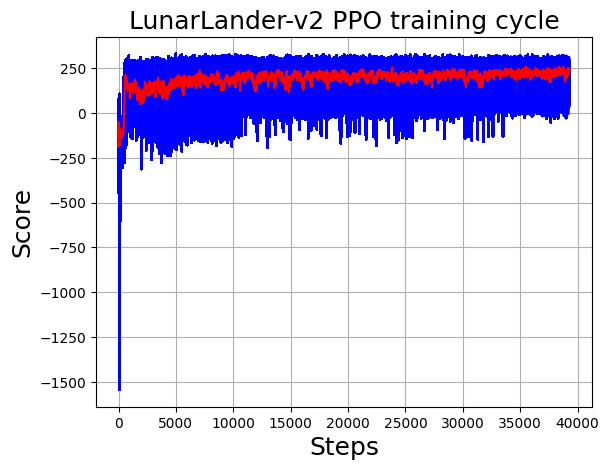

In [1]:
import random
import pylab
import numpy as np
import copy

import tensorflow as tf
from tensorboardX import SummaryWriter
tf.compat.v1.disable_eager_execution()
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras import backend as K

import gym

class actor_model:
    def __init__(self, input_shape, action_space, lr, optimizer):
        X_input = Input(input_shape)
        self.action_space = action_space

        X = Dense(512, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X_input)
        X = Dense(256, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X)
        X = Dense(64, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X)
        output = Dense(self.action_space, activation="softmax")(X)

        self.actor = Model(inputs = X_input, outputs = output)
        self.actor.compile(loss=self.ppo_loss, optimizer=optimizer(lr=lr))
    
    #Loss function
    def ppo_loss(self, y_true, y_pred):
        advantages, prediction_picks, actions = y_true[:, :1], y_true[:, 1:1+self.action_space], y_true[:, 1+self.action_space:]
        LOSS_CLIPPING = 0.2
        ENTROPY_LOSS = 0.001
        
        prob = actions * y_pred
        old_prob = actions * prediction_picks
        
        prob = K.clip(prob, 1e-10, 1.0)
        old_prob = K.clip(old_prob, 1e-10, 1.0)
        
        ratio = K.exp(K.log(prob) - K.log(old_prob))
        
        p1 = ratio * advantages
        p2 = K.clip(ratio, min_value = 1 - LOSS_CLIPPING, max_value = 1 + LOSS_CLIPPING) * advantages
        
        actor_loss = -K.mean(K.minimum(p1, p2))
        
        entropy = -(y_pred * K.log(y_pred + 1e-10))
        entropy = ENTROPY_LOSS * K.mean(entropy)
        
        total_loss = actor_loss - entropy
        
        return total_loss
    
    def predict(self, state):
        return self.actor.predict(state)


class critic_model:
    def __init__(self, input_shape, action_space, lr, optimizer):
        X_input = Input(input_shape)
        old_values = Input(shape=(1,))
        
        X = Dense(512, activation="relu", kernel_initializer="he_uniform")(X_input)
        X = Dense(256, activation="relu", kernel_initializer="he_uniform")(X)
        X = Dense(64, activation="relu", kernel_initializer="he_uniform")(X)
        value = Dense(1, activation=None)(X)
        
        self.critic = Model(inputs=[X_input, old_values], outputs = value)
        self.critic.compile(loss=[self.critic_PPO2_loss(old_values)], optimizer=optimizer(lr=lr))
    
    #Loss function
    def critic_PPO2_loss(self, values):
        def loss(y_true, y_pred):
            LOSS_CLIPPING = 0.2
            clipped_value_loss = values + K.clip(y_pred - values, -LOSS_CLIPPING, LOSS_CLIPPING)
            v_loss1 = (y_true - clipped_value_loss) ** 2
            v_loss2 = (y_true - y_pred) ** 2
            
            value_loss = 0.5 * K.mean(K.maximum(v_loss1, v_loss2))
            return value_loss
        return loss
    
    def predict(self, state):
        return self.critic.predict([state, np.zeros((state.shape[0], 1))])


class model:
    def __init__(self, env_name):
        # Initialization
        # Environment and PPO parameters
        self.env_name = env_name       
        self.env = gym.make(env_name)
        self.action_size = self.env.action_space.n
        self.state_size = self.env.observation_space.shape
        self.EPISODES = 10000 # total episodes to train through all environments
        self.episode = 0 # used to track the episodes total count of episodes played through all thread environments
        self.max_average = 0 # when average score is above 0 model will be saved
        self.lr = 0.00025
        self.epochs = 10 # training epochs
        self.shuffle=False
        self.training_batch = 1000
        self.optimizer = Adam

        self.replay_count = 0
        self.writer = SummaryWriter(comment="_"+self.env_name+"_"+self.optimizer.__name__+"_"+str(self.lr))
        
        # Instantiate plot memory
        self.scores_, self.episodes_, self.average_ = [], [], [] # used in matplotlib plots

        # Create Actor-Critic network models
        self.actor = actor_model(input_shape=self.state_size, action_space = self.action_size, lr=self.lr, optimizer = self.optimizer)
        self.critic = critic_model(input_shape=self.state_size, action_space = self.action_size, lr=self.lr, optimizer = self.optimizer)
        
        self.name = f"{self.env_name}_PPO"
        
    def act(self, state):
        #predict the next action to take, using the model
        prediction = self.actor.predict(state)[0]
        action = np.random.choice(self.action_size, p=prediction)
        action_onehot = np.zeros([self.action_size])
        action_onehot[action] = 1
        return action, action_onehot, prediction
    
    #Generalized Advantage Estimation
    def get_gaes(self, rewards, dones, values, next_values, gamma = 0.99, lamda = 0.9, normalize = True):
        deltas = [r + gamma * (1-d) * nv - v for r, d, nv, v in zip(rewards, dones, next_values, values)]
        deltas = np.stack(deltas)
        gaes = copy.deepcopy(deltas)
        for t in reversed(range(len(deltas)-1)):
            gaes[t] = gaes[t] + (1 - dones[t]) * gamma * lamda * gaes[t+1]

        target = gaes + values
        if normalize:
            gaes = (gaes - gaes.mean()) / (gaes.std() + 1e-8)
        return np.vstack(gaes), np.vstack(target)
    
    def replay(self, states, actions, rewards, predictions, dones, next_states):
        #Reshape memory to approproate shape for training
        states = np.vstack(states)
        next_states = np.vstack(next_states)
        actions = np.vstack(actions)
        predictions = np.vstack(predictions)

        #Get Critic network predictions
        values = self.critic.predict(states)
        next_values = self.critic.predict(next_states)

        #Compute discounted rewards and advantages
        advantages, target = self.get_gaes(rewards, dones, np.squeeze(values), np.squeeze(next_values))

        #Stack everything to numpy array
        #Pack all advantags, predictions, and action to y_true and when they are received in custom PPO loss function we unpack it
        y_true = np.hstack([advantages, predictions, actions])

        #Training actor and critic networks
        a_loss = self.actor.actor.fit(states, y_true, epochs=self.epochs, verbose=0, shuffle=self.shuffle)
        c_loss = self.critic.critic.fit([states, values], target, epochs=self.epochs, verbose=0, shuffle=self.shuffle)
    
    #Save weights to file
    def save(self, name):
        self.actor.actor.save_weights(name+"_Actor.h5")
        self.critic.critic.save_weights(name+"_Critic.h5")
    
    #Load weights from file
    def load(self, actor_weights_name, critic_weights_name):
        self.actor.actor.load_weights(actor_weights_name)
        self.critic.critic.load_weights(critic_weights_name)
    
    #Save the model when it performs the best
    def save_best(self, score, episode):
        self.scores_.append(score)
        self.episodes_.append(episode)
        self.average_.append(sum(self.scores_[-50:]) / len(self.scores_[-50:]))
        
        #Save and plot every 100 episodes
        if str(episode)[-2:] == "00":
            self.save(self.name+"_Episode"+str(episode))
            
            pylab.plot(self.episodes_, self.scores_, 'b')
            pylab.plot(self.episodes_, self.average_, 'r')
            pylab.title(self.env_name+" PPO training cycle", fontsize=18)
            pylab.ylabel('Score', fontsize=18)
            pylab.xlabel('Steps', fontsize=18)
            try:
                pylab.grid(True)
                pylab.savefig(self.env_name+".png")
            except OSError:
                pass
        
        #Save best models
        if self.average_[-1] >= self.max_average:
            self.max_average = self.average_[-1]
            
            self.save(self.name)
            SAVING = "SAVING"
            
            #Learning rate decay
            self.lr *= 0.95
            K.set_value(self.actor.actor.optimizer.learning_rate, self.lr)
            K.set_value(self.critic.critic.optimizer.learning_rate, self.lr)
        else:
            SAVING = ""
        
        return self.average_[-1], SAVING
    
    #Train the model
    def run_batch(self):
        state = self.env.reset()
        state = np.reshape(state, [1, self.state_size[0]])
        done, score, SAVING, = False, 0, ''

        while True:
            #Initialize or reset memory
            states, next_states, actions, rewards, predictions, dones = [], [], [], [], [], []
            timesteps = 0
            for t in range(self.training_batch):
                timesteps += 1
                #self.env.render()
                action, action_onehot, prediction = self.act(state)
                next_state, reward, done, _ = self.env.step(action)

                states.append(state)
                next_states.append(np.reshape(next_state, [1, self.state_size[0]]))
                actions.append(action_onehot)
                rewards.append(reward)
                dones.append(done)
                predictions.append(prediction)

                state = np.reshape(next_state, [1, self.state_size[0]])
                score += reward

                if done or timesteps > 1000:
                    timesteps = 0
                    self.episode += 1
                    average, SAVING = self.save_best(score, self.episode)
                    print("episode: {}/{}, score: {}, average: {:.2f} {}".format(self.episode, self.EPISODES, score, average, SAVING))

                    state, done, score, SAVING = self.env.reset(), False, 0, ''
                    state = np.reshape(state, [1, self.state_size[0]])

            self.replay(states, actions, rewards, predictions, dones, next_states)
    
    #Run the model
    def run(self, num):
        for i in range(num):
            state = self.env.reset()
            state=np.reshape(state, [1, self.state_size[0]])
            done = False
            score = 0
            
            for t in range(1000):
                self.env.render()
                action = np.argmax(self.actor.predict(state)[0])
                state, reward, done, _ = self.env.step(action)
                state = np.reshape(state, [1, self.state_size[0]])
                score += reward

                if done:
                    break
            
            print("Score:", score)
                    
        self.env.close()


#TRAIN THE MODEL
env = "LunarLander-v2"
agent = model(env)
agent.run_batch()

## REINFORCE

In [ ]:
import gym
from gym import logger as gymlogger
from gym.wrappers import Monitor
gymlogger.set_level(40) #error only
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline
import math
import glob
import logging
import io
import base64

from IPython import display as ipythondisplay
from IPython.display import HTML, clear_output

from matplotlib.animation import FuncAnimation
from pyvirtualdisplay import Display
from gym.envs.box2d.lunar_lander import heuristic
display = Display(visible=0, size=(1400, 900))
display.start()

import keras
import tensorflow as tf
# from tensorflow_probability.distributions import Beta
from keras.models import Sequential
from keras.layers import Dense, Lambda
from keras.optimizers import Adam
from keras import backend as K

# set the seed
sciper = {'student_1': 321957, # Riccardo Cadei
          'student_2': 321215  # Niccolò Polvani} 
seed = sciper['student_1']+sciper['student_2']

np.random.seed(seed)
tf.random.set_seed(seed*2)
          
          gym.logger.setLevel(logging.ERROR)
discrete_env = gym.make('LunarLander-v2')
discrete_env._max_episode_steps = 500
discrete_env.seed(seed*3)
gym.logger.setLevel(logging.WARN)

%matplotlib inline
plt.rcParams['figure.figsize'] = 12, 8
plt.rcParams["animation.html"] = "jshtml"
          
def AddValue(output_size, value):
    return Lambda(lambda x: x + value, output_shape=(output_size,))

def render(episode, env):
    
    fig = plt.figure()
    img = plt.imshow(env.render(mode='rgb_array'))
    plt.axis('off')

    def animate(i):
        img.set_data(episode[i])
        return img,

    anim = FuncAnimation(fig, animate, frames=len(episode), interval=24, blit=True)
    html = HTML(anim.to_jshtml())
    
    plt.close(fig)
    !rm None0000000.png
    
    return html

class Results(dict):
    
    def __init__(self, *args, **kwargs):
        if 'filename' in kwargs:
            data = np.load(kwargs['filename'])
            super().__init__(data)
        else:
            super().__init__(*args, **kwargs)
        self.new_key = None
        self.plot_keys = None
        self.ylim = None
        
    def __setitem__(self, key, value):
        super().__setitem__(key, value)
        self.new_key = key

    def plot(self, window):
        clear_output(wait=True)
        for key in self:
            #Ensure latest results are plotted on top
            if self.plot_keys is not None and key not in self.plot_keys:
                continue
            elif key == self.new_key:
                continue
            self.plot_smooth(key, window)
        if self.new_key is not None:
            self.plot_smooth(self.new_key, window)
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.legend(loc='lower right')
        if self.ylim is not None:
            plt.ylim(self.ylim)
        plt.show()
        
    def plot_smooth(self, key, window):
        if len(self[key]) == 0:
            plt.plot([], [], label=key)
            return None
        y = np.convolve(self[key], np.ones((window,))/window, mode='valid')
        x = np.linspace(window/2, len(self[key]) - window/2, len(y))
        plt.plot(x, y, label=key)
        
    def save(self, filename='results'):
        np.savez(filename, **self)
          
def run_fixed_episode(env, policy):
    frames = []
    observation = env.reset()
    done = False
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action = policy(env, observation)
        observation, reward, done, info = env.step(action)
    return frames
    
def random_policy(env, observation):
    return env.action_space.sample()

def heuristic_policy(env, observation):
    return heuristic(env.unwrapped, observation)
          
episode = run_fixed_episode(discrete_env, random_policy)
render(episode, discrete_env)
          

episode = run_fixed_episode(discrete_env, heuristic_policy)
render(episode, discrete_env)
          
num_episodes = 3000

def run_experiment(experiment_name, 
                   env, 
                   num_episodes, 
                   policy_learning_rate=0.001, 
                   value_learning_rate=0.001, 
                   baseline=None, 
                   num_layers=3):

    #Initiate the learning agent
    agent = RLAgent(n_obs=env.observation_space.shape[0], 
                    action_space=env.action_space,
                    policy_learning_rate=policy_learning_rate, 
                    value_learning_rate=value_learning_rate, 
                    discount=0.99, 
                    baseline=baseline, 
                    num_layers=num_layers)

    rewards = []
    all_episode_frames = []
    step = 0
    for episode in range(1, num_episodes+1):
    
        #Update results plot and occasionally store an episode movie
        episode_frames = None
        if episode % 10 == 0:
            results[experiment_name] = np.array(rewards)
            results.plot(10)
        if episode % 500 == 0:
            episode_frames = []
            
        #Reset the environment to a new episode
        observation = env.reset()
        episode_reward = 0

        while True:
        
            if episode_frames is not None:
                episode_frames.append(env.render(mode='rgb_array'))

            # 1. Decide on an action based on the observations
            action = agent.decide(observation)

            # 2. Take action in the environment
            next_observation, reward, done, info = env.step(action)
            episode_reward += reward

            # 3. Store the information returned from the environment for training
            agent.observe(observation, action, reward)

            # 4. When we reach a terminal state ("done"), use the observed episode to train the network
            if done:
                rewards.append(episode_reward)
                if episode_frames is not None:
                    all_episode_frames.append(episode_frames)
                agent.train()
                break

            # Reset for next step
            observation = next_observation
            step += 1
            
    return all_episode_frames, agent
          
class RLAgent(object):
    
    def __init__(self, n_obs, action_space, policy_learning_rate, value_learning_rate, 
                 discount, baseline = None, num_layers=3, ma_window_size=50):

        # input/output
        self.n_obs = n_obs  
        self.n_act = action_space.n
        
        # training parameters
        self.plr = policy_learning_rate
        self.vlr = value_learning_rate
        self.gamma = discount
        self.num_layers = num_layers
        self.ma_window_size = ma_window_size
    
        
        # lists to store the cumulative observations for an episode
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []

        # set baseline
        self.use_simple_baseline = False
        self.use_adaptive_baseline = False

        if baseline == 'simple':
            self.use_simple_baseline = True
        elif baseline == 'adaptive':
            self.use_adaptive_baseline = True

        # build the keras network/s
        self._build_network()
        

    def observe(self, state, action, reward):
        """ This function takes the observations the agent received from the environment and stores them
            in the lists above."""

        self.episode_observations.append(state)
        self.episode_actions.append(action)
        self.episode_rewards.append(reward)
        
    def decide(self, state):
        """ This function feeds the observed state to the network, which returns a distribution
            over possible actions. Sample an action from the distribution and return it."""

        # get actions probabilities
        state = state.reshape([1, self.n_obs])
        action_probabilities = self.model(state).numpy().flatten()
        # sample an action
        action = np.random.choice(self.n_act, p=action_probabilities)

        return action

    def train(self):
        """ When this function is called, the accumulated episode observations, actions and discounted rewards
            should be fed into the network and used for training. Use the _get_returns function to first turn 
            the episode rewards into discounted returns. 
            Apply simple or adaptive baselines if needed, depending on parameters."""

        episode_length = len(self.episode_observations)

        # States
        states=np.array(self.episode_observations)

        # Actions (hot encoding)
        mask = np.eye(self.n_act)
        actions = mask[self.episode_actions]

        # Discounted Rewards
        discounted_rewards = np.array(self._get_returns())

        # update model_baseline parameters
        if self.use_adaptive_baseline:
            self.model_baseline.train_on_batch(x = states,
                                               y = discounted_rewards)

        # subtract Baseline
        if self.use_simple_baseline:
            if self.ma_window_size < episode_length:
              for i in range(episode_length):
                    l = max(0, i - self.ma_window_size)
                    u = min(episode_length, i + self.ma_window_size)
                    discounted_rewards[i] -= np.mean(discounted_rewards[l:u])
              else:
                 discounted_rewards = np.array(discounted_rewards) - np.mean(discounted_rewards) 
        elif self.use_adaptive_baseline:
            discounted_rewards -= self.model_baseline(states).numpy().flatten()
        
        # update model (policy) parameters
        self.model.train_on_batch(x = states, 
                                  y = actions,
                                  sample_weight = discounted_rewards)
        
        # reset cumulative lists
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []


    def _get_returns(self):
        """ This function should process self.episode_rewards and return the discounted episode returns
            at each step in the episode. """ 
               
        discounted_rewards = []
        cumulative_total_return = 0
        for reward in self.episode_rewards[::-1]:      
           cumulative_total_return = (cumulative_total_return*self.gamma) + reward
           discounted_rewards.insert(0, cumulative_total_return) 
    
        return discounted_rewards


    def _build_network(self):
        """ This function should build the network that can then be called by decide and train. 
            The network takes observations as inputs and has a policy distribution as output."""

        model = Sequential()
        for i in range(self.num_layers):
            model.add(Dense(16, activation="relu"))
        model.add(Dense(self.n_act, activation="softmax")) 
        
        model.compile(loss = "categorical_crossentropy", optimizer = Adam(lr=self.plr))
        self.model = model

        if self.use_adaptive_baseline:
            model_baseline = Sequential()
            for i in range(self.num_layers):
                  model_baseline.add(Dense(16, activation="relu"))
            model_baseline.add(Dense(1)) 
        
            model_baseline.compile(loss = "mse", optimizer = Adam(lr=self.vlr))
            self.model_baseline = model_baseline
          
results = Results()
policy_learning_rate = 0.0025

# REINFORCE
episodes, model = run_experiment("REINFORCE", discrete_env, num_episodes, policy_learning_rate)

# REINFORCE + Simple Baseline
episodes, baseline_model = run_experiment("REINFORCE (with baseline)", discrete_env, num_episodes, policy_learning_rate, baseline='simple')

## SARSA

NOTES

models to be used:
- Deep Q Network (DQN)
- Double Deep Q Network
- Dueling Deep Q Network (allegedly trains faster than vanilla DQN)
- Deep Deterministic Policy Gradient (DDPG)
- SARSA
- other stuff idk 

## REFERENCES
##### ‎
#### Deep Q Network (DQN)
##### https://github.com/shivaverma/OpenAIGym/blob/master/lunar-lander/discrete/lunar_lander.py
### ‎

####  Deep Double Q Network
##### https://github.com/MohammadAsadolahi/DDQN_Deep-Double_Q-Learning-for-solving-OpenAi-Gym-LunarLander-v2-in-python/blob/main/Double_DQN_for_Gym_LunarLander.py
### ‎

#### Dueling Deep Q Network
##### https://github.com/MohammadAsadolahi/Dueling_Deep-Double_Q-Learning-for-solving-OpenAi-Gym-LunarLander-v2-in-python/blob/main/Dueling_DQN_for_Gym_LunarLander.ipynb
### ‎

#### Dueling Deep Q Network With Prioritized Experience Replay (DDQN-PER)
##### https://github.com/MorvanZhou/Reinforcement-learning-with-tensorflow/blob/master/experiments/Solve_LunarLander/DuelingDQNPrioritizedReplay.py
### ‎

#### Deep Deterministic Policy Gradient (DDPG)
##### https://towardsdatascience.com/deep-deterministic-and-twin-delayed-deep-deterministic-policy-gradient-with-tensorflow-2-x-43517b0e0185
##### https://github.com/abhisheksuran/Reinforcement_Learning/blob/master/DDPG.ipynb
### ‎

#### Proximal Policy Optimization Actor-Critic (PPO)
##### https://github.com/DennisChunikhin/Reinforcement-Learning-Lunar-Lander/blob/main/LunarLanderPPO.py
### ‎

#### REINFORCE
##### https://github.com/riccardocadei/LunarLander-v2-REINFORCE/blob/main/main.ipynb
### ‎

#### SARSA
##### https://github.com/mokeddembillel/Lunar-Lander-Deep-Expected-Sarsa/blob/main/EXPECTED_SARSA_LUNAR_LANDER.ipynb
### ‎

#### Additional References
##### https://github.com/topics/lunarlander-v2?o=desc&s=updated
##### https://xusophia.github.io/DataSciFinalProj/